In [1]:
#https://www.kaggle.com/akashsri99/deep-learning-iris-dataset-keras/notebook
import os
os.environ['CUDA_VISIBLE_DEVICES'] = '-1'
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import os
from keras.utils import to_categorical
import seaborn as sns
from sklearn.model_selection import train_test_split

Using TensorFlow backend.


In [2]:
dataset = pd.read_csv('dataset_cl_sp_nodp.csv',sep=';')

In [3]:
dataset = dataset[dataset['comp opt'] != 'NF']
dataset = dataset.reset_index(drop=True)
dataset.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 722400 entries, 0 to 722399
Data columns (total 34 columns):
size vector     722400 non-null int64
comp opt        722400 non-null object
label           722400 non-null object
threads         722400 non-null int64
id              722400 non-null int64
PAPI_L1_DCM     722400 non-null int64
PAPI_L3_TCM     722400 non-null int64
PAPI_TOT_INS    722400 non-null int64
PAPI_REF_CYC    722400 non-null int64
PAPI_L2_LDM     722400 non-null int64
PAPI_SR_INS     722400 non-null int64
time_x          722400 non-null int64
PAPI_BR_UCN     722400 non-null int64
PAPI_BR_CN      722400 non-null int64
PAPI_BR_TKN     722400 non-null int64
PAPI_BR_MSP     722400 non-null int64
time_y          722400 non-null int64
PAPI_FP_OPS     722400 non-null int64
PAPI_L1_LDM     722400 non-null int64
PAPI_L1_STM     722400 non-null int64
time_x.1        722400 non-null int64
PAPI_SP_OPS     722400 non-null int64
PAPI_LD_INS     722400 non-null int64
PAPI_L2_STM  

In [4]:
dataset

,size vector,comp opt,label,threads,id,PAPI_L1_DCM,PAPI_L3_TCM,PAPI_TOT_INS,PAPI_REF_CYC,PAPI_L2_LDM,...,time_y.1,PAPI_TLB_DM,PAPI_L2_DCH,time_x.1.1,time_y.1.1,P_index,ideal,affinity,T_list,P_list
0,3000,O2,Copy_E,5,1,5194,543,1361874,2458692,1415,...,1,115,3346,0,0.000004,0.000016,1,spread,"[1, 3, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12]","[5e-06, 9.6e-06, 1e-05, 1.28e-05, 1.6e-05, 1.9..."
1,3000,O2,Copy_E,5,2,3981,78,1145149,1994742,869,...,0,61,2724,0,0.000004,0.000016,1,spread,"[1, 3, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12]","[5e-06, 9.6e-06, 1e-05, 1.28e-05, 1.6e-05, 1.9..."
2,3000,O2,Copy_E,5,3,3730,50,1162368,2025702,844,...,0,45,2476,0,0.000004,0.000016,1,spread,"[1, 3, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12]","[5e-06, 9.6e-06, 1e-05, 1.28e-05, 1.6e-05, 1.9..."
3,3000,O2,Copy_E,5,4,3533,46,1159110,2023560,801,...,0,57,2625,0,0.000004,0.000016,1,spread,"[1, 3, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12]","[5e-06, 9.6e-06, 1e-05, 1.28e-05, 1.6e-05, 1.9..."
4,3000,O2,Copy_E,5,5,3530,37,1115404,1941156,785,...,0,44,2566,0,0.000004,0.000016,1,spread,"[1, 3, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12]","[5e-06, 9.6e-06, 1e-05, 1.28e-05, 1.6e-05, 1.9..."
5,3000,O2,Copy_E,5,6,3461,36,1113848,1937898,764,...,0,58,2482,1,0.000004,0.000016,1,spread,"[1, 3, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12]","[5e-06, 9.6e-06, 1e-05, 1.28e-05, 1.6e-05, 1.9..."
6,3000,O2,Copy_E,5,7,3541,38,1122671,1955610,821,...,0,57,2583,0,0.000004,0.000016,1,spread,"[1, 3, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12]","[5e-06, 9.6e-06, 1e-05, 1.28e-05, 1.6e-05, 1.9..."
7,3000,O2,Copy_E,5,8,3658,33,1171838,2045970,892,...,0,50,2517,0,0.000004,0.000016,1,spread,"[1, 3, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12]","[5e-06, 9.6e-06, 1e-05, 1.28e-05, 1.6e-05, 1.9..."
8,3000,O2,Copy_E,5,9,3441,45,1125059,1956780,785,...,0,41,2520,0,0.000004,0.000016,1,spread,"[1, 3, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12]","[5e-06, 9.6e-06, 1e-05, 1.28e-05, 1.6e-05, 1.9..."
9,3000,O2,Copy_E,5,10,3700,53,1168407,2031516,793,...,1,58,2499,1,0.000004,0.000016,1,spread,"[1, 3, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12]","[5e-06, 9.6e-06, 1e-05, 1.28e-05, 1.6e-05, 1.9..."


In [5]:
from sklearn.utils import shuffle
dataset = shuffle(dataset)
dataset

,size vector,comp opt,label,threads,id,PAPI_L1_DCM,PAPI_L3_TCM,PAPI_TOT_INS,PAPI_REF_CYC,PAPI_L2_LDM,...,time_y.1,PAPI_TLB_DM,PAPI_L2_DCH,time_x.1.1,time_y.1.1,P_index,ideal,affinity,T_list,P_list
325668,300000,O2,Scale_E,9,169,78472,133,4562228,6665022,30938,...,1,96,12549,1,0.000085,0.000143,6,spread,"[6, 4, 8, 5, 7, 3, 10, 9, 12, 11, 2, 1]","[9.98e-05, 0.000106374, 0.000106971, 0.0001077..."
321060,500000,O2,Reduction_E,4,461,66018,35,3095384,3310668,3862,...,0,162,59462,1,0.000161,0.000160,11,spread,"[11, 10, 12, 9, 8, 7, 6, 5, 4, 3, 2, 1]","[6.75e-05, 7.36e-05, 7.6e-05, 7.82e-05, 8.72e-..."
22926,50000,O2,2PStencil_E,8,527,15853,149,2558724,4177368,921,...,0,39,14305,0,0.000013,0.000016,6,spread,"[8, 6, 7, 10, 9, 4, 5, 3, 12, 11, 2, 1]","[1.63e-05, 1.63e-05, 1.65e-05, 1.73e-05, 1.83e..."
318134,10000,O2,Triad_E,4,335,7111,109,998441,1615518,843,...,1,68,5969,0,0.000007,0.000011,5,spread,"[5, 3, 4, 2, 6, 7, 8, 9, 1, 10, 11, 12]","[1e-05, 1.07e-05, 1.09e-05, 1.11e-05, 1.2e-05,..."
209448,2000000,O2,Scale_E,4,149,503483,201421,13945631,16601274,91360,...,2,1081,249845,2,0.001520,0.002209,2,spread,"[2, 4, 3, 6, 5, 8, 7, 10, 1, 9, 12, 11]","[0.002080017, 0.002208795, 0.002637708, 0.0028..."
128171,30000,O2,Copy_E,12,72,11127,191,4024872,7647228,1167,...,1,37,9634,0,0.000009,0.000028,4,spread,"[4, 6, 5, 3, 8, 7, 9, 10, 2, 11, 12, 1]","[1.14e-05, 1.39e-05, 1.4300000000000004e-05, 1..."
64583,1000000,O2,Scale_E,11,184,253621,10737,10009586,14652648,120973,...,1,248,9050,0,0.000292,0.000526,6,spread,"[6, 8, 4, 7, 10, 9, 3, 12, 2, 5, 11, 1]","[0.000273331, 0.00030098, 0.000346491999999999..."
471756,5000000,O2,2D4PStencil_E,9,657,2501500,897325,60017891,99160434,353643,...,5,1163,1578980,4,0.004563,0.016627,2,close,"[2, 3, 1, 12, 11, 4, 10, 9, 5, 8, 7, 6]","[0.009428486, 0.011046858, 0.01127, 0.01422433..."
474321,140000000,O2,Reduction_E,5,422,17504899,11157790,562129229,785995488,7104012,...,66,1025,5744494,66,0.066523,0.132707,12,close,"[12, 3, 11, 2, 10, 9, 4, 8, 7, 5, 6, 1]","[0.08862954699999999, 0.091688786, 0.093499955..."
516993,9000,O2,Triad_E,1,394,6683,0,230815,264132,1218,...,0,52,4911,1,0.000016,0.000016,4,close,"[4, 3, 2, 5, 6, 7, 1, 8, 9, 10, 11, 12]","[9e-06, 9.19e-06, 1.01e-05, 1.13e-05, 1.350000..."


In [6]:
labels =  dataset['label'].tolist()
labels_train ,labels_pred = train_test_split(labels,test_size=0.2,random_state=0) 
size_vectors = dataset['size vector'].tolist()
size_vectors_train ,size_vectors_pred = train_test_split(size_vectors,test_size=0.2,random_state=0) 
comp_opts = dataset['comp opt'].tolist()
comp_opts_train ,comp_opts_pred = train_test_split(comp_opts,test_size=0.2,random_state=0) 
threads = dataset['threads'].tolist()
threads_train ,threads_pred = train_test_split(threads,test_size=0.2,random_state=0) 

In [7]:
P_list =  dataset['P_list'].tolist()
P_list_train ,P_list_pred = train_test_split(P_list,test_size=0.2,random_state=0) 
P_list_train

['[1.09e-05, 1.21e-05, 1.31e-05, 1.31e-05, 1.32e-05, 1.3699999999999998e-05, 1.3800000000000007e-05, 1.56e-05, 1.9e-05, 1.95e-05, 2.08e-05, 3.7e-05]',
 '[1.05e-05, 1.1400000000000001e-05, 1.1599999999999999e-05, 1.23e-05, 1.3000000000000001e-05, 1.4000000000000001e-05, 1.58e-05, 1.6100000000000002e-05, 1.75e-05, 2.51e-05, 2.7399999999999995e-05, 2.8000000000000013e-05]',
 '[0.032533419, 0.034612533, 0.037632744, 0.039931464, 0.042186755, 0.044810476, 0.04765103, 0.04882553, 0.05240056, 0.053399545, 0.054008404, 0.09515]',
 '[0.052682202000000004, 0.055139999999999995, 0.068709378, 0.085637991, 0.087191843, 0.08987983, 0.0938716, 0.099474641, 0.10659137099999999, 0.111742004, 0.117723434, 0.13136937099999998]',
 '[8e-06, 9e-06, 9.19e-06, 1.13e-05, 1.35e-05, 1.58e-05, 1.6e-05, 1.8e-05, 2.03e-05, 2.25e-05, 2.48e-05, 3.68e-05]',
 '[0.002089562, 0.0021627720000000003, 0.002508634, 0.00263422, 0.002635858, 0.0026903820000000003, 0.00302058, 0.003344031, 0.003605954, 0.003833264, 0.003882443,

In [8]:
T_list =  dataset['T_list'].tolist()
T_list_train ,T_list_pred = train_test_split(T_list,test_size=0.2,random_state=0) 
T_list_train

['[5, 7, 6, 4, 10, 3, 8, 9, 11, 2, 12, 1]',
 '[6, 5, 4, 7, 3, 8, 9, 2, 10, 11, 12, 1]',
 '[6, 4, 5, 8, 3, 7, 2, 10, 9, 11, 12, 1]',
 '[2, 1, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6]',
 '[2, 4, 3, 5, 6, 7, 1, 8, 9, 10, 11, 12]',
 '[6, 4, 5, 7, 3, 8, 2, 10, 11, 12, 9, 1]',
 '[4, 6, 5, 8, 3, 2, 7, 10, 9, 12, 11, 1]',
 '[6, 4, 8, 5, 7, 3, 10, 9, 12, 11, 2, 1]',
 '[4, 8, 6, 2, 10, 12, 7, 5, 9, 11, 3, 1]',
 '[2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11]',
 '[1, 2, 12, 11, 3, 10, 9, 4, 8, 5, 7, 6]',
 '[11, 9, 8, 7, 6, 10, 5, 4, 12, 3, 2, 1]',
 '[12, 2, 11, 3, 10, 4, 9, 8, 5, 1, 7, 6]',
 '[6, 5, 4, 7, 3, 8, 9, 2, 10, 11, 12, 1]',
 '[6, 4, 3, 5, 2, 1, 7, 8, 9, 10, 11, 12]',
 '[12, 3, 11, 2, 10, 9, 4, 8, 7, 5, 6, 1]',
 '[6, 4, 5, 8, 10, 7, 3, 9, 2, 11, 12, 1]',
 '[1, 3, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12]',
 '[9, 7, 8, 11, 6, 10, 12, 5, 4, 3, 2, 1]',
 '[6, 5, 8, 3, 7, 4, 10, 9, 2, 11, 12, 1]',
 '[2, 4, 3, 1, 5, 6, 7, 8, 10, 9, 12, 11]',
 '[12, 11, 10, 9, 8, 1, 7, 3, 2, 4, 5, 6]',
 '[2, 1, 3, 12, 4, 11, 10, 9, 8,

In [9]:
def erase_from_dataset(dataset_in):
    del dataset_in['id']
    del dataset_in['size vector']
    del dataset_in['comp opt']
    del dataset_in['label']
    del dataset_in['threads']
    del dataset_in['time_x']
    del dataset_in['time_y']
    del dataset_in['time_x.1']
    del dataset_in['time_y.1']
    del dataset_in['time_x.1.1']
    del dataset_in['time_y.1.1']
    del dataset_in['P_index']
    del dataset_in['P_list']
    del dataset_in['T_list']
    dataset_in = dataset_in.reset_index(drop=True)

    print(list(dataset_in))
    print(dataset_in.info())
    
erase_from_dataset(dataset)

['PAPI_L1_DCM', 'PAPI_L3_TCM', 'PAPI_TOT_INS', 'PAPI_REF_CYC', 'PAPI_L2_LDM', 'PAPI_SR_INS', 'PAPI_BR_UCN', 'PAPI_BR_CN', 'PAPI_BR_TKN', 'PAPI_BR_MSP', 'PAPI_FP_OPS', 'PAPI_L1_LDM', 'PAPI_L1_STM', 'PAPI_SP_OPS', 'PAPI_LD_INS', 'PAPI_L2_STM', 'PAPI_TLB_DM', 'PAPI_L2_DCH', 'ideal', 'affinity']
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 722400 entries, 0 to 722399
Data columns (total 20 columns):
PAPI_L1_DCM     722400 non-null int64
PAPI_L3_TCM     722400 non-null int64
PAPI_TOT_INS    722400 non-null int64
PAPI_REF_CYC    722400 non-null int64
PAPI_L2_LDM     722400 non-null int64
PAPI_SR_INS     722400 non-null int64
PAPI_BR_UCN     722400 non-null int64
PAPI_BR_CN      722400 non-null int64
PAPI_BR_TKN     722400 non-null int64
PAPI_BR_MSP     722400 non-null int64
PAPI_FP_OPS     722400 non-null int64
PAPI_L1_LDM     722400 non-null int64
PAPI_L1_STM     722400 non-null int64
PAPI_SP_OPS     722400 non-null int64
PAPI_LD_INS     722400 non-null int64
PAPI_L2_STM     722400 non

In [10]:
dataset

,PAPI_L1_DCM,PAPI_L3_TCM,PAPI_TOT_INS,PAPI_REF_CYC,PAPI_L2_LDM,PAPI_SR_INS,PAPI_BR_UCN,PAPI_BR_CN,PAPI_BR_TKN,PAPI_BR_MSP,PAPI_FP_OPS,PAPI_L1_LDM,PAPI_L1_STM,PAPI_SP_OPS,PAPI_LD_INS,PAPI_L2_STM,PAPI_TLB_DM,PAPI_L2_DCH,ideal,affinity
325668,78472,133,4562228,6665022,30938,328419,8129,1041191,700894,1490,300059,39494,36602,0,706980,28340,96,12549,6,spread
321060,66018,35,3095384,3310668,3862,28272,8184,781164,658100,1543,500037,63350,362,0,653944,142,162,59462,11,spread
22926,15853,149,2558724,4177368,921,78337,8119,567377,336452,1366,100092,9127,6580,0,422836,371,39,14305,6,spread
318134,7111,109,998441,1615518,843,38515,8095,267432,156101,1513,20021,5356,1595,0,177401,264,68,5969,5,spread
209448,503483,201421,13945631,16601274,91360,2027944,8126,2368874,2207655,2198,2008201,219238,216632,0,2228515,96593,1081,249845,2,spread
128171,11127,191,4024872,7647228,1167,58607,8317,1009385,564315,1618,45,6621,4040,0,581853,357,37,9634,4,spread
64583,253621,10737,10009586,14652648,120973,1028556,8220,1957034,1518299,1581,1000341,127112,124207,0,1536029,116554,248,9050,6,spread
471756,2501500,897325,60017891,99160434,353643,5019302,8266,7769415,6429327,8390,20110676,1760428,455619,0,21342498,297542,1163,1578980,2,close
474321,17504899,11157790,562129229,785995488,7104012,28349,8120,141722531,141471768,45777,140186285,12827633,365,0,140334671,129,1025,5744494,12,close
516993,6683,0,230815,264132,1218,37670,8119,31716,35055,1551,18012,5069,1423,0,65386,371,52,4911,4,close


In [11]:
affinity_list = ['close','spread']
def doSomething(x):
    return affinity_list.index(x)

dataset['affinity'] = dataset['affinity'].apply(doSomething)
#for elem in dataset.affinity:
#dataset.affinity = affinity_list.index(dataset.affinity)
#dataset.affinity

c:\python36\lib\site-packages\ipykernel_launcher.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  """


In [12]:
y = dataset['ideal'].tolist()
del dataset['ideal']
y

[6,
 11,
 6,
 5,
 2,
 4,
 6,
 2,
 12,
 4,
 10,
 12,
 1,
 5,
 12,
 6,
 3,
 6,
 12,
 1,
 12,
 11,
 6,
 4,
 2,
 11,
 6,
 12,
 10,
 12,
 8,
 6,
 12,
 1,
 1,
 1,
 2,
 2,
 5,
 2,
 6,
 4,
 3,
 2,
 2,
 6,
 3,
 12,
 1,
 1,
 12,
 1,
 1,
 8,
 5,
 8,
 6,
 10,
 5,
 2,
 12,
 2,
 2,
 2,
 2,
 4,
 3,
 1,
 8,
 3,
 1,
 2,
 12,
 12,
 2,
 12,
 6,
 11,
 10,
 4,
 5,
 6,
 2,
 6,
 12,
 1,
 4,
 12,
 7,
 2,
 12,
 1,
 2,
 2,
 11,
 12,
 12,
 6,
 12,
 4,
 4,
 1,
 2,
 2,
 2,
 1,
 2,
 11,
 6,
 12,
 10,
 2,
 1,
 12,
 10,
 2,
 4,
 11,
 2,
 12,
 12,
 2,
 1,
 12,
 2,
 6,
 10,
 2,
 12,
 2,
 11,
 12,
 10,
 10,
 6,
 2,
 2,
 12,
 7,
 2,
 9,
 6,
 2,
 2,
 10,
 2,
 8,
 1,
 2,
 6,
 2,
 2,
 9,
 1,
 9,
 6,
 2,
 8,
 10,
 3,
 2,
 8,
 8,
 2,
 2,
 6,
 3,
 12,
 12,
 8,
 11,
 2,
 4,
 1,
 8,
 9,
 1,
 12,
 6,
 10,
 8,
 12,
 12,
 2,
 6,
 12,
 2,
 2,
 6,
 3,
 11,
 6,
 10,
 3,
 2,
 2,
 6,
 6,
 4,
 4,
 12,
 3,
 4,
 10,
 1,
 2,
 12,
 6,
 3,
 2,
 1,
 2,
 12,
 10,
 1,
 1,
 2,
 1,
 12,
 12,
 2,
 1,
 10,
 2,
 8,
 3,
 1,
 3,
 4,
 11,
 7,
 2,
 12,
 

In [13]:
dataset = dataset.reindex_axis(sorted(dataset.columns), axis=1)
list(dataset)

c:\python36\lib\site-packages\ipykernel_launcher.py:1: FutureWarning: '.reindex_axis' is deprecated and will be removed in a future version. Use '.reindex' instead.
  """Entry point for launching an IPython kernel.


['PAPI_BR_CN',
 'PAPI_BR_MSP',
 'PAPI_BR_TKN',
 'PAPI_BR_UCN',
 'PAPI_FP_OPS',
 'PAPI_L1_DCM',
 'PAPI_L1_LDM',
 'PAPI_L1_STM',
 'PAPI_L2_DCH',
 'PAPI_L2_LDM',
 'PAPI_L2_STM',
 'PAPI_L3_TCM',
 'PAPI_LD_INS',
 'PAPI_REF_CYC',
 'PAPI_SP_OPS',
 'PAPI_SR_INS',
 'PAPI_TLB_DM',
 'PAPI_TOT_INS',
 'affinity']

In [14]:
X = dataset.iloc[:,0:19].values
print(X)

[[ 1041191     1490   700894 ...       96  4562228        1]
 [  781164     1543   658100 ...      162  3095384        1]
 [  567377     1366   336452 ...       39  2558724        1]
 ...
 [  934752     1697   517095 ...       41  3659608        0]
 [10150582     6882  9645164 ...      665 57605337        1]
 [  591160     1418   345217 ...       42  2375020        0]]


In [15]:
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import MaxAbsScaler
scaler_x = MaxAbsScaler()
scaler_x.fit(X)
X_scaled =  scaler_x.transform(X)
#print (X_scaled)

In [16]:
#from sklearn.model_selection import train_test_split
X_scaled_train ,X_pred_scaled, Y_train, y_pred_train = train_test_split(X_scaled,y,test_size=0.2,random_state=0) 

In [17]:
#Defining the model 
from keras.models import Sequential
from keras.layers import Dense
from keras.layers import Dropout
from keras.optimizers import SGD,Adam


model = Sequential()

In [18]:
model.add(Dense(100,input_shape=(19,),activation='tanh'))
#model.add(Dense(50,activation='relu'))
#model.add(Dense(20,activation='relu'))
model.add(Dense(1))

In [19]:
#model.compile(Adam(lr=0.001),'categorical_crossentropy',metrics=['accuracy'])
model.compile(loss='mae', optimizer='rmsprop')

In [20]:
model.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1 (Dense)              (None, 100)               2000      
_________________________________________________________________
dense_2 (Dense)              (None, 1)                 101       
Total params: 2,101
Trainable params: 2,101
Non-trainable params: 0
_________________________________________________________________


In [21]:
import keras
stopper = keras.callbacks.EarlyStopping(monitor='val_loss', patience=400, verbose=1, baseline=None, mode='auto',restore_best_weights=True)
callback = [stopper] if True else None
print(len(X_pred_scaled),len(y_pred_train))

144480 144480


In [22]:
#fitting the model and predicting 
history = model.fit(X_scaled_train,Y_train,batch_size=100,epochs=1000,shuffle=1,validation_data = (X_pred_scaled, y_pred_train))
#history = model.fit(X_scaled,Y_train,batch_size=100,epochs=1000,shuffle=1,validation_data = (X_pred_scaled, y_pred_train),  callbacks=callback)

Train on 577920 samples, validate on 144480 samples
Epoch 1/1000
577920/577920 [==============================] - 4s 7us/step - loss: 2.6887 - val_loss: 2.5210
Epoch 2/1000
577920/577920 [==============================] - 4s 7us/step - loss: 2.4549 - val_loss: 2.4123
Epoch 3/1000
577920/577920 [==============================] - 4s 7us/step - loss: 2.3725 - val_loss: 2.3463
Epoch 4/1000
577920/577920 [==============================] - 4s 7us/step - loss: 2.3111 - val_loss: 2.2715
Epoch 5/1000
577920/577920 [==============================] - 4s 7us/step - loss: 2.2186 - val_loss: 2.1745
Epoch 6/1000
577920/577920 [==============================] - 4s 7us/step - loss: 2.0687 - val_loss: 2.0016
Epoch 7/1000
577920/577920 [==============================] - 4s 7us/step - loss: 1.9013 - val_loss: 1.8381
Epoch 8/1000
577920/577920 [==============================] - 4s 7us/step - loss: 1.7938 - val_loss: 1.7695
Epoch 9/1000
577920/577920 [==============================] - 4s 7us/step - loss: 1.

577920/577920 [==============================] - 4s 7us/step - loss: 0.7456 - val_loss: 0.7708
Epoch 76/1000
577920/577920 [==============================] - 4s 7us/step - loss: 0.7430 - val_loss: 0.7491
Epoch 77/1000
577920/577920 [==============================] - 4s 7us/step - loss: 0.7406 - val_loss: 0.7423
Epoch 78/1000
577920/577920 [==============================] - 4s 7us/step - loss: 0.7383 - val_loss: 0.7416
Epoch 79/1000
577920/577920 [==============================] - 4s 7us/step - loss: 0.7360 - val_loss: 0.7479
Epoch 80/1000
577920/577920 [==============================] - 4s 7us/step - loss: 0.7339 - val_loss: 0.7390
Epoch 81/1000
577920/577920 [==============================] - 4s 7us/step - loss: 0.7316 - val_loss: 0.7667
Epoch 82/1000
577920/577920 [==============================] - 4s 7us/step - loss: 0.7296 - val_loss: 0.7390
Epoch 83/1000
577920/577920 [==============================] - 4s 7us/step - loss: 0.7275 - val_loss: 0.7264
Epoch 84/1000
577920/577920 [====

Epoch 150/1000
577920/577920 [==============================] - 4s 7us/step - loss: 0.6529 - val_loss: 0.6667
Epoch 151/1000
577920/577920 [==============================] - 4s 6us/step - loss: 0.6521 - val_loss: 0.6652
Epoch 152/1000
577920/577920 [==============================] - 4s 6us/step - loss: 0.6514 - val_loss: 0.6645
Epoch 153/1000
577920/577920 [==============================] - 4s 6us/step - loss: 0.6509 - val_loss: 0.6619
Epoch 154/1000
577920/577920 [==============================] - 4s 7us/step - loss: 0.6503 - val_loss: 0.6584
Epoch 155/1000
577920/577920 [==============================] - 4s 7us/step - loss: 0.6499 - val_loss: 0.6649
Epoch 156/1000
577920/577920 [==============================] - 4s 6us/step - loss: 0.6490 - val_loss: 0.6706
Epoch 157/1000
577920/577920 [==============================] - 4s 6us/step - loss: 0.6485 - val_loss: 0.6952
Epoch 158/1000
577920/577920 [==============================] - 4s 6us/step - loss: 0.6479 - val_loss: 0.6604
Epoch 159/

577920/577920 [==============================] - 4s 6us/step - loss: 0.6176 - val_loss: 0.6274
Epoch 225/1000
577920/577920 [==============================] - 4s 7us/step - loss: 0.6171 - val_loss: 0.6461
Epoch 226/1000
577920/577920 [==============================] - 4s 7us/step - loss: 0.6168 - val_loss: 0.6511
Epoch 227/1000
577920/577920 [==============================] - 4s 6us/step - loss: 0.6164 - val_loss: 0.6407
Epoch 228/1000
577920/577920 [==============================] - 4s 7us/step - loss: 0.6162 - val_loss: 0.6569
Epoch 229/1000
577920/577920 [==============================] - 4s 7us/step - loss: 0.6157 - val_loss: 0.6342
Epoch 230/1000
577920/577920 [==============================] - 4s 7us/step - loss: 0.6154 - val_loss: 0.6123
Epoch 231/1000
577920/577920 [==============================] - 4s 7us/step - loss: 0.6150 - val_loss: 0.6306
Epoch 232/1000
577920/577920 [==============================] - 4s 7us/step - loss: 0.6147 - val_loss: 0.6373
Epoch 233/1000
577920/577

577920/577920 [==============================] - 4s 7us/step - loss: 0.5953 - val_loss: 0.5958
Epoch 299/1000
577920/577920 [==============================] - 4s 7us/step - loss: 0.5950 - val_loss: 0.6023
Epoch 300/1000
577920/577920 [==============================] - 4s 7us/step - loss: 0.5947 - val_loss: 0.6075
Epoch 301/1000
577920/577920 [==============================] - 4s 7us/step - loss: 0.5944 - val_loss: 0.6052
Epoch 302/1000
577920/577920 [==============================] - 4s 7us/step - loss: 0.5941 - val_loss: 0.5991
Epoch 303/1000
577920/577920 [==============================] - 4s 7us/step - loss: 0.5939 - val_loss: 0.5924
Epoch 304/1000
577920/577920 [==============================] - 4s 7us/step - loss: 0.5938 - val_loss: 0.5945
Epoch 305/1000
577920/577920 [==============================] - 4s 7us/step - loss: 0.5935 - val_loss: 0.6059
Epoch 306/1000
577920/577920 [==============================] - 4s 7us/step - loss: 0.5932 - val_loss: 0.6181
Epoch 307/1000
577920/577

577920/577920 [==============================] - 4s 7us/step - loss: 0.5792 - val_loss: 0.5783
Epoch 373/1000
577920/577920 [==============================] - 4s 7us/step - loss: 0.5789 - val_loss: 0.6055
Epoch 374/1000
577920/577920 [==============================] - 4s 7us/step - loss: 0.5788 - val_loss: 0.6204
Epoch 375/1000
577920/577920 [==============================] - 4s 7us/step - loss: 0.5785 - val_loss: 0.5953
Epoch 376/1000
577920/577920 [==============================] - 4s 7us/step - loss: 0.5783 - val_loss: 0.5774
Epoch 377/1000
577920/577920 [==============================] - 4s 7us/step - loss: 0.5782 - val_loss: 0.5760
Epoch 378/1000
577920/577920 [==============================] - 4s 7us/step - loss: 0.5780 - val_loss: 0.5736
Epoch 379/1000
577920/577920 [==============================] - 4s 7us/step - loss: 0.5780 - val_loss: 0.5983
Epoch 380/1000
577920/577920 [==============================] - 4s 7us/step - loss: 0.5776 - val_loss: 0.5769
Epoch 381/1000
577920/577

577920/577920 [==============================] - 4s 7us/step - loss: 0.5653 - val_loss: 0.6090
Epoch 447/1000
577920/577920 [==============================] - 4s 6us/step - loss: 0.5652 - val_loss: 0.5617
Epoch 448/1000
577920/577920 [==============================] - 4s 7us/step - loss: 0.5649 - val_loss: 0.5673
Epoch 449/1000
577920/577920 [==============================] - 4s 7us/step - loss: 0.5647 - val_loss: 0.5809
Epoch 450/1000
577920/577920 [==============================] - 4s 7us/step - loss: 0.5647 - val_loss: 0.5808
Epoch 451/1000
577920/577920 [==============================] - 4s 7us/step - loss: 0.5644 - val_loss: 0.5701
Epoch 452/1000
577920/577920 [==============================] - 4s 7us/step - loss: 0.5642 - val_loss: 0.5924
Epoch 453/1000
577920/577920 [==============================] - 4s 7us/step - loss: 0.5642 - val_loss: 0.5718
Epoch 454/1000
577920/577920 [==============================] - 4s 7us/step - loss: 0.5639 - val_loss: 0.5665
Epoch 455/1000
577920/577

577920/577920 [==============================] - 4s 7us/step - loss: 0.5546 - val_loss: 0.5754
Epoch 521/1000
577920/577920 [==============================] - 4s 7us/step - loss: 0.5544 - val_loss: 0.5614
Epoch 522/1000
577920/577920 [==============================] - 4s 7us/step - loss: 0.5543 - val_loss: 0.5640
Epoch 523/1000
577920/577920 [==============================] - 4s 7us/step - loss: 0.5541 - val_loss: 0.5605
Epoch 524/1000
577920/577920 [==============================] - 4s 7us/step - loss: 0.5542 - val_loss: 0.5563
Epoch 525/1000
577920/577920 [==============================] - 4s 7us/step - loss: 0.5539 - val_loss: 0.5926
Epoch 526/1000
577920/577920 [==============================] - 4s 7us/step - loss: 0.5538 - val_loss: 0.5586
Epoch 527/1000
577920/577920 [==============================] - 4s 7us/step - loss: 0.5536 - val_loss: 0.5513
Epoch 528/1000
577920/577920 [==============================] - 4s 7us/step - loss: 0.5536 - val_loss: 0.5802
Epoch 529/1000
577920/577

577920/577920 [==============================] - 4s 6us/step - loss: 0.5466 - val_loss: 0.5548
Epoch 595/1000
577920/577920 [==============================] - 4s 7us/step - loss: 0.5462 - val_loss: 0.5535
Epoch 596/1000
577920/577920 [==============================] - 4s 7us/step - loss: 0.5462 - val_loss: 0.5589
Epoch 597/1000
577920/577920 [==============================] - 4s 6us/step - loss: 0.5463 - val_loss: 0.5525
Epoch 598/1000
577920/577920 [==============================] - 4s 6us/step - loss: 0.5461 - val_loss: 0.5532
Epoch 599/1000
577920/577920 [==============================] - 4s 7us/step - loss: 0.5460 - val_loss: 0.5541
Epoch 600/1000
577920/577920 [==============================] - 4s 7us/step - loss: 0.5459 - val_loss: 0.5703
Epoch 601/1000
577920/577920 [==============================] - 4s 6us/step - loss: 0.5459 - val_loss: 0.5458
Epoch 602/1000
577920/577920 [==============================] - 4s 7us/step - loss: 0.5458 - val_loss: 0.5494
Epoch 603/1000
577920/577

577920/577920 [==============================] - 4s 7us/step - loss: 0.5399 - val_loss: 0.5494
Epoch 669/1000
577920/577920 [==============================] - 4s 6us/step - loss: 0.5400 - val_loss: 0.5956
Epoch 670/1000
577920/577920 [==============================] - 4s 7us/step - loss: 0.5399 - val_loss: 0.5497
Epoch 671/1000
577920/577920 [==============================] - 4s 7us/step - loss: 0.5398 - val_loss: 0.5461
Epoch 672/1000
577920/577920 [==============================] - 4s 7us/step - loss: 0.5397 - val_loss: 0.5458
Epoch 673/1000
577920/577920 [==============================] - 4s 7us/step - loss: 0.5396 - val_loss: 0.5730
Epoch 674/1000
577920/577920 [==============================] - 4s 7us/step - loss: 0.5395 - val_loss: 0.5388
Epoch 675/1000
577920/577920 [==============================] - 4s 7us/step - loss: 0.5395 - val_loss: 0.5480
Epoch 676/1000
577920/577920 [==============================] - 4s 7us/step - loss: 0.5394 - val_loss: 0.5378
Epoch 677/1000
577920/577

577920/577920 [==============================] - 4s 7us/step - loss: 0.5343 - val_loss: 0.5505
Epoch 743/1000
577920/577920 [==============================] - 4s 7us/step - loss: 0.5341 - val_loss: 0.5709
Epoch 744/1000
577920/577920 [==============================] - 4s 7us/step - loss: 0.5343 - val_loss: 0.5318
Epoch 745/1000
577920/577920 [==============================] - 4s 7us/step - loss: 0.5341 - val_loss: 0.5804
Epoch 746/1000
577920/577920 [==============================] - 4s 7us/step - loss: 0.5341 - val_loss: 0.5335
Epoch 747/1000
577920/577920 [==============================] - 4s 7us/step - loss: 0.5339 - val_loss: 0.5432
Epoch 748/1000
577920/577920 [==============================] - 4s 8us/step - loss: 0.5338 - val_loss: 0.5601
Epoch 749/1000
577920/577920 [==============================] - 5s 8us/step - loss: 0.5338 - val_loss: 0.5432
Epoch 750/1000
577920/577920 [==============================] - 4s 7us/step - loss: 0.5338 - val_loss: 0.5643
Epoch 751/1000
577920/577

577920/577920 [==============================] - 4s 7us/step - loss: 0.5296 - val_loss: 0.5325
Epoch 817/1000
577920/577920 [==============================] - 4s 7us/step - loss: 0.5297 - val_loss: 0.5564
Epoch 818/1000
577920/577920 [==============================] - 4s 7us/step - loss: 0.5296 - val_loss: 0.5573
Epoch 819/1000
577920/577920 [==============================] - 4s 7us/step - loss: 0.5296 - val_loss: 0.5302
Epoch 820/1000
577920/577920 [==============================] - 4s 7us/step - loss: 0.5294 - val_loss: 0.5668
Epoch 821/1000
577920/577920 [==============================] - 4s 7us/step - loss: 0.5294 - val_loss: 0.5354
Epoch 822/1000
577920/577920 [==============================] - 4s 7us/step - loss: 0.5293 - val_loss: 0.5572
Epoch 823/1000
577920/577920 [==============================] - 4s 7us/step - loss: 0.5293 - val_loss: 0.5343
Epoch 824/1000
577920/577920 [==============================] - 4s 7us/step - loss: 0.5291 - val_loss: 0.5348
Epoch 825/1000
577920/577

577920/577920 [==============================] - 4s 7us/step - loss: 0.5256 - val_loss: 0.5636
Epoch 891/1000
577920/577920 [==============================] - 4s 6us/step - loss: 0.5255 - val_loss: 0.5470
Epoch 892/1000
577920/577920 [==============================] - 4s 7us/step - loss: 0.5256 - val_loss: 0.5491
Epoch 893/1000
577920/577920 [==============================] - 4s 7us/step - loss: 0.5255 - val_loss: 0.5668
Epoch 894/1000
577920/577920 [==============================] - 4s 7us/step - loss: 0.5253 - val_loss: 0.5437
Epoch 895/1000
577920/577920 [==============================] - 4s 7us/step - loss: 0.5254 - val_loss: 0.5380
Epoch 896/1000
577920/577920 [==============================] - 4s 7us/step - loss: 0.5253 - val_loss: 0.5560
Epoch 897/1000
577920/577920 [==============================] - 4s 7us/step - loss: 0.5254 - val_loss: 0.5474
Epoch 898/1000
577920/577920 [==============================] - 4s 7us/step - loss: 0.5252 - val_loss: 0.5589
Epoch 899/1000
577920/577

577920/577920 [==============================] - 4s 7us/step - loss: 0.5223 - val_loss: 0.5584
Epoch 965/1000
577920/577920 [==============================] - 4s 7us/step - loss: 0.5224 - val_loss: 0.5328
Epoch 966/1000
577920/577920 [==============================] - 4s 7us/step - loss: 0.5223 - val_loss: 0.5284
Epoch 967/1000
577920/577920 [==============================] - 4s 7us/step - loss: 0.5221 - val_loss: 0.5339
Epoch 968/1000
577920/577920 [==============================] - 4s 7us/step - loss: 0.5221 - val_loss: 0.5265
Epoch 969/1000
577920/577920 [==============================] - 4s 7us/step - loss: 0.5221 - val_loss: 0.5271
Epoch 970/1000
577920/577920 [==============================] - 4s 8us/step - loss: 0.5222 - val_loss: 0.5426
Epoch 971/1000
577920/577920 [==============================] - 4s 7us/step - loss: 0.5219 - val_loss: 0.5447
Epoch 972/1000
577920/577920 [==============================] - 4s 7us/step - loss: 0.5219 - val_loss: 0.5300
Epoch 973/1000
577920/577

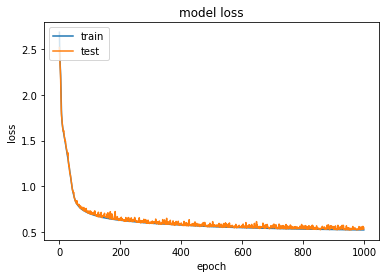

In [23]:
#plt.ylim(0.0,1)
# summarize history for loss
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

# Training

In [65]:
pred_Y_relu = model.predict(X_scaled_train)
#print (pred_Y_relu.tolist())

In [66]:
#print (Y_train)

In [67]:
aux0 = 0
aux1 = 0
aux_1 = 0
aux_2 = 0
auxf = 0
for f, b, T_l in zip(Y_train, pred_Y_relu.tolist(), T_list_train):
    #eq_fb = (int(b) == f)
    if f == int(b[0]):
        aux0 = aux0 + 1
        #print(f, b[0], True)
    else:
        auxf = auxf + 1
        #print(f, b[0], T_l, round(f),  False)
        if round(f) == int(T_l[1]):
            aux_2 = aux_2 + 1
print(aux0, aux1, aux_1, auxf)
print(aux_2)

233129 0 0 344791
262037


In [68]:
print(auxf*100/(aux0+aux1+auxf+aux_1))
print(((aux0+aux1+aux_1)*100)/(aux0+aux1+auxf+aux_1))

print(((aux_2)*100)/(aux0+aux1+auxf+aux_1))

59.66067967884828
40.33932032115172
45.34139673311185


In [69]:
aux0 = 0
aux1 = 0
aux_1 = 0
aux_2 = 0
auxf = 0
for f, b, T_l in zip(Y_train, pred_Y_relu.tolist(), T_list_train):
    #eq_fb = (int(b) == f)
    if f == int(b[0]):
        aux0 = aux0 + 1
        #print(f, b[0], True)
    elif f == (int(b[0])+1):
        aux1 = aux1 + 1
        #print(f, b[0], True)
    elif f == (int(b[0])-1):
        aux_1 = aux_1 + 1
        #print(f, b[0], True)
    else:
        auxf = auxf + 1
        print(f, b[0], T_l, round(f),  False)
        if round(f) == int(T_l[1]):
            aux_2 = aux_2 + 1
            print(f, b[0], T_l, round(f),  True)
print(aux0, aux1, aux_1, auxf)
print(aux_2)

6 3.6326370239257812 [6, 5, 4, 7, 3, 8, 9, 2, 10, 11, 12, 1] 6 False
6 3.6326370239257812 [6, 5, 4, 7, 3, 8, 9, 2, 10, 11, 12, 1] 6 True
6 4.537118911743164 [6, 5, 4, 7, 3, 8, 9, 2, 10, 11, 12, 1] 6 False
6 4.537118911743164 [6, 5, 4, 7, 3, 8, 9, 2, 10, 11, 12, 1] 6 True
6 2.8123717308044434 [6, 4, 3, 5, 2, 1, 7, 8, 9, 10, 11, 12] 6 False
6 2.8123717308044434 [6, 4, 3, 5, 2, 1, 7, 8, 9, 10, 11, 12] 6 True
6 4.637256145477295 [6, 4, 5, 8, 10, 7, 3, 9, 2, 11, 12, 1] 6 False
6 4.637256145477295 [6, 4, 5, 8, 10, 7, 3, 9, 2, 11, 12, 1] 6 True
6 3.0833916664123535 [6, 2, 4, 3, 5, 1, 7, 8, 9, 10, 11, 12] 6 False
6 3.0833916664123535 [6, 2, 4, 3, 5, 1, 7, 8, 9, 10, 11, 12] 6 True
5 2.7595438957214355 [5, 6, 2, 4, 3, 1, 7, 8, 9, 10, 11, 12] 5 False
5 2.7595438957214355 [5, 6, 2, 4, 3, 1, 7, 8, 9, 10, 11, 12] 5 True
4 2.9314117431640625 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 2.9314117431640625 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 True
5 2.8043432235717773 [5, 6, 2, 4, 3, 1, 7, 8,

4 2.62672758102417 [4, 2, 3, 6, 5, 8, 7, 1, 10, 9, 12, 11] 4 True
8 10.191657066345215 [8, 9, 7, 11, 6, 5, 10, 4, 12, 3, 2, 1] 8 False
8 10.191657066345215 [8, 9, 7, 11, 6, 5, 10, 4, 12, 3, 2, 1] 8 True
10 12.399232864379883 [10, 12, 11, 9, 8, 7, 6, 5, 4, 3, 2, 1] 10 False
10 12.046896934509277 [10, 11, 9, 8, 12, 7, 6, 5, 4, 3, 2, 1] 10 False
6 4.376250743865967 [6, 5, 4, 7, 3, 8, 9, 2, 10, 11, 12, 1] 6 False
6 4.376250743865967 [6, 5, 4, 7, 3, 8, 9, 2, 10, 11, 12, 1] 6 True
12 8.989569664001465 [12, 11, 4, 10, 6, 5, 8, 3, 9, 7, 2, 1] 12 False
6 8.754542350769043 [8, 6, 7, 10, 9, 4, 5, 3, 12, 11, 2, 1] 6 False
2 11.268165588378906 [2, 12, 11, 10, 3, 9, 4, 8, 7, 5, 1, 6] 2 False
2 11.268165588378906 [2, 12, 11, 10, 3, 9, 4, 8, 7, 5, 1, 6] 2 True
8 6.735799789428711 [8, 7, 10, 5, 9, 6, 4, 12, 11, 3, 2, 1] 8 False
8 6.735799789428711 [8, 7, 10, 5, 9, 6, 4, 12, 11, 3, 2, 1] 8 True
8 10.094210624694824 [8, 7, 10, 9, 11, 6, 5, 12, 4, 3, 2, 1] 8 False
8 10.094210624694824 [8, 7, 10, 9, 11, 6,

5 3.6561994552612305 [5, 4, 3, 6, 2, 7, 8, 1, 9, 10, 11, 12] 5 True
10 7.794017791748047 [10, 6, 12, 5, 9, 7, 11, 4, 8, 3, 2, 1] 10 False
9 11.059927940368652 [9, 12, 11, 7, 8, 10, 6, 5, 4, 3, 2, 1] 9 False
9 11.059927940368652 [9, 12, 11, 7, 8, 10, 6, 5, 4, 3, 2, 1] 9 True
4 2.4186651706695557 [4, 3, 1, 5, 6, 2, 7, 8, 9, 10, 11, 12] 4 False
4 2.4186651706695557 [4, 3, 1, 5, 6, 2, 7, 8, 9, 10, 11, 12] 4 True
6 9.120443344116211 [6, 10, 8, 4, 5, 11, 7, 12, 9, 3, 2, 1] 6 False
6 9.120443344116211 [6, 10, 8, 4, 5, 11, 7, 12, 9, 3, 2, 1] 6 True
12 10.276695251464844 [12, 10, 11, 8, 9, 7, 6, 5, 4, 3, 2, 1] 12 False
10 12.027305603027344 [10, 11, 9, 8, 12, 7, 6, 5, 4, 3, 2, 1] 10 False
2 11.294026374816895 [2, 12, 11, 10, 3, 9, 4, 8, 7, 5, 1, 6] 2 False
2 11.294026374816895 [2, 12, 11, 10, 3, 9, 4, 8, 7, 5, 1, 6] 2 True
6 9.078022956848145 [6, 5, 8, 7, 9, 4, 3, 11, 12, 10, 2, 1] 6 False
6 9.078022956848145 [6, 5, 8, 7, 9, 4, 3, 11, 12, 10, 2, 1] 6 True
12 9.748109817504883 [12, 10, 9, 7, 11,

2 11.686262130737305 [2, 3, 12, 11, 10, 4, 9, 8, 5, 1, 7, 6] 2 False
2 11.686262130737305 [2, 3, 12, 11, 10, 4, 9, 8, 5, 1, 7, 6] 2 True
10 8.115201950073242 [10, 8, 6, 7, 9, 11, 5, 12, 4, 3, 2, 1] 10 False
5 3.6766324043273926 [5, 4, 3, 6, 2, 7, 8, 1, 9, 10, 11, 12] 5 False
5 3.6766324043273926 [5, 4, 3, 6, 2, 7, 8, 1, 9, 10, 11, 12] 5 True
11 9.559118270874023 [11, 10, 9, 12, 7, 8, 6, 5, 4, 3, 2, 1] 11 False
4 2.976531505584717 [4, 3, 5, 2, 6, 1, 7, 8, 9, 10, 11, 12] 4 False
4 2.976531505584717 [4, 3, 5, 2, 6, 1, 7, 8, 9, 10, 11, 12] 4 True
9 7.865338325500488 [9, 6, 8, 7, 10, 5, 4, 12, 3, 2, 11, 1] 9 False
9 7.865338325500488 [9, 6, 8, 7, 10, 5, 4, 12, 3, 2, 11, 1] 9 True
12 9.128782272338867 [12, 11, 4, 10, 6, 5, 8, 3, 9, 7, 2, 1] 12 False
4 2.9836511611938477 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 2.9836511611938477 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 True
5 7.988046646118164 [5, 6, 9, 8, 10, 7, 11, 4, 12, 3, 2, 1] 5 False
5 7.988046646118164 [5, 6, 9, 8, 10, 7, 1

6 8.48337459564209 [6, 9, 5, 8, 4, 7, 3, 12, 11, 10, 2, 1] 6 False
6 8.48337459564209 [6, 9, 5, 8, 4, 7, 3, 12, 11, 10, 2, 1] 6 True
6 3.705580234527588 [6, 2, 4, 3, 7, 5, 1, 8, 9, 10, 11, 12] 6 False
6 3.705580234527588 [6, 2, 4, 3, 7, 5, 1, 8, 9, 10, 11, 12] 6 True
5 3.924520969390869 [5, 2, 4, 3, 6, 7, 1, 8, 9, 10, 11, 12] 5 False
5 3.924520969390869 [5, 2, 4, 3, 6, 7, 1, 8, 9, 10, 11, 12] 5 True
6 4.494202613830566 [6, 2, 4, 8, 10, 12, 5, 11, 3, 7, 9, 1] 6 False
6 4.494202613830566 [6, 2, 4, 8, 10, 12, 5, 11, 3, 7, 9, 1] 6 True
5 7.970709800720215 [5, 6, 9, 8, 10, 7, 11, 4, 12, 3, 2, 1] 5 False
5 7.970709800720215 [5, 6, 9, 8, 10, 7, 11, 4, 12, 3, 2, 1] 5 True
10 8.930585861206055 [10, 8, 7, 6, 9, 5, 12, 4, 3, 11, 2, 1] 10 False
5 7.969534873962402 [5, 6, 9, 8, 10, 7, 11, 4, 12, 3, 2, 1] 5 False
5 7.969534873962402 [5, 6, 9, 8, 10, 7, 11, 4, 12, 3, 2, 1] 5 True
6 8.532143592834473 [6, 9, 5, 8, 4, 7, 3, 12, 11, 10, 2, 1] 6 False
6 8.532143592834473 [6, 9, 5, 8, 4, 7, 3, 12, 11, 10, 

6 8.639816284179688 [6, 10, 8, 4, 5, 11, 7, 12, 9, 3, 2, 1] 6 True
12 10.642718315124512 [12, 10, 9, 8, 7, 6, 3, 5, 4, 11, 2, 1] 12 False
10 7.902500152587891 [10, 8, 6, 7, 9, 11, 5, 12, 4, 3, 2, 1] 10 False
6 9.085946083068848 [6, 5, 8, 7, 9, 4, 3, 11, 12, 10, 2, 1] 6 False
6 9.085946083068848 [6, 5, 8, 7, 9, 4, 3, 11, 12, 10, 2, 1] 6 True
2 11.217611312866211 [2, 3, 12, 11, 10, 9, 4, 8, 7, 5, 1, 6] 2 False
2 11.217611312866211 [2, 3, 12, 11, 10, 9, 4, 8, 7, 5, 1, 6] 2 True
2 11.680703163146973 [2, 12, 11, 10, 3, 9, 4, 8, 7, 5, 1, 6] 2 False
2 11.680703163146973 [2, 12, 11, 10, 3, 9, 4, 8, 7, 5, 1, 6] 2 True
8 10.32301139831543 [8, 9, 6, 11, 10, 7, 5, 12, 4, 3, 2, 1] 8 False
8 10.32301139831543 [8, 9, 6, 11, 10, 7, 5, 12, 4, 3, 2, 1] 8 True
6 3.7523741722106934 [6, 2, 4, 3, 7, 5, 1, 8, 9, 10, 11, 12] 6 False
6 3.7523741722106934 [6, 2, 4, 3, 7, 5, 1, 8, 9, 10, 11, 12] 6 True
4 2.441710948944092 [4, 2, 3, 6, 5, 8, 7, 1, 10, 9, 12, 11] 4 False
4 2.441710948944092 [4, 2, 3, 6, 5, 8, 7, 1

8 10.362306594848633 [8, 9, 6, 11, 10, 7, 5, 12, 4, 3, 2, 1] 8 False
8 10.362306594848633 [8, 9, 6, 11, 10, 7, 5, 12, 4, 3, 2, 1] 8 True
2 11.297887802124023 [2, 3, 12, 11, 10, 9, 4, 8, 7, 5, 1, 6] 2 False
2 11.297887802124023 [2, 3, 12, 11, 10, 9, 4, 8, 7, 5, 1, 6] 2 True
2 11.670672416687012 [2, 3, 12, 11, 10, 4, 9, 8, 5, 1, 7, 6] 2 False
2 11.670672416687012 [2, 3, 12, 11, 10, 4, 9, 8, 5, 1, 7, 6] 2 True
2 4.051917552947998 [2, 3, 5, 7, 4, 8, 6, 9, 10, 1, 11, 12] 2 False
2 4.051917552947998 [2, 3, 5, 7, 4, 8, 6, 9, 10, 1, 11, 12] 2 True
5 2.614602565765381 [5, 6, 2, 4, 3, 1, 7, 8, 9, 10, 11, 12] 5 False
5 2.614602565765381 [5, 6, 2, 4, 3, 1, 7, 8, 9, 10, 11, 12] 5 True
4 2.989694595336914 [4, 3, 5, 2, 6, 1, 7, 8, 9, 10, 11, 12] 4 False
4 2.989694595336914 [4, 3, 5, 2, 6, 1, 7, 8, 9, 10, 11, 12] 4 True
2 4.20266056060791 [2, 3, 5, 7, 4, 8, 6, 9, 10, 1, 11, 12] 2 False
2 4.20266056060791 [2, 3, 5, 7, 4, 8, 6, 9, 10, 1, 11, 12] 2 True
6 4.855734348297119 [6, 3, 5, 7, 4, 8, 2, 9, 10, 11

9 11.174342155456543 [9, 12, 11, 7, 8, 10, 6, 5, 4, 3, 2, 1] 9 False
9 11.174342155456543 [9, 12, 11, 7, 8, 10, 6, 5, 4, 3, 2, 1] 9 True
12 10.513394355773926 [12, 10, 11, 8, 9, 7, 6, 5, 4, 3, 2, 1] 12 False
10 8.447745323181152 [10, 6, 12, 5, 9, 7, 11, 4, 8, 3, 2, 1] 10 False
6 4.353329658508301 [6, 2, 4, 8, 10, 12, 5, 3, 7, 11, 9, 1] 6 False
6 4.353329658508301 [6, 2, 4, 8, 10, 12, 5, 3, 7, 11, 9, 1] 6 True
10 12.375326156616211 [10, 12, 11, 9, 8, 7, 6, 5, 4, 3, 2, 1] 10 False
6 8.666715621948242 [8, 6, 7, 10, 9, 4, 5, 3, 12, 11, 2, 1] 6 False
5 2.9119763374328613 [5, 6, 2, 4, 3, 1, 7, 8, 9, 10, 11, 12] 5 False
5 2.9119763374328613 [5, 6, 2, 4, 3, 1, 7, 8, 9, 10, 11, 12] 5 True
2 11.033309936523438 [2, 3, 12, 11, 10, 4, 9, 8, 5, 1, 7, 6] 2 False
2 11.033309936523438 [2, 3, 12, 11, 10, 4, 9, 8, 5, 1, 7, 6] 2 True
2 4.419949531555176 [2, 3, 5, 7, 4, 8, 6, 9, 10, 1, 11, 12] 2 False
2 4.419949531555176 [2, 3, 5, 7, 4, 8, 6, 9, 10, 1, 11, 12] 2 True
10 12.136373519897461 [10, 11, 9, 8, 12

3 1.90425705909729 [3, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 False
3 1.90425705909729 [3, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 True
9 7.7810564041137695 [9, 6, 8, 7, 10, 5, 4, 12, 3, 2, 11, 1] 9 False
9 7.7810564041137695 [9, 6, 8, 7, 10, 5, 4, 12, 3, 2, 11, 1] 9 True
3 1.9584836959838867 [3, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 False
3 1.9584836959838867 [3, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 True
8 10.203755378723145 [8, 9, 7, 11, 6, 5, 10, 4, 12, 3, 2, 1] 8 False
8 10.203755378723145 [8, 9, 7, 11, 6, 5, 10, 4, 12, 3, 2, 1] 8 True
11 9.306180953979492 [11, 10, 9, 12, 7, 8, 6, 5, 4, 3, 2, 1] 11 False
10 7.848193168640137 [10, 8, 6, 7, 9, 11, 5, 12, 4, 3, 2, 1] 10 False
12 9.05314826965332 [12, 11, 4, 10, 6, 5, 8, 3, 9, 7, 2, 1] 12 False
12 9.868132591247559 [12, 10, 9, 7, 11, 8, 6, 5, 4, 3, 2, 1] 12 False
6 4.882763862609863 [6, 8, 7, 2, 4, 5, 10, 3, 9, 12, 11, 1] 6 False
6 4.882763862609863 [6, 8, 7, 2, 4, 5, 10, 3, 9, 12, 11, 1] 6 True
3 1.8827946186065674 [3, 1, 2, 4, 5, 6, 7,

6 4.794198036193848 [6, 3, 5, 7, 4, 8, 2, 9, 10, 11, 1, 12] 6 False
6 4.794198036193848 [6, 3, 5, 7, 4, 8, 2, 9, 10, 11, 1, 12] 6 True
5 2.9990243911743164 [5, 6, 2, 4, 3, 1, 7, 8, 9, 10, 11, 12] 5 False
5 2.9990243911743164 [5, 6, 2, 4, 3, 1, 7, 8, 9, 10, 11, 12] 5 True
6 4.90692138671875 [6, 5, 8, 4, 7, 9, 3, 10, 11, 2, 12, 1] 6 False
6 4.90692138671875 [6, 5, 8, 4, 7, 9, 3, 10, 11, 2, 12, 1] 6 True
2 11.330459594726562 [2, 12, 11, 10, 3, 9, 4, 8, 7, 5, 1, 6] 2 False
2 11.330459594726562 [2, 12, 11, 10, 3, 9, 4, 8, 7, 5, 1, 6] 2 True
5 3.050662040710449 [5, 6, 2, 4, 3, 1, 7, 8, 9, 10, 11, 12] 5 False
5 3.050662040710449 [5, 6, 2, 4, 3, 1, 7, 8, 9, 10, 11, 12] 5 True
12 9.888548851013184 [12, 10, 9, 7, 11, 8, 6, 5, 4, 3, 2, 1] 12 False
10 8.913681030273438 [10, 9, 8, 7, 6, 5, 4, 3, 12, 11, 2, 1] 10 False
5 2.876707077026367 [5, 6, 2, 4, 3, 1, 7, 8, 9, 10, 11, 12] 5 False
5 2.876707077026367 [5, 6, 2, 4, 3, 1, 7, 8, 9, 10, 11, 12] 5 True
6 2.8126797676086426 [6, 2, 4, 3, 5, 1, 7, 8, 9,

4 2.3833506107330322 [4, 3, 1, 5, 6, 2, 7, 8, 9, 10, 11, 12] 4 True
4 1.9784860610961914 [4, 2, 3, 6, 5, 8, 7, 1, 10, 9, 12, 11] 4 False
4 1.9784860610961914 [4, 2, 3, 6, 5, 8, 7, 1, 10, 9, 12, 11] 4 True
5 7.031441688537598 [5, 7, 6, 9, 8, 4, 3, 2, 12, 11, 10, 1] 5 False
5 7.031441688537598 [5, 7, 6, 9, 8, 4, 3, 2, 12, 11, 10, 1] 5 True
10 7.788830757141113 [10, 9, 7, 6, 8, 5, 12, 11, 4, 3, 2, 1] 10 False
6 3.4140071868896484 [6, 2, 4, 3, 7, 5, 1, 8, 9, 10, 11, 12] 6 False
6 3.4140071868896484 [6, 2, 4, 3, 7, 5, 1, 8, 9, 10, 11, 12] 6 True
10 12.155293464660645 [10, 11, 9, 8, 12, 7, 6, 5, 4, 3, 2, 1] 10 False
6 9.003417015075684 [8, 6, 7, 10, 9, 4, 5, 3, 12, 11, 2, 1] 6 False
3 1.8271899223327637 [3, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 False
3 1.8271899223327637 [3, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 True
10 12.064207077026367 [10, 11, 9, 8, 12, 7, 6, 5, 4, 3, 2, 1] 10 False
12 9.230698585510254 [12, 11, 4, 10, 6, 5, 8, 3, 9, 7, 2, 1] 12 False
5 3.828907012939453 [5, 2, 4, 3, 6, 

5 3.8664565086364746 [5, 4, 3, 6, 2, 7, 8, 1, 9, 10, 11, 12] 5 False
5 3.8664565086364746 [5, 4, 3, 6, 2, 7, 8, 1, 9, 10, 11, 12] 5 True
2 4.486386299133301 [2, 3, 5, 7, 4, 8, 6, 9, 10, 1, 11, 12] 2 False
2 4.486386299133301 [2, 3, 5, 7, 4, 8, 6, 9, 10, 1, 11, 12] 2 True
4 2.963192939758301 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 2.963192939758301 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 True
8 6.796698570251465 [8, 7, 5, 10, 6, 9, 3, 12, 4, 11, 2, 1] 8 False
8 6.796698570251465 [8, 7, 5, 10, 6, 9, 3, 12, 4, 11, 2, 1] 8 True
6 3.7043561935424805 [6, 5, 4, 7, 3, 8, 9, 2, 10, 11, 12, 1] 6 False
6 3.7043561935424805 [6, 5, 4, 7, 3, 8, 9, 2, 10, 11, 12, 1] 6 True
2 4.317887306213379 [2, 3, 5, 7, 4, 8, 6, 9, 10, 1, 11, 12] 2 False
2 4.317887306213379 [2, 3, 5, 7, 4, 8, 6, 9, 10, 1, 11, 12] 2 True
4 6.426661491394043 [4, 5, 6, 3, 8, 7, 9, 10, 2, 11, 12, 1] 4 False
4 6.426661491394043 [4, 5, 6, 3, 8, 7, 9, 10, 2, 11, 12, 1] 4 True
4 2.9850072860717773 [4, 3, 2, 5, 6, 1, 7, 8, 9, 10

5 7.346593856811523 [5, 7, 6, 9, 8, 4, 3, 2, 12, 11, 10, 1] 5 False
5 7.346593856811523 [5, 7, 6, 9, 8, 4, 3, 2, 12, 11, 10, 1] 5 True
6 3.1538896560668945 [6, 2, 4, 3, 5, 1, 7, 8, 9, 10, 11, 12] 6 False
6 3.1538896560668945 [6, 2, 4, 3, 5, 1, 7, 8, 9, 10, 11, 12] 6 True
8 6.212092876434326 [8, 4, 6, 7, 10, 5, 9, 12, 3, 11, 2, 1] 8 False
8 6.212092876434326 [8, 4, 6, 7, 10, 5, 9, 12, 3, 11, 2, 1] 8 True
4 2.883857250213623 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 2.883857250213623 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 True
10 8.413719177246094 [10, 6, 12, 5, 9, 7, 11, 4, 8, 3, 2, 1] 10 False
10 12.092793464660645 [10, 11, 9, 8, 12, 7, 6, 5, 4, 3, 2, 1] 10 False
5 3.079397201538086 [5, 4, 3, 6, 2, 7, 1, 8, 9, 10, 11, 12] 5 False
5 3.079397201538086 [5, 4, 3, 6, 2, 7, 1, 8, 9, 10, 11, 12] 5 True
5 3.7821831703186035 [5, 4, 3, 6, 2, 7, 8, 1, 9, 10, 11, 12] 5 False
5 3.7821831703186035 [5, 4, 3, 6, 2, 7, 8, 1, 9, 10, 11, 12] 5 True
6 4.629845142364502 [6, 3, 5, 7, 4, 8, 2, 9, 

5 2.533918857574463 [5, 6, 2, 4, 3, 1, 7, 8, 9, 10, 11, 12] 5 True
6 4.492227077484131 [6, 5, 4, 7, 3, 8, 9, 2, 10, 11, 12, 1] 6 False
6 4.492227077484131 [6, 5, 4, 7, 3, 8, 9, 2, 10, 11, 12, 1] 6 True
9 11.307275772094727 [9, 12, 11, 7, 8, 10, 6, 5, 4, 3, 2, 1] 9 False
9 11.307275772094727 [9, 12, 11, 7, 8, 10, 6, 5, 4, 3, 2, 1] 9 True
6 4.737317085266113 [6, 8, 7, 2, 4, 5, 10, 3, 9, 12, 11, 1] 6 False
6 4.737317085266113 [6, 8, 7, 2, 4, 5, 10, 3, 9, 12, 11, 1] 6 True
6 3.9863929748535156 [6, 2, 4, 8, 10, 12, 5, 3, 7, 11, 9, 1] 6 False
6 3.9863929748535156 [6, 2, 4, 8, 10, 12, 5, 3, 7, 11, 9, 1] 6 True
4 6.847444534301758 [4, 5, 6, 3, 8, 7, 10, 9, 2, 12, 11, 1] 4 False
4 6.847444534301758 [4, 5, 6, 3, 8, 7, 10, 9, 2, 12, 11, 1] 4 True
6 3.315556049346924 [6, 2, 4, 8, 10, 12, 5, 3, 7, 11, 9, 1] 6 False
6 3.315556049346924 [6, 2, 4, 8, 10, 12, 5, 3, 7, 11, 9, 1] 6 True
4 2.6841073036193848 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 2.6841073036193848 [4, 2, 3, 5, 1, 6, 7, 8, 9, 1

4 6.108869552612305 [4, 6, 5, 8, 7, 9, 3, 11, 12, 10, 2, 1] 4 False
4 6.108869552612305 [4, 6, 5, 8, 7, 9, 3, 11, 12, 10, 2, 1] 4 True
6 4.861482620239258 [6, 4, 5, 8, 10, 7, 3, 9, 2, 11, 12, 1] 6 False
6 4.861482620239258 [6, 4, 5, 8, 10, 7, 3, 9, 2, 11, 12, 1] 6 True
10 12.324617385864258 [10, 12, 11, 9, 8, 7, 6, 5, 4, 3, 2, 1] 10 False
6 4.988855838775635 [6, 5, 3, 4, 8, 7, 2, 10, 9, 12, 11, 1] 6 False
6 4.988855838775635 [6, 5, 3, 4, 8, 7, 2, 10, 9, 12, 11, 1] 6 True
3 1.9855155944824219 [3, 1, 2, 4, 6, 7, 5, 8, 9, 10, 11, 12] 3 False
3 1.9855155944824219 [3, 1, 2, 4, 6, 7, 5, 8, 9, 10, 11, 12] 3 True
11 9.266221046447754 [11, 10, 9, 12, 7, 8, 6, 5, 4, 3, 2, 1] 11 False
11 9.301017761230469 [11, 10, 9, 8, 6, 7, 5, 12, 4, 3, 2, 1] 11 False
5 8.446979522705078 [5, 6, 9, 8, 10, 7, 11, 4, 12, 3, 2, 1] 5 False
5 8.446979522705078 [5, 6, 9, 8, 10, 7, 11, 4, 12, 3, 2, 1] 5 True
10 12.388916969299316 [10, 12, 11, 9, 8, 7, 6, 5, 4, 3, 2, 1] 10 False
5 3.853675365447998 [5, 2, 4, 3, 6, 7, 1,

6 3.955777168273926 [6, 5, 4, 7, 3, 8, 9, 2, 10, 11, 12, 1] 6 False
6 3.955777168273926 [6, 5, 4, 7, 3, 8, 9, 2, 10, 11, 12, 1] 6 True
4 1.9789257049560547 [4, 2, 3, 6, 5, 8, 7, 1, 10, 9, 12, 11] 4 False
4 1.9789257049560547 [4, 2, 3, 6, 5, 8, 7, 1, 10, 9, 12, 11] 4 True
8 6.769102096557617 [8, 7, 5, 10, 6, 9, 3, 12, 4, 11, 2, 1] 8 False
8 6.769102096557617 [8, 7, 5, 10, 6, 9, 3, 12, 4, 11, 2, 1] 8 True
4 2.817502021789551 [4, 3, 5, 2, 6, 1, 7, 8, 9, 10, 11, 12] 4 False
4 2.817502021789551 [4, 3, 5, 2, 6, 1, 7, 8, 9, 10, 11, 12] 4 True
4 2.796017646789551 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 2.796017646789551 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 True
6 4.923737049102783 [6, 4, 8, 5, 3, 7, 10, 9, 2, 12, 11, 1] 6 False
6 4.923737049102783 [6, 4, 8, 5, 3, 7, 10, 9, 2, 12, 11, 1] 6 True
4 6.246232032775879 [4, 5, 6, 3, 8, 7, 9, 10, 2, 11, 12, 1] 4 False
4 6.246232032775879 [4, 5, 6, 3, 8, 7, 9, 10, 2, 11, 12, 1] 4 True
8 10.400623321533203 [8, 9, 6, 11, 10, 7, 5, 12, 4, 3

6 4.69486665725708 [6, 4, 5, 8, 10, 7, 3, 9, 2, 11, 12, 1] 6 False
6 4.69486665725708 [6, 4, 5, 8, 10, 7, 3, 9, 2, 11, 12, 1] 6 True
6 4.19720983505249 [6, 5, 8, 4, 7, 9, 3, 10, 11, 2, 12, 1] 6 False
6 4.19720983505249 [6, 5, 8, 4, 7, 9, 3, 10, 11, 2, 12, 1] 6 True
10 8.956467628479004 [10, 9, 8, 7, 6, 5, 4, 3, 12, 11, 2, 1] 10 False
12 9.892908096313477 [12, 10, 9, 7, 11, 8, 6, 5, 4, 3, 2, 1] 12 False
6 3.902647018432617 [6, 2, 4, 3, 7, 5, 1, 8, 9, 10, 11, 12] 6 False
6 3.902647018432617 [6, 2, 4, 3, 7, 5, 1, 8, 9, 10, 11, 12] 6 True
8 6.171917915344238 [8, 4, 6, 7, 10, 5, 9, 12, 3, 11, 2, 1] 8 False
8 6.171917915344238 [8, 4, 6, 7, 10, 5, 9, 12, 3, 11, 2, 1] 8 True
10 12.39039421081543 [10, 12, 11, 9, 8, 7, 6, 5, 4, 3, 2, 1] 10 False
4 2.794206142425537 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 2.794206142425537 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 True
6 4.499539852142334 [6, 2, 4, 8, 10, 12, 5, 11, 3, 7, 9, 1] 6 False
6 4.499539852142334 [6, 2, 4, 8, 10, 12, 5, 11, 3, 

6 9.141666412353516 [6, 5, 8, 7, 9, 4, 3, 11, 12, 10, 2, 1] 6 False
6 9.141666412353516 [6, 5, 8, 7, 9, 4, 3, 11, 12, 10, 2, 1] 6 True
5 7.9848175048828125 [5, 6, 9, 8, 10, 7, 11, 4, 12, 3, 2, 1] 5 False
5 7.9848175048828125 [5, 6, 9, 8, 10, 7, 11, 4, 12, 3, 2, 1] 5 True
5 3.7648262977600098 [5, 4, 3, 6, 2, 7, 8, 1, 9, 10, 11, 12] 5 False
5 3.7648262977600098 [5, 4, 3, 6, 2, 7, 8, 1, 9, 10, 11, 12] 5 True
4 2.365976333618164 [4, 2, 3, 6, 5, 8, 7, 1, 10, 9, 12, 11] 4 False
4 2.365976333618164 [4, 2, 3, 6, 5, 8, 7, 1, 10, 9, 12, 11] 4 True
11 9.404387474060059 [11, 10, 9, 12, 7, 8, 6, 5, 4, 3, 2, 1] 11 False
4 2.932748794555664 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 2.932748794555664 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 True
10 12.148743629455566 [10, 11, 9, 8, 12, 7, 6, 5, 4, 3, 2, 1] 10 False
9 11.21406078338623 [9, 12, 11, 7, 8, 10, 6, 5, 4, 3, 2, 1] 9 False
9 11.21406078338623 [9, 12, 11, 7, 8, 10, 6, 5, 4, 3, 2, 1] 9 True
12 9.180752754211426 [12, 11, 4, 10, 6, 5, 8,

12 10.234461784362793 [12, 10, 9, 8, 7, 6, 3, 5, 4, 11, 2, 1] 12 False
6 8.708328247070312 [8, 6, 7, 10, 9, 4, 5, 3, 12, 11, 2, 1] 6 False
6 4.567351818084717 [6, 5, 7, 9, 4, 8, 3, 10, 11, 2, 12, 1] 6 False
6 4.567351818084717 [6, 5, 7, 9, 4, 8, 3, 10, 11, 2, 12, 1] 6 True
4 2.533505916595459 [4, 2, 3, 6, 5, 8, 7, 1, 10, 9, 12, 11] 4 False
4 2.533505916595459 [4, 2, 3, 6, 5, 8, 7, 1, 10, 9, 12, 11] 4 True
6 8.91497802734375 [6, 8, 5, 7, 11, 9, 4, 10, 12, 3, 2, 1] 6 False
6 8.91497802734375 [6, 8, 5, 7, 11, 9, 4, 10, 12, 3, 2, 1] 6 True
6 8.52103042602539 [6, 8, 5, 7, 11, 9, 4, 10, 12, 3, 2, 1] 6 False
6 8.52103042602539 [6, 8, 5, 7, 11, 9, 4, 10, 12, 3, 2, 1] 6 True
2 4.52327299118042 [2, 3, 5, 7, 4, 8, 6, 9, 10, 1, 11, 12] 2 False
2 4.52327299118042 [2, 3, 5, 7, 4, 8, 6, 9, 10, 1, 11, 12] 2 True
6 4.376262187957764 [6, 5, 4, 7, 3, 8, 9, 2, 10, 11, 12, 1] 6 False
6 4.376262187957764 [6, 5, 4, 7, 3, 8, 9, 2, 10, 11, 12, 1] 6 True
8 6.222250938415527 [8, 4, 6, 7, 10, 5, 9, 12, 3, 11, 2, 

6 4.562500953674316 [6, 5, 3, 4, 8, 7, 2, 10, 9, 12, 11, 1] 6 False
6 4.562500953674316 [6, 5, 3, 4, 8, 7, 2, 10, 9, 12, 11, 1] 6 True
4 2.951643466949463 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 2.951643466949463 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 True
6 4.7189154624938965 [6, 4, 5, 8, 7, 3, 10, 9, 12, 11, 2, 1] 6 False
6 4.7189154624938965 [6, 4, 5, 8, 7, 3, 10, 9, 12, 11, 2, 1] 6 True
6 4.003984451293945 [6, 2, 4, 3, 7, 5, 1, 8, 9, 10, 11, 12] 6 False
6 4.003984451293945 [6, 2, 4, 3, 7, 5, 1, 8, 9, 10, 11, 12] 6 True
2 4.46901273727417 [2, 3, 5, 7, 4, 8, 6, 9, 10, 1, 11, 12] 2 False
2 4.46901273727417 [2, 3, 5, 7, 4, 8, 6, 9, 10, 1, 11, 12] 2 True
4 6.484962463378906 [4, 5, 6, 3, 8, 7, 10, 9, 2, 12, 11, 1] 4 False
4 6.484962463378906 [4, 5, 6, 3, 8, 7, 10, 9, 2, 12, 11, 1] 4 True
6 4.7506303787231445 [6, 4, 5, 8, 7, 3, 10, 9, 12, 11, 2, 1] 6 False
6 4.7506303787231445 [6, 4, 5, 8, 7, 3, 10, 9, 12, 11, 2, 1] 6 True
6 8.77763557434082 [6, 10, 8, 4, 5, 11, 7, 12, 9, 3, 

6 8.352256774902344 [6, 9, 5, 8, 4, 7, 3, 12, 11, 10, 2, 1] 6 False
6 8.352256774902344 [6, 9, 5, 8, 4, 7, 3, 12, 11, 10, 2, 1] 6 True
4 2.7527999877929688 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 2.7527999877929688 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 True
4 6.324331283569336 [4, 5, 6, 3, 8, 7, 10, 9, 2, 12, 11, 1] 4 False
4 6.324331283569336 [4, 5, 6, 3, 8, 7, 10, 9, 2, 12, 11, 1] 4 True
12 8.590834617614746 [12, 11, 4, 10, 6, 5, 8, 3, 9, 7, 2, 1] 12 False
6 4.691843032836914 [6, 3, 5, 7, 4, 8, 2, 9, 10, 11, 1, 12] 6 False
6 4.691843032836914 [6, 3, 5, 7, 4, 8, 2, 9, 10, 11, 1, 12] 6 True
10 12.143712997436523 [10, 11, 9, 8, 12, 7, 6, 5, 4, 3, 2, 1] 10 False
3 1.8265514373779297 [3, 2, 1, 4, 6, 5, 7, 8, 9, 10, 11, 12] 3 False
3 1.8265514373779297 [3, 2, 1, 4, 6, 5, 7, 8, 9, 10, 11, 12] 3 True
8 6.762125015258789 [8, 7, 5, 10, 6, 9, 3, 12, 4, 11, 2, 1] 8 False
8 6.762125015258789 [8, 7, 5, 10, 6, 9, 3, 12, 4, 11, 2, 1] 8 True
5 8.341065406799316 [5, 6, 9, 8, 10, 7, 11, 4

2 11.904417991638184 [2, 3, 12, 11, 10, 4, 9, 8, 5, 1, 7, 6] 2 True
6 3.838143825531006 [6, 2, 4, 3, 7, 5, 1, 8, 9, 10, 11, 12] 6 False
6 3.838143825531006 [6, 2, 4, 3, 7, 5, 1, 8, 9, 10, 11, 12] 6 True
12 8.994071960449219 [12, 11, 4, 10, 6, 5, 8, 3, 9, 7, 2, 1] 12 False
6 4.494502544403076 [6, 5, 4, 7, 3, 8, 9, 2, 10, 11, 12, 1] 6 False
6 4.494502544403076 [6, 5, 4, 7, 3, 8, 9, 2, 10, 11, 12, 1] 6 True
5 3.512601375579834 [5, 2, 4, 3, 6, 7, 1, 8, 9, 10, 11, 12] 5 False
5 3.512601375579834 [5, 2, 4, 3, 6, 7, 1, 8, 9, 10, 11, 12] 5 True
4 6.132535934448242 [4, 5, 6, 3, 8, 7, 10, 9, 2, 12, 11, 1] 4 False
4 6.132535934448242 [4, 5, 6, 3, 8, 7, 10, 9, 2, 12, 11, 1] 4 True
4 2.9043712615966797 [4, 3, 5, 2, 6, 1, 7, 8, 9, 10, 11, 12] 4 False
4 2.9043712615966797 [4, 3, 5, 2, 6, 1, 7, 8, 9, 10, 11, 12] 4 True
10 8.003839492797852 [10, 8, 6, 7, 9, 11, 5, 12, 4, 3, 2, 1] 10 False
10 8.562500953674316 [10, 9, 7, 6, 8, 5, 12, 11, 4, 3, 2, 1] 10 False
10 8.540693283081055 [10, 9, 7, 6, 8, 5, 12, 

4 2.934361457824707 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 2.934361457824707 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 True
6 4.815617084503174 [6, 4, 5, 3, 7, 8, 9, 2, 10, 11, 12, 1] 6 False
6 4.815617084503174 [6, 4, 5, 3, 7, 8, 9, 2, 10, 11, 12, 1] 6 True
6 4.222427845001221 [6, 5, 8, 4, 7, 9, 3, 10, 11, 2, 12, 1] 6 False
6 4.222427845001221 [6, 5, 8, 4, 7, 9, 3, 10, 11, 2, 12, 1] 6 True
2 11.58576774597168 [2, 3, 12, 11, 10, 9, 4, 8, 7, 5, 1, 6] 2 False
2 11.58576774597168 [2, 3, 12, 11, 10, 9, 4, 8, 7, 5, 1, 6] 2 True
5 3.9682679176330566 [5, 4, 3, 6, 2, 7, 8, 1, 9, 10, 11, 12] 5 False
5 3.9682679176330566 [5, 4, 3, 6, 2, 7, 8, 1, 9, 10, 11, 12] 5 True
12 10.366323471069336 [12, 10, 11, 8, 9, 7, 6, 5, 4, 3, 2, 1] 12 False
4 2.9397544860839844 [4, 3, 7, 5, 1, 6, 9, 2, 8, 10, 12, 11] 4 False
4 2.9397544860839844 [4, 3, 7, 5, 1, 6, 9, 2, 8, 10, 12, 11] 4 True
5 7.988385200500488 [5, 6, 9, 8, 10, 7, 11, 4, 12, 3, 2, 1] 5 False
5 7.988385200500488 [5, 6, 9, 8, 10, 7, 11, 4, 

6 8.105172157287598 [6, 4, 8, 5, 7, 9, 3, 10, 11, 12, 2, 1] 6 False
6 8.105172157287598 [6, 4, 8, 5, 7, 9, 3, 10, 11, 12, 2, 1] 6 True
8 6.670895576477051 [8, 7, 10, 5, 9, 6, 4, 12, 11, 3, 2, 1] 8 False
8 6.670895576477051 [8, 7, 10, 5, 9, 6, 4, 12, 11, 3, 2, 1] 8 True
6 4.8517584800720215 [6, 2, 4, 8, 10, 12, 5, 11, 3, 7, 9, 1] 6 False
6 4.8517584800720215 [6, 2, 4, 8, 10, 12, 5, 11, 3, 7, 9, 1] 6 True
2 11.54163932800293 [2, 3, 12, 11, 10, 9, 4, 8, 7, 5, 1, 6] 2 False
2 11.54163932800293 [2, 3, 12, 11, 10, 9, 4, 8, 7, 5, 1, 6] 2 True
2 11.634381294250488 [2, 12, 11, 10, 3, 9, 4, 8, 7, 5, 1, 6] 2 False
2 11.634381294250488 [2, 12, 11, 10, 3, 9, 4, 8, 7, 5, 1, 6] 2 True
4 2.294728994369507 [4, 3, 1, 5, 6, 2, 7, 8, 9, 10, 11, 12] 4 False
4 2.294728994369507 [4, 3, 1, 5, 6, 2, 7, 8, 9, 10, 11, 12] 4 True
4 2.923532485961914 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 2.923532485961914 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 True
10 7.791748046875 [10, 9, 7, 6, 8, 5, 12, 11, 4, 3,

4 6.743429183959961 [4, 5, 6, 3, 8, 7, 10, 9, 2, 12, 11, 1] 4 False
4 6.743429183959961 [4, 5, 6, 3, 8, 7, 10, 9, 2, 12, 11, 1] 4 True
4 2.486319065093994 [4, 3, 1, 5, 6, 2, 7, 8, 9, 10, 11, 12] 4 False
4 2.486319065093994 [4, 3, 1, 5, 6, 2, 7, 8, 9, 10, 11, 12] 4 True
10 8.973688125610352 [10, 9, 8, 7, 6, 5, 4, 3, 12, 11, 2, 1] 10 False
10 12.336141586303711 [10, 12, 11, 9, 8, 7, 6, 5, 4, 3, 2, 1] 10 False
3 1.9781084060668945 [3, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 False
3 1.9781084060668945 [3, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 True
6 4.811534881591797 [6, 5, 8, 4, 7, 9, 3, 10, 11, 2, 12, 1] 6 False
6 4.811534881591797 [6, 5, 8, 4, 7, 9, 3, 10, 11, 2, 12, 1] 6 True
10 7.851468086242676 [10, 8, 6, 7, 9, 11, 5, 12, 4, 3, 2, 1] 10 False
6 2.8373336791992188 [6, 2, 4, 3, 5, 1, 7, 8, 9, 10, 11, 12] 6 False
6 2.8373336791992188 [6, 2, 4, 3, 5, 1, 7, 8, 9, 10, 11, 12] 6 True
10 12.065881729125977 [10, 11, 9, 8, 12, 7, 6, 5, 4, 3, 2, 1] 10 False
10 8.116231918334961 [10, 8, 6, 7, 9, 1

6 3.5556793212890625 [6, 2, 4, 3, 5, 1, 7, 8, 9, 10, 11, 12] 6 False
6 3.5556793212890625 [6, 2, 4, 3, 5, 1, 7, 8, 9, 10, 11, 12] 6 True
4 6.35447359085083 [4, 5, 6, 3, 8, 7, 9, 10, 2, 11, 12, 1] 4 False
4 6.35447359085083 [4, 5, 6, 3, 8, 7, 9, 10, 2, 11, 12, 1] 4 True
8 10.15260124206543 [8, 9, 7, 11, 6, 5, 10, 4, 12, 3, 2, 1] 8 False
8 10.15260124206543 [8, 9, 7, 11, 6, 5, 10, 4, 12, 3, 2, 1] 8 True
6 3.48270845413208 [6, 2, 4, 3, 7, 5, 1, 8, 9, 10, 11, 12] 6 False
6 3.48270845413208 [6, 2, 4, 3, 7, 5, 1, 8, 9, 10, 11, 12] 6 True
12 9.765366554260254 [12, 10, 9, 7, 11, 8, 6, 5, 4, 3, 2, 1] 12 False
6 8.838688850402832 [6, 10, 8, 4, 5, 11, 7, 12, 9, 3, 2, 1] 6 False
6 8.838688850402832 [6, 10, 8, 4, 5, 11, 7, 12, 9, 3, 2, 1] 6 True
6 4.194154739379883 [6, 2, 4, 8, 10, 12, 5, 3, 7, 11, 9, 1] 6 False
6 4.194154739379883 [6, 2, 4, 8, 10, 12, 5, 3, 7, 11, 9, 1] 6 True
8 6.298432350158691 [8, 4, 6, 7, 10, 5, 9, 12, 3, 11, 2, 1] 8 False
8 6.298432350158691 [8, 4, 6, 7, 10, 5, 9, 12, 3, 11, 

4 2.8017067909240723 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 2.8017067909240723 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 True
8 6.378714561462402 [8, 4, 6, 7, 10, 5, 9, 12, 3, 11, 2, 1] 8 False
8 6.378714561462402 [8, 4, 6, 7, 10, 5, 9, 12, 3, 11, 2, 1] 8 True
4 6.406037330627441 [4, 5, 6, 3, 8, 7, 9, 10, 2, 11, 12, 1] 4 False
4 6.406037330627441 [4, 5, 6, 3, 8, 7, 9, 10, 2, 11, 12, 1] 4 True
8 10.401946067810059 [8, 9, 6, 11, 10, 7, 5, 12, 4, 3, 2, 1] 8 False
8 10.401946067810059 [8, 9, 6, 11, 10, 7, 5, 12, 4, 3, 2, 1] 8 True
4 2.3113229274749756 [4, 3, 1, 5, 6, 2, 7, 8, 9, 10, 11, 12] 4 False
4 2.3113229274749756 [4, 3, 1, 5, 6, 2, 7, 8, 9, 10, 11, 12] 4 True
8 10.242866516113281 [8, 7, 10, 9, 11, 6, 5, 12, 4, 3, 2, 1] 8 False
8 10.242866516113281 [8, 7, 10, 9, 11, 6, 5, 12, 4, 3, 2, 1] 8 True
6 4.7896928787231445 [6, 5, 3, 4, 8, 7, 2, 10, 9, 12, 11, 1] 6 False
6 4.7896928787231445 [6, 5, 3, 4, 8, 7, 2, 10, 9, 12, 11, 1] 6 True
4 2.8990793228149414 [4, 2, 3, 5, 1, 6, 7, 8,

4 2.968254566192627 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 2.968254566192627 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 True
11 9.266559600830078 [11, 10, 9, 8, 6, 7, 5, 12, 4, 3, 2, 1] 11 False
9 7.885855674743652 [9, 6, 8, 7, 10, 5, 4, 12, 3, 2, 11, 1] 9 False
9 7.885855674743652 [9, 6, 8, 7, 10, 5, 4, 12, 3, 2, 11, 1] 9 True
6 4.980698585510254 [6, 5, 4, 3, 8, 7, 2, 10, 9, 12, 11, 1] 6 False
6 4.980698585510254 [6, 5, 4, 3, 8, 7, 2, 10, 9, 12, 11, 1] 6 True
6 3.744232177734375 [6, 2, 4, 3, 7, 5, 1, 8, 9, 10, 11, 12] 6 False
6 3.744232177734375 [6, 2, 4, 3, 7, 5, 1, 8, 9, 10, 11, 12] 6 True
11 8.92453670501709 [11, 10, 9, 8, 6, 7, 5, 12, 4, 3, 2, 1] 11 False
8 10.502130508422852 [8, 9, 6, 11, 10, 7, 5, 12, 4, 3, 2, 1] 8 False
8 10.502130508422852 [8, 9, 6, 11, 10, 7, 5, 12, 4, 3, 2, 1] 8 True
12 10.22778034210205 [12, 10, 11, 8, 9, 7, 6, 5, 4, 3, 2, 1] 12 False
8 6.843055725097656 [8, 7, 5, 10, 6, 9, 3, 12, 4, 11, 2, 1] 8 False
8 6.843055725097656 [8, 7, 5, 10, 6, 9, 3, 12,

12 8.806041717529297 [12, 11, 4, 10, 6, 5, 8, 3, 9, 7, 2, 1] 12 False
10 12.376245498657227 [10, 12, 11, 9, 8, 7, 6, 5, 4, 3, 2, 1] 10 False
6 4.5966362953186035 [6, 2, 4, 8, 10, 12, 5, 3, 7, 11, 9, 1] 6 False
6 4.5966362953186035 [6, 2, 4, 8, 10, 12, 5, 3, 7, 11, 9, 1] 6 True
2 4.506934642791748 [2, 3, 5, 7, 4, 8, 6, 9, 10, 1, 11, 12] 2 False
2 4.506934642791748 [2, 3, 5, 7, 4, 8, 6, 9, 10, 1, 11, 12] 2 True
4 2.5043368339538574 [4, 3, 1, 5, 6, 2, 7, 8, 9, 10, 11, 12] 4 False
4 2.5043368339538574 [4, 3, 1, 5, 6, 2, 7, 8, 9, 10, 11, 12] 4 True
6 4.721545219421387 [6, 4, 5, 8, 7, 3, 10, 9, 12, 11, 2, 1] 6 False
6 4.721545219421387 [6, 4, 5, 8, 7, 3, 10, 9, 12, 11, 2, 1] 6 True
9 7.9154462814331055 [9, 6, 8, 7, 10, 5, 4, 12, 3, 2, 11, 1] 9 False
9 7.9154462814331055 [9, 6, 8, 7, 10, 5, 4, 12, 3, 2, 11, 1] 9 True
6 3.493053913116455 [6, 2, 4, 3, 7, 5, 1, 8, 9, 10, 11, 12] 6 False
6 3.493053913116455 [6, 2, 4, 3, 7, 5, 1, 8, 9, 10, 11, 12] 6 True
11 9.41330337524414 [11, 10, 9, 12, 7, 8, 6

2 4.313362121582031 [2, 3, 5, 7, 4, 8, 6, 9, 10, 1, 11, 12] 2 True
5 3.973039150238037 [5, 4, 3, 6, 2, 7, 8, 1, 9, 10, 11, 12] 5 False
5 3.973039150238037 [5, 4, 3, 6, 2, 7, 8, 1, 9, 10, 11, 12] 5 True
10 12.118927001953125 [10, 11, 9, 8, 12, 7, 6, 5, 4, 3, 2, 1] 10 False
5 7.895197868347168 [5, 6, 9, 8, 10, 7, 11, 4, 12, 3, 2, 1] 5 False
5 7.895197868347168 [5, 6, 9, 8, 10, 7, 11, 4, 12, 3, 2, 1] 5 True
12 10.272501945495605 [12, 10, 11, 8, 9, 7, 6, 5, 4, 3, 2, 1] 12 False
11 9.33932113647461 [11, 10, 9, 12, 7, 8, 6, 5, 4, 3, 2, 1] 11 False
10 8.986029624938965 [10, 6, 12, 5, 9, 7, 11, 4, 8, 3, 2, 1] 10 False
5 2.694314956665039 [5, 6, 2, 4, 3, 1, 7, 8, 9, 10, 11, 12] 5 False
5 2.694314956665039 [5, 6, 2, 4, 3, 1, 7, 8, 9, 10, 11, 12] 5 True
6 8.68646240234375 [6, 10, 8, 4, 5, 11, 7, 12, 9, 3, 2, 1] 6 False
6 8.68646240234375 [6, 10, 8, 4, 5, 11, 7, 12, 9, 3, 2, 1] 6 True
6 3.3113651275634766 [6, 2, 4, 3, 5, 1, 7, 8, 9, 10, 11, 12] 6 False
6 3.3113651275634766 [6, 2, 4, 3, 5, 1, 7, 8,

4 6.090480804443359 [4, 6, 5, 8, 7, 9, 3, 11, 12, 10, 2, 1] 4 True
8 10.143038749694824 [8, 9, 7, 11, 6, 5, 10, 4, 12, 3, 2, 1] 8 False
8 10.143038749694824 [8, 9, 7, 11, 6, 5, 10, 4, 12, 3, 2, 1] 8 True
5 3.2677435874938965 [5, 4, 3, 6, 2, 7, 1, 8, 9, 10, 11, 12] 5 False
5 3.2677435874938965 [5, 4, 3, 6, 2, 7, 1, 8, 9, 10, 11, 12] 5 True
8 10.342653274536133 [8, 9, 6, 11, 10, 7, 5, 12, 4, 3, 2, 1] 8 False
8 10.342653274536133 [8, 9, 6, 11, 10, 7, 5, 12, 4, 3, 2, 1] 8 True
6 8.82191276550293 [6, 8, 5, 7, 11, 9, 4, 10, 12, 3, 2, 1] 6 False
6 8.82191276550293 [6, 8, 5, 7, 11, 9, 4, 10, 12, 3, 2, 1] 6 True
4 2.97523832321167 [4, 3, 7, 5, 1, 6, 9, 2, 8, 10, 12, 11] 4 False
4 2.97523832321167 [4, 3, 7, 5, 1, 6, 9, 2, 8, 10, 12, 11] 4 True
6 9.2581205368042 [6, 5, 8, 7, 9, 4, 3, 11, 12, 10, 2, 1] 6 False
6 9.2581205368042 [6, 5, 8, 7, 9, 4, 3, 11, 12, 10, 2, 1] 6 True
5 3.417031764984131 [5, 4, 3, 6, 2, 7, 1, 8, 9, 10, 11, 12] 5 False
5 3.417031764984131 [5, 4, 3, 6, 2, 7, 1, 8, 9, 10, 11, 1

2 11.571674346923828 [2, 3, 12, 11, 10, 9, 4, 8, 7, 5, 1, 6] 2 False
2 11.571674346923828 [2, 3, 12, 11, 10, 9, 4, 8, 7, 5, 1, 6] 2 True
6 3.079318046569824 [6, 2, 4, 3, 5, 1, 7, 8, 9, 10, 11, 12] 6 False
6 3.079318046569824 [6, 2, 4, 3, 5, 1, 7, 8, 9, 10, 11, 12] 6 True
6 8.339421272277832 [6, 9, 5, 8, 4, 7, 3, 12, 11, 10, 2, 1] 6 False
6 8.339421272277832 [6, 9, 5, 8, 4, 7, 3, 12, 11, 10, 2, 1] 6 True
4 2.336865186691284 [4, 3, 1, 5, 6, 2, 7, 8, 9, 10, 11, 12] 4 False
4 2.336865186691284 [4, 3, 1, 5, 6, 2, 7, 8, 9, 10, 11, 12] 4 True
5 2.948464870452881 [5, 4, 3, 6, 2, 7, 1, 8, 9, 10, 11, 12] 5 False
5 2.948464870452881 [5, 4, 3, 6, 2, 7, 1, 8, 9, 10, 11, 12] 5 True
8 6.563026428222656 [8, 4, 6, 7, 10, 5, 9, 12, 3, 11, 2, 1] 8 False
8 6.563026428222656 [8, 4, 6, 7, 10, 5, 9, 12, 3, 11, 2, 1] 8 True
11 8.586137771606445 [11, 10, 9, 8, 6, 7, 5, 12, 4, 3, 2, 1] 11 False
5 3.1666650772094727 [5, 4, 3, 6, 2, 7, 1, 8, 9, 10, 11, 12] 5 False
5 3.1666650772094727 [5, 4, 3, 6, 2, 7, 1, 8, 9, 

8 6.782756805419922 [8, 7, 10, 5, 9, 6, 4, 12, 11, 3, 2, 1] 8 False
8 6.782756805419922 [8, 7, 10, 5, 9, 6, 4, 12, 11, 3, 2, 1] 8 True
2 11.252655029296875 [2, 12, 11, 10, 3, 9, 4, 8, 7, 5, 1, 6] 2 False
2 11.252655029296875 [2, 12, 11, 10, 3, 9, 4, 8, 7, 5, 1, 6] 2 True
8 6.918577194213867 [8, 5, 7, 4, 10, 6, 9, 12, 3, 11, 2, 1] 8 False
8 6.918577194213867 [8, 5, 7, 4, 10, 6, 9, 12, 3, 11, 2, 1] 8 True
6 4.359504699707031 [6, 2, 4, 8, 10, 12, 5, 11, 3, 7, 9, 1] 6 False
6 4.359504699707031 [6, 2, 4, 8, 10, 12, 5, 11, 3, 7, 9, 1] 6 True
2 11.66555404663086 [2, 3, 12, 11, 10, 4, 9, 8, 5, 1, 7, 6] 2 False
2 11.66555404663086 [2, 3, 12, 11, 10, 4, 9, 8, 5, 1, 7, 6] 2 True
6 4.441596984863281 [6, 5, 4, 7, 3, 8, 9, 2, 10, 11, 12, 1] 6 False
6 4.441596984863281 [6, 5, 4, 7, 3, 8, 9, 2, 10, 11, 12, 1] 6 True
4 2.9430618286132812 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 2.9430618286132812 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 True
4 6.470406532287598 [4, 5, 6, 3, 8, 7, 10, 9, 2, 12

4 2.8540477752685547 [4, 3, 7, 5, 1, 6, 9, 2, 8, 10, 12, 11] 4 True
3 1.8859000205993652 [3, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 False
3 1.8859000205993652 [3, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 True
12 10.810230255126953 [12, 10, 9, 8, 7, 6, 3, 5, 4, 11, 2, 1] 12 False
6 3.2643485069274902 [6, 2, 4, 3, 5, 1, 7, 8, 9, 10, 11, 12] 6 False
6 3.2643485069274902 [6, 2, 4, 3, 5, 1, 7, 8, 9, 10, 11, 12] 6 True
1 3.134901523590088 [1, 3, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 False
1 3.134901523590088 [1, 3, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 True
6 4.467202186584473 [6, 4, 5, 8, 10, 7, 3, 9, 2, 11, 12, 1] 6 False
6 4.467202186584473 [6, 4, 5, 8, 10, 7, 3, 9, 2, 11, 12, 1] 6 True
6 3.2290868759155273 [6, 2, 4, 3, 5, 1, 7, 8, 9, 10, 11, 12] 6 False
6 3.2290868759155273 [6, 2, 4, 3, 5, 1, 7, 8, 9, 10, 11, 12] 6 True
6 3.6104345321655273 [6, 5, 4, 7, 3, 8, 9, 2, 10, 11, 12, 1] 6 False
6 3.6104345321655273 [6, 5, 4, 7, 3, 8, 9, 2, 10, 11, 12, 1] 6 True
6 4.880985260009766 [6, 5, 8, 4, 7, 9, 3, 1

6 4.611578941345215 [6, 3, 5, 7, 4, 8, 2, 9, 10, 11, 1, 12] 6 False
6 4.611578941345215 [6, 3, 5, 7, 4, 8, 2, 9, 10, 11, 1, 12] 6 True
10 12.060606956481934 [10, 11, 9, 8, 12, 7, 6, 5, 4, 3, 2, 1] 10 False
10 12.320021629333496 [10, 12, 11, 9, 8, 7, 6, 5, 4, 3, 2, 1] 10 False
4 2.5585880279541016 [4, 3, 1, 5, 6, 2, 7, 8, 9, 10, 11, 12] 4 False
4 2.5585880279541016 [4, 3, 1, 5, 6, 2, 7, 8, 9, 10, 11, 12] 4 True
4 2.498856544494629 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 2.498856544494629 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 True
4 2.855501174926758 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 2.855501174926758 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 True
6 3.228231430053711 [6, 2, 4, 3, 5, 1, 7, 8, 9, 10, 11, 12] 6 False
6 3.228231430053711 [6, 2, 4, 3, 5, 1, 7, 8, 9, 10, 11, 12] 6 True
11 9.058721542358398 [11, 10, 9, 8, 6, 7, 5, 12, 4, 3, 2, 1] 11 False
9 7.828269004821777 [9, 6, 8, 7, 10, 5, 4, 12, 3, 2, 11, 1] 9 False
9 7.828269004821777 [9, 6, 8, 7, 10, 5, 4, 

6 3.9133706092834473 [6, 2, 4, 8, 10, 12, 5, 3, 7, 11, 9, 1] 6 True
6 4.98140811920166 [6, 5, 8, 4, 7, 9, 3, 10, 11, 2, 12, 1] 6 False
6 4.98140811920166 [6, 5, 8, 4, 7, 9, 3, 10, 11, 2, 12, 1] 6 True
6 8.400350570678711 [6, 9, 5, 8, 4, 7, 3, 12, 11, 10, 2, 1] 6 False
6 8.400350570678711 [6, 9, 5, 8, 4, 7, 3, 12, 11, 10, 2, 1] 6 True
6 8.76273250579834 [6, 10, 8, 4, 5, 11, 7, 12, 9, 3, 2, 1] 6 False
6 8.76273250579834 [6, 10, 8, 4, 5, 11, 7, 12, 9, 3, 2, 1] 6 True
5 7.053318023681641 [5, 7, 6, 9, 8, 4, 3, 2, 12, 11, 10, 1] 5 False
5 7.053318023681641 [5, 7, 6, 9, 8, 4, 3, 2, 12, 11, 10, 1] 5 True
4 2.6667723655700684 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 2.6667723655700684 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 True
10 8.242782592773438 [10, 9, 7, 6, 8, 5, 12, 11, 4, 3, 2, 1] 10 False
12 9.072879791259766 [12, 11, 4, 10, 6, 5, 8, 3, 9, 7, 2, 1] 12 False
10 7.844089508056641 [10, 8, 6, 7, 9, 11, 5, 12, 4, 3, 2, 1] 10 False
6 8.48703384399414 [6, 8, 5, 7, 11, 9, 4, 10, 12,

9 11.383232116699219 [9, 12, 11, 7, 8, 10, 6, 5, 4, 3, 2, 1] 9 True
6 8.705955505371094 [6, 10, 8, 4, 5, 11, 7, 12, 9, 3, 2, 1] 6 False
6 8.705955505371094 [6, 10, 8, 4, 5, 11, 7, 12, 9, 3, 2, 1] 6 True
4 1.9789278507232666 [4, 2, 3, 6, 5, 8, 7, 1, 10, 9, 12, 11] 4 False
4 1.9789278507232666 [4, 2, 3, 6, 5, 8, 7, 1, 10, 9, 12, 11] 4 True
6 3.379441261291504 [6, 2, 4, 3, 5, 1, 7, 8, 9, 10, 11, 12] 6 False
6 3.379441261291504 [6, 2, 4, 3, 5, 1, 7, 8, 9, 10, 11, 12] 6 True
8 6.773305892944336 [8, 7, 5, 10, 6, 9, 3, 12, 4, 11, 2, 1] 8 False
8 6.773305892944336 [8, 7, 5, 10, 6, 9, 3, 12, 4, 11, 2, 1] 8 True
6 4.3234782218933105 [6, 5, 3, 4, 8, 7, 2, 10, 9, 12, 11, 1] 6 False
6 4.3234782218933105 [6, 5, 3, 4, 8, 7, 2, 10, 9, 12, 11, 1] 6 True
2 4.189125061035156 [2, 4, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 2 False
2 4.189125061035156 [2, 4, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 2 True
10 12.101499557495117 [10, 11, 9, 8, 12, 7, 6, 5, 4, 3, 2, 1] 10 False
5 3.7685546875 [5, 4, 3, 6, 2, 7, 8, 1, 9, 10, 

6 4.733040809631348 [6, 5, 3, 4, 8, 7, 2, 10, 9, 12, 11, 1] 6 False
6 4.733040809631348 [6, 5, 3, 4, 8, 7, 2, 10, 9, 12, 11, 1] 6 True
12 9.742715835571289 [12, 10, 9, 7, 11, 8, 6, 5, 4, 3, 2, 1] 12 False
2 11.684029579162598 [2, 3, 12, 11, 10, 4, 9, 8, 5, 1, 7, 6] 2 False
2 11.684029579162598 [2, 3, 12, 11, 10, 4, 9, 8, 5, 1, 7, 6] 2 True
6 4.85956335067749 [6, 2, 4, 8, 10, 12, 5, 11, 3, 7, 9, 1] 6 False
6 4.85956335067749 [6, 2, 4, 8, 10, 12, 5, 11, 3, 7, 9, 1] 6 True
6 3.912844181060791 [6, 5, 4, 7, 3, 8, 9, 2, 10, 11, 12, 1] 6 False
6 3.912844181060791 [6, 5, 4, 7, 3, 8, 9, 2, 10, 11, 12, 1] 6 True
12 9.831589698791504 [12, 10, 9, 7, 11, 8, 6, 5, 4, 3, 2, 1] 12 False
6 8.571722030639648 [6, 8, 5, 7, 11, 9, 4, 10, 12, 3, 2, 1] 6 False
6 8.571722030639648 [6, 8, 5, 7, 11, 9, 4, 10, 12, 3, 2, 1] 6 True
8 10.314791679382324 [8, 9, 6, 11, 10, 7, 5, 12, 4, 3, 2, 1] 8 False
8 10.314791679382324 [8, 9, 6, 11, 10, 7, 5, 12, 4, 3, 2, 1] 8 True
10 8.24543285369873 [10, 9, 7, 6, 8, 5, 12, 11, 

5 2.7340826988220215 [5, 6, 2, 4, 3, 1, 7, 8, 9, 10, 11, 12] 5 False
5 2.7340826988220215 [5, 6, 2, 4, 3, 1, 7, 8, 9, 10, 11, 12] 5 True
2 4.250712871551514 [2, 3, 5, 7, 4, 8, 6, 9, 10, 1, 11, 12] 2 False
2 4.250712871551514 [2, 3, 5, 7, 4, 8, 6, 9, 10, 1, 11, 12] 2 True
6 4.720819473266602 [6, 5, 3, 4, 8, 7, 2, 10, 9, 12, 11, 1] 6 False
6 4.720819473266602 [6, 5, 3, 4, 8, 7, 2, 10, 9, 12, 11, 1] 6 True
9 11.194710731506348 [9, 12, 11, 7, 8, 10, 6, 5, 4, 3, 2, 1] 9 False
9 11.194710731506348 [9, 12, 11, 7, 8, 10, 6, 5, 4, 3, 2, 1] 9 True
4 2.9010424613952637 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 2.9010424613952637 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 True
6 4.845215320587158 [6, 5, 3, 4, 8, 7, 2, 10, 9, 12, 11, 1] 6 False
6 4.845215320587158 [6, 5, 3, 4, 8, 7, 2, 10, 9, 12, 11, 1] 6 True
4 2.8086438179016113 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 2.8086438179016113 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 True
8 10.399359703063965 [8, 9, 7, 11, 6, 5, 10, 4,

6 4.5787248611450195 [6, 2, 4, 8, 10, 12, 5, 11, 3, 7, 9, 1] 6 True
6 4.01253080368042 [6, 2, 4, 8, 10, 12, 5, 3, 7, 11, 9, 1] 6 False
6 4.01253080368042 [6, 2, 4, 8, 10, 12, 5, 3, 7, 11, 9, 1] 6 True
6 3.4908580780029297 [6, 2, 4, 3, 5, 1, 7, 8, 9, 10, 11, 12] 6 False
6 3.4908580780029297 [6, 2, 4, 3, 5, 1, 7, 8, 9, 10, 11, 12] 6 True
6 8.331770896911621 [6, 9, 5, 8, 4, 7, 3, 12, 11, 10, 2, 1] 6 False
6 8.331770896911621 [6, 9, 5, 8, 4, 7, 3, 12, 11, 10, 2, 1] 6 True
4 2.4980359077453613 [4, 3, 1, 5, 6, 2, 7, 8, 9, 10, 11, 12] 4 False
4 2.4980359077453613 [4, 3, 1, 5, 6, 2, 7, 8, 9, 10, 11, 12] 4 True
6 9.076203346252441 [6, 10, 8, 4, 5, 11, 7, 12, 9, 3, 2, 1] 6 False
6 9.076203346252441 [6, 10, 8, 4, 5, 11, 7, 12, 9, 3, 2, 1] 6 True
6 4.854435920715332 [6, 5, 8, 4, 7, 9, 3, 10, 11, 2, 12, 1] 6 False
6 4.854435920715332 [6, 5, 8, 4, 7, 9, 3, 10, 11, 2, 12, 1] 6 True
10 12.135079383850098 [10, 11, 9, 8, 12, 7, 6, 5, 4, 3, 2, 1] 10 False
3 1.9915337562561035 [3, 1, 2, 4, 5, 6, 7, 8, 9, 

6 4.9930572509765625 [6, 5, 4, 3, 8, 7, 2, 10, 9, 12, 11, 1] 6 True
6 3.3488998413085938 [6, 2, 4, 3, 7, 5, 1, 8, 9, 10, 11, 12] 6 False
6 3.3488998413085938 [6, 2, 4, 3, 7, 5, 1, 8, 9, 10, 11, 12] 6 True
10 7.869686126708984 [10, 8, 6, 7, 9, 11, 5, 12, 4, 3, 2, 1] 10 False
2 4.181642532348633 [2, 3, 5, 7, 4, 8, 6, 9, 10, 1, 11, 12] 2 False
2 4.181642532348633 [2, 3, 5, 7, 4, 8, 6, 9, 10, 1, 11, 12] 2 True
8 10.15512752532959 [8, 9, 7, 11, 6, 5, 10, 4, 12, 3, 2, 1] 8 False
8 10.15512752532959 [8, 9, 7, 11, 6, 5, 10, 4, 12, 3, 2, 1] 8 True
6 8.87663459777832 [6, 9, 5, 8, 4, 7, 3, 12, 11, 10, 2, 1] 6 False
6 8.87663459777832 [6, 9, 5, 8, 4, 7, 3, 12, 11, 10, 2, 1] 6 True
4 2.702188491821289 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 2.702188491821289 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 True
6 3.1458072662353516 [6, 2, 4, 3, 5, 1, 7, 8, 9, 10, 11, 12] 6 False
6 3.1458072662353516 [6, 2, 4, 3, 5, 1, 7, 8, 9, 10, 11, 12] 6 True
6 4.5852952003479 [6, 8, 7, 2, 4, 5, 10, 3, 9, 12,

2 11.291976928710938 [2, 12, 11, 10, 3, 9, 4, 8, 7, 5, 1, 6] 2 True
6 8.596076965332031 [6, 8, 5, 7, 11, 9, 4, 10, 12, 3, 2, 1] 6 False
6 8.596076965332031 [6, 8, 5, 7, 11, 9, 4, 10, 12, 3, 2, 1] 6 True
8 10.121159553527832 [8, 9, 7, 11, 6, 5, 10, 4, 12, 3, 2, 1] 8 False
8 10.121159553527832 [8, 9, 7, 11, 6, 5, 10, 4, 12, 3, 2, 1] 8 True
9 11.234360694885254 [9, 12, 11, 7, 8, 10, 6, 5, 4, 3, 2, 1] 9 False
9 11.234360694885254 [9, 12, 11, 7, 8, 10, 6, 5, 4, 3, 2, 1] 9 True
4 1.9868645668029785 [4, 2, 3, 6, 5, 8, 7, 1, 10, 9, 12, 11] 4 False
4 1.9868645668029785 [4, 2, 3, 6, 5, 8, 7, 1, 10, 9, 12, 11] 4 True
11 9.53014087677002 [11, 10, 9, 12, 7, 8, 6, 5, 4, 3, 2, 1] 11 False
2 11.523518562316895 [2, 12, 11, 10, 3, 9, 4, 8, 7, 5, 1, 6] 2 False
2 11.523518562316895 [2, 12, 11, 10, 3, 9, 4, 8, 7, 5, 1, 6] 2 True
5 3.410735607147217 [5, 2, 4, 3, 6, 7, 1, 8, 9, 10, 11, 12] 5 False
5 3.410735607147217 [5, 2, 4, 3, 6, 7, 1, 8, 9, 10, 11, 12] 5 True
6 8.664949417114258 [8, 6, 7, 10, 9, 4, 5, 3,

4 2.9120912551879883 [4, 3, 2, 5, 6, 1, 7, 8, 9, 10, 11, 12] 4 False
4 2.9120912551879883 [4, 3, 2, 5, 6, 1, 7, 8, 9, 10, 11, 12] 4 True
6 3.7259345054626465 [6, 2, 4, 3, 7, 5, 1, 8, 9, 10, 11, 12] 6 False
6 3.7259345054626465 [6, 2, 4, 3, 7, 5, 1, 8, 9, 10, 11, 12] 6 True
4 6.768720626831055 [4, 5, 6, 3, 8, 7, 10, 9, 2, 12, 11, 1] 4 False
4 6.768720626831055 [4, 5, 6, 3, 8, 7, 10, 9, 2, 12, 11, 1] 4 True
12 10.079168319702148 [12, 10, 9, 8, 7, 6, 3, 5, 4, 11, 2, 1] 12 False
4 2.9177632331848145 [4, 3, 5, 2, 6, 1, 7, 8, 9, 10, 11, 12] 4 False
4 2.9177632331848145 [4, 3, 5, 2, 6, 1, 7, 8, 9, 10, 11, 12] 4 True
8 6.714764595031738 [8, 7, 10, 5, 9, 6, 4, 12, 11, 3, 2, 1] 8 False
8 6.714764595031738 [8, 7, 10, 5, 9, 6, 4, 12, 11, 3, 2, 1] 8 True
10 7.951604843139648 [10, 8, 6, 7, 9, 11, 5, 12, 4, 3, 2, 1] 10 False
5 3.5462327003479004 [5, 4, 3, 6, 2, 7, 8, 1, 9, 10, 11, 12] 5 False
5 3.5462327003479004 [5, 4, 3, 6, 2, 7, 8, 1, 9, 10, 11, 12] 5 True
2 11.597002029418945 [2, 3, 12, 11, 10, 9

3 1.9724953174591064 [3, 1, 2, 4, 6, 7, 5, 8, 9, 10, 11, 12] 3 False
3 1.9724953174591064 [3, 1, 2, 4, 6, 7, 5, 8, 9, 10, 11, 12] 3 True
6 4.346343994140625 [6, 2, 4, 8, 10, 12, 5, 11, 3, 7, 9, 1] 6 False
6 4.346343994140625 [6, 2, 4, 8, 10, 12, 5, 11, 3, 7, 9, 1] 6 True
6 4.7934417724609375 [6, 8, 7, 2, 4, 5, 10, 3, 9, 12, 11, 1] 6 False
6 4.7934417724609375 [6, 8, 7, 2, 4, 5, 10, 3, 9, 12, 11, 1] 6 True
6 4.84089469909668 [6, 3, 5, 7, 4, 8, 2, 9, 10, 11, 1, 12] 6 False
6 4.84089469909668 [6, 3, 5, 7, 4, 8, 2, 9, 10, 11, 1, 12] 6 True
2 11.333885192871094 [2, 3, 12, 11, 10, 9, 4, 8, 7, 5, 1, 6] 2 False
2 11.333885192871094 [2, 3, 12, 11, 10, 9, 4, 8, 7, 5, 1, 6] 2 True
6 8.658222198486328 [6, 8, 5, 7, 11, 9, 4, 10, 12, 3, 2, 1] 6 False
6 8.658222198486328 [6, 8, 5, 7, 11, 9, 4, 10, 12, 3, 2, 1] 6 True
10 8.17619514465332 [10, 6, 12, 5, 9, 7, 11, 4, 8, 3, 2, 1] 10 False
2 11.619555473327637 [2, 12, 11, 10, 3, 9, 4, 8, 7, 5, 1, 6] 2 False
2 11.619555473327637 [2, 12, 11, 10, 3, 9, 4, 8,

4 6.264266490936279 [4, 6, 5, 8, 7, 9, 3, 11, 12, 10, 2, 1] 4 True
4 2.965701103210449 [4, 3, 6, 5, 7, 2, 8, 9, 10, 12, 1, 11] 4 False
4 2.965701103210449 [4, 3, 6, 5, 7, 2, 8, 9, 10, 12, 1, 11] 4 True
6 8.005661010742188 [6, 4, 8, 5, 7, 9, 3, 10, 11, 12, 2, 1] 6 False
6 8.005661010742188 [6, 4, 8, 5, 7, 9, 3, 10, 11, 12, 2, 1] 6 True
4 2.946208953857422 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 2.946208953857422 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 True
11 9.255472183227539 [11, 10, 9, 12, 7, 8, 6, 5, 4, 3, 2, 1] 11 False
6 8.373767852783203 [6, 9, 5, 8, 4, 7, 3, 12, 11, 10, 2, 1] 6 False
6 8.373767852783203 [6, 9, 5, 8, 4, 7, 3, 12, 11, 10, 2, 1] 6 True
12 9.097713470458984 [12, 11, 4, 10, 6, 5, 8, 3, 9, 7, 2, 1] 12 False
8 10.466565132141113 [8, 9, 6, 11, 10, 7, 5, 12, 4, 3, 2, 1] 8 False
8 10.466565132141113 [8, 9, 6, 11, 10, 7, 5, 12, 4, 3, 2, 1] 8 True
2 11.616413116455078 [2, 3, 12, 11, 10, 9, 4, 8, 7, 5, 1, 6] 2 False
2 11.616413116455078 [2, 3, 12, 11, 10, 9, 4, 8

10 8.944007873535156 [10, 8, 7, 6, 9, 5, 12, 4, 3, 11, 2, 1] 10 False
2 11.277700424194336 [2, 12, 11, 10, 3, 9, 4, 8, 7, 5, 1, 6] 2 False
2 11.277700424194336 [2, 12, 11, 10, 3, 9, 4, 8, 7, 5, 1, 6] 2 True
6 2.8030357360839844 [6, 4, 3, 5, 2, 1, 7, 8, 9, 10, 11, 12] 6 False
6 2.8030357360839844 [6, 4, 3, 5, 2, 1, 7, 8, 9, 10, 11, 12] 6 True
12 10.21848201751709 [12, 10, 11, 8, 9, 7, 6, 5, 4, 3, 2, 1] 12 False
9 11.38359546661377 [9, 12, 11, 7, 8, 10, 6, 5, 4, 3, 2, 1] 9 False
9 11.38359546661377 [9, 12, 11, 7, 8, 10, 6, 5, 4, 3, 2, 1] 9 True
10 12.029791831970215 [10, 11, 9, 8, 12, 7, 6, 5, 4, 3, 2, 1] 10 False
8 10.35952377319336 [8, 9, 6, 11, 10, 7, 5, 12, 4, 3, 2, 1] 8 False
8 10.35952377319336 [8, 9, 6, 11, 10, 7, 5, 12, 4, 3, 2, 1] 8 True
5 2.738618850708008 [5, 6, 2, 4, 3, 1, 7, 8, 9, 10, 11, 12] 5 False
5 2.738618850708008 [5, 6, 2, 4, 3, 1, 7, 8, 9, 10, 11, 12] 5 True
4 2.6748108863830566 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 2.6748108863830566 [4, 2, 3, 5, 1, 6, 7

8 10.085083961486816 [8, 9, 7, 11, 6, 5, 10, 4, 12, 3, 2, 1] 8 False
8 10.085083961486816 [8, 9, 7, 11, 6, 5, 10, 4, 12, 3, 2, 1] 8 True
6 8.6686372756958 [6, 8, 5, 7, 11, 9, 4, 10, 12, 3, 2, 1] 6 False
6 8.6686372756958 [6, 8, 5, 7, 11, 9, 4, 10, 12, 3, 2, 1] 6 True
6 3.4116430282592773 [6, 2, 4, 3, 7, 5, 1, 8, 9, 10, 11, 12] 6 False
6 3.4116430282592773 [6, 2, 4, 3, 7, 5, 1, 8, 9, 10, 11, 12] 6 True
10 12.035489082336426 [10, 11, 9, 8, 12, 7, 6, 5, 4, 3, 2, 1] 10 False
6 8.741909980773926 [8, 6, 7, 10, 9, 4, 5, 3, 12, 11, 2, 1] 6 False
10 12.3366060256958 [10, 12, 11, 9, 8, 7, 6, 5, 4, 3, 2, 1] 10 False
6 3.2688441276550293 [6, 2, 4, 3, 5, 1, 7, 8, 9, 10, 11, 12] 6 False
6 3.2688441276550293 [6, 2, 4, 3, 5, 1, 7, 8, 9, 10, 11, 12] 6 True
6 3.511861801147461 [6, 2, 4, 3, 7, 5, 1, 8, 9, 10, 11, 12] 6 False
6 3.511861801147461 [6, 2, 4, 3, 7, 5, 1, 8, 9, 10, 11, 12] 6 True
12 10.728843688964844 [12, 10, 9, 8, 7, 6, 3, 5, 4, 11, 2, 1] 12 False
2 10.906176567077637 [2, 3, 12, 11, 10, 4, 9

11 9.329665184020996 [11, 10, 9, 12, 7, 8, 6, 5, 4, 3, 2, 1] 11 False
5 3.780179977416992 [5, 4, 3, 6, 2, 7, 8, 1, 9, 10, 11, 12] 5 False
5 3.780179977416992 [5, 4, 3, 6, 2, 7, 8, 1, 9, 10, 11, 12] 5 True
4 2.9637861251831055 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 2.9637861251831055 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 True
6 4.373699188232422 [6, 2, 4, 8, 10, 12, 5, 11, 3, 7, 9, 1] 6 False
6 4.373699188232422 [6, 2, 4, 8, 10, 12, 5, 11, 3, 7, 9, 1] 6 True
12 9.015539169311523 [12, 11, 4, 10, 6, 5, 8, 3, 9, 7, 2, 1] 12 False
9 7.901206016540527 [9, 6, 8, 7, 10, 5, 4, 12, 3, 2, 11, 1] 9 False
9 7.901206016540527 [9, 6, 8, 7, 10, 5, 4, 12, 3, 2, 11, 1] 9 True
4 2.204747438430786 [4, 3, 1, 5, 6, 2, 7, 8, 9, 10, 11, 12] 4 False
4 2.204747438430786 [4, 3, 1, 5, 6, 2, 7, 8, 9, 10, 11, 12] 4 True
4 2.6592726707458496 [4, 3, 7, 5, 1, 6, 9, 2, 8, 10, 12, 11] 4 False
4 2.6592726707458496 [4, 3, 7, 5, 1, 6, 9, 2, 8, 10, 12, 11] 4 True
5 3.4451560974121094 [5, 4, 3, 6, 2, 7, 1, 8, 

5 7.9873809814453125 [5, 6, 9, 8, 10, 7, 11, 4, 12, 3, 2, 1] 5 True
4 2.624589443206787 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 2.624589443206787 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 True
10 8.490721702575684 [10, 6, 12, 5, 9, 7, 11, 4, 8, 3, 2, 1] 10 False
6 8.106058120727539 [6, 10, 8, 4, 5, 11, 7, 12, 9, 3, 2, 1] 6 False
6 8.106058120727539 [6, 10, 8, 4, 5, 11, 7, 12, 9, 3, 2, 1] 6 True
6 9.091994285583496 [6, 10, 8, 4, 5, 11, 7, 12, 9, 3, 2, 1] 6 False
6 9.091994285583496 [6, 10, 8, 4, 5, 11, 7, 12, 9, 3, 2, 1] 6 True
6 8.674257278442383 [8, 6, 7, 10, 9, 4, 5, 3, 12, 11, 2, 1] 6 False
10 12.368717193603516 [10, 12, 11, 9, 8, 7, 6, 5, 4, 3, 2, 1] 10 False
6 4.207043170928955 [6, 2, 4, 8, 10, 12, 5, 3, 7, 11, 9, 1] 6 False
6 4.207043170928955 [6, 2, 4, 8, 10, 12, 5, 3, 7, 11, 9, 1] 6 True
8 10.05293083190918 [8, 7, 10, 9, 11, 6, 5, 12, 4, 3, 2, 1] 8 False
8 10.05293083190918 [8, 7, 10, 9, 11, 6, 5, 12, 4, 3, 2, 1] 8 True
6 4.413534641265869 [6, 8, 7, 2, 4, 5, 10, 3, 9,

8 10.399578094482422 [8, 9, 6, 11, 10, 7, 5, 12, 4, 3, 2, 1] 8 False
8 10.399578094482422 [8, 9, 6, 11, 10, 7, 5, 12, 4, 3, 2, 1] 8 True
6 3.699528694152832 [6, 5, 4, 7, 3, 8, 9, 2, 10, 11, 12, 1] 6 False
6 3.699528694152832 [6, 5, 4, 7, 3, 8, 9, 2, 10, 11, 12, 1] 6 True
5 8.174715042114258 [5, 6, 9, 8, 10, 7, 11, 4, 12, 3, 2, 1] 5 False
5 8.174715042114258 [5, 6, 9, 8, 10, 7, 11, 4, 12, 3, 2, 1] 5 True
6 4.518662452697754 [6, 5, 8, 4, 7, 9, 3, 10, 11, 2, 12, 1] 6 False
6 4.518662452697754 [6, 5, 8, 4, 7, 9, 3, 10, 11, 2, 12, 1] 6 True
6 4.93095064163208 [6, 4, 8, 5, 3, 7, 10, 9, 2, 12, 11, 1] 6 False
6 4.93095064163208 [6, 4, 8, 5, 3, 7, 10, 9, 2, 12, 11, 1] 6 True
3 1.863142728805542 [3, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 False
3 1.863142728805542 [3, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 True
8 10.386212348937988 [8, 9, 6, 11, 10, 7, 5, 12, 4, 3, 2, 1] 8 False
8 10.386212348937988 [8, 9, 6, 11, 10, 7, 5, 12, 4, 3, 2, 1] 8 True
4 2.7312793731689453 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 

5 7.922119140625 [5, 6, 9, 8, 10, 7, 11, 4, 12, 3, 2, 1] 5 False
5 7.922119140625 [5, 6, 9, 8, 10, 7, 11, 4, 12, 3, 2, 1] 5 True
6 4.296881675720215 [6, 8, 7, 2, 4, 5, 10, 3, 9, 12, 11, 1] 6 False
6 4.296881675720215 [6, 8, 7, 2, 4, 5, 10, 3, 9, 12, 11, 1] 6 True
6 9.066591262817383 [6, 5, 8, 7, 9, 4, 3, 11, 12, 10, 2, 1] 6 False
6 9.066591262817383 [6, 5, 8, 7, 9, 4, 3, 11, 12, 10, 2, 1] 6 True
4 2.871898651123047 [4, 3, 5, 2, 6, 1, 7, 8, 9, 10, 11, 12] 4 False
4 2.871898651123047 [4, 3, 5, 2, 6, 1, 7, 8, 9, 10, 11, 12] 4 True
6 4.952740669250488 [6, 5, 8, 4, 7, 9, 3, 10, 11, 2, 12, 1] 6 False
6 4.952740669250488 [6, 5, 8, 4, 7, 9, 3, 10, 11, 2, 12, 1] 6 True
12 10.155401229858398 [12, 10, 11, 8, 9, 7, 6, 5, 4, 3, 2, 1] 12 False
2 11.738177299499512 [2, 3, 12, 11, 10, 4, 9, 8, 5, 1, 7, 6] 2 False
2 11.738177299499512 [2, 3, 12, 11, 10, 4, 9, 8, 5, 1, 7, 6] 2 True
12 9.673511505126953 [12, 10, 9, 7, 11, 8, 6, 5, 4, 3, 2, 1] 12 False
6 9.019247055053711 [8, 6, 7, 10, 9, 4, 5, 3, 12, 11,

6 4.796835422515869 [6, 3, 5, 7, 4, 8, 2, 9, 10, 11, 1, 12] 6 True
3 1.5863521099090576 [3, 1, 2, 4, 6, 7, 5, 8, 9, 10, 11, 12] 3 False
3 1.5863521099090576 [3, 1, 2, 4, 6, 7, 5, 8, 9, 10, 11, 12] 3 True
12 10.272492408752441 [12, 10, 11, 8, 9, 7, 6, 5, 4, 3, 2, 1] 12 False
4 2.9329895973205566 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 2.9329895973205566 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 True
5 3.4713873863220215 [5, 4, 3, 6, 2, 7, 1, 8, 9, 10, 11, 12] 5 False
5 3.4713873863220215 [5, 4, 3, 6, 2, 7, 1, 8, 9, 10, 11, 12] 5 True
8 10.005938529968262 [8, 7, 10, 9, 11, 6, 5, 12, 4, 3, 2, 1] 8 False
8 10.005938529968262 [8, 7, 10, 9, 11, 6, 5, 12, 4, 3, 2, 1] 8 True
4 2.740522861480713 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 2.740522861480713 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 True
4 2.8951926231384277 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 2.8951926231384277 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 True
11 9.291949272155762 [11, 10, 9, 12, 7, 8,

10 8.707439422607422 [10, 6, 12, 5, 9, 7, 11, 4, 8, 3, 2, 1] 10 False
6 4.335754871368408 [6, 3, 5, 7, 4, 8, 2, 9, 10, 11, 1, 12] 6 False
6 4.335754871368408 [6, 3, 5, 7, 4, 8, 2, 9, 10, 11, 1, 12] 6 True
2 11.591611862182617 [2, 3, 12, 11, 10, 9, 4, 8, 7, 5, 1, 6] 2 False
2 11.591611862182617 [2, 3, 12, 11, 10, 9, 4, 8, 7, 5, 1, 6] 2 True
2 11.518644332885742 [2, 12, 11, 10, 3, 9, 4, 8, 7, 5, 1, 6] 2 False
2 11.518644332885742 [2, 12, 11, 10, 3, 9, 4, 8, 7, 5, 1, 6] 2 True
6 8.67806339263916 [8, 6, 7, 10, 9, 4, 5, 3, 12, 11, 2, 1] 6 False
5 7.080289840698242 [5, 7, 6, 9, 8, 4, 3, 2, 12, 11, 10, 1] 5 False
5 7.080289840698242 [5, 7, 6, 9, 8, 4, 3, 2, 12, 11, 10, 1] 5 True
8 10.369359016418457 [8, 9, 6, 11, 10, 7, 5, 12, 4, 3, 2, 1] 8 False
8 10.369359016418457 [8, 9, 6, 11, 10, 7, 5, 12, 4, 3, 2, 1] 8 True
9 7.735132217407227 [9, 6, 8, 7, 10, 5, 4, 12, 3, 2, 11, 1] 9 False
9 7.735132217407227 [9, 6, 8, 7, 10, 5, 4, 12, 3, 2, 11, 1] 9 True
6 3.784724235534668 [6, 5, 4, 7, 3, 8, 9, 2, 10

8 6.998205184936523 [8, 5, 7, 4, 10, 6, 9, 12, 3, 11, 2, 1] 8 False
8 6.998205184936523 [8, 5, 7, 4, 10, 6, 9, 12, 3, 11, 2, 1] 8 True
6 4.8087873458862305 [6, 5, 8, 4, 7, 9, 3, 10, 11, 2, 12, 1] 6 False
6 4.8087873458862305 [6, 5, 8, 4, 7, 9, 3, 10, 11, 2, 12, 1] 6 True
4 2.9802489280700684 [4, 2, 3, 5, 6, 1, 7, 8, 9, 10, 11, 12] 4 False
4 2.9802489280700684 [4, 2, 3, 5, 6, 1, 7, 8, 9, 10, 11, 12] 4 True
2 4.479361534118652 [2, 3, 5, 7, 4, 8, 6, 9, 10, 1, 11, 12] 2 False
2 4.479361534118652 [2, 3, 5, 7, 4, 8, 6, 9, 10, 1, 11, 12] 2 True
11 8.779301643371582 [11, 10, 9, 8, 6, 7, 5, 12, 4, 3, 2, 1] 11 False
2 4.2080912590026855 [2, 4, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 2 False
2 4.2080912590026855 [2, 4, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 2 True
6 4.9762492179870605 [6, 5, 8, 4, 7, 9, 3, 10, 11, 2, 12, 1] 6 False
6 4.9762492179870605 [6, 5, 8, 4, 7, 9, 3, 10, 11, 2, 12, 1] 6 True
4 2.260610342025757 [4, 3, 1, 5, 6, 2, 7, 8, 9, 10, 11, 12] 4 False
4 2.260610342025757 [4, 3, 1, 5, 6, 2, 7, 8,

11 9.297022819519043 [11, 10, 9, 12, 7, 8, 6, 5, 4, 3, 2, 1] 11 False
6 2.7623934745788574 [6, 2, 4, 3, 5, 1, 7, 8, 9, 10, 11, 12] 6 False
6 2.7623934745788574 [6, 2, 4, 3, 5, 1, 7, 8, 9, 10, 11, 12] 6 True
6 2.6167893409729004 [6, 4, 3, 5, 2, 1, 7, 8, 9, 10, 11, 12] 6 False
6 2.6167893409729004 [6, 4, 3, 5, 2, 1, 7, 8, 9, 10, 11, 12] 6 True
10 12.330757141113281 [10, 12, 11, 9, 8, 7, 6, 5, 4, 3, 2, 1] 10 False
2 10.876221656799316 [2, 3, 12, 11, 10, 4, 9, 8, 5, 1, 7, 6] 2 False
2 10.876221656799316 [2, 3, 12, 11, 10, 4, 9, 8, 5, 1, 7, 6] 2 True
6 4.552183151245117 [6, 5, 3, 4, 8, 7, 2, 10, 9, 12, 11, 1] 6 False
6 4.552183151245117 [6, 5, 3, 4, 8, 7, 2, 10, 9, 12, 11, 1] 6 True
6 4.535583019256592 [6, 5, 3, 4, 8, 7, 2, 10, 9, 12, 11, 1] 6 False
6 4.535583019256592 [6, 5, 3, 4, 8, 7, 2, 10, 9, 12, 11, 1] 6 True
6 4.297001838684082 [6, 5, 8, 4, 7, 9, 3, 10, 11, 2, 12, 1] 6 False
6 4.297001838684082 [6, 5, 8, 4, 7, 9, 3, 10, 11, 2, 12, 1] 6 True
6 4.933786392211914 [6, 4, 8, 5, 3, 7, 10, 

6 8.134446144104004 [6, 4, 8, 5, 7, 9, 3, 10, 11, 12, 2, 1] 6 False
6 8.134446144104004 [6, 4, 8, 5, 7, 9, 3, 10, 11, 12, 2, 1] 6 True
5 3.748851776123047 [5, 4, 3, 6, 2, 7, 8, 1, 9, 10, 11, 12] 5 False
5 3.748851776123047 [5, 4, 3, 6, 2, 7, 8, 1, 9, 10, 11, 12] 5 True
6 8.553359031677246 [6, 8, 5, 7, 11, 9, 4, 10, 12, 3, 2, 1] 6 False
6 8.553359031677246 [6, 8, 5, 7, 11, 9, 4, 10, 12, 3, 2, 1] 6 True
6 3.2766213417053223 [6, 2, 4, 3, 5, 1, 7, 8, 9, 10, 11, 12] 6 False
6 3.2766213417053223 [6, 2, 4, 3, 5, 1, 7, 8, 9, 10, 11, 12] 6 True
6 4.440432548522949 [6, 2, 4, 8, 10, 12, 5, 11, 3, 7, 9, 1] 6 False
6 4.440432548522949 [6, 2, 4, 8, 10, 12, 5, 11, 3, 7, 9, 1] 6 True
8 6.960097312927246 [8, 5, 7, 4, 10, 6, 9, 12, 3, 11, 2, 1] 8 False
8 6.960097312927246 [8, 5, 7, 4, 10, 6, 9, 12, 3, 11, 2, 1] 8 True
2 11.642938613891602 [2, 12, 11, 10, 3, 9, 4, 8, 7, 5, 1, 6] 2 False
2 11.642938613891602 [2, 12, 11, 10, 3, 9, 4, 8, 7, 5, 1, 6] 2 True
12 9.729893684387207 [12, 10, 9, 7, 11, 8, 6, 5, 4,

5 3.496652603149414 [5, 4, 3, 6, 2, 7, 1, 8, 9, 10, 11, 12] 5 True
11 8.596771240234375 [11, 10, 9, 8, 6, 7, 5, 12, 4, 3, 2, 1] 11 False
4 2.7982444763183594 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 2.7982444763183594 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 True
6 3.0597381591796875 [6, 4, 3, 5, 2, 1, 7, 8, 9, 10, 11, 12] 6 False
6 3.0597381591796875 [6, 4, 3, 5, 2, 1, 7, 8, 9, 10, 11, 12] 6 True
9 11.230880737304688 [9, 12, 11, 7, 8, 10, 6, 5, 4, 3, 2, 1] 9 False
9 11.230880737304688 [9, 12, 11, 7, 8, 10, 6, 5, 4, 3, 2, 1] 9 True
12 10.67436695098877 [12, 10, 9, 8, 7, 6, 3, 5, 4, 11, 2, 1] 12 False
2 11.332891464233398 [2, 12, 11, 10, 3, 9, 4, 8, 7, 5, 1, 6] 2 False
2 11.332891464233398 [2, 12, 11, 10, 3, 9, 4, 8, 7, 5, 1, 6] 2 True
5 3.2070913314819336 [5, 2, 4, 3, 6, 7, 1, 8, 9, 10, 11, 12] 5 False
5 3.2070913314819336 [5, 2, 4, 3, 6, 7, 1, 8, 9, 10, 11, 12] 5 True
3 1.830850601196289 [3, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 False
3 1.830850601196289 [3, 1, 2, 4, 5, 6, 7

2 11.458524703979492 [2, 3, 12, 11, 10, 4, 9, 8, 5, 1, 7, 6] 2 False
2 11.458524703979492 [2, 3, 12, 11, 10, 4, 9, 8, 5, 1, 7, 6] 2 True
8 10.15520191192627 [8, 9, 7, 11, 6, 5, 10, 4, 12, 3, 2, 1] 8 False
8 10.15520191192627 [8, 9, 7, 11, 6, 5, 10, 4, 12, 3, 2, 1] 8 True
6 4.799042701721191 [6, 3, 5, 7, 4, 8, 2, 9, 10, 11, 1, 12] 6 False
6 4.799042701721191 [6, 3, 5, 7, 4, 8, 2, 9, 10, 11, 1, 12] 6 True
6 8.577104568481445 [6, 8, 5, 7, 11, 9, 4, 10, 12, 3, 2, 1] 6 False
6 8.577104568481445 [6, 8, 5, 7, 11, 9, 4, 10, 12, 3, 2, 1] 6 True
11 9.17811393737793 [11, 10, 9, 12, 7, 8, 6, 5, 4, 3, 2, 1] 11 False
12 10.328465461730957 [12, 10, 11, 8, 9, 7, 6, 5, 4, 3, 2, 1] 12 False
8 6.746450424194336 [8, 7, 5, 10, 6, 9, 3, 12, 4, 11, 2, 1] 8 False
8 6.746450424194336 [8, 7, 5, 10, 6, 9, 3, 12, 4, 11, 2, 1] 8 True
6 4.860963821411133 [6, 5, 3, 4, 8, 7, 2, 10, 9, 12, 11, 1] 6 False
6 4.860963821411133 [6, 5, 3, 4, 8, 7, 2, 10, 9, 12, 11, 1] 6 True
5 3.37937068939209 [5, 4, 3, 6, 2, 7, 1, 8, 9, 1

4 2.8457727432250977 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 2.8457727432250977 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 True
4 2.9836888313293457 [4, 3, 7, 5, 1, 6, 9, 2, 8, 10, 12, 11] 4 False
4 2.9836888313293457 [4, 3, 7, 5, 1, 6, 9, 2, 8, 10, 12, 11] 4 True
6 4.783238887786865 [6, 3, 5, 7, 4, 8, 2, 9, 10, 11, 1, 12] 6 False
6 4.783238887786865 [6, 3, 5, 7, 4, 8, 2, 9, 10, 11, 1, 12] 6 True
5 3.34639835357666 [5, 2, 4, 3, 6, 7, 1, 8, 9, 10, 11, 12] 5 False
5 3.34639835357666 [5, 2, 4, 3, 6, 7, 1, 8, 9, 10, 11, 12] 5 True
8 10.463980674743652 [8, 9, 6, 11, 10, 7, 5, 12, 4, 3, 2, 1] 8 False
8 10.463980674743652 [8, 9, 6, 11, 10, 7, 5, 12, 4, 3, 2, 1] 8 True
2 4.384065628051758 [2, 3, 5, 7, 4, 8, 6, 9, 10, 1, 11, 12] 2 False
2 4.384065628051758 [2, 3, 5, 7, 4, 8, 6, 9, 10, 1, 11, 12] 2 True
6 4.8274431228637695 [6, 3, 5, 7, 4, 8, 2, 9, 10, 11, 1, 12] 6 False
6 4.8274431228637695 [6, 3, 5, 7, 4, 8, 2, 9, 10, 11, 1, 12] 6 True
4 6.240330219268799 [4, 5, 6, 3, 8, 7, 9, 10, 2, 

4 1.9784317016601562 [4, 2, 3, 6, 5, 8, 7, 1, 10, 9, 12, 11] 4 True
4 2.950593948364258 [4, 3, 5, 2, 6, 1, 7, 8, 9, 10, 11, 12] 4 False
4 2.950593948364258 [4, 3, 5, 2, 6, 1, 7, 8, 9, 10, 11, 12] 4 True
4 2.5887136459350586 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 2.5887136459350586 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 True
2 11.286203384399414 [2, 3, 12, 11, 10, 9, 4, 8, 7, 5, 1, 6] 2 False
2 11.286203384399414 [2, 3, 12, 11, 10, 9, 4, 8, 7, 5, 1, 6] 2 True
2 11.668267250061035 [2, 12, 11, 10, 3, 9, 4, 8, 7, 5, 1, 6] 2 False
2 11.668267250061035 [2, 12, 11, 10, 3, 9, 4, 8, 7, 5, 1, 6] 2 True
6 2.639126777648926 [6, 4, 3, 5, 2, 1, 7, 8, 9, 10, 11, 12] 6 False
6 2.639126777648926 [6, 4, 3, 5, 2, 1, 7, 8, 9, 10, 11, 12] 6 True
2 4.174159526824951 [2, 3, 5, 7, 4, 8, 6, 9, 10, 1, 11, 12] 2 False
2 4.174159526824951 [2, 3, 5, 7, 4, 8, 6, 9, 10, 1, 11, 12] 2 True
10 12.36689567565918 [10, 12, 11, 9, 8, 7, 6, 5, 4, 3, 2, 1] 10 False
4 1.978327751159668 [4, 2, 3, 6, 5, 8, 7, 1, 1

2 11.589408874511719 [2, 3, 12, 11, 10, 9, 4, 8, 7, 5, 1, 6] 2 False
2 11.589408874511719 [2, 3, 12, 11, 10, 9, 4, 8, 7, 5, 1, 6] 2 True
6 8.66388988494873 [8, 6, 7, 10, 9, 4, 5, 3, 12, 11, 2, 1] 6 False
6 3.566148281097412 [6, 2, 4, 3, 7, 5, 1, 8, 9, 10, 11, 12] 6 False
6 3.566148281097412 [6, 2, 4, 3, 7, 5, 1, 8, 9, 10, 11, 12] 6 True
6 4.833387851715088 [6, 2, 4, 8, 10, 12, 5, 11, 3, 7, 9, 1] 6 False
6 4.833387851715088 [6, 2, 4, 8, 10, 12, 5, 11, 3, 7, 9, 1] 6 True
5 8.453263282775879 [5, 6, 9, 8, 10, 7, 11, 4, 12, 3, 2, 1] 5 False
5 8.453263282775879 [5, 6, 9, 8, 10, 7, 11, 4, 12, 3, 2, 1] 5 True
6 4.730325222015381 [6, 4, 5, 8, 7, 3, 10, 9, 12, 11, 2, 1] 6 False
6 4.730325222015381 [6, 4, 5, 8, 7, 3, 10, 9, 12, 11, 2, 1] 6 True
8 10.268421173095703 [8, 9, 7, 11, 6, 5, 10, 4, 12, 3, 2, 1] 8 False
8 10.268421173095703 [8, 9, 7, 11, 6, 5, 10, 4, 12, 3, 2, 1] 8 True
4 2.7172489166259766 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 2.7172489166259766 [4, 2, 3, 5, 1, 6, 7, 8, 9, 1

3 1.9645631313323975 [3, 1, 2, 4, 6, 7, 5, 8, 9, 10, 11, 12] 3 True
6 4.567892074584961 [6, 3, 5, 7, 4, 8, 2, 9, 10, 11, 1, 12] 6 False
6 4.567892074584961 [6, 3, 5, 7, 4, 8, 2, 9, 10, 11, 1, 12] 6 True
10 12.055078506469727 [10, 11, 9, 8, 12, 7, 6, 5, 4, 3, 2, 1] 10 False
11 9.202835083007812 [11, 10, 9, 8, 6, 7, 5, 12, 4, 3, 2, 1] 11 False
5 3.944159507751465 [5, 4, 3, 6, 2, 7, 8, 1, 9, 10, 11, 12] 5 False
5 3.944159507751465 [5, 4, 3, 6, 2, 7, 8, 1, 9, 10, 11, 12] 5 True
8 10.355480194091797 [8, 9, 6, 11, 10, 7, 5, 12, 4, 3, 2, 1] 8 False
8 10.355480194091797 [8, 9, 6, 11, 10, 7, 5, 12, 4, 3, 2, 1] 8 True
2 11.673189163208008 [2, 3, 12, 11, 10, 4, 9, 8, 5, 1, 7, 6] 2 False
2 11.673189163208008 [2, 3, 12, 11, 10, 4, 9, 8, 5, 1, 7, 6] 2 True
6 8.809553146362305 [6, 10, 8, 4, 5, 11, 7, 12, 9, 3, 2, 1] 6 False
6 8.809553146362305 [6, 10, 8, 4, 5, 11, 7, 12, 9, 3, 2, 1] 6 True
10 8.9979248046875 [10, 8, 7, 6, 9, 5, 12, 4, 3, 11, 2, 1] 10 False
2 11.292525291442871 [2, 3, 12, 11, 10, 9, 4

4 2.793659210205078 [4, 3, 5, 2, 6, 1, 7, 8, 9, 10, 11, 12] 4 False
4 2.793659210205078 [4, 3, 5, 2, 6, 1, 7, 8, 9, 10, 11, 12] 4 True
12 10.281246185302734 [12, 10, 11, 8, 9, 7, 6, 5, 4, 3, 2, 1] 12 False
10 8.038395881652832 [10, 9, 7, 6, 8, 5, 12, 11, 4, 3, 2, 1] 10 False
5 3.8664512634277344 [5, 2, 4, 3, 6, 7, 1, 8, 9, 10, 11, 12] 5 False
5 3.8664512634277344 [5, 2, 4, 3, 6, 7, 1, 8, 9, 10, 11, 12] 5 True
5 2.8631420135498047 [5, 6, 2, 4, 3, 1, 7, 8, 9, 10, 11, 12] 5 False
5 2.8631420135498047 [5, 6, 2, 4, 3, 1, 7, 8, 9, 10, 11, 12] 5 True
4 6.033855438232422 [4, 6, 5, 8, 7, 3, 10, 9, 12, 11, 2, 1] 4 False
4 6.033855438232422 [4, 6, 5, 8, 7, 3, 10, 9, 12, 11, 2, 1] 4 True
6 3.2379050254821777 [6, 2, 4, 3, 5, 1, 7, 8, 9, 10, 11, 12] 6 False
6 3.2379050254821777 [6, 2, 4, 3, 5, 1, 7, 8, 9, 10, 11, 12] 6 True
10 8.280889511108398 [10, 9, 7, 6, 8, 5, 12, 11, 4, 3, 2, 1] 10 False
4 2.7020320892333984 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 2.7020320892333984 [4, 2, 3, 5, 1, 6,

2 4.401942729949951 [2, 3, 5, 7, 4, 8, 6, 9, 10, 1, 11, 12] 2 True
6 4.456926345825195 [6, 8, 7, 2, 4, 5, 10, 3, 9, 12, 11, 1] 6 False
6 4.456926345825195 [6, 8, 7, 2, 4, 5, 10, 3, 9, 12, 11, 1] 6 True
5 3.834700584411621 [5, 4, 3, 6, 2, 7, 8, 1, 9, 10, 11, 12] 5 False
5 3.834700584411621 [5, 4, 3, 6, 2, 7, 8, 1, 9, 10, 11, 12] 5 True
6 3.326883316040039 [6, 2, 4, 3, 7, 5, 1, 8, 9, 10, 11, 12] 6 False
6 3.326883316040039 [6, 2, 4, 3, 7, 5, 1, 8, 9, 10, 11, 12] 6 True
6 2.5668067932128906 [6, 4, 3, 5, 2, 1, 7, 8, 9, 10, 11, 12] 6 False
6 2.5668067932128906 [6, 4, 3, 5, 2, 1, 7, 8, 9, 10, 11, 12] 6 True
6 4.387709617614746 [6, 5, 8, 4, 7, 9, 3, 10, 11, 2, 12, 1] 6 False
6 4.387709617614746 [6, 5, 8, 4, 7, 9, 3, 10, 11, 2, 12, 1] 6 True
8 10.458168983459473 [8, 9, 6, 11, 10, 7, 5, 12, 4, 3, 2, 1] 8 False
8 10.458168983459473 [8, 9, 6, 11, 10, 7, 5, 12, 4, 3, 2, 1] 8 True
10 12.107768058776855 [10, 11, 9, 8, 12, 7, 6, 5, 4, 3, 2, 1] 10 False
2 11.638195991516113 [2, 3, 12, 11, 10, 4, 9, 8,

2 11.36109733581543 [2, 3, 12, 11, 10, 4, 9, 8, 5, 1, 7, 6] 2 False
2 11.36109733581543 [2, 3, 12, 11, 10, 4, 9, 8, 5, 1, 7, 6] 2 True
5 3.121016502380371 [5, 2, 4, 3, 6, 7, 1, 8, 9, 10, 11, 12] 5 False
5 3.121016502380371 [5, 2, 4, 3, 6, 7, 1, 8, 9, 10, 11, 12] 5 True
8 6.132031440734863 [8, 4, 6, 7, 10, 5, 9, 12, 3, 11, 2, 1] 8 False
8 6.132031440734863 [8, 4, 6, 7, 10, 5, 9, 12, 3, 11, 2, 1] 8 True
2 11.020978927612305 [2, 3, 12, 11, 10, 4, 9, 8, 5, 1, 7, 6] 2 False
2 11.020978927612305 [2, 3, 12, 11, 10, 4, 9, 8, 5, 1, 7, 6] 2 True
4 2.0971872806549072 [4, 3, 1, 5, 6, 2, 7, 8, 9, 10, 11, 12] 4 False
4 2.0971872806549072 [4, 3, 1, 5, 6, 2, 7, 8, 9, 10, 11, 12] 4 True
2 4.345357418060303 [2, 3, 5, 7, 4, 8, 6, 9, 10, 1, 11, 12] 2 False
2 4.345357418060303 [2, 3, 5, 7, 4, 8, 6, 9, 10, 1, 11, 12] 2 True
6 4.711911201477051 [6, 5, 3, 4, 8, 7, 2, 10, 9, 12, 11, 1] 6 False
6 4.711911201477051 [6, 5, 3, 4, 8, 7, 2, 10, 9, 12, 11, 1] 6 True
4 7.163926124572754 [4, 5, 6, 3, 8, 7, 10, 9, 2, 12

10 8.892070770263672 [10, 8, 7, 6, 9, 5, 12, 4, 3, 11, 2, 1] 10 False
10 12.054753303527832 [10, 11, 9, 8, 12, 7, 6, 5, 4, 3, 2, 1] 10 False
10 8.394126892089844 [10, 6, 12, 5, 9, 7, 11, 4, 8, 3, 2, 1] 10 False
9 7.860552787780762 [9, 6, 8, 7, 10, 5, 4, 12, 3, 2, 11, 1] 9 False
9 7.860552787780762 [9, 6, 8, 7, 10, 5, 4, 12, 3, 2, 11, 1] 9 True
11 9.346755027770996 [11, 10, 9, 12, 7, 8, 6, 5, 4, 3, 2, 1] 11 False
2 4.151820659637451 [2, 3, 5, 7, 4, 8, 6, 9, 10, 1, 11, 12] 2 False
2 4.151820659637451 [2, 3, 5, 7, 4, 8, 6, 9, 10, 1, 11, 12] 2 True
11 8.665583610534668 [11, 10, 9, 8, 6, 7, 5, 12, 4, 3, 2, 1] 11 False
9 7.688154220581055 [9, 6, 8, 7, 10, 5, 4, 12, 3, 2, 11, 1] 9 False
9 7.688154220581055 [9, 6, 8, 7, 10, 5, 4, 12, 3, 2, 11, 1] 9 True
2 11.637550354003906 [2, 12, 11, 10, 3, 9, 4, 8, 7, 5, 1, 6] 2 False
2 11.637550354003906 [2, 12, 11, 10, 3, 9, 4, 8, 7, 5, 1, 6] 2 True
5 8.084458351135254 [5, 6, 9, 8, 10, 7, 11, 4, 12, 3, 2, 1] 5 False
5 8.084458351135254 [5, 6, 9, 8, 10, 7,

6 3.668759346008301 [6, 2, 4, 3, 7, 5, 1, 8, 9, 10, 11, 12] 6 False
6 3.668759346008301 [6, 2, 4, 3, 7, 5, 1, 8, 9, 10, 11, 12] 6 True
11 9.376718521118164 [11, 10, 9, 12, 7, 8, 6, 5, 4, 3, 2, 1] 11 False
4 6.044668674468994 [4, 6, 5, 8, 7, 3, 10, 9, 12, 11, 2, 1] 4 False
4 6.044668674468994 [4, 6, 5, 8, 7, 3, 10, 9, 12, 11, 2, 1] 4 True
9 7.821693420410156 [9, 6, 8, 7, 10, 5, 4, 12, 3, 2, 11, 1] 9 False
9 7.821693420410156 [9, 6, 8, 7, 10, 5, 4, 12, 3, 2, 11, 1] 9 True
8 10.307845115661621 [8, 9, 6, 11, 10, 7, 5, 12, 4, 3, 2, 1] 8 False
8 10.307845115661621 [8, 9, 6, 11, 10, 7, 5, 12, 4, 3, 2, 1] 8 True
4 2.9937877655029297 [4, 3, 5, 2, 6, 1, 7, 8, 9, 10, 11, 12] 4 False
4 2.9937877655029297 [4, 3, 5, 2, 6, 1, 7, 8, 9, 10, 11, 12] 4 True
11 8.68429946899414 [11, 10, 9, 8, 6, 7, 5, 12, 4, 3, 2, 1] 11 False
5 3.2297821044921875 [5, 4, 3, 6, 2, 7, 1, 8, 9, 10, 11, 12] 5 False
5 3.2297821044921875 [5, 4, 3, 6, 2, 7, 1, 8, 9, 10, 11, 12] 5 True
12 10.39675235748291 [12, 10, 9, 8, 7, 6, 3, 

2 11.668009757995605 [2, 3, 12, 11, 10, 4, 9, 8, 5, 1, 7, 6] 2 True
4 2.1830520629882812 [4, 3, 1, 5, 6, 2, 7, 8, 9, 10, 11, 12] 4 False
4 2.1830520629882812 [4, 3, 1, 5, 6, 2, 7, 8, 9, 10, 11, 12] 4 True
6 8.736763954162598 [8, 6, 7, 10, 9, 4, 5, 3, 12, 11, 2, 1] 6 False
8 6.203777313232422 [8, 4, 6, 7, 10, 5, 9, 12, 3, 11, 2, 1] 8 False
8 6.203777313232422 [8, 4, 6, 7, 10, 5, 9, 12, 3, 11, 2, 1] 8 True
6 4.826590538024902 [6, 5, 8, 4, 7, 9, 3, 10, 11, 2, 12, 1] 6 False
6 4.826590538024902 [6, 5, 8, 4, 7, 9, 3, 10, 11, 2, 12, 1] 6 True
6 4.383510112762451 [6, 5, 3, 4, 8, 7, 2, 10, 9, 12, 11, 1] 6 False
6 4.383510112762451 [6, 5, 3, 4, 8, 7, 2, 10, 9, 12, 11, 1] 6 True
4 2.8088464736938477 [4, 3, 5, 2, 6, 1, 7, 8, 9, 10, 11, 12] 4 False
4 2.8088464736938477 [4, 3, 5, 2, 6, 1, 7, 8, 9, 10, 11, 12] 4 True
6 8.673009872436523 [6, 9, 5, 8, 4, 7, 3, 12, 11, 10, 2, 1] 6 False
6 8.673009872436523 [6, 9, 5, 8, 4, 7, 3, 12, 11, 10, 2, 1] 6 True
8 6.27120304107666 [8, 4, 6, 7, 10, 5, 9, 12, 3, 1

8 6.558478355407715 [8, 4, 6, 7, 10, 5, 9, 12, 3, 11, 2, 1] 8 True
2 4.200747966766357 [2, 4, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 2 False
2 4.200747966766357 [2, 4, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 2 True
4 2.760392665863037 [4, 3, 7, 5, 1, 6, 9, 2, 8, 10, 12, 11] 4 False
4 2.760392665863037 [4, 3, 7, 5, 1, 6, 9, 2, 8, 10, 12, 11] 4 True
10 8.851553916931152 [10, 9, 7, 6, 8, 5, 12, 11, 4, 3, 2, 1] 10 False
11 9.292450904846191 [11, 10, 9, 12, 7, 8, 6, 5, 4, 3, 2, 1] 11 False
6 4.815465927124023 [6, 5, 8, 4, 7, 9, 3, 10, 11, 2, 12, 1] 6 False
6 4.815465927124023 [6, 5, 8, 4, 7, 9, 3, 10, 11, 2, 12, 1] 6 True
6 4.485688209533691 [6, 8, 7, 2, 4, 5, 10, 3, 9, 12, 11, 1] 6 False
6 4.485688209533691 [6, 8, 7, 2, 4, 5, 10, 3, 9, 12, 11, 1] 6 True
10 8.994341850280762 [10, 9, 8, 7, 6, 5, 4, 3, 12, 11, 2, 1] 10 False
8 6.271381378173828 [8, 4, 6, 7, 10, 5, 9, 12, 3, 11, 2, 1] 8 False
8 6.271381378173828 [8, 4, 6, 7, 10, 5, 9, 12, 3, 11, 2, 1] 8 True
9 7.962531089782715 [9, 7, 10, 11, 6, 5, 8, 4, 3

4 2.924802780151367 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 True
4 1.9780933856964111 [4, 2, 3, 6, 5, 8, 7, 1, 10, 9, 12, 11] 4 False
4 1.9780933856964111 [4, 2, 3, 6, 5, 8, 7, 1, 10, 9, 12, 11] 4 True
6 8.71657943725586 [6, 10, 8, 4, 5, 11, 7, 12, 9, 3, 2, 1] 6 False
6 8.71657943725586 [6, 10, 8, 4, 5, 11, 7, 12, 9, 3, 2, 1] 6 True
8 6.5641021728515625 [8, 4, 6, 7, 10, 5, 9, 12, 3, 11, 2, 1] 8 False
8 6.5641021728515625 [8, 4, 6, 7, 10, 5, 9, 12, 3, 11, 2, 1] 8 True
3 1.9107275009155273 [3, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 False
3 1.9107275009155273 [3, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 True
6 9.16910457611084 [6, 5, 8, 7, 9, 4, 3, 11, 12, 10, 2, 1] 6 False
6 9.16910457611084 [6, 5, 8, 7, 9, 4, 3, 11, 12, 10, 2, 1] 6 True
8 6.687348365783691 [8, 4, 6, 7, 10, 5, 9, 12, 3, 11, 2, 1] 8 False
8 6.687348365783691 [8, 4, 6, 7, 10, 5, 9, 12, 3, 11, 2, 1] 8 True
1 3.2132105827331543 [1, 3, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 False
1 3.2132105827331543 [1, 3, 2, 4, 5, 6, 7, 8, 9, 10,

4 2.2383131980895996 [4, 3, 1, 5, 6, 2, 7, 8, 9, 10, 11, 12] 4 True
10 7.934687614440918 [10, 8, 6, 7, 9, 11, 5, 12, 4, 3, 2, 1] 10 False
6 8.767464637756348 [6, 8, 5, 7, 11, 9, 4, 10, 12, 3, 2, 1] 6 False
6 8.767464637756348 [6, 8, 5, 7, 11, 9, 4, 10, 12, 3, 2, 1] 6 True
11 9.261589050292969 [11, 10, 9, 12, 7, 8, 6, 5, 4, 3, 2, 1] 11 False
4 6.297316074371338 [4, 5, 6, 3, 8, 7, 9, 10, 2, 11, 12, 1] 4 False
4 6.297316074371338 [4, 5, 6, 3, 8, 7, 9, 10, 2, 11, 12, 1] 4 True
6 3.2975735664367676 [6, 2, 4, 3, 5, 1, 7, 8, 9, 10, 11, 12] 6 False
6 3.2975735664367676 [6, 2, 4, 3, 5, 1, 7, 8, 9, 10, 11, 12] 6 True
10 8.980979919433594 [10, 9, 7, 6, 8, 5, 12, 11, 4, 3, 2, 1] 10 False
4 2.9136404991149902 [4, 3, 7, 5, 1, 6, 9, 2, 8, 10, 12, 11] 4 False
4 2.9136404991149902 [4, 3, 7, 5, 1, 6, 9, 2, 8, 10, 12, 11] 4 True
2 11.404012680053711 [2, 3, 12, 11, 10, 9, 4, 8, 7, 5, 1, 6] 2 False
2 11.404012680053711 [2, 3, 12, 11, 10, 9, 4, 8, 7, 5, 1, 6] 2 True
2 4.363020896911621 [2, 4, 3, 5, 6, 1, 7,

4 2.861565113067627 [4, 3, 5, 2, 6, 1, 7, 8, 9, 10, 11, 12] 4 True
8 6.584647178649902 [8, 7, 10, 5, 9, 6, 4, 12, 11, 3, 2, 1] 8 False
8 6.584647178649902 [8, 7, 10, 5, 9, 6, 4, 12, 11, 3, 2, 1] 8 True
4 6.327530860900879 [4, 5, 6, 3, 8, 7, 9, 10, 2, 11, 12, 1] 4 False
4 6.327530860900879 [4, 5, 6, 3, 8, 7, 9, 10, 2, 11, 12, 1] 4 True
4 2.782681465148926 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 2.782681465148926 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 True
6 4.929888725280762 [6, 4, 8, 5, 3, 7, 10, 9, 2, 12, 11, 1] 6 False
6 4.929888725280762 [6, 4, 8, 5, 3, 7, 10, 9, 2, 12, 11, 1] 6 True
5 3.695263385772705 [5, 4, 3, 6, 2, 7, 8, 1, 9, 10, 11, 12] 5 False
5 3.695263385772705 [5, 4, 3, 6, 2, 7, 8, 1, 9, 10, 11, 12] 5 True
3 1.9690592288970947 [3, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 False
3 1.9690592288970947 [3, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 True
8 10.112326622009277 [8, 9, 7, 11, 6, 5, 10, 4, 12, 3, 2, 1] 8 False
8 10.112326622009277 [8, 9, 7, 11, 6, 5, 10, 4, 12, 

6 2.8193411827087402 [6, 2, 4, 3, 5, 1, 7, 8, 9, 10, 11, 12] 6 False
6 2.8193411827087402 [6, 2, 4, 3, 5, 1, 7, 8, 9, 10, 11, 12] 6 True
2 11.686134338378906 [2, 3, 12, 11, 10, 4, 9, 8, 5, 1, 7, 6] 2 False
2 11.686134338378906 [2, 3, 12, 11, 10, 4, 9, 8, 5, 1, 7, 6] 2 True
8 6.783892631530762 [8, 7, 5, 10, 6, 9, 3, 12, 4, 11, 2, 1] 8 False
8 6.783892631530762 [8, 7, 5, 10, 6, 9, 3, 12, 4, 11, 2, 1] 8 True
6 4.084693908691406 [6, 2, 4, 8, 10, 12, 5, 3, 7, 11, 9, 1] 6 False
6 4.084693908691406 [6, 2, 4, 8, 10, 12, 5, 3, 7, 11, 9, 1] 6 True
10 12.357457160949707 [10, 12, 11, 9, 8, 7, 6, 5, 4, 3, 2, 1] 10 False
4 2.4677109718322754 [4, 2, 3, 6, 5, 8, 7, 1, 10, 9, 12, 11] 4 False
4 2.4677109718322754 [4, 2, 3, 6, 5, 8, 7, 1, 10, 9, 12, 11] 4 True
6 2.9845080375671387 [6, 4, 3, 5, 2, 1, 7, 8, 9, 10, 11, 12] 6 False
6 2.9845080375671387 [6, 4, 3, 5, 2, 1, 7, 8, 9, 10, 11, 12] 6 True
10 12.343291282653809 [10, 12, 11, 9, 8, 7, 6, 5, 4, 3, 2, 1] 10 False
3 1.9406676292419434 [3, 2, 4, 1, 5, 6, 

4 6.350159645080566 [4, 5, 6, 3, 8, 7, 9, 10, 2, 11, 12, 1] 4 False
4 6.350159645080566 [4, 5, 6, 3, 8, 7, 9, 10, 2, 11, 12, 1] 4 True
2 11.686629295349121 [2, 3, 12, 11, 10, 4, 9, 8, 5, 1, 7, 6] 2 False
2 11.686629295349121 [2, 3, 12, 11, 10, 4, 9, 8, 5, 1, 7, 6] 2 True
2 11.631477355957031 [2, 12, 11, 10, 3, 9, 4, 8, 7, 5, 1, 6] 2 False
2 11.631477355957031 [2, 12, 11, 10, 3, 9, 4, 8, 7, 5, 1, 6] 2 True
8 10.36667537689209 [8, 9, 7, 11, 6, 5, 10, 4, 12, 3, 2, 1] 8 False
8 10.36667537689209 [8, 9, 7, 11, 6, 5, 10, 4, 12, 3, 2, 1] 8 True
8 10.357638359069824 [8, 9, 6, 11, 10, 7, 5, 12, 4, 3, 2, 1] 8 False
8 10.357638359069824 [8, 9, 6, 11, 10, 7, 5, 12, 4, 3, 2, 1] 8 True
6 4.612457275390625 [6, 3, 5, 7, 4, 8, 2, 9, 10, 11, 1, 12] 6 False
6 4.612457275390625 [6, 3, 5, 7, 4, 8, 2, 9, 10, 11, 1, 12] 6 True
4 6.315945148468018 [4, 5, 6, 3, 8, 7, 9, 10, 2, 11, 12, 1] 4 False
4 6.315945148468018 [4, 5, 6, 3, 8, 7, 9, 10, 2, 11, 12, 1] 4 True
4 6.377978324890137 [4, 5, 6, 3, 8, 7, 9, 10, 2, 

6 3.576137065887451 [6, 2, 4, 3, 7, 5, 1, 8, 9, 10, 11, 12] 6 True
10 8.163473129272461 [10, 9, 7, 6, 8, 5, 12, 11, 4, 3, 2, 1] 10 False
5 2.887636661529541 [5, 6, 2, 4, 3, 1, 7, 8, 9, 10, 11, 12] 5 False
5 2.887636661529541 [5, 6, 2, 4, 3, 1, 7, 8, 9, 10, 11, 12] 5 True
4 6.037621021270752 [4, 6, 5, 8, 7, 3, 10, 9, 12, 11, 2, 1] 4 False
4 6.037621021270752 [4, 6, 5, 8, 7, 3, 10, 9, 12, 11, 2, 1] 4 True
8 10.336382865905762 [8, 9, 6, 11, 10, 7, 5, 12, 4, 3, 2, 1] 8 False
8 10.336382865905762 [8, 9, 6, 11, 10, 7, 5, 12, 4, 3, 2, 1] 8 True
6 4.398012161254883 [6, 2, 4, 8, 10, 12, 5, 11, 3, 7, 9, 1] 6 False
6 4.398012161254883 [6, 2, 4, 8, 10, 12, 5, 11, 3, 7, 9, 1] 6 True
8 10.26176643371582 [8, 9, 7, 11, 6, 5, 10, 4, 12, 3, 2, 1] 8 False
8 10.26176643371582 [8, 9, 7, 11, 6, 5, 10, 4, 12, 3, 2, 1] 8 True
10 12.1300630569458 [10, 11, 9, 8, 12, 7, 6, 5, 4, 3, 2, 1] 10 False
10 8.09837532043457 [10, 8, 6, 7, 9, 11, 5, 12, 4, 3, 2, 1] 10 False
10 8.915475845336914 [10, 8, 7, 6, 9, 5, 12, 4, 

6 8.421876907348633 [6, 9, 5, 8, 4, 7, 3, 12, 11, 10, 2, 1] 6 False
6 8.421876907348633 [6, 9, 5, 8, 4, 7, 3, 12, 11, 10, 2, 1] 6 True
2 4.5090179443359375 [2, 3, 5, 7, 4, 8, 6, 9, 10, 1, 11, 12] 2 False
2 4.5090179443359375 [2, 3, 5, 7, 4, 8, 6, 9, 10, 1, 11, 12] 2 True
2 11.571449279785156 [2, 3, 12, 11, 10, 9, 4, 8, 7, 5, 1, 6] 2 False
2 11.571449279785156 [2, 3, 12, 11, 10, 9, 4, 8, 7, 5, 1, 6] 2 True
5 3.7238311767578125 [5, 4, 3, 6, 2, 7, 8, 1, 9, 10, 11, 12] 5 False
5 3.7238311767578125 [5, 4, 3, 6, 2, 7, 8, 1, 9, 10, 11, 12] 5 True
9 7.791069984436035 [9, 6, 8, 7, 10, 5, 4, 12, 3, 2, 11, 1] 9 False
9 7.791069984436035 [9, 6, 8, 7, 10, 5, 4, 12, 3, 2, 11, 1] 9 True
6 3.4429726600646973 [6, 2, 4, 3, 7, 5, 1, 8, 9, 10, 11, 12] 6 False
6 3.4429726600646973 [6, 2, 4, 3, 7, 5, 1, 8, 9, 10, 11, 12] 6 True
6 3.552173137664795 [6, 2, 4, 3, 5, 1, 7, 8, 9, 10, 11, 12] 6 False
6 3.552173137664795 [6, 2, 4, 3, 5, 1, 7, 8, 9, 10, 11, 12] 6 True
6 4.95436429977417 [6, 4, 8, 5, 3, 7, 10, 9, 2,

6 3.852968215942383 [6, 5, 4, 7, 3, 8, 9, 2, 10, 11, 12, 1] 6 True
6 8.46552562713623 [6, 9, 5, 8, 4, 7, 3, 12, 11, 10, 2, 1] 6 False
6 8.46552562713623 [6, 9, 5, 8, 4, 7, 3, 12, 11, 10, 2, 1] 6 True
6 3.6862130165100098 [6, 2, 4, 3, 7, 5, 1, 8, 9, 10, 11, 12] 6 False
6 3.6862130165100098 [6, 2, 4, 3, 7, 5, 1, 8, 9, 10, 11, 12] 6 True
2 11.290794372558594 [2, 3, 12, 11, 10, 9, 4, 8, 7, 5, 1, 6] 2 False
2 11.290794372558594 [2, 3, 12, 11, 10, 9, 4, 8, 7, 5, 1, 6] 2 True
5 3.928412437438965 [5, 4, 3, 6, 2, 7, 8, 1, 9, 10, 11, 12] 5 False
5 3.928412437438965 [5, 4, 3, 6, 2, 7, 8, 1, 9, 10, 11, 12] 5 True
9 11.205402374267578 [9, 12, 11, 7, 8, 10, 6, 5, 4, 3, 2, 1] 9 False
9 11.205402374267578 [9, 12, 11, 7, 8, 10, 6, 5, 4, 3, 2, 1] 9 True
5 8.396377563476562 [5, 6, 9, 8, 10, 7, 11, 4, 12, 3, 2, 1] 5 False
5 8.396377563476562 [5, 6, 9, 8, 10, 7, 11, 4, 12, 3, 2, 1] 5 True
10 12.148421287536621 [10, 11, 9, 8, 12, 7, 6, 5, 4, 3, 2, 1] 10 False
10 8.982276916503906 [10, 9, 8, 7, 6, 5, 4, 3, 1

5 3.9376888275146484 [5, 4, 3, 6, 2, 7, 8, 1, 9, 10, 11, 12] 5 True
6 3.538330078125 [6, 2, 4, 3, 5, 1, 7, 8, 9, 10, 11, 12] 6 False
6 3.538330078125 [6, 2, 4, 3, 5, 1, 7, 8, 9, 10, 11, 12] 6 True
6 4.394413948059082 [6, 2, 4, 8, 10, 12, 5, 11, 3, 7, 9, 1] 6 False
6 4.394413948059082 [6, 2, 4, 8, 10, 12, 5, 11, 3, 7, 9, 1] 6 True
4 2.782154083251953 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 2.782154083251953 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 True
9 11.18089485168457 [9, 12, 11, 7, 8, 10, 6, 5, 4, 3, 2, 1] 9 False
9 11.18089485168457 [9, 12, 11, 7, 8, 10, 6, 5, 4, 3, 2, 1] 9 True
4 2.9287848472595215 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 2.9287848472595215 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 True
12 10.261832237243652 [12, 10, 11, 8, 9, 7, 6, 5, 4, 3, 2, 1] 12 False
6 3.3149290084838867 [6, 2, 4, 3, 5, 1, 7, 8, 9, 10, 11, 12] 6 False
6 3.3149290084838867 [6, 2, 4, 3, 5, 1, 7, 8, 9, 10, 11, 12] 6 True
11 9.507987976074219 [11, 10, 9, 12, 7, 8, 6, 5, 4, 3

6 8.766733169555664 [6, 10, 8, 4, 5, 11, 7, 12, 9, 3, 2, 1] 6 True
5 3.7486095428466797 [5, 2, 4, 3, 6, 7, 1, 8, 9, 10, 11, 12] 5 False
5 3.7486095428466797 [5, 2, 4, 3, 6, 7, 1, 8, 9, 10, 11, 12] 5 True
10 8.076675415039062 [10, 8, 6, 7, 9, 11, 5, 12, 4, 3, 2, 1] 10 False
6 3.254365921020508 [6, 2, 4, 3, 5, 1, 7, 8, 9, 10, 11, 12] 6 False
6 3.254365921020508 [6, 2, 4, 3, 5, 1, 7, 8, 9, 10, 11, 12] 6 True
4 2.7982425689697266 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 2.7982425689697266 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 True
6 2.4697747230529785 [6, 4, 3, 5, 2, 1, 7, 8, 9, 10, 11, 12] 6 False
6 2.4697747230529785 [6, 4, 3, 5, 2, 1, 7, 8, 9, 10, 11, 12] 6 True
12 10.097025871276855 [12, 10, 9, 8, 7, 6, 3, 5, 4, 11, 2, 1] 12 False
5 3.622387409210205 [5, 2, 4, 3, 6, 7, 1, 8, 9, 10, 11, 12] 5 False
5 3.622387409210205 [5, 2, 4, 3, 6, 7, 1, 8, 9, 10, 11, 12] 5 True
6 4.172056674957275 [6, 5, 4, 7, 3, 8, 9, 2, 10, 11, 12, 1] 6 False
6 4.172056674957275 [6, 5, 4, 7, 3, 8, 9, 2

6 4.483295917510986 [6, 4, 5, 8, 10, 7, 3, 9, 2, 11, 12, 1] 6 False
6 4.483295917510986 [6, 4, 5, 8, 10, 7, 3, 9, 2, 11, 12, 1] 6 True
4 2.7317333221435547 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 2.7317333221435547 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 True
12 9.682801246643066 [12, 10, 9, 7, 11, 8, 6, 5, 4, 3, 2, 1] 12 False
4 2.8627681732177734 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 2.8627681732177734 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 True
4 2.997328281402588 [4, 3, 2, 5, 6, 1, 7, 8, 9, 10, 11, 12] 4 False
4 2.997328281402588 [4, 3, 2, 5, 6, 1, 7, 8, 9, 10, 11, 12] 4 True
4 2.958526134490967 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 2.958526134490967 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 True
10 8.606823921203613 [10, 6, 12, 5, 9, 7, 11, 4, 8, 3, 2, 1] 10 False
5 8.144501686096191 [5, 6, 9, 8, 10, 7, 11, 4, 12, 3, 2, 1] 5 False
5 8.144501686096191 [5, 6, 9, 8, 10, 7, 11, 4, 12, 3, 2, 1] 5 True
12 9.11038589477539 [12, 11, 4, 10, 6, 5, 8, 3

4 2.9314913749694824 [4, 3, 5, 2, 6, 1, 7, 8, 9, 10, 11, 12] 4 True
6 4.5472588539123535 [6, 4, 5, 8, 10, 7, 3, 9, 2, 11, 12, 1] 6 False
6 4.5472588539123535 [6, 4, 5, 8, 10, 7, 3, 9, 2, 11, 12, 1] 6 True
2 4.101961135864258 [2, 3, 5, 7, 4, 8, 6, 9, 10, 1, 11, 12] 2 False
2 4.101961135864258 [2, 3, 5, 7, 4, 8, 6, 9, 10, 1, 11, 12] 2 True
4 6.563305854797363 [4, 5, 6, 3, 8, 7, 10, 9, 2, 12, 11, 1] 4 False
4 6.563305854797363 [4, 5, 6, 3, 8, 7, 10, 9, 2, 12, 11, 1] 4 True
4 6.599984169006348 [4, 5, 6, 3, 8, 7, 10, 9, 2, 12, 11, 1] 4 False
4 6.599984169006348 [4, 5, 6, 3, 8, 7, 10, 9, 2, 12, 11, 1] 4 True
9 7.753714561462402 [9, 6, 8, 7, 10, 5, 4, 12, 3, 2, 11, 1] 9 False
9 7.753714561462402 [9, 6, 8, 7, 10, 5, 4, 12, 3, 2, 11, 1] 9 True
4 2.8284859657287598 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 2.8284859657287598 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 True
4 2.754732131958008 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 2.754732131958008 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10

6 8.50128173828125 [6, 8, 5, 7, 11, 9, 4, 10, 12, 3, 2, 1] 6 True
4 2.244272232055664 [4, 2, 3, 6, 5, 8, 7, 1, 10, 9, 12, 11] 4 False
4 2.244272232055664 [4, 2, 3, 6, 5, 8, 7, 1, 10, 9, 12, 11] 4 True
3 1.8811242580413818 [3, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 False
3 1.8811242580413818 [3, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 True
6 4.95485782623291 [6, 5, 3, 4, 8, 7, 2, 10, 9, 12, 11, 1] 6 False
6 4.95485782623291 [6, 5, 3, 4, 8, 7, 2, 10, 9, 12, 11, 1] 6 True
6 4.736641883850098 [6, 3, 5, 7, 4, 8, 2, 9, 10, 11, 1, 12] 6 False
6 4.736641883850098 [6, 3, 5, 7, 4, 8, 2, 9, 10, 11, 1, 12] 6 True
10 12.048701286315918 [10, 11, 9, 8, 12, 7, 6, 5, 4, 3, 2, 1] 10 False
3 5.1053266525268555 [3, 4, 2, 6, 7, 8, 9, 10, 5, 11, 1, 12] 3 False
3 5.1053266525268555 [3, 4, 2, 6, 7, 8, 9, 10, 5, 11, 1, 12] 3 True
4 6.48514461517334 [4, 5, 6, 3, 8, 7, 10, 9, 2, 12, 11, 1] 4 False
4 6.48514461517334 [4, 5, 6, 3, 8, 7, 10, 9, 2, 12, 11, 1] 4 True
6 8.350266456604004 [6, 9, 5, 8, 4, 7, 3, 12, 11, 10,

4 2.3655245304107666 [4, 3, 1, 5, 6, 2, 7, 8, 9, 10, 11, 12] 4 True
3 1.9798033237457275 [3, 2, 1, 4, 5, 6, 7, 8, 10, 11, 12, 9] 3 False
3 1.9798033237457275 [3, 2, 1, 4, 5, 6, 7, 8, 10, 11, 12, 9] 3 True
6 4.801628112792969 [6, 8, 7, 2, 4, 5, 10, 3, 9, 12, 11, 1] 6 False
6 4.801628112792969 [6, 8, 7, 2, 4, 5, 10, 3, 9, 12, 11, 1] 6 True
5 3.6905503273010254 [5, 4, 3, 6, 2, 7, 1, 8, 9, 10, 11, 12] 5 False
5 3.6905503273010254 [5, 4, 3, 6, 2, 7, 1, 8, 9, 10, 11, 12] 5 True
4 6.42551326751709 [4, 5, 6, 3, 8, 7, 9, 10, 2, 11, 12, 1] 4 False
4 6.42551326751709 [4, 5, 6, 3, 8, 7, 9, 10, 2, 11, 12, 1] 4 True
4 2.973505973815918 [4, 2, 3, 5, 6, 1, 7, 8, 9, 10, 11, 12] 4 False
4 2.973505973815918 [4, 2, 3, 5, 6, 1, 7, 8, 9, 10, 11, 12] 4 True
6 4.958403587341309 [6, 4, 5, 8, 10, 7, 3, 9, 2, 11, 12, 1] 6 False
6 4.958403587341309 [6, 4, 5, 8, 10, 7, 3, 9, 2, 11, 12, 1] 6 True
6 4.892037391662598 [6, 4, 5, 3, 7, 8, 9, 2, 10, 11, 12, 1] 6 False
6 4.892037391662598 [6, 4, 5, 3, 7, 8, 9, 2, 10, 11,

4 6.592861175537109 [4, 5, 6, 3, 8, 7, 10, 9, 2, 12, 11, 1] 4 True
2 11.637369155883789 [2, 3, 12, 11, 10, 4, 9, 8, 5, 1, 7, 6] 2 False
2 11.637369155883789 [2, 3, 12, 11, 10, 4, 9, 8, 5, 1, 7, 6] 2 True
6 3.5560336112976074 [6, 2, 4, 3, 7, 5, 1, 8, 9, 10, 11, 12] 6 False
6 3.5560336112976074 [6, 2, 4, 3, 7, 5, 1, 8, 9, 10, 11, 12] 6 True
8 10.145633697509766 [8, 7, 10, 9, 11, 6, 5, 12, 4, 3, 2, 1] 8 False
8 10.145633697509766 [8, 7, 10, 9, 11, 6, 5, 12, 4, 3, 2, 1] 8 True
8 6.747166633605957 [8, 7, 5, 10, 6, 9, 3, 12, 4, 11, 2, 1] 8 False
8 6.747166633605957 [8, 7, 5, 10, 6, 9, 3, 12, 4, 11, 2, 1] 8 True
5 3.890141010284424 [5, 4, 3, 6, 2, 7, 8, 1, 9, 10, 11, 12] 5 False
5 3.890141010284424 [5, 4, 3, 6, 2, 7, 8, 1, 9, 10, 11, 12] 5 True
4 2.9845170974731445 [4, 3, 5, 2, 6, 1, 7, 8, 9, 10, 11, 12] 4 False
4 2.9845170974731445 [4, 3, 5, 2, 6, 1, 7, 8, 9, 10, 11, 12] 4 True
5 3.049844741821289 [5, 4, 3, 6, 2, 7, 1, 8, 9, 10, 11, 12] 5 False
5 3.049844741821289 [5, 4, 3, 6, 2, 7, 1, 8, 9,

6 4.931095600128174 [6, 4, 5, 8, 10, 7, 3, 9, 2, 11, 12, 1] 6 True
8 6.7079010009765625 [8, 7, 10, 5, 9, 6, 4, 12, 11, 3, 2, 1] 8 False
8 6.7079010009765625 [8, 7, 10, 5, 9, 6, 4, 12, 11, 3, 2, 1] 8 True
11 9.32776927947998 [11, 10, 9, 12, 7, 8, 6, 5, 4, 3, 2, 1] 11 False
6 8.413233757019043 [6, 9, 5, 8, 4, 7, 3, 12, 11, 10, 2, 1] 6 False
6 8.413233757019043 [6, 9, 5, 8, 4, 7, 3, 12, 11, 10, 2, 1] 6 True
5 3.3035879135131836 [5, 4, 3, 6, 2, 7, 1, 8, 9, 10, 11, 12] 5 False
5 3.3035879135131836 [5, 4, 3, 6, 2, 7, 1, 8, 9, 10, 11, 12] 5 True
2 4.438424110412598 [2, 3, 5, 7, 4, 8, 6, 9, 10, 1, 11, 12] 2 False
2 4.438424110412598 [2, 3, 5, 7, 4, 8, 6, 9, 10, 1, 11, 12] 2 True
8 6.6074419021606445 [8, 7, 10, 5, 9, 6, 4, 12, 11, 3, 2, 1] 8 False
8 6.6074419021606445 [8, 7, 10, 5, 9, 6, 4, 12, 11, 3, 2, 1] 8 True
10 12.377909660339355 [10, 12, 11, 9, 8, 7, 6, 5, 4, 3, 2, 1] 10 False
2 11.534890174865723 [2, 12, 11, 10, 3, 9, 4, 8, 7, 5, 1, 6] 2 False
2 11.534890174865723 [2, 12, 11, 10, 3, 9, 

10 8.606788635253906 [10, 9, 7, 6, 8, 5, 12, 11, 4, 3, 2, 1] 10 False
4 6.99256706237793 [4, 5, 6, 3, 8, 7, 10, 9, 2, 12, 11, 1] 4 False
4 6.99256706237793 [4, 5, 6, 3, 8, 7, 10, 9, 2, 12, 11, 1] 4 True
8 6.641732215881348 [8, 7, 10, 5, 9, 6, 4, 12, 11, 3, 2, 1] 8 False
8 6.641732215881348 [8, 7, 10, 5, 9, 6, 4, 12, 11, 3, 2, 1] 8 True
6 4.851767539978027 [6, 3, 5, 7, 4, 8, 2, 9, 10, 11, 1, 12] 6 False
6 4.851767539978027 [6, 3, 5, 7, 4, 8, 2, 9, 10, 11, 1, 12] 6 True
6 4.478411674499512 [6, 4, 5, 8, 10, 7, 3, 9, 2, 11, 12, 1] 6 False
6 4.478411674499512 [6, 4, 5, 8, 10, 7, 3, 9, 2, 11, 12, 1] 6 True
5 2.94979190826416 [5, 6, 2, 4, 3, 1, 7, 8, 9, 10, 11, 12] 5 False
5 2.94979190826416 [5, 6, 2, 4, 3, 1, 7, 8, 9, 10, 11, 12] 5 True
6 4.224849224090576 [6, 8, 7, 2, 4, 5, 10, 3, 9, 12, 11, 1] 6 False
6 4.224849224090576 [6, 8, 7, 2, 4, 5, 10, 3, 9, 12, 11, 1] 6 True
4 6.348512172698975 [4, 5, 6, 3, 8, 7, 9, 10, 2, 11, 12, 1] 4 False
4 6.348512172698975 [4, 5, 6, 3, 8, 7, 9, 10, 2, 11, 12,

6 4.749229431152344 [6, 4, 5, 8, 7, 3, 10, 9, 12, 11, 2, 1] 6 False
6 4.749229431152344 [6, 4, 5, 8, 7, 3, 10, 9, 12, 11, 2, 1] 6 True
6 4.452483654022217 [6, 8, 7, 2, 4, 5, 10, 3, 9, 12, 11, 1] 6 False
6 4.452483654022217 [6, 8, 7, 2, 4, 5, 10, 3, 9, 12, 11, 1] 6 True
9 11.221839904785156 [9, 12, 11, 7, 8, 10, 6, 5, 4, 3, 2, 1] 9 False
9 11.221839904785156 [9, 12, 11, 7, 8, 10, 6, 5, 4, 3, 2, 1] 9 True
6 8.568647384643555 [6, 8, 5, 7, 11, 9, 4, 10, 12, 3, 2, 1] 6 False
6 8.568647384643555 [6, 8, 5, 7, 11, 9, 4, 10, 12, 3, 2, 1] 6 True
10 8.243974685668945 [10, 8, 6, 7, 9, 11, 5, 12, 4, 3, 2, 1] 10 False
6 3.931689739227295 [6, 2, 4, 8, 10, 12, 5, 3, 7, 11, 9, 1] 6 False
6 3.931689739227295 [6, 2, 4, 8, 10, 12, 5, 3, 7, 11, 9, 1] 6 True
12 10.242659568786621 [12, 10, 11, 8, 9, 7, 6, 5, 4, 3, 2, 1] 12 False
4 2.284785509109497 [4, 3, 1, 5, 6, 2, 7, 8, 9, 10, 11, 12] 4 False
4 2.284785509109497 [4, 3, 1, 5, 6, 2, 7, 8, 9, 10, 11, 12] 4 True
6 4.572373390197754 [6, 8, 7, 2, 4, 5, 10, 3, 9

12 9.990350723266602 [12, 10, 9, 7, 11, 8, 6, 5, 4, 3, 2, 1] 12 False
6 4.754263877868652 [6, 3, 5, 7, 4, 8, 2, 9, 10, 11, 1, 12] 6 False
6 4.754263877868652 [6, 3, 5, 7, 4, 8, 2, 9, 10, 11, 1, 12] 6 True
8 6.613887786865234 [8, 7, 10, 5, 9, 6, 4, 12, 11, 3, 2, 1] 8 False
8 6.613887786865234 [8, 7, 10, 5, 9, 6, 4, 12, 11, 3, 2, 1] 8 True
6 4.262147426605225 [6, 2, 4, 8, 10, 12, 5, 11, 3, 7, 9, 1] 6 False
6 4.262147426605225 [6, 2, 4, 8, 10, 12, 5, 11, 3, 7, 9, 1] 6 True
6 4.961054801940918 [6, 5, 8, 4, 7, 9, 3, 10, 11, 2, 12, 1] 6 False
6 4.961054801940918 [6, 5, 8, 4, 7, 9, 3, 10, 11, 2, 12, 1] 6 True
6 4.242454528808594 [6, 8, 7, 2, 4, 5, 10, 3, 9, 12, 11, 1] 6 False
6 4.242454528808594 [6, 8, 7, 2, 4, 5, 10, 3, 9, 12, 11, 1] 6 True
5 3.26434326171875 [5, 4, 3, 6, 2, 7, 1, 8, 9, 10, 11, 12] 5 False
5 3.26434326171875 [5, 4, 3, 6, 2, 7, 1, 8, 9, 10, 11, 12] 5 True
4 2.7713489532470703 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 2.7713489532470703 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 

8 10.454721450805664 [8, 9, 6, 11, 10, 7, 5, 12, 4, 3, 2, 1] 8 True
5 7.902971267700195 [5, 6, 9, 8, 10, 7, 11, 4, 12, 3, 2, 1] 5 False
5 7.902971267700195 [5, 6, 9, 8, 10, 7, 11, 4, 12, 3, 2, 1] 5 True
2 11.659125328063965 [2, 3, 12, 11, 10, 4, 9, 8, 5, 1, 7, 6] 2 False
2 11.659125328063965 [2, 3, 12, 11, 10, 4, 9, 8, 5, 1, 7, 6] 2 True
5 2.7387208938598633 [5, 6, 2, 4, 3, 1, 7, 8, 9, 10, 11, 12] 5 False
5 2.7387208938598633 [5, 6, 2, 4, 3, 1, 7, 8, 9, 10, 11, 12] 5 True
10 8.033609390258789 [10, 8, 6, 7, 9, 11, 5, 12, 4, 3, 2, 1] 10 False
4 1.9818856716156006 [4, 2, 3, 6, 5, 8, 7, 1, 10, 9, 12, 11] 4 False
4 1.9818856716156006 [4, 2, 3, 6, 5, 8, 7, 1, 10, 9, 12, 11] 4 True
12 10.450791358947754 [12, 10, 11, 8, 9, 7, 6, 5, 4, 3, 2, 1] 12 False
6 3.8417434692382812 [6, 2, 4, 8, 10, 12, 5, 3, 7, 11, 9, 1] 6 False
6 3.8417434692382812 [6, 2, 4, 8, 10, 12, 5, 3, 7, 11, 9, 1] 6 True
12 9.818678855895996 [12, 10, 9, 7, 11, 8, 6, 5, 4, 3, 2, 1] 12 False
6 2.827263832092285 [6, 2, 4, 3, 5, 1,

6 3.238748550415039 [6, 2, 4, 3, 5, 1, 7, 8, 9, 10, 11, 12] 6 True
8 6.294273376464844 [8, 4, 6, 7, 10, 5, 9, 12, 3, 11, 2, 1] 8 False
8 6.294273376464844 [8, 4, 6, 7, 10, 5, 9, 12, 3, 11, 2, 1] 8 True
4 2.4134631156921387 [4, 3, 1, 5, 6, 2, 7, 8, 9, 10, 11, 12] 4 False
4 2.4134631156921387 [4, 3, 1, 5, 6, 2, 7, 8, 9, 10, 11, 12] 4 True
6 4.946694374084473 [6, 5, 7, 3, 8, 4, 9, 10, 2, 11, 12, 1] 6 False
6 4.946694374084473 [6, 5, 7, 3, 8, 4, 9, 10, 2, 11, 12, 1] 6 True
3 1.87015962600708 [3, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 False
3 1.87015962600708 [3, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 True
6 2.6020936965942383 [6, 4, 3, 5, 2, 1, 7, 8, 9, 10, 11, 12] 6 False
6 2.6020936965942383 [6, 4, 3, 5, 2, 1, 7, 8, 9, 10, 11, 12] 6 True
4 2.876481533050537 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 2.876481533050537 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 True
8 10.351685523986816 [8, 9, 7, 11, 6, 5, 10, 4, 12, 3, 2, 1] 8 False
8 10.351685523986816 [8, 9, 7, 11, 6, 5, 10, 4, 12, 

6 3.2643966674804688 [6, 2, 4, 3, 5, 1, 7, 8, 9, 10, 11, 12] 6 True
11 8.686354637145996 [11, 10, 9, 8, 6, 7, 5, 12, 4, 3, 2, 1] 11 False
6 4.991227626800537 [6, 2, 4, 8, 10, 12, 5, 11, 3, 7, 9, 1] 6 False
6 4.991227626800537 [6, 2, 4, 8, 10, 12, 5, 11, 3, 7, 9, 1] 6 True
4 2.8752403259277344 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 2.8752403259277344 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 True
8 6.432013511657715 [8, 4, 6, 7, 10, 5, 9, 12, 3, 11, 2, 1] 8 False
8 6.432013511657715 [8, 4, 6, 7, 10, 5, 9, 12, 3, 11, 2, 1] 8 True
5 7.897581100463867 [5, 6, 9, 8, 10, 7, 11, 4, 12, 3, 2, 1] 5 False
5 7.897581100463867 [5, 6, 9, 8, 10, 7, 11, 4, 12, 3, 2, 1] 5 True
8 10.127952575683594 [8, 9, 7, 11, 6, 5, 10, 4, 12, 3, 2, 1] 8 False
8 10.127952575683594 [8, 9, 7, 11, 6, 5, 10, 4, 12, 3, 2, 1] 8 True
6 3.391925811767578 [6, 2, 4, 3, 5, 1, 7, 8, 9, 10, 11, 12] 6 False
6 3.391925811767578 [6, 2, 4, 3, 5, 1, 7, 8, 9, 10, 11, 12] 6 True
6 8.123000144958496 [6, 4, 8, 5, 7, 9, 3, 10, 11

4 2.832418441772461 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 2.832418441772461 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 True
6 8.451415061950684 [6, 9, 5, 8, 4, 7, 3, 12, 11, 10, 2, 1] 6 False
6 8.451415061950684 [6, 9, 5, 8, 4, 7, 3, 12, 11, 10, 2, 1] 6 True
10 12.02276611328125 [10, 11, 9, 8, 12, 7, 6, 5, 4, 3, 2, 1] 10 False
2 11.68248462677002 [2, 12, 11, 10, 3, 9, 4, 8, 7, 5, 1, 6] 2 False
2 11.68248462677002 [2, 12, 11, 10, 3, 9, 4, 8, 7, 5, 1, 6] 2 True
5 3.548002243041992 [5, 2, 4, 3, 6, 7, 1, 8, 9, 10, 11, 12] 5 False
5 3.548002243041992 [5, 2, 4, 3, 6, 7, 1, 8, 9, 10, 11, 12] 5 True
4 2.867642402648926 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 2.867642402648926 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 True
6 3.372882843017578 [6, 2, 4, 3, 7, 5, 1, 8, 9, 10, 11, 12] 6 False
6 3.372882843017578 [6, 2, 4, 3, 7, 5, 1, 8, 9, 10, 11, 12] 6 True
2 4.16117525100708 [2, 3, 5, 7, 4, 8, 6, 9, 10, 1, 11, 12] 2 False
2 4.16117525100708 [2, 3, 5, 7, 4, 8, 6, 9, 10, 1, 11

4 2.244274139404297 [4, 2, 3, 6, 5, 8, 7, 1, 10, 9, 12, 11] 4 True
10 8.236186027526855 [10, 8, 6, 7, 9, 11, 5, 12, 4, 3, 2, 1] 10 False
2 11.673542022705078 [2, 3, 12, 11, 10, 4, 9, 8, 5, 1, 7, 6] 2 False
2 11.673542022705078 [2, 3, 12, 11, 10, 4, 9, 8, 5, 1, 7, 6] 2 True
10 12.134807586669922 [10, 11, 9, 8, 12, 7, 6, 5, 4, 3, 2, 1] 10 False
8 10.395581245422363 [8, 9, 6, 11, 10, 7, 5, 12, 4, 3, 2, 1] 8 False
8 10.395581245422363 [8, 9, 6, 11, 10, 7, 5, 12, 4, 3, 2, 1] 8 True
10 12.44050407409668 [10, 12, 11, 9, 8, 7, 6, 5, 4, 3, 2, 1] 10 False
5 3.9069762229919434 [5, 4, 3, 6, 2, 7, 8, 1, 9, 10, 11, 12] 5 False
5 3.9069762229919434 [5, 4, 3, 6, 2, 7, 8, 1, 9, 10, 11, 12] 5 True
5 7.277777671813965 [5, 7, 6, 9, 8, 4, 3, 2, 12, 11, 10, 1] 5 False
5 7.277777671813965 [5, 7, 6, 9, 8, 4, 3, 2, 12, 11, 10, 1] 5 True
6 2.745797634124756 [6, 4, 3, 5, 2, 1, 7, 8, 9, 10, 11, 12] 6 False
6 2.745797634124756 [6, 4, 3, 5, 2, 1, 7, 8, 9, 10, 11, 12] 6 True
10 7.7693281173706055 [10, 6, 12, 5, 9, 7

3 1.9894568920135498 [3, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 False
3 1.9894568920135498 [3, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 True
6 8.382550239562988 [6, 9, 5, 8, 4, 7, 3, 12, 11, 10, 2, 1] 6 False
6 8.382550239562988 [6, 9, 5, 8, 4, 7, 3, 12, 11, 10, 2, 1] 6 True
6 9.046762466430664 [6, 5, 8, 7, 9, 4, 3, 11, 12, 10, 2, 1] 6 False
6 9.046762466430664 [6, 5, 8, 7, 9, 4, 3, 11, 12, 10, 2, 1] 6 True
2 11.448111534118652 [2, 3, 12, 11, 10, 4, 9, 8, 5, 1, 7, 6] 2 False
2 11.448111534118652 [2, 3, 12, 11, 10, 4, 9, 8, 5, 1, 7, 6] 2 True
11 8.726391792297363 [11, 10, 9, 8, 6, 7, 5, 12, 4, 3, 2, 1] 11 False
3 1.9276471138000488 [3, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 False
3 1.9276471138000488 [3, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 True
4 1.9789741039276123 [4, 2, 3, 6, 5, 8, 7, 1, 10, 9, 12, 11] 4 False
4 1.9789741039276123 [4, 2, 3, 6, 5, 8, 7, 1, 10, 9, 12, 11] 4 True
4 6.820556640625 [4, 5, 6, 3, 8, 7, 10, 9, 2, 12, 11, 1] 4 False
4 6.820556640625 [4, 5, 6, 3, 8, 7, 10, 9, 2, 1

6 4.939600944519043 [6, 4, 8, 5, 3, 7, 10, 9, 2, 12, 11, 1] 6 True
4 2.4689230918884277 [4, 3, 1, 5, 6, 2, 7, 8, 9, 10, 11, 12] 4 False
4 2.4689230918884277 [4, 3, 1, 5, 6, 2, 7, 8, 9, 10, 11, 12] 4 True
6 4.753173828125 [6, 4, 5, 8, 7, 3, 10, 9, 12, 11, 2, 1] 6 False
6 4.753173828125 [6, 4, 5, 8, 7, 3, 10, 9, 12, 11, 2, 1] 6 True
6 8.750261306762695 [6, 10, 8, 4, 5, 11, 7, 12, 9, 3, 2, 1] 6 False
6 8.750261306762695 [6, 10, 8, 4, 5, 11, 7, 12, 9, 3, 2, 1] 6 True
12 9.017672538757324 [12, 11, 4, 10, 6, 5, 8, 3, 9, 7, 2, 1] 12 False
11 9.248966217041016 [11, 10, 9, 12, 7, 8, 6, 5, 4, 3, 2, 1] 11 False
8 6.600366592407227 [8, 7, 10, 5, 9, 6, 4, 12, 11, 3, 2, 1] 8 False
8 6.600366592407227 [8, 7, 10, 5, 9, 6, 4, 12, 11, 3, 2, 1] 8 True
8 10.357978820800781 [8, 9, 7, 11, 6, 5, 10, 4, 12, 3, 2, 1] 8 False
8 10.357978820800781 [8, 9, 7, 11, 6, 5, 10, 4, 12, 3, 2, 1] 8 True
6 4.380884647369385 [6, 5, 4, 7, 3, 8, 9, 2, 10, 11, 12, 1] 6 False
6 4.380884647369385 [6, 5, 4, 7, 3, 8, 9, 2, 10, 11,

4 2.570467948913574 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 True
12 10.319602012634277 [12, 10, 9, 8, 7, 6, 3, 5, 4, 11, 2, 1] 12 False
5 3.348438262939453 [5, 4, 3, 6, 2, 7, 1, 8, 9, 10, 11, 12] 5 False
5 3.348438262939453 [5, 4, 3, 6, 2, 7, 1, 8, 9, 10, 11, 12] 5 True
8 6.348845481872559 [8, 4, 6, 7, 10, 5, 9, 12, 3, 11, 2, 1] 8 False
8 6.348845481872559 [8, 4, 6, 7, 10, 5, 9, 12, 3, 11, 2, 1] 8 True
10 12.052164077758789 [10, 11, 9, 8, 12, 7, 6, 5, 4, 3, 2, 1] 10 False
10 12.030732154846191 [10, 11, 9, 8, 12, 7, 6, 5, 4, 3, 2, 1] 10 False
6 4.791351318359375 [6, 5, 3, 4, 8, 7, 2, 10, 9, 12, 11, 1] 6 False
6 4.791351318359375 [6, 5, 3, 4, 8, 7, 2, 10, 9, 12, 11, 1] 6 True
6 2.7377095222473145 [6, 4, 3, 5, 2, 1, 7, 8, 9, 10, 11, 12] 6 False
6 2.7377095222473145 [6, 4, 3, 5, 2, 1, 7, 8, 9, 10, 11, 12] 6 True
2 11.643234252929688 [2, 12, 11, 10, 3, 9, 4, 8, 7, 5, 1, 6] 2 False
2 11.643234252929688 [2, 12, 11, 10, 3, 9, 4, 8, 7, 5, 1, 6] 2 True
8 6.695401191711426 [8, 4, 6, 7, 10, 5, 9

4 2.926365852355957 [4, 3, 5, 2, 6, 1, 7, 8, 9, 10, 11, 12] 4 True
4 2.214926242828369 [4, 3, 1, 5, 6, 2, 7, 8, 9, 10, 11, 12] 4 False
4 2.214926242828369 [4, 3, 1, 5, 6, 2, 7, 8, 9, 10, 11, 12] 4 True
9 11.097602844238281 [9, 12, 11, 7, 8, 10, 6, 5, 4, 3, 2, 1] 9 False
9 11.097602844238281 [9, 12, 11, 7, 8, 10, 6, 5, 4, 3, 2, 1] 9 True
10 12.032453536987305 [10, 11, 9, 8, 12, 7, 6, 5, 4, 3, 2, 1] 10 False
4 1.98301362991333 [4, 2, 3, 6, 5, 8, 7, 1, 10, 9, 12, 11] 4 False
4 1.98301362991333 [4, 2, 3, 6, 5, 8, 7, 1, 10, 9, 12, 11] 4 True
6 3.307927131652832 [6, 2, 4, 3, 7, 5, 1, 8, 9, 10, 11, 12] 6 False
6 3.307927131652832 [6, 2, 4, 3, 7, 5, 1, 8, 9, 10, 11, 12] 6 True
6 3.5260400772094727 [6, 2, 4, 3, 5, 1, 7, 8, 9, 10, 11, 12] 6 False
6 3.5260400772094727 [6, 2, 4, 3, 5, 1, 7, 8, 9, 10, 11, 12] 6 True
6 2.6544790267944336 [6, 4, 3, 5, 2, 1, 7, 8, 9, 10, 11, 12] 6 False
6 2.6544790267944336 [6, 4, 3, 5, 2, 1, 7, 8, 9, 10, 11, 12] 6 True
5 8.14418888092041 [5, 6, 9, 8, 10, 7, 11, 4, 12

8 6.770471572875977 [8, 7, 10, 5, 9, 6, 4, 12, 11, 3, 2, 1] 8 False
8 6.770471572875977 [8, 7, 10, 5, 9, 6, 4, 12, 11, 3, 2, 1] 8 True
6 4.3672895431518555 [6, 2, 4, 8, 10, 12, 5, 11, 3, 7, 9, 1] 6 False
6 4.3672895431518555 [6, 2, 4, 8, 10, 12, 5, 11, 3, 7, 9, 1] 6 True
6 8.801457405090332 [6, 8, 5, 7, 11, 9, 4, 10, 12, 3, 2, 1] 6 False
6 8.801457405090332 [6, 8, 5, 7, 11, 9, 4, 10, 12, 3, 2, 1] 6 True
6 8.10761547088623 [6, 10, 8, 4, 5, 11, 7, 12, 9, 3, 2, 1] 6 False
6 8.10761547088623 [6, 10, 8, 4, 5, 11, 7, 12, 9, 3, 2, 1] 6 True
5 2.749760627746582 [5, 6, 2, 4, 3, 1, 7, 8, 9, 10, 11, 12] 5 False
5 2.749760627746582 [5, 6, 2, 4, 3, 1, 7, 8, 9, 10, 11, 12] 5 True
5 3.6998672485351562 [5, 4, 3, 6, 2, 7, 1, 8, 9, 10, 11, 12] 5 False
5 3.6998672485351562 [5, 4, 3, 6, 2, 7, 1, 8, 9, 10, 11, 12] 5 True
4 2.932631015777588 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 2.932631015777588 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 True
12 10.380314826965332 [12, 10, 11, 8, 9, 7, 6, 5, 4, 

9 7.995513916015625 [9, 7, 10, 11, 6, 5, 8, 4, 3, 2, 1, 12] 9 True
12 9.6666841506958 [12, 10, 9, 7, 11, 8, 6, 5, 4, 3, 2, 1] 12 False
4 2.7584071159362793 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 2.7584071159362793 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 True
6 9.123564720153809 [6, 5, 8, 7, 9, 4, 3, 11, 12, 10, 2, 1] 6 False
6 9.123564720153809 [6, 5, 8, 7, 9, 4, 3, 11, 12, 10, 2, 1] 6 True
6 3.0559463500976562 [6, 4, 3, 5, 2, 1, 7, 8, 9, 10, 11, 12] 6 False
6 3.0559463500976562 [6, 4, 3, 5, 2, 1, 7, 8, 9, 10, 11, 12] 6 True
6 4.35872220993042 [6, 2, 4, 8, 10, 12, 5, 11, 3, 7, 9, 1] 6 False
6 4.35872220993042 [6, 2, 4, 8, 10, 12, 5, 11, 3, 7, 9, 1] 6 True
6 2.7141852378845215 [6, 4, 3, 5, 2, 1, 7, 8, 9, 10, 11, 12] 6 False
6 2.7141852378845215 [6, 4, 3, 5, 2, 1, 7, 8, 9, 10, 11, 12] 6 True
5 3.6303563117980957 [5, 4, 3, 6, 2, 7, 1, 8, 9, 10, 11, 12] 5 False
5 3.6303563117980957 [5, 4, 3, 6, 2, 7, 1, 8, 9, 10, 11, 12] 5 True
4 6.570667266845703 [4, 5, 6, 3, 8, 7, 10, 9, 2, 

6 4.954811096191406 [6, 5, 8, 4, 7, 9, 3, 10, 11, 2, 12, 1] 6 False
6 4.954811096191406 [6, 5, 8, 4, 7, 9, 3, 10, 11, 2, 12, 1] 6 True
5 3.85540771484375 [5, 4, 3, 6, 2, 7, 8, 1, 9, 10, 11, 12] 5 False
5 3.85540771484375 [5, 4, 3, 6, 2, 7, 8, 1, 9, 10, 11, 12] 5 True
4 6.983051300048828 [4, 5, 6, 3, 8, 7, 10, 9, 2, 12, 11, 1] 4 False
4 6.983051300048828 [4, 5, 6, 3, 8, 7, 10, 9, 2, 12, 11, 1] 4 True
5 2.7041187286376953 [5, 6, 2, 4, 3, 1, 7, 8, 9, 10, 11, 12] 5 False
5 2.7041187286376953 [5, 6, 2, 4, 3, 1, 7, 8, 9, 10, 11, 12] 5 True
3 1.9866008758544922 [3, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 False
3 1.9866008758544922 [3, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 True
11 9.333803176879883 [11, 10, 9, 12, 7, 8, 6, 5, 4, 3, 2, 1] 11 False
8 10.32616138458252 [8, 9, 6, 11, 10, 7, 5, 12, 4, 3, 2, 1] 8 False
8 10.32616138458252 [8, 9, 6, 11, 10, 7, 5, 12, 4, 3, 2, 1] 8 True
5 3.8749284744262695 [5, 4, 3, 6, 2, 7, 8, 1, 9, 10, 11, 12] 5 False
5 3.8749284744262695 [5, 4, 3, 6, 2, 7, 8, 1, 9, 

2 11.281845092773438 [2, 3, 12, 11, 10, 9, 4, 8, 7, 5, 1, 6] 2 True
6 8.738574981689453 [6, 8, 5, 7, 11, 9, 4, 10, 12, 3, 2, 1] 6 False
6 8.738574981689453 [6, 8, 5, 7, 11, 9, 4, 10, 12, 3, 2, 1] 6 True
4 6.862205505371094 [4, 5, 6, 3, 8, 7, 10, 9, 2, 12, 11, 1] 4 False
4 6.862205505371094 [4, 5, 6, 3, 8, 7, 10, 9, 2, 12, 11, 1] 4 True
5 3.511962413787842 [5, 4, 3, 6, 2, 7, 1, 8, 9, 10, 11, 12] 5 False
5 3.511962413787842 [5, 4, 3, 6, 2, 7, 1, 8, 9, 10, 11, 12] 5 True
10 12.329421997070312 [10, 12, 11, 9, 8, 7, 6, 5, 4, 3, 2, 1] 10 False
5 7.239214897155762 [5, 7, 6, 9, 8, 4, 3, 2, 12, 11, 10, 1] 5 False
5 7.239214897155762 [5, 7, 6, 9, 8, 4, 3, 2, 12, 11, 10, 1] 5 True
3 1.8561584949493408 [3, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 False
3 1.8561584949493408 [3, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 True
11 9.360492706298828 [11, 10, 9, 12, 7, 8, 6, 5, 4, 3, 2, 1] 11 False
12 9.889619827270508 [12, 10, 9, 7, 11, 8, 6, 5, 4, 3, 2, 1] 12 False
6 3.268472671508789 [6, 2, 4, 3, 5, 1, 7, 8,

6 4.5875349044799805 [6, 3, 5, 7, 4, 8, 2, 9, 10, 11, 1, 12] 6 True
6 9.112780570983887 [6, 5, 8, 7, 9, 4, 3, 11, 12, 10, 2, 1] 6 False
6 9.112780570983887 [6, 5, 8, 7, 9, 4, 3, 11, 12, 10, 2, 1] 6 True
6 4.4461822509765625 [6, 5, 4, 7, 3, 8, 9, 2, 10, 11, 12, 1] 6 False
6 4.4461822509765625 [6, 5, 4, 7, 3, 8, 9, 2, 10, 11, 12, 1] 6 True
6 4.815859317779541 [6, 4, 5, 3, 7, 8, 9, 2, 10, 11, 12, 1] 6 False
6 4.815859317779541 [6, 4, 5, 3, 7, 8, 9, 2, 10, 11, 12, 1] 6 True
6 4.280198574066162 [6, 2, 4, 8, 10, 12, 5, 11, 3, 7, 9, 1] 6 False
6 4.280198574066162 [6, 2, 4, 8, 10, 12, 5, 11, 3, 7, 9, 1] 6 True
2 11.644654273986816 [2, 12, 11, 10, 3, 9, 4, 8, 7, 5, 1, 6] 2 False
2 11.644654273986816 [2, 12, 11, 10, 3, 9, 4, 8, 7, 5, 1, 6] 2 True
6 3.7350735664367676 [6, 5, 4, 7, 3, 8, 9, 2, 10, 11, 12, 1] 6 False
6 3.7350735664367676 [6, 5, 4, 7, 3, 8, 9, 2, 10, 11, 12, 1] 6 True
2 11.293206214904785 [2, 12, 11, 10, 3, 9, 4, 8, 7, 5, 1, 6] 2 False
2 11.293206214904785 [2, 12, 11, 10, 3, 9, 4, 8

10 12.172499656677246 [10, 11, 9, 8, 12, 7, 6, 5, 4, 3, 2, 1] 10 False
6 3.433112144470215 [6, 2, 4, 8, 10, 12, 5, 3, 7, 11, 9, 1] 6 False
6 3.433112144470215 [6, 2, 4, 8, 10, 12, 5, 3, 7, 11, 9, 1] 6 True
2 11.594158172607422 [2, 3, 12, 11, 10, 9, 4, 8, 7, 5, 1, 6] 2 False
2 11.594158172607422 [2, 3, 12, 11, 10, 9, 4, 8, 7, 5, 1, 6] 2 True
2 4.194624423980713 [2, 3, 5, 7, 4, 8, 6, 9, 10, 1, 11, 12] 2 False
2 4.194624423980713 [2, 3, 5, 7, 4, 8, 6, 9, 10, 1, 11, 12] 2 True
12 10.623135566711426 [12, 10, 9, 8, 7, 6, 3, 5, 4, 11, 2, 1] 12 False
4 6.306526184082031 [4, 5, 6, 3, 8, 7, 10, 9, 2, 12, 11, 1] 4 False
4 6.306526184082031 [4, 5, 6, 3, 8, 7, 10, 9, 2, 12, 11, 1] 4 True
6 8.621994972229004 [8, 6, 7, 10, 9, 4, 5, 3, 12, 11, 2, 1] 6 False
6 3.1854753494262695 [6, 2, 4, 3, 5, 1, 7, 8, 9, 10, 11, 12] 6 False
6 3.1854753494262695 [6, 2, 4, 3, 5, 1, 7, 8, 9, 10, 11, 12] 6 True
10 7.784360885620117 [10, 9, 7, 6, 8, 5, 12, 11, 4, 3, 2, 1] 10 False
12 10.114834785461426 [12, 10, 11, 8, 9, 

6 2.5936923027038574 [6, 4, 3, 5, 2, 1, 7, 8, 9, 10, 11, 12] 6 True
5 3.3573904037475586 [5, 4, 3, 6, 2, 7, 1, 8, 9, 10, 11, 12] 5 False
5 3.3573904037475586 [5, 4, 3, 6, 2, 7, 1, 8, 9, 10, 11, 12] 5 True
6 8.417912483215332 [6, 9, 5, 8, 4, 7, 3, 12, 11, 10, 2, 1] 6 False
6 8.417912483215332 [6, 9, 5, 8, 4, 7, 3, 12, 11, 10, 2, 1] 6 True
8 6.867885589599609 [8, 4, 6, 7, 10, 5, 9, 12, 3, 11, 2, 1] 8 False
8 6.867885589599609 [8, 4, 6, 7, 10, 5, 9, 12, 3, 11, 2, 1] 8 True
5 3.3690028190612793 [5, 2, 4, 3, 6, 7, 1, 8, 9, 10, 11, 12] 5 False
5 3.3690028190612793 [5, 2, 4, 3, 6, 7, 1, 8, 9, 10, 11, 12] 5 True
4 2.1076817512512207 [4, 3, 1, 5, 6, 2, 7, 8, 9, 10, 11, 12] 4 False
4 2.1076817512512207 [4, 3, 1, 5, 6, 2, 7, 8, 9, 10, 11, 12] 4 True
4 2.9686975479125977 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 2.9686975479125977 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 True
8 6.200182914733887 [8, 4, 6, 7, 10, 5, 9, 12, 3, 11, 2, 1] 8 False
8 6.200182914733887 [8, 4, 6, 7, 10, 5, 9, 12,

6 8.803258895874023 [6, 8, 5, 7, 11, 9, 4, 10, 12, 3, 2, 1] 6 True
3 1.934197187423706 [3, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 False
3 1.934197187423706 [3, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 True
4 6.312365531921387 [4, 5, 6, 3, 8, 7, 9, 10, 2, 11, 12, 1] 4 False
4 6.312365531921387 [4, 5, 6, 3, 8, 7, 9, 10, 2, 11, 12, 1] 4 True
1 3.072443962097168 [1, 3, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 False
1 3.072443962097168 [1, 3, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 True
12 9.683236122131348 [12, 10, 9, 7, 11, 8, 6, 5, 4, 3, 2, 1] 12 False
2 10.58812141418457 [2, 3, 12, 11, 10, 4, 9, 8, 5, 1, 7, 6] 2 False
2 10.58812141418457 [2, 3, 12, 11, 10, 4, 9, 8, 5, 1, 7, 6] 2 True
2 4.347720146179199 [2, 3, 5, 7, 4, 8, 6, 9, 10, 1, 11, 12] 2 False
2 4.347720146179199 [2, 3, 5, 7, 4, 8, 6, 9, 10, 1, 11, 12] 2 True
6 2.629208564758301 [6, 4, 3, 5, 2, 1, 7, 8, 9, 10, 11, 12] 6 False
6 2.629208564758301 [6, 4, 3, 5, 2, 1, 7, 8, 9, 10, 11, 12] 6 True
8 10.149419784545898 [8, 9, 7, 11, 6, 5, 10, 4, 12, 3

6 2.7248268127441406 [6, 4, 3, 5, 2, 1, 7, 8, 9, 10, 11, 12] 6 False
6 2.7248268127441406 [6, 4, 3, 5, 2, 1, 7, 8, 9, 10, 11, 12] 6 True
6 3.4512171745300293 [6, 2, 4, 3, 7, 5, 1, 8, 9, 10, 11, 12] 6 False
6 3.4512171745300293 [6, 2, 4, 3, 7, 5, 1, 8, 9, 10, 11, 12] 6 True
6 8.881940841674805 [8, 6, 7, 10, 9, 4, 5, 3, 12, 11, 2, 1] 6 False
10 8.944928169250488 [10, 9, 8, 7, 6, 5, 4, 3, 12, 11, 2, 1] 10 False
12 10.498169898986816 [12, 10, 11, 8, 9, 7, 6, 5, 4, 3, 2, 1] 12 False
8 10.115036964416504 [8, 9, 7, 11, 6, 5, 10, 4, 12, 3, 2, 1] 8 False
8 10.115036964416504 [8, 9, 7, 11, 6, 5, 10, 4, 12, 3, 2, 1] 8 True
10 8.962002754211426 [10, 9, 8, 7, 6, 5, 4, 3, 12, 11, 2, 1] 10 False
10 8.335297584533691 [10, 9, 7, 6, 8, 5, 12, 11, 4, 3, 2, 1] 10 False
6 8.481857299804688 [6, 9, 5, 8, 4, 7, 3, 12, 11, 10, 2, 1] 6 False
6 8.481857299804688 [6, 9, 5, 8, 4, 7, 3, 12, 11, 10, 2, 1] 6 True
5 3.4163436889648438 [5, 2, 4, 3, 6, 7, 1, 8, 9, 10, 11, 12] 5 False
5 3.4163436889648438 [5, 2, 4, 3, 6,

4 2.9749627113342285 [4, 2, 3, 5, 6, 1, 7, 8, 9, 10, 11, 12] 4 True
6 8.386975288391113 [6, 9, 5, 8, 4, 7, 3, 12, 11, 10, 2, 1] 6 False
6 8.386975288391113 [6, 9, 5, 8, 4, 7, 3, 12, 11, 10, 2, 1] 6 True
6 4.998232364654541 [6, 5, 3, 4, 8, 7, 2, 10, 9, 12, 11, 1] 6 False
6 4.998232364654541 [6, 5, 3, 4, 8, 7, 2, 10, 9, 12, 11, 1] 6 True
11 8.781744003295898 [11, 10, 9, 8, 6, 7, 5, 12, 4, 3, 2, 1] 11 False
12 10.438651084899902 [12, 10, 11, 8, 9, 7, 6, 5, 4, 3, 2, 1] 12 False
10 8.86421012878418 [10, 6, 12, 5, 9, 7, 11, 4, 8, 3, 2, 1] 10 False
6 4.922922611236572 [6, 4, 8, 5, 3, 7, 10, 9, 2, 12, 11, 1] 6 False
6 4.922922611236572 [6, 4, 8, 5, 3, 7, 10, 9, 2, 12, 11, 1] 6 True
2 11.682568550109863 [2, 12, 11, 10, 3, 9, 4, 8, 7, 5, 1, 6] 2 False
2 11.682568550109863 [2, 12, 11, 10, 3, 9, 4, 8, 7, 5, 1, 6] 2 True
6 8.666131019592285 [6, 8, 5, 7, 11, 9, 4, 10, 12, 3, 2, 1] 6 False
6 8.666131019592285 [6, 8, 5, 7, 11, 9, 4, 10, 12, 3, 2, 1] 6 True
12 9.03956413269043 [12, 11, 4, 10, 6, 5, 8, 

2 11.309059143066406 [2, 3, 12, 11, 10, 9, 4, 8, 7, 5, 1, 6] 2 True
6 3.5890932083129883 [6, 2, 4, 3, 5, 1, 7, 8, 9, 10, 11, 12] 6 False
6 3.5890932083129883 [6, 2, 4, 3, 5, 1, 7, 8, 9, 10, 11, 12] 6 True
2 4.194371700286865 [2, 3, 5, 7, 4, 8, 6, 9, 10, 1, 11, 12] 2 False
2 4.194371700286865 [2, 3, 5, 7, 4, 8, 6, 9, 10, 1, 11, 12] 2 True
10 8.547279357910156 [10, 9, 7, 6, 8, 5, 12, 11, 4, 3, 2, 1] 10 False
5 3.9667015075683594 [5, 2, 4, 3, 6, 7, 1, 8, 9, 10, 11, 12] 5 False
5 3.9667015075683594 [5, 2, 4, 3, 6, 7, 1, 8, 9, 10, 11, 12] 5 True
4 6.576041221618652 [4, 5, 6, 3, 8, 7, 10, 9, 2, 12, 11, 1] 4 False
4 6.576041221618652 [4, 5, 6, 3, 8, 7, 10, 9, 2, 12, 11, 1] 4 True
5 3.4544830322265625 [5, 4, 3, 6, 2, 7, 1, 8, 9, 10, 11, 12] 5 False
5 3.4544830322265625 [5, 4, 3, 6, 2, 7, 1, 8, 9, 10, 11, 12] 5 True
8 10.390899658203125 [8, 9, 6, 11, 10, 7, 5, 12, 4, 3, 2, 1] 8 False
8 10.390899658203125 [8, 9, 6, 11, 10, 7, 5, 12, 4, 3, 2, 1] 8 True
6 4.729367256164551 [6, 4, 5, 8, 7, 3, 10, 9

4 6.534029006958008 [4, 5, 6, 3, 8, 7, 10, 9, 2, 12, 11, 1] 4 False
4 6.534029006958008 [4, 5, 6, 3, 8, 7, 10, 9, 2, 12, 11, 1] 4 True
2 10.509273529052734 [2, 3, 12, 11, 10, 4, 9, 8, 5, 1, 7, 6] 2 False
2 10.509273529052734 [2, 3, 12, 11, 10, 4, 9, 8, 5, 1, 7, 6] 2 True
12 9.006370544433594 [12, 11, 4, 10, 6, 5, 8, 3, 9, 7, 2, 1] 12 False
5 3.524813652038574 [5, 2, 4, 3, 6, 7, 1, 8, 9, 10, 11, 12] 5 False
5 3.524813652038574 [5, 2, 4, 3, 6, 7, 1, 8, 9, 10, 11, 12] 5 True
4 2.85103702545166 [4, 3, 7, 5, 1, 6, 9, 2, 8, 10, 12, 11] 4 False
4 2.85103702545166 [4, 3, 7, 5, 1, 6, 9, 2, 8, 10, 12, 11] 4 True
5 3.0732674598693848 [5, 4, 3, 6, 2, 7, 1, 8, 9, 10, 11, 12] 5 False
5 3.0732674598693848 [5, 4, 3, 6, 2, 7, 1, 8, 9, 10, 11, 12] 5 True
3 1.9454195499420166 [3, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 False
3 1.9454195499420166 [3, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 True
11 9.109526634216309 [11, 10, 9, 8, 6, 7, 5, 12, 4, 3, 2, 1] 11 False
12 10.066429138183594 [12, 10, 9, 8, 7, 6, 3, 

6 4.285797119140625 [6, 5, 4, 7, 3, 8, 9, 2, 10, 11, 12, 1] 6 False
6 4.285797119140625 [6, 5, 4, 7, 3, 8, 9, 2, 10, 11, 12, 1] 6 True
6 9.023943901062012 [6, 5, 8, 7, 9, 4, 3, 11, 12, 10, 2, 1] 6 False
6 9.023943901062012 [6, 5, 8, 7, 9, 4, 3, 11, 12, 10, 2, 1] 6 True
6 4.829705238342285 [6, 5, 7, 9, 4, 8, 3, 10, 11, 2, 12, 1] 6 False
6 4.829705238342285 [6, 5, 7, 9, 4, 8, 3, 10, 11, 2, 12, 1] 6 True
12 9.752378463745117 [12, 10, 9, 7, 11, 8, 6, 5, 4, 3, 2, 1] 12 False
6 4.558416366577148 [6, 5, 7, 9, 4, 8, 3, 10, 11, 2, 12, 1] 6 False
6 4.558416366577148 [6, 5, 7, 9, 4, 8, 3, 10, 11, 2, 12, 1] 6 True
4 2.8406853675842285 [4, 3, 5, 2, 6, 1, 7, 8, 9, 10, 11, 12] 4 False
4 2.8406853675842285 [4, 3, 5, 2, 6, 1, 7, 8, 9, 10, 11, 12] 4 True
5 3.590056896209717 [5, 2, 4, 3, 6, 7, 1, 8, 9, 10, 11, 12] 5 False
5 3.590056896209717 [5, 2, 4, 3, 6, 7, 1, 8, 9, 10, 11, 12] 5 True
5 3.636157989501953 [5, 2, 4, 3, 6, 7, 1, 8, 9, 10, 11, 12] 5 False
5 3.636157989501953 [5, 2, 4, 3, 6, 7, 1, 8, 9, 10

6 3.647890090942383 [6, 2, 4, 3, 7, 5, 1, 8, 9, 10, 11, 12] 6 False
6 3.647890090942383 [6, 2, 4, 3, 7, 5, 1, 8, 9, 10, 11, 12] 6 True
8 10.33131217956543 [8, 9, 6, 11, 10, 7, 5, 12, 4, 3, 2, 1] 8 False
8 10.33131217956543 [8, 9, 6, 11, 10, 7, 5, 12, 4, 3, 2, 1] 8 True
6 4.228235244750977 [6, 2, 4, 8, 10, 12, 5, 3, 7, 11, 9, 1] 6 False
6 4.228235244750977 [6, 2, 4, 8, 10, 12, 5, 3, 7, 11, 9, 1] 6 True
8 10.461671829223633 [8, 9, 6, 11, 10, 7, 5, 12, 4, 3, 2, 1] 8 False
8 10.461671829223633 [8, 9, 6, 11, 10, 7, 5, 12, 4, 3, 2, 1] 8 True
6 8.373684883117676 [6, 9, 5, 8, 4, 7, 3, 12, 11, 10, 2, 1] 6 False
6 8.373684883117676 [6, 9, 5, 8, 4, 7, 3, 12, 11, 10, 2, 1] 6 True
5 7.758034706115723 [5, 6, 9, 8, 10, 7, 11, 4, 12, 3, 2, 1] 5 False
5 7.758034706115723 [5, 6, 9, 8, 10, 7, 11, 4, 12, 3, 2, 1] 5 True
6 4.644403457641602 [6, 4, 5, 8, 10, 7, 3, 9, 2, 11, 12, 1] 6 False
6 4.644403457641602 [6, 4, 5, 8, 10, 7, 3, 9, 2, 11, 12, 1] 6 True
9 11.331596374511719 [9, 12, 11, 7, 8, 10, 6, 5, 4, 3

8 10.19884967803955 [8, 9, 7, 11, 6, 5, 10, 4, 12, 3, 2, 1] 8 True
2 11.595010757446289 [2, 3, 12, 11, 10, 9, 4, 8, 7, 5, 1, 6] 2 False
2 11.595010757446289 [2, 3, 12, 11, 10, 9, 4, 8, 7, 5, 1, 6] 2 True
10 8.46119499206543 [10, 6, 12, 5, 9, 7, 11, 4, 8, 3, 2, 1] 10 False
6 3.3371658325195312 [6, 2, 4, 3, 5, 1, 7, 8, 9, 10, 11, 12] 6 False
6 3.3371658325195312 [6, 2, 4, 3, 5, 1, 7, 8, 9, 10, 11, 12] 6 True
4 1.9789848327636719 [4, 2, 3, 6, 5, 8, 7, 1, 10, 9, 12, 11] 4 False
4 1.9789848327636719 [4, 2, 3, 6, 5, 8, 7, 1, 10, 9, 12, 11] 4 True
10 8.443674087524414 [10, 6, 12, 5, 9, 7, 11, 4, 8, 3, 2, 1] 10 False
4 2.7863335609436035 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 2.7863335609436035 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 True
3 1.692641019821167 [3, 1, 2, 4, 6, 7, 5, 8, 9, 10, 11, 12] 3 False
3 1.692641019821167 [3, 1, 2, 4, 6, 7, 5, 8, 9, 10, 11, 12] 3 True
6 4.615612506866455 [6, 5, 8, 4, 7, 9, 3, 10, 11, 2, 12, 1] 6 False
6 4.615612506866455 [6, 5, 8, 4, 7, 9, 3, 1

11 9.282973289489746 [11, 10, 9, 12, 7, 8, 6, 5, 4, 3, 2, 1] 11 False
2 10.860466003417969 [2, 3, 12, 11, 10, 4, 9, 8, 5, 1, 7, 6] 2 False
2 10.860466003417969 [2, 3, 12, 11, 10, 4, 9, 8, 5, 1, 7, 6] 2 True
6 3.6211347579956055 [6, 2, 4, 8, 10, 12, 5, 3, 7, 11, 9, 1] 6 False
6 3.6211347579956055 [6, 2, 4, 8, 10, 12, 5, 3, 7, 11, 9, 1] 6 True
9 7.9882049560546875 [9, 7, 10, 11, 6, 5, 8, 4, 3, 2, 1, 12] 9 False
9 7.9882049560546875 [9, 7, 10, 11, 6, 5, 8, 4, 3, 2, 1, 12] 9 True
5 3.4383950233459473 [5, 2, 4, 3, 6, 7, 1, 8, 9, 10, 11, 12] 5 False
5 3.4383950233459473 [5, 2, 4, 3, 6, 7, 1, 8, 9, 10, 11, 12] 5 True
8 6.106715202331543 [8, 4, 6, 7, 10, 5, 9, 12, 3, 11, 2, 1] 8 False
8 6.106715202331543 [8, 4, 6, 7, 10, 5, 9, 12, 3, 11, 2, 1] 8 True
6 8.833358764648438 [6, 8, 5, 7, 11, 9, 4, 10, 12, 3, 2, 1] 6 False
6 8.833358764648438 [6, 8, 5, 7, 11, 9, 4, 10, 12, 3, 2, 1] 6 True
8 6.328354358673096 [8, 4, 6, 7, 10, 5, 9, 12, 3, 11, 2, 1] 8 False
8 6.328354358673096 [8, 4, 6, 7, 10, 5, 9, 1

6 8.781546592712402 [6, 10, 8, 4, 5, 11, 7, 12, 9, 3, 2, 1] 6 True
10 12.170703887939453 [10, 11, 9, 8, 12, 7, 6, 5, 4, 3, 2, 1] 10 False
4 2.8670592308044434 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 2.8670592308044434 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 True
6 8.495522499084473 [6, 8, 5, 7, 11, 9, 4, 10, 12, 3, 2, 1] 6 False
6 8.495522499084473 [6, 8, 5, 7, 11, 9, 4, 10, 12, 3, 2, 1] 6 True
6 4.895782470703125 [6, 4, 5, 8, 10, 7, 3, 9, 2, 11, 12, 1] 6 False
6 4.895782470703125 [6, 4, 5, 8, 10, 7, 3, 9, 2, 11, 12, 1] 6 True
6 8.000346183776855 [6, 4, 8, 5, 7, 9, 3, 10, 11, 12, 2, 1] 6 False
6 8.000346183776855 [6, 4, 8, 5, 7, 9, 3, 10, 11, 12, 2, 1] 6 True
5 2.8555808067321777 [5, 4, 3, 6, 2, 7, 1, 8, 9, 10, 11, 12] 5 False
5 2.8555808067321777 [5, 4, 3, 6, 2, 7, 1, 8, 9, 10, 11, 12] 5 True
10 12.057562828063965 [10, 11, 9, 8, 12, 7, 6, 5, 4, 3, 2, 1] 10 False
12 10.226675987243652 [12, 10, 11, 8, 9, 7, 6, 5, 4, 3, 2, 1] 12 False
10 8.99724292755127 [10, 9, 8, 7, 6, 5, 4

6 9.05517578125 [6, 5, 8, 7, 9, 4, 3, 11, 12, 10, 2, 1] 6 False
6 9.05517578125 [6, 5, 8, 7, 9, 4, 3, 11, 12, 10, 2, 1] 6 True
9 7.995815277099609 [9, 7, 10, 11, 6, 5, 8, 4, 3, 2, 1, 12] 9 False
9 7.995815277099609 [9, 7, 10, 11, 6, 5, 8, 4, 3, 2, 1, 12] 9 True
1 3.321794033050537 [1, 3, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 False
1 3.321794033050537 [1, 3, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 True
4 2.783298969268799 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 2.783298969268799 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 True
6 3.3073596954345703 [6, 2, 4, 3, 5, 1, 7, 8, 9, 10, 11, 12] 6 False
6 3.3073596954345703 [6, 2, 4, 3, 5, 1, 7, 8, 9, 10, 11, 12] 6 True
2 4.542335033416748 [2, 3, 5, 7, 4, 8, 6, 9, 10, 1, 11, 12] 2 False
2 4.542335033416748 [2, 3, 5, 7, 4, 8, 6, 9, 10, 1, 11, 12] 2 True
2 4.3136820793151855 [2, 3, 5, 7, 4, 8, 6, 9, 10, 1, 11, 12] 2 False
2 4.3136820793151855 [2, 3, 5, 7, 4, 8, 6, 9, 10, 1, 11, 12] 2 True
12 9.86091136932373 [12, 10, 9, 7, 11, 8, 6, 5, 4, 3, 2, 1]

1 4.165910243988037 [1, 3, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 False
1 4.165910243988037 [1, 3, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 True
6 4.800507545471191 [6, 5, 3, 4, 8, 7, 2, 10, 9, 12, 11, 1] 6 False
6 4.800507545471191 [6, 5, 3, 4, 8, 7, 2, 10, 9, 12, 11, 1] 6 True
8 10.288899421691895 [8, 9, 6, 11, 10, 7, 5, 12, 4, 3, 2, 1] 8 False
8 10.288899421691895 [8, 9, 6, 11, 10, 7, 5, 12, 4, 3, 2, 1] 8 True
12 10.623333930969238 [12, 10, 9, 8, 7, 6, 3, 5, 4, 11, 2, 1] 12 False
5 7.78193473815918 [5, 6, 9, 8, 10, 7, 11, 4, 12, 3, 2, 1] 5 False
5 7.78193473815918 [5, 6, 9, 8, 10, 7, 11, 4, 12, 3, 2, 1] 5 True
5 3.0209522247314453 [5, 4, 3, 6, 2, 7, 1, 8, 9, 10, 11, 12] 5 False
5 3.0209522247314453 [5, 4, 3, 6, 2, 7, 1, 8, 9, 10, 11, 12] 5 True
10 12.355612754821777 [10, 12, 11, 9, 8, 7, 6, 5, 4, 3, 2, 1] 10 False
11 9.190339088439941 [11, 10, 9, 8, 6, 7, 5, 12, 4, 3, 2, 1] 11 False
5 7.277368545532227 [5, 7, 6, 9, 8, 4, 3, 2, 12, 11, 10, 1] 5 False
5 7.277368545532227 [5, 7, 6, 9, 8, 4, 3, 2

4 6.7311811447143555 [4, 5, 6, 3, 8, 7, 10, 9, 2, 12, 11, 1] 4 False
4 6.7311811447143555 [4, 5, 6, 3, 8, 7, 10, 9, 2, 12, 11, 1] 4 True
6 8.800386428833008 [6, 10, 8, 4, 5, 11, 7, 12, 9, 3, 2, 1] 6 False
6 8.800386428833008 [6, 10, 8, 4, 5, 11, 7, 12, 9, 3, 2, 1] 6 True
10 12.052573204040527 [10, 11, 9, 8, 12, 7, 6, 5, 4, 3, 2, 1] 10 False
4 6.566596984863281 [4, 5, 6, 3, 8, 7, 10, 9, 2, 12, 11, 1] 4 False
4 6.566596984863281 [4, 5, 6, 3, 8, 7, 10, 9, 2, 12, 11, 1] 4 True
4 2.961531162261963 [4, 3, 5, 2, 6, 1, 7, 8, 9, 10, 11, 12] 4 False
4 2.961531162261963 [4, 3, 5, 2, 6, 1, 7, 8, 9, 10, 11, 12] 4 True
2 11.25932502746582 [2, 12, 11, 10, 3, 9, 4, 8, 7, 5, 1, 6] 2 False
2 11.25932502746582 [2, 12, 11, 10, 3, 9, 4, 8, 7, 5, 1, 6] 2 True
9 11.265304565429688 [9, 12, 11, 7, 8, 10, 6, 5, 4, 3, 2, 1] 9 False
9 11.265304565429688 [9, 12, 11, 7, 8, 10, 6, 5, 4, 3, 2, 1] 9 True
10 12.374368667602539 [10, 12, 11, 9, 8, 7, 6, 5, 4, 3, 2, 1] 10 False
6 8.089380264282227 [6, 10, 8, 4, 5, 11, 7, 

11 9.525551795959473 [11, 10, 9, 12, 7, 8, 6, 5, 4, 3, 2, 1] 11 False
4 2.994452953338623 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 2.994452953338623 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 True
12 10.148676872253418 [12, 10, 11, 8, 9, 7, 6, 5, 4, 3, 2, 1] 12 False
4 2.6555161476135254 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 2.6555161476135254 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 True
6 3.585270404815674 [6, 2, 4, 3, 7, 5, 1, 8, 9, 10, 11, 12] 6 False
6 3.585270404815674 [6, 2, 4, 3, 7, 5, 1, 8, 9, 10, 11, 12] 6 True
2 11.549723625183105 [2, 12, 11, 10, 3, 9, 4, 8, 7, 5, 1, 6] 2 False
2 11.549723625183105 [2, 12, 11, 10, 3, 9, 4, 8, 7, 5, 1, 6] 2 True
2 4.378812313079834 [2, 3, 5, 7, 4, 8, 6, 9, 10, 1, 11, 12] 2 False
2 4.378812313079834 [2, 3, 5, 7, 4, 8, 6, 9, 10, 1, 11, 12] 2 True
4 2.9285354614257812 [4, 2, 3, 5, 6, 1, 7, 8, 9, 10, 11, 12] 4 False
4 2.9285354614257812 [4, 2, 3, 5, 6, 1, 7, 8, 9, 10, 11, 12] 4 True
12 10.029994010925293 [12, 10, 9, 8, 7, 6, 

10 8.166909217834473 [10, 9, 7, 6, 8, 5, 12, 11, 4, 3, 2, 1] 10 False
4 2.14007568359375 [4, 3, 1, 5, 6, 2, 7, 8, 9, 10, 11, 12] 4 False
4 2.14007568359375 [4, 3, 1, 5, 6, 2, 7, 8, 9, 10, 11, 12] 4 True
6 9.128336906433105 [6, 5, 8, 7, 9, 4, 3, 11, 12, 10, 2, 1] 6 False
6 9.128336906433105 [6, 5, 8, 7, 9, 4, 3, 11, 12, 10, 2, 1] 6 True
12 9.339227676391602 [12, 11, 4, 10, 6, 5, 8, 3, 9, 7, 2, 1] 12 False
8 6.294872283935547 [8, 4, 6, 7, 10, 5, 9, 12, 3, 11, 2, 1] 8 False
8 6.294872283935547 [8, 4, 6, 7, 10, 5, 9, 12, 3, 11, 2, 1] 8 True
5 2.4766054153442383 [5, 6, 2, 4, 3, 1, 7, 8, 9, 10, 11, 12] 5 False
5 2.4766054153442383 [5, 6, 2, 4, 3, 1, 7, 8, 9, 10, 11, 12] 5 True
4 2.4022486209869385 [4, 3, 1, 5, 6, 2, 7, 8, 9, 10, 11, 12] 4 False
4 2.4022486209869385 [4, 3, 1, 5, 6, 2, 7, 8, 9, 10, 11, 12] 4 True
4 2.7758865356445312 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 2.7758865356445312 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 True
8 10.303153038024902 [8, 9, 6, 11, 10, 7, 5, 1

4 2.9305243492126465 [4, 3, 2, 5, 6, 1, 7, 8, 9, 10, 11, 12] 4 True
2 11.604131698608398 [2, 3, 12, 11, 10, 4, 9, 8, 5, 1, 7, 6] 2 False
2 11.604131698608398 [2, 3, 12, 11, 10, 4, 9, 8, 5, 1, 7, 6] 2 True
6 4.679803371429443 [6, 4, 5, 8, 10, 7, 3, 9, 2, 11, 12, 1] 6 False
6 4.679803371429443 [6, 4, 5, 8, 10, 7, 3, 9, 2, 11, 12, 1] 6 True
11 9.196165084838867 [11, 10, 9, 12, 7, 8, 6, 5, 4, 3, 2, 1] 11 False
12 10.259005546569824 [12, 10, 11, 8, 9, 7, 6, 5, 4, 3, 2, 1] 12 False
8 6.423129558563232 [8, 4, 6, 7, 10, 5, 9, 12, 3, 11, 2, 1] 8 False
8 6.423129558563232 [8, 4, 6, 7, 10, 5, 9, 12, 3, 11, 2, 1] 8 True
6 8.486944198608398 [6, 8, 5, 7, 11, 9, 4, 10, 12, 3, 2, 1] 6 False
6 8.486944198608398 [6, 8, 5, 7, 11, 9, 4, 10, 12, 3, 2, 1] 6 True
6 9.09140396118164 [6, 5, 8, 7, 9, 4, 3, 11, 12, 10, 2, 1] 6 False
6 9.09140396118164 [6, 5, 8, 7, 9, 4, 3, 11, 12, 10, 2, 1] 6 True
4 2.7012834548950195 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 2.7012834548950195 [4, 2, 3, 5, 1, 6, 7, 8, 9

6 8.486356735229492 [6, 8, 5, 7, 11, 9, 4, 10, 12, 3, 2, 1] 6 True
10 7.784157752990723 [10, 9, 7, 6, 8, 5, 12, 11, 4, 3, 2, 1] 10 False
3 1.8490049839019775 [3, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 False
3 1.8490049839019775 [3, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 True
10 8.475379943847656 [10, 9, 7, 6, 8, 5, 12, 11, 4, 3, 2, 1] 10 False
3 1.9460256099700928 [3, 2, 1, 4, 6, 5, 7, 8, 9, 10, 11, 12] 3 False
3 1.9460256099700928 [3, 2, 1, 4, 6, 5, 7, 8, 9, 10, 11, 12] 3 True
2 4.279671669006348 [2, 4, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 2 False
2 4.279671669006348 [2, 4, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 2 True
6 8.817018508911133 [6, 10, 8, 4, 5, 11, 7, 12, 9, 3, 2, 1] 6 False
6 8.817018508911133 [6, 10, 8, 4, 5, 11, 7, 12, 9, 3, 2, 1] 6 True
3 1.9298489093780518 [3, 2, 1, 4, 6, 5, 7, 8, 9, 10, 11, 12] 3 False
3 1.9298489093780518 [3, 2, 1, 4, 6, 5, 7, 8, 9, 10, 11, 12] 3 True
12 10.046586990356445 [12, 10, 9, 8, 7, 6, 3, 5, 4, 11, 2, 1] 12 False
3 1.8595445156097412 [3, 1, 2, 4, 6, 7, 5

6 4.055556297302246 [6, 5, 8, 4, 7, 9, 3, 10, 11, 2, 12, 1] 6 True
6 9.032233238220215 [6, 10, 8, 4, 5, 11, 7, 12, 9, 3, 2, 1] 6 False
6 9.032233238220215 [6, 10, 8, 4, 5, 11, 7, 12, 9, 3, 2, 1] 6 True
6 2.8603310585021973 [6, 4, 3, 5, 2, 1, 7, 8, 9, 10, 11, 12] 6 False
6 2.8603310585021973 [6, 4, 3, 5, 2, 1, 7, 8, 9, 10, 11, 12] 6 True
8 10.108851432800293 [8, 7, 10, 9, 11, 6, 5, 12, 4, 3, 2, 1] 8 False
8 10.108851432800293 [8, 7, 10, 9, 11, 6, 5, 12, 4, 3, 2, 1] 8 True
6 4.675351619720459 [6, 4, 5, 8, 10, 7, 3, 9, 2, 11, 12, 1] 6 False
6 4.675351619720459 [6, 4, 5, 8, 10, 7, 3, 9, 2, 11, 12, 1] 6 True
4 2.98903751373291 [4, 2, 3, 5, 6, 1, 7, 8, 9, 10, 11, 12] 4 False
4 2.98903751373291 [4, 2, 3, 5, 6, 1, 7, 8, 9, 10, 11, 12] 4 True
10 8.538670539855957 [10, 9, 7, 6, 8, 5, 12, 11, 4, 3, 2, 1] 10 False
6 4.9972076416015625 [6, 4, 5, 8, 10, 7, 3, 9, 2, 11, 12, 1] 6 False
6 4.9972076416015625 [6, 4, 5, 8, 10, 7, 3, 9, 2, 11, 12, 1] 6 True
2 4.318933010101318 [2, 3, 5, 7, 4, 8, 6, 9, 10, 

6 9.105195999145508 [6, 5, 8, 7, 9, 4, 3, 11, 12, 10, 2, 1] 6 True
8 6.213158130645752 [8, 4, 6, 7, 10, 5, 9, 12, 3, 11, 2, 1] 8 False
8 6.213158130645752 [8, 4, 6, 7, 10, 5, 9, 12, 3, 11, 2, 1] 8 True
6 8.06314468383789 [6, 4, 8, 5, 7, 9, 3, 10, 11, 12, 2, 1] 6 False
6 8.06314468383789 [6, 4, 8, 5, 7, 9, 3, 10, 11, 12, 2, 1] 6 True
4 2.852919101715088 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 2.852919101715088 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 True
3 1.8588781356811523 [3, 2, 1, 4, 6, 5, 7, 8, 9, 10, 11, 12] 3 False
3 1.8588781356811523 [3, 2, 1, 4, 6, 5, 7, 8, 9, 10, 11, 12] 3 True
8 6.35104513168335 [8, 4, 6, 7, 10, 5, 9, 12, 3, 11, 2, 1] 8 False
8 6.35104513168335 [8, 4, 6, 7, 10, 5, 9, 12, 3, 11, 2, 1] 8 True
6 4.218828201293945 [6, 5, 4, 7, 3, 8, 9, 2, 10, 11, 12, 1] 6 False
6 4.218828201293945 [6, 5, 4, 7, 3, 8, 9, 2, 10, 11, 12, 1] 6 True
6 4.7078704833984375 [6, 2, 4, 8, 10, 12, 5, 11, 3, 7, 9, 1] 6 False
6 4.7078704833984375 [6, 2, 4, 8, 10, 12, 5, 11, 3, 7, 9

12 10.38745403289795 [12, 10, 11, 8, 9, 7, 6, 5, 4, 3, 2, 1] 12 False
6 9.118326187133789 [6, 10, 8, 4, 5, 11, 7, 12, 9, 3, 2, 1] 6 False
6 9.118326187133789 [6, 10, 8, 4, 5, 11, 7, 12, 9, 3, 2, 1] 6 True
6 3.21999454498291 [6, 2, 4, 3, 5, 1, 7, 8, 9, 10, 11, 12] 6 False
6 3.21999454498291 [6, 2, 4, 3, 5, 1, 7, 8, 9, 10, 11, 12] 6 True
6 3.991943836212158 [6, 2, 4, 8, 10, 12, 5, 3, 7, 11, 9, 1] 6 False
6 3.991943836212158 [6, 2, 4, 8, 10, 12, 5, 3, 7, 11, 9, 1] 6 True
6 4.758930206298828 [6, 3, 5, 7, 4, 8, 2, 9, 10, 11, 1, 12] 6 False
6 4.758930206298828 [6, 3, 5, 7, 4, 8, 2, 9, 10, 11, 1, 12] 6 True
6 4.471471309661865 [6, 5, 3, 4, 8, 7, 2, 10, 9, 12, 11, 1] 6 False
6 4.471471309661865 [6, 5, 3, 4, 8, 7, 2, 10, 9, 12, 11, 1] 6 True
8 10.150411605834961 [8, 9, 7, 11, 6, 5, 10, 4, 12, 3, 2, 1] 8 False
8 10.150411605834961 [8, 9, 7, 11, 6, 5, 10, 4, 12, 3, 2, 1] 8 True
6 4.9287190437316895 [6, 4, 5, 8, 7, 3, 10, 9, 12, 11, 2, 1] 6 False
6 4.9287190437316895 [6, 4, 5, 8, 7, 3, 10, 9, 12, 

4 1.9851961135864258 [4, 2, 3, 6, 5, 8, 7, 1, 10, 9, 12, 11] 4 True
8 6.806583404541016 [8, 7, 5, 10, 6, 9, 3, 12, 4, 11, 2, 1] 8 False
8 6.806583404541016 [8, 7, 5, 10, 6, 9, 3, 12, 4, 11, 2, 1] 8 True
6 4.943384170532227 [6, 8, 7, 2, 4, 5, 10, 3, 9, 12, 11, 1] 6 False
6 4.943384170532227 [6, 8, 7, 2, 4, 5, 10, 3, 9, 12, 11, 1] 6 True
2 11.29769515991211 [2, 3, 12, 11, 10, 9, 4, 8, 7, 5, 1, 6] 2 False
2 11.29769515991211 [2, 3, 12, 11, 10, 9, 4, 8, 7, 5, 1, 6] 2 True
6 4.4190673828125 [6, 2, 4, 8, 10, 12, 5, 11, 3, 7, 9, 1] 6 False
6 4.4190673828125 [6, 2, 4, 8, 10, 12, 5, 11, 3, 7, 9, 1] 6 True
6 8.817508697509766 [6, 8, 5, 7, 11, 9, 4, 10, 12, 3, 2, 1] 6 False
6 8.817508697509766 [6, 8, 5, 7, 11, 9, 4, 10, 12, 3, 2, 1] 6 True
2 11.737471580505371 [2, 12, 11, 10, 3, 9, 4, 8, 7, 5, 1, 6] 2 False
2 11.737471580505371 [2, 12, 11, 10, 3, 9, 4, 8, 7, 5, 1, 6] 2 True
12 9.7899169921875 [12, 10, 9, 7, 11, 8, 6, 5, 4, 3, 2, 1] 12 False
8 10.368354797363281 [8, 9, 7, 11, 6, 5, 10, 4, 12, 3, 2

8 6.6154985427856445 [8, 4, 6, 7, 10, 5, 9, 12, 3, 11, 2, 1] 8 False
8 6.6154985427856445 [8, 4, 6, 7, 10, 5, 9, 12, 3, 11, 2, 1] 8 True
8 10.363646507263184 [8, 9, 6, 11, 10, 7, 5, 12, 4, 3, 2, 1] 8 False
8 10.363646507263184 [8, 9, 6, 11, 10, 7, 5, 12, 4, 3, 2, 1] 8 True
4 6.754879951477051 [4, 5, 6, 3, 8, 7, 10, 9, 2, 12, 11, 1] 4 False
4 6.754879951477051 [4, 5, 6, 3, 8, 7, 10, 9, 2, 12, 11, 1] 4 True
10 8.962896347045898 [10, 8, 7, 6, 9, 5, 12, 4, 3, 11, 2, 1] 10 False
2 11.554417610168457 [2, 3, 12, 11, 10, 9, 4, 8, 7, 5, 1, 6] 2 False
2 11.554417610168457 [2, 3, 12, 11, 10, 9, 4, 8, 7, 5, 1, 6] 2 True
2 4.21653938293457 [2, 4, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 2 False
2 4.21653938293457 [2, 4, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 2 True
11 9.082326889038086 [11, 10, 9, 8, 6, 7, 5, 12, 4, 3, 2, 1] 11 False
4 2.437530994415283 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 2.437530994415283 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 True
4 6.766063690185547 [4, 5, 6, 3, 8, 7, 10, 9, 

6 4.936646461486816 [6, 4, 8, 5, 3, 7, 10, 9, 2, 12, 11, 1] 6 False
6 4.936646461486816 [6, 4, 8, 5, 3, 7, 10, 9, 2, 12, 11, 1] 6 True
6 9.583479881286621 [6, 5, 8, 7, 9, 4, 3, 11, 12, 10, 2, 1] 6 False
6 9.583479881286621 [6, 5, 8, 7, 9, 4, 3, 11, 12, 10, 2, 1] 6 True
3 1.9560027122497559 [3, 2, 1, 4, 6, 5, 7, 8, 9, 10, 11, 12] 3 False
3 1.9560027122497559 [3, 2, 1, 4, 6, 5, 7, 8, 9, 10, 11, 12] 3 True
4 2.881549835205078 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 2.881549835205078 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 True
2 11.327254295349121 [2, 3, 12, 11, 10, 9, 4, 8, 7, 5, 1, 6] 2 False
2 11.327254295349121 [2, 3, 12, 11, 10, 9, 4, 8, 7, 5, 1, 6] 2 True
6 9.101828575134277 [6, 5, 8, 7, 9, 4, 3, 11, 12, 10, 2, 1] 6 False
6 9.101828575134277 [6, 5, 8, 7, 9, 4, 3, 11, 12, 10, 2, 1] 6 True
8 10.145464897155762 [8, 7, 10, 9, 11, 6, 5, 12, 4, 3, 2, 1] 8 False
8 10.145464897155762 [8, 7, 10, 9, 11, 6, 5, 12, 4, 3, 2, 1] 8 True
4 2.7673211097717285 [4, 2, 3, 5, 1, 6, 7, 8, 9, 

6 4.477182388305664 [6, 5, 7, 9, 4, 8, 3, 10, 11, 2, 12, 1] 6 False
6 4.477182388305664 [6, 5, 7, 9, 4, 8, 3, 10, 11, 2, 12, 1] 6 True
6 3.0384278297424316 [6, 2, 4, 3, 5, 1, 7, 8, 9, 10, 11, 12] 6 False
6 3.0384278297424316 [6, 2, 4, 3, 5, 1, 7, 8, 9, 10, 11, 12] 6 True
8 6.3663330078125 [8, 4, 6, 7, 10, 5, 9, 12, 3, 11, 2, 1] 8 False
8 6.3663330078125 [8, 4, 6, 7, 10, 5, 9, 12, 3, 11, 2, 1] 8 True
5 3.255845069885254 [5, 4, 3, 6, 2, 7, 1, 8, 9, 10, 11, 12] 5 False
5 3.255845069885254 [5, 4, 3, 6, 2, 7, 1, 8, 9, 10, 11, 12] 5 True
6 9.11322021484375 [6, 5, 8, 7, 9, 4, 3, 11, 12, 10, 2, 1] 6 False
6 9.11322021484375 [6, 5, 8, 7, 9, 4, 3, 11, 12, 10, 2, 1] 6 True
12 10.304486274719238 [12, 10, 11, 8, 9, 7, 6, 5, 4, 3, 2, 1] 12 False
6 4.296108722686768 [6, 2, 4, 8, 10, 12, 5, 3, 7, 11, 9, 1] 6 False
6 4.296108722686768 [6, 2, 4, 8, 10, 12, 5, 3, 7, 11, 9, 1] 6 True
5 3.233555793762207 [5, 4, 3, 6, 2, 7, 1, 8, 9, 10, 11, 12] 5 False
5 3.233555793762207 [5, 4, 3, 6, 2, 7, 1, 8, 9, 10, 11,

12 10.450929641723633 [12, 10, 9, 8, 7, 6, 3, 5, 4, 11, 2, 1] 12 False
5 3.94968843460083 [5, 4, 3, 6, 2, 7, 8, 1, 9, 10, 11, 12] 5 False
5 3.94968843460083 [5, 4, 3, 6, 2, 7, 8, 1, 9, 10, 11, 12] 5 True
6 4.893952369689941 [6, 2, 4, 8, 10, 12, 5, 11, 3, 7, 9, 1] 6 False
6 4.893952369689941 [6, 2, 4, 8, 10, 12, 5, 11, 3, 7, 9, 1] 6 True
11 8.6786527633667 [11, 10, 9, 8, 6, 7, 5, 12, 4, 3, 2, 1] 11 False
4 2.784365653991699 [4, 3, 7, 5, 1, 6, 9, 2, 8, 10, 12, 11] 4 False
4 2.784365653991699 [4, 3, 7, 5, 1, 6, 9, 2, 8, 10, 12, 11] 4 True
6 4.957690238952637 [6, 5, 8, 4, 7, 9, 3, 10, 11, 2, 12, 1] 6 False
6 4.957690238952637 [6, 5, 8, 4, 7, 9, 3, 10, 11, 2, 12, 1] 6 True
4 2.8529491424560547 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 2.8529491424560547 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 True
6 4.5588274002075195 [6, 5, 3, 4, 8, 7, 2, 10, 9, 12, 11, 1] 6 False
6 4.5588274002075195 [6, 5, 3, 4, 8, 7, 2, 10, 9, 12, 11, 1] 6 True
8 10.36008358001709 [8, 9, 6, 11, 10, 7, 5, 12, 4

8 10.406275749206543 [8, 9, 6, 11, 10, 7, 5, 12, 4, 3, 2, 1] 8 True
8 6.148032188415527 [8, 4, 6, 7, 10, 5, 9, 12, 3, 11, 2, 1] 8 False
8 6.148032188415527 [8, 4, 6, 7, 10, 5, 9, 12, 3, 11, 2, 1] 8 True
5 3.456094741821289 [5, 4, 3, 6, 2, 7, 1, 8, 9, 10, 11, 12] 5 False
5 3.456094741821289 [5, 4, 3, 6, 2, 7, 1, 8, 9, 10, 11, 12] 5 True
11 9.241695404052734 [11, 10, 9, 12, 7, 8, 6, 5, 4, 3, 2, 1] 11 False
6 3.3023109436035156 [6, 2, 4, 3, 5, 1, 7, 8, 9, 10, 11, 12] 6 False
6 3.3023109436035156 [6, 2, 4, 3, 5, 1, 7, 8, 9, 10, 11, 12] 6 True
10 12.0607328414917 [10, 11, 9, 8, 12, 7, 6, 5, 4, 3, 2, 1] 10 False
4 2.4414544105529785 [4, 3, 1, 5, 6, 2, 7, 8, 9, 10, 11, 12] 4 False
4 2.4414544105529785 [4, 3, 1, 5, 6, 2, 7, 8, 9, 10, 11, 12] 4 True
5 3.5693631172180176 [5, 4, 3, 6, 2, 7, 1, 8, 9, 10, 11, 12] 5 False
5 3.5693631172180176 [5, 4, 3, 6, 2, 7, 1, 8, 9, 10, 11, 12] 5 True
5 2.928528308868408 [5, 6, 2, 4, 3, 1, 7, 8, 9, 10, 11, 12] 5 False
5 2.928528308868408 [5, 6, 2, 4, 3, 1, 7, 8,

11 9.304534912109375 [11, 10, 9, 12, 7, 8, 6, 5, 4, 3, 2, 1] 11 False
8 6.802908897399902 [8, 7, 10, 5, 9, 6, 4, 12, 11, 3, 2, 1] 8 False
8 6.802908897399902 [8, 7, 10, 5, 9, 6, 4, 12, 11, 3, 2, 1] 8 True
10 8.552136421203613 [10, 9, 7, 6, 8, 5, 12, 11, 4, 3, 2, 1] 10 False
9 11.07845401763916 [9, 12, 11, 7, 8, 10, 6, 5, 4, 3, 2, 1] 9 False
9 11.07845401763916 [9, 12, 11, 7, 8, 10, 6, 5, 4, 3, 2, 1] 9 True
4 2.7099709510803223 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 2.7099709510803223 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 True
6 4.4753804206848145 [6, 4, 5, 8, 10, 7, 3, 9, 2, 11, 12, 1] 6 False
6 4.4753804206848145 [6, 4, 5, 8, 10, 7, 3, 9, 2, 11, 12, 1] 6 True
6 4.551311016082764 [6, 3, 5, 7, 4, 8, 2, 9, 10, 11, 1, 12] 6 False
6 4.551311016082764 [6, 3, 5, 7, 4, 8, 2, 9, 10, 11, 1, 12] 6 True
5 8.531791687011719 [5, 6, 9, 8, 10, 7, 11, 4, 12, 3, 2, 1] 5 False
5 8.531791687011719 [5, 6, 9, 8, 10, 7, 11, 4, 12, 3, 2, 1] 5 True
6 4.157761096954346 [6, 5, 4, 7, 3, 8, 9, 2, 1

8 10.185354232788086 [8, 9, 7, 11, 6, 5, 10, 4, 12, 3, 2, 1] 8 False
8 10.185354232788086 [8, 9, 7, 11, 6, 5, 10, 4, 12, 3, 2, 1] 8 True
4 1.9840142726898193 [4, 2, 3, 6, 5, 8, 7, 1, 10, 9, 12, 11] 4 False
4 1.9840142726898193 [4, 2, 3, 6, 5, 8, 7, 1, 10, 9, 12, 11] 4 True
6 8.689908027648926 [8, 6, 7, 10, 9, 4, 5, 3, 12, 11, 2, 1] 6 False
10 8.57797622680664 [10, 9, 7, 6, 8, 5, 12, 11, 4, 3, 2, 1] 10 False
5 7.938077926635742 [5, 6, 9, 8, 10, 7, 11, 4, 12, 3, 2, 1] 5 False
5 7.938077926635742 [5, 6, 9, 8, 10, 7, 11, 4, 12, 3, 2, 1] 5 True
10 8.110854148864746 [10, 9, 7, 6, 8, 5, 12, 11, 4, 3, 2, 1] 10 False
6 3.7510881423950195 [6, 2, 4, 8, 10, 12, 5, 3, 7, 11, 9, 1] 6 False
6 3.7510881423950195 [6, 2, 4, 8, 10, 12, 5, 3, 7, 11, 9, 1] 6 True
4 2.3045504093170166 [4, 2, 3, 6, 5, 8, 7, 1, 10, 9, 12, 11] 4 False
4 2.3045504093170166 [4, 2, 3, 6, 5, 8, 7, 1, 10, 9, 12, 11] 4 True
12 9.91700267791748 [12, 10, 9, 7, 11, 8, 6, 5, 4, 3, 2, 1] 12 False
6 4.177664756774902 [6, 5, 8, 4, 7, 9, 3,

3 1.8954839706420898 [3, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 False
3 1.8954839706420898 [3, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 True
6 4.721965312957764 [6, 3, 5, 7, 4, 8, 2, 9, 10, 11, 1, 12] 6 False
6 4.721965312957764 [6, 3, 5, 7, 4, 8, 2, 9, 10, 11, 1, 12] 6 True
5 3.986661911010742 [5, 3, 4, 2, 6, 7, 8, 9, 1, 10, 11, 12] 5 False
5 3.986661911010742 [5, 3, 4, 2, 6, 7, 8, 9, 1, 10, 11, 12] 5 True
5 3.5782647132873535 [5, 2, 4, 3, 6, 7, 1, 8, 9, 10, 11, 12] 5 False
5 3.5782647132873535 [5, 2, 4, 3, 6, 7, 1, 8, 9, 10, 11, 12] 5 True
6 4.252999305725098 [6, 5, 8, 4, 7, 9, 3, 10, 11, 2, 12, 1] 6 False
6 4.252999305725098 [6, 5, 8, 4, 7, 9, 3, 10, 11, 2, 12, 1] 6 True
5 2.7210354804992676 [5, 6, 2, 4, 3, 1, 7, 8, 9, 10, 11, 12] 5 False
5 2.7210354804992676 [5, 6, 2, 4, 3, 1, 7, 8, 9, 10, 11, 12] 5 True
6 4.954218864440918 [6, 3, 5, 7, 4, 8, 2, 9, 10, 11, 1, 12] 6 False
6 4.954218864440918 [6, 3, 5, 7, 4, 8, 2, 9, 10, 11, 1, 12] 6 True
4 2.9597082138061523 [4, 3, 5, 2, 6, 1, 7, 8, 9, 

6 2.7111616134643555 [6, 2, 4, 3, 5, 1, 7, 8, 9, 10, 11, 12] 6 False
6 2.7111616134643555 [6, 2, 4, 3, 5, 1, 7, 8, 9, 10, 11, 12] 6 True
12 10.001596450805664 [12, 10, 9, 7, 11, 8, 6, 5, 4, 3, 2, 1] 12 False
6 8.561517715454102 [6, 8, 5, 7, 11, 9, 4, 10, 12, 3, 2, 1] 6 False
6 8.561517715454102 [6, 8, 5, 7, 11, 9, 4, 10, 12, 3, 2, 1] 6 True
12 9.787056922912598 [12, 10, 9, 7, 11, 8, 6, 5, 4, 3, 2, 1] 12 False
6 2.744408130645752 [6, 4, 3, 5, 2, 1, 7, 8, 9, 10, 11, 12] 6 False
6 2.744408130645752 [6, 4, 3, 5, 2, 1, 7, 8, 9, 10, 11, 12] 6 True
10 12.397825241088867 [10, 12, 11, 9, 8, 7, 6, 5, 4, 3, 2, 1] 10 False
6 2.7390599250793457 [6, 4, 3, 5, 2, 1, 7, 8, 9, 10, 11, 12] 6 False
6 2.7390599250793457 [6, 4, 3, 5, 2, 1, 7, 8, 9, 10, 11, 12] 6 True
4 6.31220817565918 [4, 5, 6, 3, 8, 7, 9, 10, 2, 11, 12, 1] 4 False
4 6.31220817565918 [4, 5, 6, 3, 8, 7, 9, 10, 2, 11, 12, 1] 4 True
4 2.955303192138672 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 2.955303192138672 [4, 2, 3, 5, 1, 6, 7, 8

9 11.075384140014648 [9, 12, 11, 7, 8, 10, 6, 5, 4, 3, 2, 1] 9 False
9 11.075384140014648 [9, 12, 11, 7, 8, 10, 6, 5, 4, 3, 2, 1] 9 True
6 8.674596786499023 [8, 6, 7, 10, 9, 4, 5, 3, 12, 11, 2, 1] 6 False
8 10.052398681640625 [8, 7, 10, 9, 11, 6, 5, 12, 4, 3, 2, 1] 8 False
8 10.052398681640625 [8, 7, 10, 9, 11, 6, 5, 12, 4, 3, 2, 1] 8 True
11 9.53117561340332 [11, 10, 9, 12, 7, 8, 6, 5, 4, 3, 2, 1] 11 False
6 3.3833765983581543 [6, 2, 4, 3, 7, 5, 1, 8, 9, 10, 11, 12] 6 False
6 3.3833765983581543 [6, 2, 4, 3, 7, 5, 1, 8, 9, 10, 11, 12] 6 True
10 12.341228485107422 [10, 12, 11, 9, 8, 7, 6, 5, 4, 3, 2, 1] 10 False
12 9.014017105102539 [12, 11, 4, 10, 6, 5, 8, 3, 9, 7, 2, 1] 12 False
5 3.8989739418029785 [5, 4, 3, 6, 2, 7, 8, 1, 9, 10, 11, 12] 5 False
5 3.8989739418029785 [5, 4, 3, 6, 2, 7, 8, 1, 9, 10, 11, 12] 5 True
12 9.80647087097168 [12, 10, 9, 7, 11, 8, 6, 5, 4, 3, 2, 1] 12 False
8 6.642587661743164 [8, 7, 10, 5, 9, 6, 4, 12, 11, 3, 2, 1] 8 False
8 6.642587661743164 [8, 7, 10, 5, 9, 

5 7.942255020141602 [5, 6, 9, 8, 10, 7, 11, 4, 12, 3, 2, 1] 5 False
5 7.942255020141602 [5, 6, 9, 8, 10, 7, 11, 4, 12, 3, 2, 1] 5 True
5 8.304414749145508 [5, 6, 9, 8, 10, 7, 11, 4, 12, 3, 2, 1] 5 False
5 8.304414749145508 [5, 6, 9, 8, 10, 7, 11, 4, 12, 3, 2, 1] 5 True
10 12.106789588928223 [10, 11, 9, 8, 12, 7, 6, 5, 4, 3, 2, 1] 10 False
6 2.512208938598633 [6, 4, 3, 5, 2, 1, 7, 8, 9, 10, 11, 12] 6 False
6 2.512208938598633 [6, 4, 3, 5, 2, 1, 7, 8, 9, 10, 11, 12] 6 True
6 8.255082130432129 [6, 9, 5, 8, 4, 7, 3, 12, 11, 10, 2, 1] 6 False
6 8.255082130432129 [6, 9, 5, 8, 4, 7, 3, 12, 11, 10, 2, 1] 6 True
8 10.16348648071289 [8, 9, 7, 11, 6, 5, 10, 4, 12, 3, 2, 1] 8 False
8 10.16348648071289 [8, 9, 7, 11, 6, 5, 10, 4, 12, 3, 2, 1] 8 True
4 1.9789819717407227 [4, 2, 3, 6, 5, 8, 7, 1, 10, 9, 12, 11] 4 False
4 1.9789819717407227 [4, 2, 3, 6, 5, 8, 7, 1, 10, 9, 12, 11] 4 True
12 10.315878868103027 [12, 10, 11, 8, 9, 7, 6, 5, 4, 3, 2, 1] 12 False
2 4.322124004364014 [2, 3, 5, 7, 4, 8, 6, 9, 1

6 8.241421699523926 [6, 4, 8, 5, 7, 9, 3, 10, 11, 12, 2, 1] 6 True
4 2.868407726287842 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 2.868407726287842 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 True
2 11.580400466918945 [2, 3, 12, 11, 10, 9, 4, 8, 7, 5, 1, 6] 2 False
2 11.580400466918945 [2, 3, 12, 11, 10, 9, 4, 8, 7, 5, 1, 6] 2 True
3 1.9301481246948242 [3, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 False
3 1.9301481246948242 [3, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 True
3 1.9361655712127686 [3, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 False
3 1.9361655712127686 [3, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 True
6 3.552147388458252 [6, 2, 4, 8, 10, 12, 5, 3, 7, 11, 9, 1] 6 False
6 3.552147388458252 [6, 2, 4, 8, 10, 12, 5, 3, 7, 11, 9, 1] 6 True
6 8.852262496948242 [6, 8, 5, 7, 11, 9, 4, 10, 12, 3, 2, 1] 6 False
6 8.852262496948242 [6, 8, 5, 7, 11, 9, 4, 10, 12, 3, 2, 1] 6 True
10 8.161978721618652 [10, 6, 12, 5, 9, 7, 11, 4, 8, 3, 2, 1] 10 False
12 10.18130111694336 [12, 10, 11, 8, 9, 7, 6, 5

6 3.9554224014282227 [6, 5, 4, 7, 3, 8, 9, 2, 10, 11, 12, 1] 6 False
6 3.9554224014282227 [6, 5, 4, 7, 3, 8, 9, 2, 10, 11, 12, 1] 6 True
6 3.4850564002990723 [6, 2, 4, 3, 7, 5, 1, 8, 9, 10, 11, 12] 6 False
6 3.4850564002990723 [6, 2, 4, 3, 7, 5, 1, 8, 9, 10, 11, 12] 6 True
6 8.66872501373291 [8, 6, 7, 10, 9, 4, 5, 3, 12, 11, 2, 1] 6 False
4 7.104272842407227 [4, 5, 6, 3, 8, 7, 10, 9, 2, 12, 11, 1] 4 False
4 7.104272842407227 [4, 5, 6, 3, 8, 7, 10, 9, 2, 12, 11, 1] 4 True
2 4.280608177185059 [2, 3, 5, 7, 4, 8, 6, 9, 10, 1, 11, 12] 2 False
2 4.280608177185059 [2, 3, 5, 7, 4, 8, 6, 9, 10, 1, 11, 12] 2 True
4 2.9402527809143066 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 2.9402527809143066 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 True
6 3.846989631652832 [6, 5, 4, 7, 3, 8, 9, 2, 10, 11, 12, 1] 6 False
6 3.846989631652832 [6, 5, 4, 7, 3, 8, 9, 2, 10, 11, 12, 1] 6 True
3 1.8555870056152344 [3, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 False
3 1.8555870056152344 [3, 1, 2, 4, 5, 6, 7, 8, 9,

2 4.351187705993652 [2, 3, 5, 7, 4, 8, 6, 9, 10, 1, 11, 12] 2 False
2 4.351187705993652 [2, 3, 5, 7, 4, 8, 6, 9, 10, 1, 11, 12] 2 True
2 4.154983997344971 [2, 3, 5, 7, 4, 8, 6, 9, 10, 1, 11, 12] 2 False
2 4.154983997344971 [2, 3, 5, 7, 4, 8, 6, 9, 10, 1, 11, 12] 2 True
10 12.026272773742676 [10, 11, 9, 8, 12, 7, 6, 5, 4, 3, 2, 1] 10 False
6 3.7894043922424316 [6, 5, 4, 7, 3, 8, 9, 2, 10, 11, 12, 1] 6 False
6 3.7894043922424316 [6, 5, 4, 7, 3, 8, 9, 2, 10, 11, 12, 1] 6 True
4 2.9682397842407227 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 2.9682397842407227 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 True
8 6.61827278137207 [8, 7, 10, 5, 9, 6, 4, 12, 11, 3, 2, 1] 8 False
8 6.61827278137207 [8, 7, 10, 5, 9, 6, 4, 12, 11, 3, 2, 1] 8 True
2 10.565542221069336 [2, 3, 12, 11, 10, 4, 9, 8, 5, 1, 7, 6] 2 False
2 10.565542221069336 [2, 3, 12, 11, 10, 4, 9, 8, 5, 1, 7, 6] 2 True
9 11.059517860412598 [9, 12, 11, 7, 8, 10, 6, 5, 4, 3, 2, 1] 9 False
9 11.059517860412598 [9, 12, 11, 7, 8, 10, 6, 

6 4.733036041259766 [6, 3, 5, 7, 4, 8, 2, 9, 10, 11, 1, 12] 6 True
8 10.111544609069824 [8, 9, 7, 11, 6, 5, 10, 4, 12, 3, 2, 1] 8 False
8 10.111544609069824 [8, 9, 7, 11, 6, 5, 10, 4, 12, 3, 2, 1] 8 True
10 7.899391174316406 [10, 8, 6, 7, 9, 11, 5, 12, 4, 3, 2, 1] 10 False
4 1.9784719944000244 [4, 2, 3, 6, 5, 8, 7, 1, 10, 9, 12, 11] 4 False
4 1.9784719944000244 [4, 2, 3, 6, 5, 8, 7, 1, 10, 9, 12, 11] 4 True
6 4.9640116691589355 [6, 5, 8, 4, 7, 9, 3, 10, 11, 2, 12, 1] 6 False
6 4.9640116691589355 [6, 5, 8, 4, 7, 9, 3, 10, 11, 2, 12, 1] 6 True
10 8.987608909606934 [10, 8, 7, 6, 9, 5, 12, 4, 3, 11, 2, 1] 10 False
6 3.766730308532715 [6, 2, 4, 3, 7, 5, 1, 8, 9, 10, 11, 12] 6 False
6 3.766730308532715 [6, 2, 4, 3, 7, 5, 1, 8, 9, 10, 11, 12] 6 True
8 6.272076606750488 [8, 4, 6, 7, 10, 5, 9, 12, 3, 11, 2, 1] 8 False
8 6.272076606750488 [8, 4, 6, 7, 10, 5, 9, 12, 3, 11, 2, 1] 8 True
10 8.748270988464355 [10, 6, 12, 5, 9, 7, 11, 4, 8, 3, 2, 1] 10 False
6 3.8769521713256836 [6, 2, 4, 8, 10, 12, 

4 2.725691318511963 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 True
6 4.667170524597168 [6, 4, 5, 8, 10, 7, 3, 9, 2, 11, 12, 1] 6 False
6 4.667170524597168 [6, 4, 5, 8, 10, 7, 3, 9, 2, 11, 12, 1] 6 True
8 10.332305908203125 [8, 9, 6, 11, 10, 7, 5, 12, 4, 3, 2, 1] 8 False
8 10.332305908203125 [8, 9, 6, 11, 10, 7, 5, 12, 4, 3, 2, 1] 8 True
4 2.4720263481140137 [4, 3, 1, 5, 6, 2, 7, 8, 9, 10, 11, 12] 4 False
4 2.4720263481140137 [4, 3, 1, 5, 6, 2, 7, 8, 9, 10, 11, 12] 4 True
2 4.266557693481445 [2, 3, 5, 7, 4, 8, 6, 9, 10, 1, 11, 12] 2 False
2 4.266557693481445 [2, 3, 5, 7, 4, 8, 6, 9, 10, 1, 11, 12] 2 True
6 9.532593727111816 [6, 5, 8, 7, 9, 4, 3, 11, 12, 10, 2, 1] 6 False
6 9.532593727111816 [6, 5, 8, 7, 9, 4, 3, 11, 12, 10, 2, 1] 6 True
11 9.20949935913086 [11, 10, 9, 8, 6, 7, 5, 12, 4, 3, 2, 1] 11 False
6 2.6803488731384277 [6, 2, 4, 3, 5, 1, 7, 8, 9, 10, 11, 12] 6 False
6 2.6803488731384277 [6, 2, 4, 3, 5, 1, 7, 8, 9, 10, 11, 12] 6 True
2 11.59295654296875 [2, 3, 12, 11, 10, 9, 4, 8, 

4 2.2947256565093994 [4, 2, 3, 6, 5, 8, 7, 1, 10, 9, 12, 11] 4 False
4 2.2947256565093994 [4, 2, 3, 6, 5, 8, 7, 1, 10, 9, 12, 11] 4 True
6 3.5570850372314453 [6, 2, 4, 3, 7, 5, 1, 8, 9, 10, 11, 12] 6 False
6 3.5570850372314453 [6, 2, 4, 3, 7, 5, 1, 8, 9, 10, 11, 12] 6 True
6 3.639237403869629 [6, 2, 4, 3, 7, 5, 1, 8, 9, 10, 11, 12] 6 False
6 3.639237403869629 [6, 2, 4, 3, 7, 5, 1, 8, 9, 10, 11, 12] 6 True
8 10.193822860717773 [8, 9, 7, 11, 6, 5, 10, 4, 12, 3, 2, 1] 8 False
8 10.193822860717773 [8, 9, 7, 11, 6, 5, 10, 4, 12, 3, 2, 1] 8 True
5 3.77003812789917 [5, 4, 3, 6, 2, 7, 8, 1, 9, 10, 11, 12] 5 False
5 3.77003812789917 [5, 4, 3, 6, 2, 7, 8, 1, 9, 10, 11, 12] 5 True
2 11.649012565612793 [2, 12, 11, 10, 3, 9, 4, 8, 7, 5, 1, 6] 2 False
2 11.649012565612793 [2, 12, 11, 10, 3, 9, 4, 8, 7, 5, 1, 6] 2 True
6 4.763525485992432 [6, 5, 8, 4, 7, 9, 3, 10, 11, 2, 12, 1] 6 False
6 4.763525485992432 [6, 5, 8, 4, 7, 9, 3, 10, 11, 2, 12, 1] 6 True
10 12.180306434631348 [10, 11, 9, 8, 12, 7, 6, 5,

6 4.16916561126709 [6, 5, 4, 7, 3, 8, 9, 2, 10, 11, 12, 1] 6 False
6 4.16916561126709 [6, 5, 4, 7, 3, 8, 9, 2, 10, 11, 12, 1] 6 True
10 7.766286849975586 [10, 9, 7, 6, 8, 5, 12, 11, 4, 3, 2, 1] 10 False
8 6.6539201736450195 [8, 7, 10, 5, 9, 6, 4, 12, 11, 3, 2, 1] 8 False
8 6.6539201736450195 [8, 7, 10, 5, 9, 6, 4, 12, 11, 3, 2, 1] 8 True
8 10.175666809082031 [8, 9, 7, 11, 6, 5, 10, 4, 12, 3, 2, 1] 8 False
8 10.175666809082031 [8, 9, 7, 11, 6, 5, 10, 4, 12, 3, 2, 1] 8 True
6 4.19467830657959 [6, 2, 4, 8, 10, 12, 5, 11, 3, 7, 9, 1] 6 False
6 4.19467830657959 [6, 2, 4, 8, 10, 12, 5, 11, 3, 7, 9, 1] 6 True
4 2.9913902282714844 [4, 3, 2, 5, 6, 1, 7, 8, 9, 10, 11, 12] 4 False
4 2.9913902282714844 [4, 3, 2, 5, 6, 1, 7, 8, 9, 10, 11, 12] 4 True
5 3.13498592376709 [5, 6, 2, 4, 3, 1, 7, 8, 9, 10, 11, 12] 5 False
5 3.13498592376709 [5, 6, 2, 4, 3, 1, 7, 8, 9, 10, 11, 12] 5 True
3 1.773796796798706 [3, 2, 1, 4, 6, 5, 7, 8, 9, 10, 11, 12] 3 False
3 1.773796796798706 [3, 2, 1, 4, 6, 5, 7, 8, 9, 10, 

4 2.74985408782959 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 True
5 2.6353912353515625 [5, 6, 2, 4, 3, 1, 7, 8, 9, 10, 11, 12] 5 False
5 2.6353912353515625 [5, 6, 2, 4, 3, 1, 7, 8, 9, 10, 11, 12] 5 True
4 2.6834068298339844 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 2.6834068298339844 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 True
4 6.874277114868164 [4, 5, 6, 3, 8, 7, 10, 9, 2, 12, 11, 1] 4 False
4 6.874277114868164 [4, 5, 6, 3, 8, 7, 10, 9, 2, 12, 11, 1] 4 True
2 11.088678359985352 [2, 3, 12, 11, 10, 4, 9, 8, 5, 1, 7, 6] 2 False
2 11.088678359985352 [2, 3, 12, 11, 10, 4, 9, 8, 5, 1, 7, 6] 2 True
4 6.550991058349609 [4, 5, 6, 3, 8, 7, 10, 9, 2, 12, 11, 1] 4 False
4 6.550991058349609 [4, 5, 6, 3, 8, 7, 10, 9, 2, 12, 11, 1] 4 True
6 3.149487018585205 [6, 2, 4, 3, 5, 1, 7, 8, 9, 10, 11, 12] 6 False
6 3.149487018585205 [6, 2, 4, 3, 5, 1, 7, 8, 9, 10, 11, 12] 6 True
4 2.6743884086608887 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 2.6743884086608887 [4, 2, 3, 5, 1, 6, 7, 8, 9, 

6 4.684691905975342 [6, 3, 5, 7, 4, 8, 2, 9, 10, 11, 1, 12] 6 False
6 4.684691905975342 [6, 3, 5, 7, 4, 8, 2, 9, 10, 11, 1, 12] 6 True
5 2.8218159675598145 [5, 6, 2, 4, 3, 1, 7, 8, 9, 10, 11, 12] 5 False
5 2.8218159675598145 [5, 6, 2, 4, 3, 1, 7, 8, 9, 10, 11, 12] 5 True
11 8.332494735717773 [11, 10, 9, 8, 6, 7, 5, 12, 4, 3, 2, 1] 11 False
6 4.413898944854736 [6, 8, 7, 2, 4, 5, 10, 3, 9, 12, 11, 1] 6 False
6 4.413898944854736 [6, 8, 7, 2, 4, 5, 10, 3, 9, 12, 11, 1] 6 True
6 2.8435230255126953 [6, 2, 4, 3, 5, 1, 7, 8, 9, 10, 11, 12] 6 False
6 2.8435230255126953 [6, 2, 4, 3, 5, 1, 7, 8, 9, 10, 11, 12] 6 True
11 9.339808464050293 [11, 10, 9, 12, 7, 8, 6, 5, 4, 3, 2, 1] 11 False
3 1.937767505645752 [3, 2, 1, 4, 6, 5, 7, 8, 9, 10, 11, 12] 3 False
3 1.937767505645752 [3, 2, 1, 4, 6, 5, 7, 8, 9, 10, 11, 12] 3 True
6 3.4981894493103027 [6, 2, 4, 3, 7, 5, 1, 8, 9, 10, 11, 12] 6 False
6 3.4981894493103027 [6, 2, 4, 3, 7, 5, 1, 8, 9, 10, 11, 12] 6 True
10 7.893048286437988 [10, 8, 6, 7, 9, 11, 5,

6 4.232337951660156 [6, 5, 8, 4, 7, 9, 3, 10, 11, 2, 12, 1] 6 True
4 2.981860637664795 [4, 3, 5, 2, 6, 1, 7, 8, 9, 10, 11, 12] 4 False
4 2.981860637664795 [4, 3, 5, 2, 6, 1, 7, 8, 9, 10, 11, 12] 4 True
8 6.837355613708496 [8, 7, 5, 10, 6, 9, 3, 12, 4, 11, 2, 1] 8 False
8 6.837355613708496 [8, 7, 5, 10, 6, 9, 3, 12, 4, 11, 2, 1] 8 True
11 8.67578411102295 [11, 10, 9, 8, 6, 7, 5, 12, 4, 3, 2, 1] 11 False
4 6.5677595138549805 [4, 5, 6, 3, 8, 7, 9, 10, 2, 11, 12, 1] 4 False
4 6.5677595138549805 [4, 5, 6, 3, 8, 7, 9, 10, 2, 11, 12, 1] 4 True
3 1.9755642414093018 [3, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 False
3 1.9755642414093018 [3, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 True
8 6.32844877243042 [8, 4, 6, 7, 10, 5, 9, 12, 3, 11, 2, 1] 8 False
8 6.32844877243042 [8, 4, 6, 7, 10, 5, 9, 12, 3, 11, 2, 1] 8 True
6 3.367493152618408 [6, 2, 4, 3, 5, 1, 7, 8, 9, 10, 11, 12] 6 False
6 3.367493152618408 [6, 2, 4, 3, 5, 1, 7, 8, 9, 10, 11, 12] 6 True
5 3.950803756713867 [5, 2, 4, 3, 6, 7, 1, 8, 9, 10, 

6 4.704737663269043 [6, 3, 5, 7, 4, 8, 2, 9, 10, 11, 1, 12] 6 False
6 4.704737663269043 [6, 3, 5, 7, 4, 8, 2, 9, 10, 11, 1, 12] 6 True
4 2.390028953552246 [4, 3, 1, 5, 6, 2, 7, 8, 9, 10, 11, 12] 4 False
4 2.390028953552246 [4, 3, 1, 5, 6, 2, 7, 8, 9, 10, 11, 12] 4 True
6 8.405749320983887 [6, 8, 5, 7, 11, 9, 4, 10, 12, 3, 2, 1] 6 False
6 8.405749320983887 [6, 8, 5, 7, 11, 9, 4, 10, 12, 3, 2, 1] 6 True
2 10.776302337646484 [2, 3, 12, 11, 10, 4, 9, 8, 5, 1, 7, 6] 2 False
2 10.776302337646484 [2, 3, 12, 11, 10, 4, 9, 8, 5, 1, 7, 6] 2 True
4 2.9885149002075195 [4, 2, 3, 5, 6, 1, 7, 8, 9, 10, 11, 12] 4 False
4 2.9885149002075195 [4, 2, 3, 5, 6, 1, 7, 8, 9, 10, 11, 12] 4 True
2 11.67958927154541 [2, 12, 11, 10, 3, 9, 4, 8, 7, 5, 1, 6] 2 False
2 11.67958927154541 [2, 12, 11, 10, 3, 9, 4, 8, 7, 5, 1, 6] 2 True
12 10.502778053283691 [12, 10, 11, 8, 9, 7, 6, 5, 4, 3, 2, 1] 12 False
6 3.20387601852417 [6, 2, 4, 3, 5, 1, 7, 8, 9, 10, 11, 12] 6 False
6 3.20387601852417 [6, 2, 4, 3, 5, 1, 7, 8, 9, 1

3 1.8232638835906982 [3, 2, 1, 4, 6, 5, 7, 8, 9, 10, 11, 12] 3 True
5 3.7563352584838867 [5, 4, 3, 6, 2, 7, 1, 8, 9, 10, 11, 12] 5 False
5 3.7563352584838867 [5, 4, 3, 6, 2, 7, 1, 8, 9, 10, 11, 12] 5 True
6 3.455627918243408 [6, 5, 4, 7, 3, 8, 9, 2, 10, 11, 12, 1] 6 False
6 3.455627918243408 [6, 5, 4, 7, 3, 8, 9, 2, 10, 11, 12, 1] 6 True
6 4.921135425567627 [6, 4, 8, 5, 3, 7, 10, 9, 2, 12, 11, 1] 6 False
6 4.921135425567627 [6, 4, 8, 5, 3, 7, 10, 9, 2, 12, 11, 1] 6 True
2 4.404354095458984 [2, 3, 5, 7, 4, 8, 6, 9, 10, 1, 11, 12] 2 False
2 4.404354095458984 [2, 3, 5, 7, 4, 8, 6, 9, 10, 1, 11, 12] 2 True
6 2.986130714416504 [6, 2, 4, 3, 5, 1, 7, 8, 9, 10, 11, 12] 6 False
6 2.986130714416504 [6, 2, 4, 3, 5, 1, 7, 8, 9, 10, 11, 12] 6 True
6 3.1284637451171875 [6, 2, 4, 3, 5, 1, 7, 8, 9, 10, 11, 12] 6 False
6 3.1284637451171875 [6, 2, 4, 3, 5, 1, 7, 8, 9, 10, 11, 12] 6 True
4 6.415152549743652 [4, 5, 6, 3, 8, 7, 9, 10, 2, 11, 12, 1] 4 False
4 6.415152549743652 [4, 5, 6, 3, 8, 7, 9, 10, 2, 1

3 1.9535841941833496 [3, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 False
3 1.9535841941833496 [3, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 True
2 10.976140022277832 [2, 3, 12, 11, 10, 4, 9, 8, 5, 1, 7, 6] 2 False
2 10.976140022277832 [2, 3, 12, 11, 10, 4, 9, 8, 5, 1, 7, 6] 2 True
12 9.069988250732422 [12, 11, 4, 10, 6, 5, 8, 3, 9, 7, 2, 1] 12 False
6 4.451637268066406 [6, 4, 5, 8, 10, 7, 3, 9, 2, 11, 12, 1] 6 False
6 4.451637268066406 [6, 4, 5, 8, 10, 7, 3, 9, 2, 11, 12, 1] 6 True
6 8.401302337646484 [6, 9, 5, 8, 4, 7, 3, 12, 11, 10, 2, 1] 6 False
6 8.401302337646484 [6, 9, 5, 8, 4, 7, 3, 12, 11, 10, 2, 1] 6 True
10 8.134150505065918 [10, 8, 6, 7, 9, 11, 5, 12, 4, 3, 2, 1] 10 False
5 3.6029458045959473 [5, 4, 3, 6, 2, 7, 1, 8, 9, 10, 11, 12] 5 False
5 3.6029458045959473 [5, 4, 3, 6, 2, 7, 1, 8, 9, 10, 11, 12] 5 True
4 6.799722671508789 [4, 5, 6, 3, 8, 7, 10, 9, 2, 12, 11, 1] 4 False
4 6.799722671508789 [4, 5, 6, 3, 8, 7, 10, 9, 2, 12, 11, 1] 4 True
11 8.891454696655273 [11, 10, 9, 8, 6, 7, 5,

6 8.500864028930664 [6, 9, 5, 8, 4, 7, 3, 12, 11, 10, 2, 1] 6 False
6 8.500864028930664 [6, 9, 5, 8, 4, 7, 3, 12, 11, 10, 2, 1] 6 True
9 11.088324546813965 [9, 12, 11, 7, 8, 10, 6, 5, 4, 3, 2, 1] 9 False
9 11.088324546813965 [9, 12, 11, 7, 8, 10, 6, 5, 4, 3, 2, 1] 9 True
5 3.217195510864258 [5, 4, 3, 6, 2, 7, 1, 8, 9, 10, 11, 12] 5 False
5 3.217195510864258 [5, 4, 3, 6, 2, 7, 1, 8, 9, 10, 11, 12] 5 True
9 7.896132469177246 [9, 6, 8, 7, 10, 5, 4, 12, 3, 2, 11, 1] 9 False
9 7.896132469177246 [9, 6, 8, 7, 10, 5, 4, 12, 3, 2, 11, 1] 9 True
6 4.533531665802002 [6, 4, 5, 8, 10, 7, 3, 9, 2, 11, 12, 1] 6 False
6 4.533531665802002 [6, 4, 5, 8, 10, 7, 3, 9, 2, 11, 12, 1] 6 True
9 7.7476654052734375 [9, 6, 8, 7, 10, 5, 4, 12, 3, 2, 11, 1] 9 False
9 7.7476654052734375 [9, 6, 8, 7, 10, 5, 4, 12, 3, 2, 11, 1] 9 True
6 4.845106601715088 [6, 8, 7, 2, 4, 5, 10, 3, 9, 12, 11, 1] 6 False
6 4.845106601715088 [6, 8, 7, 2, 4, 5, 10, 3, 9, 12, 11, 1] 6 True
12 9.747406959533691 [12, 10, 9, 7, 11, 8, 6, 5, 4,

6 3.866964817047119 [6, 5, 4, 7, 3, 8, 9, 2, 10, 11, 12, 1] 6 True
6 3.554332733154297 [6, 2, 4, 3, 5, 1, 7, 8, 9, 10, 11, 12] 6 False
6 3.554332733154297 [6, 2, 4, 3, 5, 1, 7, 8, 9, 10, 11, 12] 6 True
5 3.5715179443359375 [5, 2, 4, 3, 6, 7, 1, 8, 9, 10, 11, 12] 5 False
5 3.5715179443359375 [5, 2, 4, 3, 6, 7, 1, 8, 9, 10, 11, 12] 5 True
12 9.722440719604492 [12, 10, 9, 7, 11, 8, 6, 5, 4, 3, 2, 1] 12 False
5 7.981100082397461 [5, 6, 9, 8, 10, 7, 11, 4, 12, 3, 2, 1] 5 False
5 7.981100082397461 [5, 6, 9, 8, 10, 7, 11, 4, 12, 3, 2, 1] 5 True
6 3.7534260749816895 [6, 2, 4, 3, 7, 5, 1, 8, 9, 10, 11, 12] 6 False
6 3.7534260749816895 [6, 2, 4, 3, 7, 5, 1, 8, 9, 10, 11, 12] 6 True
6 8.617647171020508 [6, 8, 5, 7, 11, 9, 4, 10, 12, 3, 2, 1] 6 False
6 8.617647171020508 [6, 8, 5, 7, 11, 9, 4, 10, 12, 3, 2, 1] 6 True
10 12.309382438659668 [10, 12, 11, 9, 8, 7, 6, 5, 4, 3, 2, 1] 10 False
6 8.537073135375977 [6, 9, 5, 8, 4, 7, 3, 12, 11, 10, 2, 1] 6 False
6 8.537073135375977 [6, 9, 5, 8, 4, 7, 3, 12,

6 3.7065091133117676 [6, 2, 4, 3, 7, 5, 1, 8, 9, 10, 11, 12] 6 True
6 3.918637275695801 [6, 2, 4, 3, 7, 5, 1, 8, 9, 10, 11, 12] 6 False
6 3.918637275695801 [6, 2, 4, 3, 7, 5, 1, 8, 9, 10, 11, 12] 6 True
6 3.242602825164795 [6, 2, 4, 3, 7, 5, 1, 8, 9, 10, 11, 12] 6 False
6 3.242602825164795 [6, 2, 4, 3, 7, 5, 1, 8, 9, 10, 11, 12] 6 True
6 8.413738250732422 [6, 9, 5, 8, 4, 7, 3, 12, 11, 10, 2, 1] 6 False
6 8.413738250732422 [6, 9, 5, 8, 4, 7, 3, 12, 11, 10, 2, 1] 6 True
5 2.738612651824951 [5, 6, 2, 4, 3, 1, 7, 8, 9, 10, 11, 12] 5 False
5 2.738612651824951 [5, 6, 2, 4, 3, 1, 7, 8, 9, 10, 11, 12] 5 True
9 11.116662979125977 [9, 12, 11, 7, 8, 10, 6, 5, 4, 3, 2, 1] 9 False
9 11.116662979125977 [9, 12, 11, 7, 8, 10, 6, 5, 4, 3, 2, 1] 9 True
10 8.990450859069824 [10, 9, 7, 6, 8, 5, 12, 11, 4, 3, 2, 1] 10 False
12 8.723280906677246 [12, 11, 4, 10, 6, 5, 8, 3, 9, 7, 2, 1] 12 False
12 10.500821113586426 [12, 10, 9, 8, 7, 6, 3, 5, 4, 11, 2, 1] 12 False
6 3.154165267944336 [6, 2, 4, 3, 5, 1, 7, 8,

6 4.349025726318359 [6, 2, 4, 8, 10, 12, 5, 11, 3, 7, 9, 1] 6 True
6 8.422717094421387 [6, 9, 5, 8, 4, 7, 3, 12, 11, 10, 2, 1] 6 False
6 8.422717094421387 [6, 9, 5, 8, 4, 7, 3, 12, 11, 10, 2, 1] 6 True
10 12.564872741699219 [10, 12, 11, 9, 8, 7, 6, 5, 4, 3, 2, 1] 10 False
4 2.6834449768066406 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 2.6834449768066406 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 True
8 10.344945907592773 [8, 9, 7, 11, 6, 5, 10, 4, 12, 3, 2, 1] 8 False
8 10.344945907592773 [8, 9, 7, 11, 6, 5, 10, 4, 12, 3, 2, 1] 8 True
6 4.533719062805176 [6, 2, 4, 8, 10, 12, 5, 11, 3, 7, 9, 1] 6 False
6 4.533719062805176 [6, 2, 4, 8, 10, 12, 5, 11, 3, 7, 9, 1] 6 True
12 9.064874649047852 [12, 11, 4, 10, 6, 5, 8, 3, 9, 7, 2, 1] 12 False
6 4.977842807769775 [6, 5, 4, 3, 8, 7, 2, 10, 9, 12, 11, 1] 6 False
6 4.977842807769775 [6, 5, 4, 3, 8, 7, 2, 10, 9, 12, 11, 1] 6 True
10 7.930079460144043 [10, 8, 6, 7, 9, 11, 5, 12, 4, 3, 2, 1] 10 False
6 3.2556328773498535 [6, 2, 4, 3, 5, 1, 7, 

6 4.898604869842529 [6, 5, 7, 3, 8, 4, 9, 10, 2, 11, 12, 1] 6 True
4 2.794394016265869 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 2.794394016265869 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 True
5 3.4937171936035156 [5, 4, 3, 6, 2, 7, 8, 1, 9, 10, 11, 12] 5 False
5 3.4937171936035156 [5, 4, 3, 6, 2, 7, 8, 1, 9, 10, 11, 12] 5 True
6 4.477416038513184 [6, 2, 4, 8, 10, 12, 5, 11, 3, 7, 9, 1] 6 False
6 4.477416038513184 [6, 2, 4, 8, 10, 12, 5, 11, 3, 7, 9, 1] 6 True
5 8.018653869628906 [5, 6, 9, 8, 10, 7, 11, 4, 12, 3, 2, 1] 5 False
5 8.018653869628906 [5, 6, 9, 8, 10, 7, 11, 4, 12, 3, 2, 1] 5 True
12 9.982625961303711 [12, 10, 9, 8, 7, 6, 3, 5, 4, 11, 2, 1] 12 False
8 6.615007400512695 [8, 7, 10, 5, 9, 6, 4, 12, 11, 3, 2, 1] 8 False
8 6.615007400512695 [8, 7, 10, 5, 9, 6, 4, 12, 11, 3, 2, 1] 8 True
2 10.911863327026367 [2, 3, 12, 11, 10, 4, 9, 8, 5, 1, 7, 6] 2 False
2 10.911863327026367 [2, 3, 12, 11, 10, 4, 9, 8, 5, 1, 7, 6] 2 True
4 2.9303665161132812 [4, 3, 5, 2, 6, 1, 7, 8, 9, 

2 11.645781517028809 [2, 12, 11, 10, 3, 9, 4, 8, 7, 5, 1, 6] 2 True
6 4.905269145965576 [6, 5, 8, 4, 7, 9, 3, 10, 11, 2, 12, 1] 6 False
6 4.905269145965576 [6, 5, 8, 4, 7, 9, 3, 10, 11, 2, 12, 1] 6 True
2 4.019802093505859 [2, 3, 5, 7, 4, 8, 6, 9, 10, 1, 11, 12] 2 False
2 4.019802093505859 [2, 3, 5, 7, 4, 8, 6, 9, 10, 1, 11, 12] 2 True
2 11.594444274902344 [2, 3, 12, 11, 10, 9, 4, 8, 7, 5, 1, 6] 2 False
2 11.594444274902344 [2, 3, 12, 11, 10, 9, 4, 8, 7, 5, 1, 6] 2 True
8 10.130884170532227 [8, 9, 7, 11, 6, 5, 10, 4, 12, 3, 2, 1] 8 False
8 10.130884170532227 [8, 9, 7, 11, 6, 5, 10, 4, 12, 3, 2, 1] 8 True
4 2.421232223510742 [4, 3, 1, 5, 6, 2, 7, 8, 9, 10, 11, 12] 4 False
4 2.421232223510742 [4, 3, 1, 5, 6, 2, 7, 8, 9, 10, 11, 12] 4 True
12 10.036157608032227 [12, 10, 9, 8, 7, 6, 3, 5, 4, 11, 2, 1] 12 False
3 1.841038465499878 [3, 1, 2, 4, 6, 7, 5, 8, 9, 10, 11, 12] 3 False
3 1.841038465499878 [3, 1, 2, 4, 6, 7, 5, 8, 9, 10, 11, 12] 3 True
6 8.250469207763672 [6, 4, 8, 5, 7, 9, 3, 10, 1

9 7.824920654296875 [9, 6, 8, 7, 10, 5, 4, 12, 3, 2, 11, 1] 9 True
6 4.558793067932129 [6, 2, 4, 8, 10, 12, 5, 11, 3, 7, 9, 1] 6 False
6 4.558793067932129 [6, 2, 4, 8, 10, 12, 5, 11, 3, 7, 9, 1] 6 True
2 11.563430786132812 [2, 3, 12, 11, 10, 9, 4, 8, 7, 5, 1, 6] 2 False
2 11.563430786132812 [2, 3, 12, 11, 10, 9, 4, 8, 7, 5, 1, 6] 2 True
4 6.49445915222168 [4, 5, 6, 3, 8, 7, 9, 10, 2, 11, 12, 1] 4 False
4 6.49445915222168 [4, 5, 6, 3, 8, 7, 9, 10, 2, 11, 12, 1] 4 True
4 2.901765823364258 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 2.901765823364258 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 True
6 3.736544609069824 [6, 2, 4, 8, 10, 12, 5, 3, 7, 11, 9, 1] 6 False
6 3.736544609069824 [6, 2, 4, 8, 10, 12, 5, 3, 7, 11, 9, 1] 6 True
8 10.189438819885254 [8, 7, 10, 9, 11, 6, 5, 12, 4, 3, 2, 1] 8 False
8 10.189438819885254 [8, 7, 10, 9, 11, 6, 5, 12, 4, 3, 2, 1] 8 True
6 4.952417373657227 [6, 8, 7, 2, 4, 5, 10, 3, 9, 12, 11, 1] 6 False
6 4.952417373657227 [6, 8, 7, 2, 4, 5, 10, 3, 9, 12, 

2 4.412790775299072 [2, 3, 5, 7, 4, 8, 6, 9, 10, 1, 11, 12] 2 False
2 4.412790775299072 [2, 3, 5, 7, 4, 8, 6, 9, 10, 1, 11, 12] 2 True
4 2.6517176628112793 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 2.6517176628112793 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 True
2 11.075480461120605 [2, 3, 12, 11, 10, 4, 9, 8, 5, 1, 7, 6] 2 False
2 11.075480461120605 [2, 3, 12, 11, 10, 4, 9, 8, 5, 1, 7, 6] 2 True
12 9.856776237487793 [12, 10, 9, 7, 11, 8, 6, 5, 4, 3, 2, 1] 12 False
2 4.423858165740967 [2, 3, 5, 7, 4, 8, 6, 9, 10, 1, 11, 12] 2 False
2 4.423858165740967 [2, 3, 5, 7, 4, 8, 6, 9, 10, 1, 11, 12] 2 True
12 10.131786346435547 [12, 10, 11, 8, 9, 7, 6, 5, 4, 3, 2, 1] 12 False
4 2.0484344959259033 [4, 3, 1, 5, 6, 2, 7, 8, 9, 10, 11, 12] 4 False
4 2.0484344959259033 [4, 3, 1, 5, 6, 2, 7, 8, 9, 10, 11, 12] 4 True
12 10.089330673217773 [12, 10, 9, 8, 7, 6, 3, 5, 4, 11, 2, 1] 12 False
4 2.4267969131469727 [4, 3, 1, 5, 6, 2, 7, 8, 9, 10, 11, 12] 4 False
4 2.4267969131469727 [4, 3, 1, 5, 6, 2

2 11.57270622253418 [2, 3, 12, 11, 10, 9, 4, 8, 7, 5, 1, 6] 2 False
2 11.57270622253418 [2, 3, 12, 11, 10, 9, 4, 8, 7, 5, 1, 6] 2 True
6 4.508907318115234 [6, 8, 7, 2, 4, 5, 10, 3, 9, 12, 11, 1] 6 False
6 4.508907318115234 [6, 8, 7, 2, 4, 5, 10, 3, 9, 12, 11, 1] 6 True
5 3.8449196815490723 [5, 4, 3, 6, 2, 7, 8, 1, 9, 10, 11, 12] 5 False
5 3.8449196815490723 [5, 4, 3, 6, 2, 7, 8, 1, 9, 10, 11, 12] 5 True
4 6.489921569824219 [4, 5, 6, 3, 8, 7, 10, 9, 2, 12, 11, 1] 4 False
4 6.489921569824219 [4, 5, 6, 3, 8, 7, 10, 9, 2, 12, 11, 1] 4 True
6 4.719064712524414 [6, 3, 5, 7, 4, 8, 2, 9, 10, 11, 1, 12] 6 False
6 4.719064712524414 [6, 3, 5, 7, 4, 8, 2, 9, 10, 11, 1, 12] 6 True
8 10.297656059265137 [8, 9, 6, 11, 10, 7, 5, 12, 4, 3, 2, 1] 8 False
8 10.297656059265137 [8, 9, 6, 11, 10, 7, 5, 12, 4, 3, 2, 1] 8 True
6 8.650125503540039 [6, 8, 5, 7, 11, 9, 4, 10, 12, 3, 2, 1] 6 False
6 8.650125503540039 [6, 8, 5, 7, 11, 9, 4, 10, 12, 3, 2, 1] 6 True
10 8.546758651733398 [10, 9, 7, 6, 8, 5, 12, 11, 4,

2 4.216479778289795 [2, 3, 5, 7, 4, 8, 6, 9, 10, 1, 11, 12] 2 True
8 6.591154098510742 [8, 7, 10, 5, 9, 6, 4, 12, 11, 3, 2, 1] 8 False
8 6.591154098510742 [8, 7, 10, 5, 9, 6, 4, 12, 11, 3, 2, 1] 8 True
4 6.608458518981934 [4, 5, 6, 3, 8, 7, 10, 9, 2, 12, 11, 1] 4 False
4 6.608458518981934 [4, 5, 6, 3, 8, 7, 10, 9, 2, 12, 11, 1] 4 True
9 11.23386001586914 [9, 12, 11, 7, 8, 10, 6, 5, 4, 3, 2, 1] 9 False
9 11.23386001586914 [9, 12, 11, 7, 8, 10, 6, 5, 4, 3, 2, 1] 9 True
5 3.947277069091797 [5, 3, 4, 2, 6, 7, 8, 9, 1, 10, 11, 12] 5 False
5 3.947277069091797 [5, 3, 4, 2, 6, 7, 8, 9, 1, 10, 11, 12] 5 True
5 8.002742767333984 [5, 6, 9, 8, 10, 7, 11, 4, 12, 3, 2, 1] 5 False
5 8.002742767333984 [5, 6, 9, 8, 10, 7, 11, 4, 12, 3, 2, 1] 5 True
6 8.708035469055176 [8, 6, 7, 10, 9, 4, 5, 3, 12, 11, 2, 1] 6 False
4 6.232649326324463 [4, 5, 6, 3, 8, 7, 9, 10, 2, 11, 12, 1] 4 False
4 6.232649326324463 [4, 5, 6, 3, 8, 7, 9, 10, 2, 11, 12, 1] 4 True
6 4.91382360458374 [6, 4, 5, 8, 10, 7, 3, 9, 2, 11, 12,

6 4.954990863800049 [6, 4, 8, 5, 3, 7, 10, 9, 2, 12, 11, 1] 6 False
6 4.954990863800049 [6, 4, 8, 5, 3, 7, 10, 9, 2, 12, 11, 1] 6 True
12 10.067805290222168 [12, 10, 9, 8, 7, 6, 3, 5, 4, 11, 2, 1] 12 False
6 3.216392993927002 [6, 2, 4, 3, 5, 1, 7, 8, 9, 10, 11, 12] 6 False
6 3.216392993927002 [6, 2, 4, 3, 5, 1, 7, 8, 9, 10, 11, 12] 6 True
6 3.014118194580078 [6, 2, 4, 3, 5, 1, 7, 8, 9, 10, 11, 12] 6 False
6 3.014118194580078 [6, 2, 4, 3, 5, 1, 7, 8, 9, 10, 11, 12] 6 True
4 2.49674129486084 [4, 2, 3, 6, 5, 8, 7, 1, 10, 9, 12, 11] 4 False
4 2.49674129486084 [4, 2, 3, 6, 5, 8, 7, 1, 10, 9, 12, 11] 4 True
2 11.562607765197754 [2, 12, 11, 10, 3, 9, 4, 8, 7, 5, 1, 6] 2 False
2 11.562607765197754 [2, 12, 11, 10, 3, 9, 4, 8, 7, 5, 1, 6] 2 True
2 11.622729301452637 [2, 12, 11, 10, 3, 9, 4, 8, 7, 5, 1, 6] 2 False
2 11.622729301452637 [2, 12, 11, 10, 3, 9, 4, 8, 7, 5, 1, 6] 2 True
6 4.659824848175049 [6, 5, 8, 4, 7, 9, 3, 10, 11, 2, 12, 1] 6 False
6 4.659824848175049 [6, 5, 8, 4, 7, 9, 3, 10, 11,

2 11.552545547485352 [2, 3, 12, 11, 10, 9, 4, 8, 7, 5, 1, 6] 2 True
11 8.69096851348877 [11, 10, 9, 8, 6, 7, 5, 12, 4, 3, 2, 1] 11 False
5 3.768843650817871 [5, 4, 3, 6, 2, 7, 8, 1, 9, 10, 11, 12] 5 False
5 3.768843650817871 [5, 4, 3, 6, 2, 7, 8, 1, 9, 10, 11, 12] 5 True
5 3.4335947036743164 [5, 2, 4, 3, 6, 7, 1, 8, 9, 10, 11, 12] 5 False
5 3.4335947036743164 [5, 2, 4, 3, 6, 7, 1, 8, 9, 10, 11, 12] 5 True
4 6.125576019287109 [4, 5, 6, 3, 8, 7, 10, 9, 2, 12, 11, 1] 4 False
4 6.125576019287109 [4, 5, 6, 3, 8, 7, 10, 9, 2, 12, 11, 1] 4 True
9 7.843316078186035 [9, 6, 8, 7, 10, 5, 4, 12, 3, 2, 11, 1] 9 False
9 7.843316078186035 [9, 6, 8, 7, 10, 5, 4, 12, 3, 2, 11, 1] 9 True
2 11.570282936096191 [2, 3, 12, 11, 10, 9, 4, 8, 7, 5, 1, 6] 2 False
2 11.570282936096191 [2, 3, 12, 11, 10, 9, 4, 8, 7, 5, 1, 6] 2 True
8 6.378202438354492 [8, 4, 6, 7, 10, 5, 9, 12, 3, 11, 2, 1] 8 False
8 6.378202438354492 [8, 4, 6, 7, 10, 5, 9, 12, 3, 11, 2, 1] 8 True
9 7.778667449951172 [9, 6, 8, 7, 10, 5, 4, 12, 3,

2 11.617066383361816 [2, 3, 12, 11, 10, 4, 9, 8, 5, 1, 7, 6] 2 True
5 3.8658266067504883 [5, 2, 4, 3, 6, 7, 1, 8, 9, 10, 11, 12] 5 False
5 3.8658266067504883 [5, 2, 4, 3, 6, 7, 1, 8, 9, 10, 11, 12] 5 True
12 10.219143867492676 [12, 10, 11, 8, 9, 7, 6, 5, 4, 3, 2, 1] 12 False
6 4.957373142242432 [6, 5, 8, 4, 7, 9, 3, 10, 11, 2, 12, 1] 6 False
6 4.957373142242432 [6, 5, 8, 4, 7, 9, 3, 10, 11, 2, 12, 1] 6 True
10 7.978011131286621 [10, 8, 6, 7, 9, 11, 5, 12, 4, 3, 2, 1] 10 False
4 6.378931045532227 [4, 5, 6, 3, 8, 7, 9, 10, 2, 11, 12, 1] 4 False
4 6.378931045532227 [4, 5, 6, 3, 8, 7, 9, 10, 2, 11, 12, 1] 4 True
12 10.712165832519531 [12, 10, 9, 8, 7, 6, 3, 5, 4, 11, 2, 1] 12 False
2 4.525521755218506 [2, 3, 5, 7, 4, 8, 6, 9, 10, 1, 11, 12] 2 False
2 4.525521755218506 [2, 3, 5, 7, 4, 8, 6, 9, 10, 1, 11, 12] 2 True
6 3.7324371337890625 [6, 2, 4, 8, 10, 12, 5, 3, 7, 11, 9, 1] 6 False
6 3.7324371337890625 [6, 2, 4, 8, 10, 12, 5, 3, 7, 11, 9, 1] 6 True
6 8.662757873535156 [6, 8, 5, 7, 11, 9, 4

9 11.02656364440918 [9, 12, 11, 7, 8, 10, 6, 5, 4, 3, 2, 1] 9 False
9 11.02656364440918 [9, 12, 11, 7, 8, 10, 6, 5, 4, 3, 2, 1] 9 True
2 4.016239166259766 [2, 4, 3, 6, 7, 5, 1, 8, 9, 10, 11, 12] 2 False
2 4.016239166259766 [2, 4, 3, 6, 7, 5, 1, 8, 9, 10, 11, 12] 2 True
12 9.903164863586426 [12, 10, 9, 7, 11, 8, 6, 5, 4, 3, 2, 1] 12 False
10 8.241218566894531 [10, 8, 6, 7, 9, 11, 5, 12, 4, 3, 2, 1] 10 False
10 12.4398832321167 [10, 12, 11, 9, 8, 7, 6, 5, 4, 3, 2, 1] 10 False
4 2.998981475830078 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 2.998981475830078 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 True
6 4.882630825042725 [6, 5, 8, 4, 7, 9, 3, 10, 11, 2, 12, 1] 6 False
6 4.882630825042725 [6, 5, 8, 4, 7, 9, 3, 10, 11, 2, 12, 1] 6 True
2 4.408666133880615 [2, 3, 5, 7, 4, 8, 6, 9, 10, 1, 11, 12] 2 False
2 4.408666133880615 [2, 3, 5, 7, 4, 8, 6, 9, 10, 1, 11, 12] 2 True
12 10.407846450805664 [12, 10, 9, 8, 7, 6, 3, 5, 4, 11, 2, 1] 12 False
4 2.7324118614196777 [4, 2, 3, 5, 1, 6, 7, 8,

6 4.672692775726318 [6, 5, 3, 4, 8, 7, 2, 10, 9, 12, 11, 1] 6 False
6 4.672692775726318 [6, 5, 3, 4, 8, 7, 2, 10, 9, 12, 11, 1] 6 True
6 3.054168224334717 [6, 2, 4, 3, 5, 1, 7, 8, 9, 10, 11, 12] 6 False
6 3.054168224334717 [6, 2, 4, 3, 5, 1, 7, 8, 9, 10, 11, 12] 6 True
5 7.925777435302734 [5, 6, 9, 8, 10, 7, 11, 4, 12, 3, 2, 1] 5 False
5 7.925777435302734 [5, 6, 9, 8, 10, 7, 11, 4, 12, 3, 2, 1] 5 True
6 4.734968185424805 [6, 3, 5, 7, 4, 8, 2, 9, 10, 11, 1, 12] 6 False
6 4.734968185424805 [6, 3, 5, 7, 4, 8, 2, 9, 10, 11, 1, 12] 6 True
6 2.899106025695801 [6, 4, 3, 5, 2, 1, 7, 8, 9, 10, 11, 12] 6 False
6 2.899106025695801 [6, 4, 3, 5, 2, 1, 7, 8, 9, 10, 11, 12] 6 True
2 4.422508716583252 [2, 3, 5, 7, 4, 8, 6, 9, 10, 1, 11, 12] 2 False
2 4.422508716583252 [2, 3, 5, 7, 4, 8, 6, 9, 10, 1, 11, 12] 2 True
4 2.959031581878662 [4, 3, 5, 2, 6, 1, 7, 8, 9, 10, 11, 12] 4 False
4 2.959031581878662 [4, 3, 5, 2, 6, 1, 7, 8, 9, 10, 11, 12] 4 True
8 10.370320320129395 [8, 9, 6, 11, 10, 7, 5, 12, 4, 3, 

8 10.34423828125 [8, 9, 6, 11, 10, 7, 5, 12, 4, 3, 2, 1] 8 True
11 9.05154800415039 [11, 10, 9, 8, 6, 7, 5, 12, 4, 3, 2, 1] 11 False
8 10.157992362976074 [8, 9, 7, 11, 6, 5, 10, 4, 12, 3, 2, 1] 8 False
8 10.157992362976074 [8, 9, 7, 11, 6, 5, 10, 4, 12, 3, 2, 1] 8 True
12 10.254347801208496 [12, 10, 11, 8, 9, 7, 6, 5, 4, 3, 2, 1] 12 False
12 9.073198318481445 [12, 11, 4, 10, 6, 5, 8, 3, 9, 7, 2, 1] 12 False
6 9.07032299041748 [8, 6, 7, 10, 9, 4, 5, 3, 12, 11, 2, 1] 6 False
6 3.361611843109131 [6, 2, 4, 3, 5, 1, 7, 8, 9, 10, 11, 12] 6 False
6 3.361611843109131 [6, 2, 4, 3, 5, 1, 7, 8, 9, 10, 11, 12] 6 True
10 7.854558944702148 [10, 8, 6, 7, 9, 11, 5, 12, 4, 3, 2, 1] 10 False
10 7.893266677856445 [10, 8, 6, 7, 9, 11, 5, 12, 4, 3, 2, 1] 10 False
9 7.930891990661621 [9, 6, 8, 7, 10, 5, 4, 12, 3, 2, 11, 1] 9 False
9 7.930891990661621 [9, 6, 8, 7, 10, 5, 4, 12, 3, 2, 11, 1] 9 True
11 9.222477912902832 [11, 10, 9, 12, 7, 8, 6, 5, 4, 3, 2, 1] 11 False
12 10.285226821899414 [12, 10, 11, 8, 9, 7

6 8.625298500061035 [8, 6, 7, 10, 9, 4, 5, 3, 12, 11, 2, 1] 6 False
10 12.11993408203125 [10, 11, 9, 8, 12, 7, 6, 5, 4, 3, 2, 1] 10 False
6 4.984698295593262 [6, 5, 3, 4, 8, 7, 2, 10, 9, 12, 11, 1] 6 False
6 4.984698295593262 [6, 5, 3, 4, 8, 7, 2, 10, 9, 12, 11, 1] 6 True
10 8.199272155761719 [10, 8, 6, 7, 9, 11, 5, 12, 4, 3, 2, 1] 10 False
10 8.516107559204102 [10, 6, 12, 5, 9, 7, 11, 4, 8, 3, 2, 1] 10 False
4 2.320777177810669 [4, 3, 1, 5, 6, 2, 7, 8, 9, 10, 11, 12] 4 False
4 2.320777177810669 [4, 3, 1, 5, 6, 2, 7, 8, 9, 10, 11, 12] 4 True
6 3.6760644912719727 [6, 2, 4, 8, 10, 12, 5, 3, 7, 11, 9, 1] 6 False
6 3.6760644912719727 [6, 2, 4, 8, 10, 12, 5, 3, 7, 11, 9, 1] 6 True
8 6.518624305725098 [8, 4, 6, 7, 10, 5, 9, 12, 3, 11, 2, 1] 8 False
8 6.518624305725098 [8, 4, 6, 7, 10, 5, 9, 12, 3, 11, 2, 1] 8 True
11 9.310466766357422 [11, 10, 9, 12, 7, 8, 6, 5, 4, 3, 2, 1] 11 False
6 8.641044616699219 [6, 10, 8, 4, 5, 11, 7, 12, 9, 3, 2, 1] 6 False
6 8.641044616699219 [6, 10, 8, 4, 5, 11, 7

6 4.981166839599609 [6, 5, 4, 3, 8, 7, 2, 10, 9, 12, 11, 1] 6 True
6 9.583636283874512 [6, 5, 8, 7, 9, 4, 3, 11, 12, 10, 2, 1] 6 False
6 9.583636283874512 [6, 5, 8, 7, 9, 4, 3, 11, 12, 10, 2, 1] 6 True
5 3.3147783279418945 [5, 4, 3, 6, 2, 7, 1, 8, 9, 10, 11, 12] 5 False
5 3.3147783279418945 [5, 4, 3, 6, 2, 7, 1, 8, 9, 10, 11, 12] 5 True
2 11.289801597595215 [2, 3, 12, 11, 10, 9, 4, 8, 7, 5, 1, 6] 2 False
2 11.289801597595215 [2, 3, 12, 11, 10, 9, 4, 8, 7, 5, 1, 6] 2 True
2 11.56967544555664 [2, 3, 12, 11, 10, 9, 4, 8, 7, 5, 1, 6] 2 False
2 11.56967544555664 [2, 3, 12, 11, 10, 9, 4, 8, 7, 5, 1, 6] 2 True
5 3.495936393737793 [5, 4, 3, 6, 2, 7, 8, 1, 9, 10, 11, 12] 5 False
5 3.495936393737793 [5, 4, 3, 6, 2, 7, 8, 1, 9, 10, 11, 12] 5 True
10 8.974480628967285 [10, 8, 7, 6, 9, 5, 12, 4, 3, 11, 2, 1] 10 False
8 6.80177116394043 [8, 7, 10, 5, 9, 6, 4, 12, 11, 3, 2, 1] 8 False
8 6.80177116394043 [8, 7, 10, 5, 9, 6, 4, 12, 11, 3, 2, 1] 8 True
6 3.554941177368164 [6, 2, 4, 3, 7, 5, 1, 8, 9, 10,

In [70]:
print(auxf*100/(aux0+aux1+auxf+aux_1))
print(((aux0+aux1+aux_1)*100)/(aux0+aux1+auxf+aux_1))

print(((aux_2)*100)/(aux0+aux1+auxf+aux_1))

8.997266057585826
91.00273394241418
6.962382336655592


# Predictions

In [71]:
pred_Y_relu = model.predict(X_pred_scaled)
#print (pred_Y_relu.tolist())

In [72]:
#print (y_pred_train)

In [73]:
aux0 = 0
aux1 = 0
aux_1 = 0
auxf = 0
aux_2 = 0

for f, b, T_l in zip(y_pred_train, pred_Y_relu.tolist(), T_list_pred):
    #eq_fb = (int(b) == f)
    if f == int(b[0]):
        aux0 = aux0 + 1
        #print(f, b[0], True)
    else:
        auxf = auxf + 1
        print(f, b[0], T_l, round(f),  False)
        if round(f) == int(T_l[1]):
            aux_2 = aux_2 + 1
            print(f, b[0], T_l, round(f),  True)

print(aux0, aux1, aux_1, auxf)
print(aux_2)

1 0.9812865257263184 [1, 2, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 1 False
1 0.9812865257263184 [1, 2, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 1 True
11 10.613055229187012 [11, 10, 12, 9, 8, 7, 6, 5, 4, 3, 2, 1] 11 False
2 1.979367971420288 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.979367971420288 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
9 8.333251953125 [9, 8, 6, 5, 10, 4, 3, 11, 12, 7, 2, 1] 9 False
9 8.333251953125 [9, 8, 6, 5, 10, 4, 3, 11, 12, 7, 2, 1] 9 True
6 5.615527153015137 [6, 8, 5, 4, 10, 7, 9, 3, 11, 12, 2, 1] 6 False
6 5.615527153015137 [6, 8, 5, 4, 10, 7, 9, 3, 11, 12, 2, 1] 6 True
12 11.942485809326172 [12, 11, 10, 9, 1, 2, 8, 3, 7, 4, 5, 6] 12 False
2 1.974684476852417 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.974684476852417 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
8 7.348601341247559 [8, 5, 7, 4, 10, 6, 9, 12, 3, 11, 2, 1] 8 False
8 7.348601341247559 [8, 5, 7, 4, 10, 6, 9, 12, 3, 11, 2, 1] 8 True
2 1.9876127243041992 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9,

2 3.2261152267456055 [2, 4, 3, 5, 6, 1, 7, 8, 9, 10, 11, 12] 2 False
2 3.2261152267456055 [2, 4, 3, 5, 6, 1, 7, 8, 9, 10, 11, 12] 2 True
3 2.714573383331299 [3, 5, 2, 1, 4, 6, 7, 8, 9, 10, 12, 11] 3 False
3 2.714573383331299 [3, 5, 2, 1, 4, 6, 7, 8, 9, 10, 12, 11] 3 True
2 4.286439895629883 [2, 3, 5, 7, 4, 8, 6, 9, 10, 1, 11, 12] 2 False
2 4.286439895629883 [2, 3, 5, 7, 4, 8, 6, 9, 10, 1, 11, 12] 2 True
8 10.162975311279297 [8, 9, 7, 11, 6, 5, 10, 4, 12, 3, 2, 1] 8 False
8 10.162975311279297 [8, 9, 7, 11, 6, 5, 10, 4, 12, 3, 2, 1] 8 True
12 11.98087215423584 [12, 11, 10, 9, 8, 7, 2, 3, 1, 4, 5, 6] 12 False
4 2.7236881256103516 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 2.7236881256103516 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 True
12 11.734074592590332 [12, 11, 3, 10, 4, 2, 9, 8, 5, 7, 6, 1] 12 False
6 7.199526786804199 [6, 7, 5, 9, 4, 10, 11, 12, 3, 2, 8, 1] 6 False
6 7.199526786804199 [6, 7, 5, 9, 4, 10, 11, 12, 3, 2, 8, 1] 6 True
6 3.7186760902404785 [6, 2, 4, 3, 7, 5, 1, 

9 11.21924114227295 [9, 12, 11, 7, 8, 10, 6, 5, 4, 3, 2, 1] 9 False
9 11.21924114227295 [9, 12, 11, 7, 8, 10, 6, 5, 4, 3, 2, 1] 9 True
12 11.889524459838867 [12, 11, 10, 9, 1, 2, 8, 3, 7, 4, 5, 6] 12 False
2 1.9749951362609863 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9749951362609863 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
3 2.5663294792175293 [3, 5, 2, 1, 4, 6, 7, 8, 9, 10, 12, 11] 3 False
3 2.5663294792175293 [3, 5, 2, 1, 4, 6, 7, 8, 9, 10, 12, 11] 3 True
2 1.9692320823669434 [2, 4, 3, 6, 1, 5, 7, 8, 9, 12, 10, 11] 2 False
2 1.9692320823669434 [2, 4, 3, 6, 1, 5, 7, 8, 9, 12, 10, 11] 2 True
9 10.532136917114258 [9, 7, 8, 6, 10, 5, 4, 12, 3, 11, 2, 1] 9 False
9 10.532136917114258 [9, 7, 8, 6, 10, 5, 4, 12, 3, 11, 2, 1] 9 True
2 1.9827110767364502 [2, 4, 3, 6, 1, 5, 7, 8, 9, 12, 10, 11] 2 False
2 1.9827110767364502 [2, 4, 3, 6, 1, 5, 7, 8, 9, 12, 10, 11] 2 True
6 7.072283744812012 [6, 4, 5, 8, 7, 10, 3, 9, 12, 11, 2, 1] 6 False
6 7.072283744812012 [6, 4, 5, 8, 7, 10, 3

8 7.703522682189941 [8, 6, 7, 10, 5, 9, 4, 3, 11, 12, 2, 1] 8 False
8 7.703522682189941 [8, 6, 7, 10, 5, 9, 4, 3, 11, 12, 2, 1] 8 True
12 11.955191612243652 [12, 11, 10, 9, 8, 7, 4, 3, 5, 6, 2, 1] 12 False
2 3.077155113220215 [2, 3, 5, 6, 4, 1, 7, 8, 9, 10, 11, 12] 2 False
2 3.077155113220215 [2, 3, 5, 6, 4, 1, 7, 8, 9, 10, 11, 12] 2 True
4 3.9630260467529297 [4, 2, 3, 6, 5, 8, 7, 1, 10, 9, 12, 11] 4 False
4 3.9630260467529297 [4, 2, 3, 6, 5, 8, 7, 1, 10, 9, 12, 11] 4 True
2 1.9761481285095215 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 False
2 1.9761481285095215 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 True
12 11.691422462463379 [12, 11, 3, 10, 4, 2, 9, 8, 5, 7, 6, 1] 12 False
9 8.766324996948242 [9, 6, 8, 7, 10, 5, 4, 12, 3, 2, 11, 1] 9 False
9 8.766324996948242 [9, 6, 8, 7, 10, 5, 4, 12, 3, 2, 11, 1] 9 True
2 1.9765136241912842 [2, 1, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 2 False
2 1.9765136241912842 [2, 1, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 2 True
12 11.863689422607422 [12, 3, 11, 10, 2, 4

11 10.727757453918457 [11, 10, 12, 9, 8, 7, 6, 5, 4, 3, 2, 1] 11 False
12 11.966059684753418 [12, 11, 10, 9, 8, 7, 4, 3, 6, 5, 2, 1] 12 False
5 3.832801342010498 [5, 4, 3, 6, 2, 7, 8, 1, 9, 10, 11, 12] 5 False
5 3.832801342010498 [5, 4, 3, 6, 2, 7, 8, 1, 9, 10, 11, 12] 5 True
2 3.0302491188049316 [2, 1, 4, 3, 5, 6, 7, 8, 9, 10, 11, 12] 2 False
2 3.0302491188049316 [2, 1, 4, 3, 5, 6, 7, 8, 9, 10, 11, 12] 2 True
1 2.947538375854492 [1, 3, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 False
1 2.947538375854492 [1, 3, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 True
6 5.355389595031738 [6, 4, 5, 8, 7, 3, 10, 9, 12, 11, 2, 1] 6 False
6 5.355389595031738 [6, 4, 5, 8, 7, 3, 10, 9, 12, 11, 2, 1] 6 True
12 11.993409156799316 [12, 3, 11, 2, 10, 9, 4, 8, 7, 5, 6, 1] 12 False
3 4.070162296295166 [3, 2, 5, 4, 6, 7, 8, 1, 9, 10, 11, 12] 3 False
3 4.070162296295166 [3, 2, 5, 4, 6, 7, 8, 1, 9, 10, 11, 12] 3 True
1 0.9944405555725098 [1, 2, 3, 12, 11, 4, 10, 9, 8, 5, 7, 6] 1 False
1 0.9944405555725098 [1, 2, 3, 12, 11, 4,

3 4.0340070724487305 [3, 2, 5, 4, 6, 7, 8, 1, 9, 10, 11, 12] 3 True
2 1.9732658863067627 [2, 4, 3, 6, 5, 7, 8, 1, 9, 10, 12, 11] 2 False
2 1.9732658863067627 [2, 4, 3, 6, 5, 7, 8, 1, 9, 10, 12, 11] 2 True
4 5.301933765411377 [4, 3, 5, 6, 8, 7, 10, 2, 9, 11, 12, 1] 4 False
4 5.301933765411377 [4, 3, 5, 6, 8, 7, 10, 2, 9, 11, 12, 1] 4 True
6 9.057450294494629 [6, 5, 8, 7, 9, 4, 3, 11, 12, 10, 2, 1] 6 False
6 9.057450294494629 [6, 5, 8, 7, 9, 4, 3, 11, 12, 10, 2, 1] 6 True
2 1.9860951900482178 [2, 1, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 2 False
2 1.9860951900482178 [2, 1, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 2 True
3 2.355100631713867 [3, 5, 4, 6, 1, 7, 8, 9, 2, 10, 11, 12] 3 False
3 2.355100631713867 [3, 5, 4, 6, 1, 7, 8, 9, 2, 10, 11, 12] 3 True
5 8.459237098693848 [5, 6, 9, 8, 10, 7, 11, 4, 12, 3, 2, 1] 5 False
5 8.459237098693848 [5, 6, 9, 8, 10, 7, 11, 4, 12, 3, 2, 1] 5 True
2 3.0056729316711426 [2, 4, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 2 False
2 3.0056729316711426 [2, 4, 3, 5, 1, 6, 7, 8, 9, 

4 2.675489902496338 [4, 2, 3, 6, 5, 8, 7, 1, 10, 9, 12, 11] 4 True
4 6.288934707641602 [4, 5, 6, 3, 8, 7, 9, 10, 2, 11, 12, 1] 4 False
4 6.288934707641602 [4, 5, 6, 3, 8, 7, 9, 10, 2, 11, 12, 1] 4 True
2 1.9739408493041992 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9739408493041992 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
12 11.964677810668945 [12, 11, 10, 3, 4, 9, 2, 8, 5, 7, 6, 1] 12 False
2 10.583078384399414 [2, 3, 12, 11, 10, 4, 9, 8, 5, 1, 7, 6] 2 False
2 10.583078384399414 [2, 3, 12, 11, 10, 4, 9, 8, 5, 1, 7, 6] 2 True
6 7.9620466232299805 [6, 4, 8, 5, 7, 9, 3, 10, 11, 12, 2, 1] 6 False
6 7.9620466232299805 [6, 4, 8, 5, 7, 9, 3, 10, 11, 12, 2, 1] 6 True
8 10.320839881896973 [8, 9, 6, 11, 10, 7, 5, 12, 4, 3, 2, 1] 8 False
8 10.320839881896973 [8, 9, 6, 11, 10, 7, 5, 12, 4, 3, 2, 1] 8 True
2 1.9756462574005127 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9756462574005127 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
4 2.9011569023132324 [4, 2, 3, 5, 1, 6, 7,

4 3.164748191833496 [4, 2, 3, 5, 6, 1, 7, 8, 9, 10, 11, 12] 4 True
2 1.8349919319152832 [2, 4, 3, 5, 6, 1, 7, 8, 9, 10, 12, 11] 2 False
2 1.8349919319152832 [2, 4, 3, 5, 6, 1, 7, 8, 9, 10, 12, 11] 2 True
6 5.3148274421691895 [6, 4, 5, 3, 7, 8, 9, 2, 10, 11, 12, 1] 6 False
6 5.3148274421691895 [6, 4, 5, 3, 7, 8, 9, 2, 10, 11, 12, 1] 6 True
4 3.8050923347473145 [4, 3, 5, 2, 6, 1, 7, 8, 9, 10, 11, 12] 4 False
4 3.8050923347473145 [4, 3, 5, 2, 6, 1, 7, 8, 9, 10, 11, 12] 4 True
12 11.975581169128418 [12, 11, 10, 9, 8, 7, 2, 3, 1, 4, 5, 6] 12 False
1 0.9871010780334473 [1, 2, 3, 11, 10, 12, 4, 8, 9, 5, 7, 6] 1 False
1 0.9871010780334473 [1, 2, 3, 11, 10, 12, 4, 8, 9, 5, 7, 6] 1 True
11 9.52237606048584 [11, 10, 9, 12, 7, 8, 6, 5, 4, 3, 2, 1] 11 False
2 1.962543249130249 [2, 4, 3, 6, 5, 1, 7, 10, 8, 9, 12, 11] 2 False
2 1.962543249130249 [2, 4, 3, 6, 5, 1, 7, 10, 8, 9, 12, 11] 2 True
2 1.980173110961914 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 False
2 1.980173110961914 [2, 4, 3, 6, 1, 5, 8, 

3 2.6759510040283203 [3, 2, 5, 4, 6, 1, 7, 8, 9, 10, 11, 12] 3 False
3 2.6759510040283203 [3, 2, 5, 4, 6, 1, 7, 8, 9, 10, 11, 12] 3 True
2 3.454916000366211 [2, 4, 3, 6, 7, 5, 1, 8, 9, 10, 11, 12] 2 False
2 3.454916000366211 [2, 4, 3, 6, 7, 5, 1, 8, 9, 10, 11, 12] 2 True
1 0.9823904037475586 [1, 2, 3, 12, 11, 4, 10, 9, 8, 5, 7, 6] 1 False
1 0.9823904037475586 [1, 2, 3, 12, 11, 4, 10, 9, 8, 5, 7, 6] 1 True
2 1.9803433418273926 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9803433418273926 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
2 1.9917542934417725 [2, 4, 3, 6, 5, 8, 1, 7, 10, 9, 12, 11] 2 False
2 1.9917542934417725 [2, 4, 3, 6, 5, 8, 1, 7, 10, 9, 12, 11] 2 True
3 2.8234376907348633 [3, 2, 5, 4, 6, 1, 7, 8, 9, 10, 11, 12] 3 False
3 2.8234376907348633 [3, 2, 5, 4, 6, 1, 7, 8, 9, 10, 11, 12] 3 True
4 2.927244186401367 [4, 3, 5, 2, 6, 1, 7, 8, 9, 10, 11, 12] 4 False
4 2.927244186401367 [4, 3, 5, 2, 6, 1, 7, 8, 9, 10, 11, 12] 4 True
1 2.1989071369171143 [1, 3, 2, 4, 5, 6, 7, 8,

1 2.227064847946167 [1, 2, 3, 5, 4, 6, 7, 8, 9, 10, 11, 12] 1 True
2 1.975731611251831 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.975731611251831 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
2 1.9762423038482666 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9762423038482666 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
6 7.204520225524902 [6, 5, 8, 4, 7, 10, 9, 3, 12, 2, 11, 1] 6 False
6 7.204520225524902 [6, 5, 8, 4, 7, 10, 9, 3, 12, 2, 11, 1] 6 True
12 11.98604965209961 [12, 3, 11, 2, 10, 9, 4, 8, 7, 5, 6, 1] 12 False
12 10.305241584777832 [12, 10, 11, 8, 9, 7, 6, 5, 4, 3, 2, 1] 12 False
1 2.2678234577178955 [1, 3, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 False
1 2.2678234577178955 [1, 3, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 True
2 1.982922077178955 [2, 4, 3, 6, 5, 8, 1, 7, 10, 9, 12, 11] 2 False
2 1.982922077178955 [2, 4, 3, 6, 5, 8, 1, 7, 10, 9, 12, 11] 2 True
3 2.498018264770508 [3, 2, 5, 4, 6, 1, 7, 8, 9, 10, 11, 12] 3 False
3 2.498018264770508 [3, 2, 5, 4, 6, 1, 7, 8, 

1 2.073134660720825 [1, 3, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 False
1 2.073134660720825 [1, 3, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 True
7 6.543256759643555 [7, 6, 5, 10, 8, 4, 11, 9, 3, 2, 12, 1] 7 False
7 6.543256759643555 [7, 6, 5, 10, 8, 4, 11, 9, 3, 2, 12, 1] 7 True
8 7.955005645751953 [8, 10, 9, 6, 7, 5, 12, 11, 4, 3, 2, 1] 8 False
8 7.955005645751953 [8, 10, 9, 6, 7, 5, 12, 11, 4, 3, 2, 1] 8 True
3 2.534999370574951 [3, 5, 4, 6, 1, 7, 8, 9, 2, 10, 11, 12] 3 False
3 2.534999370574951 [3, 5, 4, 6, 1, 7, 8, 9, 2, 10, 11, 12] 3 True
2 3.0167908668518066 [2, 4, 3, 5, 6, 1, 7, 8, 9, 10, 11, 12] 2 False
2 3.0167908668518066 [2, 4, 3, 5, 6, 1, 7, 8, 9, 10, 11, 12] 2 True
8 9.781086921691895 [8, 10, 9, 7, 12, 11, 6, 5, 4, 3, 2, 1] 8 False
8 9.781086921691895 [8, 10, 9, 7, 12, 11, 6, 5, 4, 3, 2, 1] 8 True
4 5.133118152618408 [4, 6, 8, 10, 5, 2, 7, 9, 3, 11, 12, 1] 4 False
4 5.133118152618408 [4, 6, 8, 10, 5, 2, 7, 9, 3, 11, 12, 1] 4 True
12 9.274118423461914 [12, 11, 4, 10, 6, 5, 8, 3, 9, 7

3 2.937225341796875 [3, 2, 1, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 True
2 1.9800705909729004 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 False
2 1.9800705909729004 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 True
3 2.0381665229797363 [3, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 False
3 2.0381665229797363 [3, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 True
4 5.126588821411133 [4, 6, 8, 7, 5, 10, 12, 2, 11, 9, 3, 1] 4 False
4 5.126588821411133 [4, 6, 8, 7, 5, 10, 12, 2, 11, 9, 3, 1] 4 True
12 11.746322631835938 [12, 11, 3, 10, 4, 2, 9, 8, 5, 7, 6, 1] 12 False
1 0.9442706108093262 [1, 2, 3, 12, 11, 4, 10, 9, 8, 5, 7, 6] 1 False
1 0.9442706108093262 [1, 2, 3, 12, 11, 4, 10, 9, 8, 5, 7, 6] 1 True
12 11.997093200683594 [12, 11, 10, 1, 9, 2, 8, 3, 7, 4, 5, 6] 12 False
2 1.9743738174438477 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9743738174438477 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
11 10.653694152832031 [11, 9, 8, 7, 6, 10, 5, 4, 12, 3, 2, 1] 11 False
11 10.844172477722168 [11, 10, 12, 9,

6 4.53983736038208 [6, 5, 8, 4, 7, 9, 3, 10, 11, 2, 12, 1] 6 False
6 4.53983736038208 [6, 5, 8, 4, 7, 9, 3, 10, 11, 2, 12, 1] 6 True
10 9.595056533813477 [10, 12, 11, 8, 7, 6, 5, 2, 3, 4, 9, 1] 10 False
4 1.9781913757324219 [4, 2, 3, 6, 5, 8, 7, 1, 10, 9, 12, 11] 4 False
4 1.9781913757324219 [4, 2, 3, 6, 5, 8, 7, 1, 10, 9, 12, 11] 4 True
4 3.713487148284912 [4, 3, 6, 5, 7, 2, 8, 9, 10, 12, 1, 11] 4 False
4 3.713487148284912 [4, 3, 6, 5, 7, 2, 8, 9, 10, 12, 1, 11] 4 True
8 6.6800432205200195 [8, 7, 10, 5, 9, 6, 4, 12, 11, 3, 2, 1] 8 False
8 6.6800432205200195 [8, 7, 10, 5, 9, 6, 4, 12, 11, 3, 2, 1] 8 True
10 11.826132774353027 [10, 12, 9, 8, 7, 11, 6, 5, 4, 3, 2, 1] 10 False
8 9.766827583312988 [8, 10, 9, 7, 12, 11, 6, 5, 4, 3, 2, 1] 8 False
8 9.766827583312988 [8, 10, 9, 7, 12, 11, 6, 5, 4, 3, 2, 1] 8 True
5 3.4468917846679688 [5, 4, 3, 6, 2, 7, 1, 8, 9, 10, 11, 12] 5 False
5 3.4468917846679688 [5, 4, 3, 6, 2, 7, 1, 8, 9, 10, 11, 12] 5 True
2 3.3909945487976074 [2, 4, 3, 5, 1, 6, 7, 8,

2 1.9669649600982666 [2, 4, 3, 6, 5, 8, 7, 1, 10, 9, 12, 11] 2 False
2 1.9669649600982666 [2, 4, 3, 6, 5, 8, 7, 1, 10, 9, 12, 11] 2 True
12 11.920557975769043 [12, 11, 10, 9, 8, 2, 3, 1, 7, 4, 5, 6] 12 False
6 7.445551872253418 [6, 5, 8, 4, 7, 10, 9, 3, 12, 2, 11, 1] 6 False
6 7.445551872253418 [6, 5, 8, 4, 7, 10, 9, 3, 12, 2, 11, 1] 6 True
8 10.324566841125488 [8, 9, 6, 11, 10, 7, 5, 12, 4, 3, 2, 1] 8 False
8 10.324566841125488 [8, 9, 6, 11, 10, 7, 5, 12, 4, 3, 2, 1] 8 True
8 7.8214263916015625 [8, 9, 7, 10, 6, 11, 5, 12, 4, 3, 2, 1] 8 False
8 7.8214263916015625 [8, 9, 7, 10, 6, 11, 5, 12, 4, 3, 2, 1] 8 True
12 11.984626770019531 [12, 11, 10, 9, 8, 2, 7, 1, 3, 4, 5, 6] 12 False
2 1.7805299758911133 [2, 4, 3, 1, 5, 6, 7, 8, 10, 9, 12, 11] 2 False
2 1.7805299758911133 [2, 4, 3, 1, 5, 6, 7, 8, 10, 9, 12, 11] 2 True
6 4.325459957122803 [6, 5, 7, 9, 4, 8, 3, 10, 11, 2, 12, 1] 6 False
6 4.325459957122803 [6, 5, 7, 9, 4, 8, 3, 10, 11, 2, 12, 1] 6 True
2 1.8062026500701904 [2, 1, 5, 3, 4, 6, 

2 1.9904050827026367 [2, 4, 6, 3, 5, 8, 7, 1, 10, 9, 12, 11] 2 False
2 1.9904050827026367 [2, 4, 6, 3, 5, 8, 7, 1, 10, 9, 12, 11] 2 True
4 5.905660629272461 [4, 6, 5, 8, 7, 3, 10, 9, 12, 11, 2, 1] 4 False
4 5.905660629272461 [4, 6, 5, 8, 7, 3, 10, 9, 12, 11, 2, 1] 4 True
4 3.9245615005493164 [4, 2, 3, 6, 5, 8, 7, 1, 10, 9, 12, 11] 4 False
4 3.9245615005493164 [4, 2, 3, 6, 5, 8, 7, 1, 10, 9, 12, 11] 4 True
5 3.196873664855957 [5, 4, 3, 6, 2, 7, 1, 8, 9, 10, 11, 12] 5 False
5 3.196873664855957 [5, 4, 3, 6, 2, 7, 1, 8, 9, 10, 11, 12] 5 True
2 1.9989981651306152 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9989981651306152 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
2 1.9844691753387451 [2, 4, 3, 6, 5, 8, 1, 7, 10, 9, 12, 11] 2 False
2 1.9844691753387451 [2, 4, 3, 6, 5, 8, 1, 7, 10, 9, 12, 11] 2 True
6 4.518984317779541 [6, 5, 4, 3, 8, 7, 2, 10, 9, 12, 11, 1] 6 False
6 4.518984317779541 [6, 5, 4, 3, 8, 7, 2, 10, 9, 12, 11, 1] 6 True
9 8.186868667602539 [9, 8, 6, 5, 10, 4, 3, 11, 

2 1.9803736209869385 [2, 1, 12, 11, 3, 10, 9, 4, 8, 7, 5, 6] 2 True
6 7.666491508483887 [6, 5, 8, 4, 7, 10, 9, 3, 12, 2, 11, 1] 6 False
6 7.666491508483887 [6, 5, 8, 4, 7, 10, 9, 3, 12, 2, 11, 1] 6 True
6 3.2501940727233887 [6, 2, 4, 3, 5, 1, 7, 8, 9, 10, 11, 12] 6 False
6 3.2501940727233887 [6, 2, 4, 3, 5, 1, 7, 8, 9, 10, 11, 12] 6 True
2 1.975182056427002 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 False
2 1.975182056427002 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 True
2 3.1468605995178223 [2, 4, 3, 5, 6, 1, 7, 8, 9, 10, 11, 12] 2 False
2 3.1468605995178223 [2, 4, 3, 5, 6, 1, 7, 8, 9, 10, 11, 12] 2 True
1 0.9969115257263184 [1, 2, 3, 11, 12, 4, 10, 9, 8, 5, 7, 6] 1 False
1 0.9969115257263184 [1, 2, 3, 11, 12, 4, 10, 9, 8, 5, 7, 6] 1 True
12 11.938753128051758 [12, 11, 10, 3, 9, 4, 8, 2, 5, 7, 6, 1] 12 False
6 5.881246566772461 [6, 4, 5, 8, 3, 2, 7, 9, 10, 12, 11, 1] 6 False
6 5.881246566772461 [6, 4, 5, 8, 3, 2, 7, 9, 10, 12, 11, 1] 6 True
6 5.792105197906494 [6, 4, 5, 8, 7, 3, 10, 9,

8 6.248843669891357 [8, 4, 6, 7, 10, 5, 9, 12, 3, 11, 2, 1] 8 False
8 6.248843669891357 [8, 4, 6, 7, 10, 5, 9, 12, 3, 11, 2, 1] 8 True
2 11.652961730957031 [2, 12, 11, 10, 3, 9, 4, 8, 7, 5, 1, 6] 2 False
2 11.652961730957031 [2, 12, 11, 10, 3, 9, 4, 8, 7, 5, 1, 6] 2 True
11 8.733442306518555 [11, 10, 9, 8, 6, 7, 5, 12, 4, 3, 2, 1] 11 False
5 2.895462989807129 [5, 4, 3, 6, 2, 7, 1, 8, 9, 10, 11, 12] 5 False
5 2.895462989807129 [5, 4, 3, 6, 2, 7, 1, 8, 9, 10, 11, 12] 5 True
3 2.5739550590515137 [3, 2, 1, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 False
3 2.5739550590515137 [3, 2, 1, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 True
12 11.990159034729004 [12, 3, 11, 2, 10, 9, 4, 8, 7, 5, 6, 1] 12 False
8 6.671402931213379 [8, 7, 10, 5, 9, 6, 4, 12, 11, 3, 2, 1] 8 False
8 6.671402931213379 [8, 7, 10, 5, 9, 6, 4, 12, 11, 3, 2, 1] 8 True
3 2.5714664459228516 [3, 2, 1, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 False
3 2.5714664459228516 [3, 2, 1, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 True
2 1.979630470275879 [2, 4, 3, 6, 1, 5, 8, 7

5 2.722477436065674 [5, 6, 2, 4, 3, 1, 7, 8, 9, 10, 11, 12] 5 False
5 2.722477436065674 [5, 6, 2, 4, 3, 1, 7, 8, 9, 10, 11, 12] 5 True
1 0.9923579692840576 [1, 2, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 1 False
1 0.9923579692840576 [1, 2, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 1 True
2 1.9379513263702393 [2, 3, 6, 1, 4, 5, 8, 7, 10, 9, 12, 11] 2 False
2 1.9379513263702393 [2, 3, 6, 1, 4, 5, 8, 7, 10, 9, 12, 11] 2 True
2 1.9819445610046387 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9819445610046387 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
2 4.312780857086182 [2, 3, 5, 7, 4, 8, 6, 9, 10, 1, 11, 12] 2 False
2 4.312780857086182 [2, 3, 5, 7, 4, 8, 6, 9, 10, 1, 11, 12] 2 True
6 7.290163040161133 [6, 9, 4, 8, 10, 5, 7, 3, 11, 12, 2, 1] 6 False
6 7.290163040161133 [6, 9, 4, 8, 10, 5, 7, 3, 11, 12, 2, 1] 6 True
1 2.20984148979187 [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 False
1 2.20984148979187 [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 True
3 2.391296148300171 [3, 1, 4, 2, 5, 6, 7, 8, 9, 10,

2 1.9990720748901367 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
1 2.4757161140441895 [1, 4, 2, 3, 5, 6, 7, 8, 9, 10, 11, 12] 1 False
1 2.4757161140441895 [1, 4, 2, 3, 5, 6, 7, 8, 9, 10, 11, 12] 1 True
12 11.981959342956543 [12, 11, 2, 10, 9, 3, 4, 8, 7, 5, 6, 1] 12 False
6 5.531864643096924 [6, 8, 5, 4, 10, 7, 9, 3, 11, 12, 2, 1] 6 False
6 5.531864643096924 [6, 8, 5, 4, 10, 7, 9, 3, 11, 12, 2, 1] 6 True
2 1.9836986064910889 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9836986064910889 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
4 3.7034482955932617 [4, 3, 6, 5, 7, 2, 8, 9, 10, 12, 1, 11] 4 False
4 3.7034482955932617 [4, 3, 6, 5, 7, 2, 8, 9, 10, 12, 1, 11] 4 True
12 11.929574966430664 [12, 11, 10, 3, 4, 9, 8, 2, 5, 7, 6, 1] 12 False
3 2.285223960876465 [3, 4, 2, 1, 7, 5, 6, 8, 9, 10, 12, 11] 3 False
3 2.285223960876465 [3, 4, 2, 1, 7, 5, 6, 8, 9, 10, 12, 11] 3 True
4 2.6346664428710938 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 2.6346664428710938 [4, 2, 3, 5, 1, 6, 

1 0.9940693378448486 [1, 2, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 1 True
12 11.963987350463867 [12, 11, 10, 1, 9, 2, 8, 3, 7, 4, 5, 6] 12 False
6 5.979720115661621 [6, 4, 5, 8, 3, 7, 2, 10, 9, 11, 12, 1] 6 False
6 5.979720115661621 [6, 4, 5, 8, 3, 7, 2, 10, 9, 11, 12, 1] 6 True
2 1.9773540496826172 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9773540496826172 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
2 1.9787836074829102 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 False
2 1.9787836074829102 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 True
2 1.9485766887664795 [2, 4, 3, 6, 5, 8, 1, 7, 10, 9, 12, 11] 2 False
2 1.9485766887664795 [2, 4, 3, 6, 5, 8, 1, 7, 10, 9, 12, 11] 2 True
2 1.9831078052520752 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9831078052520752 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
12 11.838984489440918 [12, 11, 10, 9, 8, 2, 3, 1, 7, 4, 5, 6] 12 False
2 1.97715163230896 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.97715163230896 [2, 4, 3, 6, 5, 1, 8,

3 4.167828559875488 [3, 2, 5, 4, 6, 7, 1, 8, 9, 10, 11, 12] 3 True
6 8.404044151306152 [6, 9, 5, 8, 4, 7, 3, 12, 11, 10, 2, 1] 6 False
6 8.404044151306152 [6, 9, 5, 8, 4, 7, 3, 12, 11, 10, 2, 1] 6 True
2 3.011009693145752 [2, 3, 5, 4, 6, 1, 7, 9, 8, 10, 11, 12] 2 False
2 3.011009693145752 [2, 3, 5, 4, 6, 1, 7, 9, 8, 10, 11, 12] 2 True
12 11.993448257446289 [12, 11, 10, 9, 8, 7, 6, 5, 4, 3, 2, 1] 12 False
4 3.02083158493042 [4, 3, 7, 5, 1, 6, 9, 2, 8, 10, 12, 11] 4 False
4 3.02083158493042 [4, 3, 7, 5, 1, 6, 9, 2, 8, 10, 12, 11] 4 True
3 4.124871730804443 [3, 4, 2, 6, 7, 8, 9, 10, 5, 11, 1, 12] 3 False
3 4.124871730804443 [3, 4, 2, 6, 7, 8, 9, 10, 5, 11, 1, 12] 3 True
4 3.9849982261657715 [4, 6, 5, 8, 3, 7, 2, 10, 9, 12, 11, 1] 4 False
4 3.9849982261657715 [4, 6, 5, 8, 3, 7, 2, 10, 9, 12, 11, 1] 4 True
12 11.945094108581543 [12, 11, 10, 9, 8, 7, 4, 3, 6, 5, 2, 1] 12 False
1 0.9907188415527344 [1, 2, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 1 False
1 0.9907188415527344 [1, 2, 3, 12, 4, 11, 10, 9

12 11.932806015014648 [12, 11, 10, 4, 2, 3, 9, 8, 5, 7, 6, 1] 12 False
2 1.9719905853271484 [2, 1, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 2 False
2 1.9719905853271484 [2, 1, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 2 True
12 11.984381675720215 [12, 11, 10, 9, 8, 2, 3, 1, 7, 4, 5, 6] 12 False
2 1.9818189144134521 [2, 4, 6, 3, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9818189144134521 [2, 4, 6, 3, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
6 2.5840301513671875 [6, 4, 3, 5, 2, 1, 7, 8, 9, 10, 11, 12] 6 False
6 2.5840301513671875 [6, 4, 3, 5, 2, 1, 7, 8, 9, 10, 11, 12] 6 True
2 1.9836339950561523 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9836339950561523 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
3 2.626814365386963 [3, 2, 1, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 False
3 2.626814365386963 [3, 2, 1, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 True
4 3.297964572906494 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 3.297964572906494 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 True
12 11.989529609680176 [12, 3, 11, 2, 10,

12 11.661120414733887 [12, 11, 10, 9, 8, 7, 6, 5, 4, 3, 2, 1] 12 False
11 10.65003490447998 [11, 9, 8, 7, 6, 10, 5, 4, 12, 3, 2, 1] 11 False
9 10.139398574829102 [9, 11, 8, 10, 7, 6, 5, 12, 4, 3, 2, 1] 9 False
9 10.139398574829102 [9, 11, 8, 10, 7, 6, 5, 12, 4, 3, 2, 1] 9 True
2 1.9451253414154053 [2, 1, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 2 False
2 1.9451253414154053 [2, 1, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 2 True
2 1.984116554260254 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 False
2 1.984116554260254 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 True
4 3.473555564880371 [4, 3, 5, 2, 6, 1, 7, 8, 9, 10, 11, 12] 4 False
4 3.473555564880371 [4, 3, 5, 2, 6, 1, 7, 8, 9, 10, 11, 12] 4 True
2 3.0450658798217773 [2, 4, 3, 5, 6, 1, 7, 8, 9, 10, 11, 12] 2 False
2 3.0450658798217773 [2, 4, 3, 5, 6, 1, 7, 8, 9, 10, 11, 12] 2 True
3 2.7127723693847656 [3, 5, 2, 1, 4, 6, 7, 8, 9, 10, 12, 11] 3 False
3 2.7127723693847656 [3, 5, 2, 1, 4, 6, 7, 8, 9, 10, 12, 11] 3 True
6 5.962859153747559 [6, 4, 5, 8, 3, 7, 10

6 5.227688312530518 [6, 5, 7, 3, 8, 4, 9, 10, 2, 11, 12, 1] 6 True
3 4.527285099029541 [3, 5, 6, 2, 4, 7, 1, 8, 9, 10, 11, 12] 3 False
3 4.527285099029541 [3, 5, 6, 2, 4, 7, 1, 8, 9, 10, 11, 12] 3 True
12 11.911742210388184 [12, 11, 10, 3, 2, 9, 4, 8, 7, 5, 6, 1] 12 False
4 2.916154384613037 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 2.916154384613037 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 True
6 5.138035774230957 [6, 4, 5, 8, 10, 7, 3, 9, 2, 11, 12, 1] 6 False
6 5.138035774230957 [6, 4, 5, 8, 10, 7, 3, 9, 2, 11, 12, 1] 6 True
12 11.95382022857666 [12, 11, 2, 10, 9, 3, 8, 4, 7, 5, 6, 1] 12 False
2 1.9820787906646729 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 False
2 1.9820787906646729 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 True
3 2.22747802734375 [3, 2, 1, 4, 5, 6, 7, 8, 10, 11, 12, 9] 3 False
3 2.22747802734375 [3, 2, 1, 4, 5, 6, 7, 8, 10, 11, 12, 9] 3 True
2 1.9801018238067627 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9801018238067627 [2, 4, 3, 6, 5, 1, 8, 7, 10

2 1.973454475402832 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
12 11.999818801879883 [12, 11, 10, 9, 8, 2, 4, 3, 7, 1, 5, 6] 12 False
4 3.9980101585388184 [4, 2, 3, 6, 5, 8, 7, 1, 10, 9, 12, 11] 4 False
4 3.9980101585388184 [4, 2, 3, 6, 5, 8, 7, 1, 10, 9, 12, 11] 4 True
6 5.966158390045166 [6, 4, 5, 8, 3, 7, 10, 2, 9, 11, 12, 1] 6 False
6 5.966158390045166 [6, 4, 5, 8, 3, 7, 10, 2, 9, 11, 12, 1] 6 True
5 4.91369104385376 [5, 3, 4, 2, 6, 7, 8, 9, 10, 1, 11, 12] 5 False
5 4.91369104385376 [5, 3, 4, 2, 6, 7, 8, 9, 10, 1, 11, 12] 5 True
2 11.247647285461426 [2, 12, 11, 10, 3, 9, 4, 8, 7, 5, 1, 6] 2 False
2 11.247647285461426 [2, 12, 11, 10, 3, 9, 4, 8, 7, 5, 1, 6] 2 True
4 3.737731456756592 [4, 3, 6, 5, 7, 2, 8, 9, 10, 12, 1, 11] 4 False
4 3.737731456756592 [4, 3, 6, 5, 7, 2, 8, 9, 10, 12, 1, 11] 4 True
3 2.6270546913146973 [3, 2, 1, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 False
3 2.6270546913146973 [3, 2, 1, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 True
2 3.3327980041503906 [2, 3, 5, 6, 1, 4, 7, 8, 9,

3 4.0277628898620605 [3, 2, 5, 4, 6, 7, 1, 8, 9, 10, 11, 12] 3 True
2 1.8742735385894775 [2, 1, 12, 11, 10, 3, 9, 4, 8, 7, 5, 6] 2 False
2 1.8742735385894775 [2, 1, 12, 11, 10, 3, 9, 4, 8, 7, 5, 6] 2 True
3 2.9550280570983887 [3, 2, 1, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 False
3 2.9550280570983887 [3, 2, 1, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 True
3 2.9680585861206055 [3, 2, 1, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 False
3 2.9680585861206055 [3, 2, 1, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 True
6 5.016804218292236 [6, 2, 4, 8, 10, 12, 5, 11, 3, 7, 9, 1] 6 False
6 5.016804218292236 [6, 2, 4, 8, 10, 12, 5, 11, 3, 7, 9, 1] 6 True
12 11.953768730163574 [12, 11, 10, 9, 8, 7, 4, 3, 6, 5, 2, 1] 12 False
7 6.555669784545898 [7, 6, 5, 10, 8, 4, 11, 9, 3, 2, 12, 1] 7 False
7 6.555669784545898 [7, 6, 5, 10, 8, 4, 11, 9, 3, 2, 12, 1] 7 True
11 10.373459815979004 [11, 10, 12, 9, 8, 7, 6, 5, 4, 3, 2, 1] 11 False
3 2.909511089324951 [3, 2, 1, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 False
3 2.909511089324951 [3, 2, 1, 4, 5, 6, 7,

5 7.243463516235352 [5, 7, 6, 9, 8, 4, 3, 2, 12, 11, 10, 1] 5 False
5 7.243463516235352 [5, 7, 6, 9, 8, 4, 3, 2, 12, 11, 10, 1] 5 True
3 2.034269332885742 [3, 1, 2, 4, 6, 7, 5, 8, 9, 10, 11, 12] 3 False
3 2.034269332885742 [3, 1, 2, 4, 6, 7, 5, 8, 9, 10, 11, 12] 3 True
2 1.9726157188415527 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9726157188415527 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
1 0.9894552230834961 [1, 2, 3, 12, 11, 10, 4, 9, 8, 5, 7, 6] 1 False
1 0.9894552230834961 [1, 2, 3, 12, 11, 10, 4, 9, 8, 5, 7, 6] 1 True
4 3.9041800498962402 [4, 6, 5, 8, 3, 7, 2, 10, 9, 12, 11, 1] 4 False
4 3.9041800498962402 [4, 6, 5, 8, 3, 7, 2, 10, 9, 12, 11, 1] 4 True
2 1.9505178928375244 [2, 12, 11, 1, 3, 10, 9, 4, 8, 7, 5, 6] 2 False
2 1.9505178928375244 [2, 12, 11, 1, 3, 10, 9, 4, 8, 7, 5, 6] 2 True
2 1.9650654792785645 [2, 1, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 2 False
2 1.9650654792785645 [2, 1, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 2 True
2 3.6923584938049316 [2, 4, 3, 5, 1, 6, 7, 8,

6 5.968348026275635 [6, 4, 5, 8, 3, 7, 2, 10, 9, 12, 11, 1] 6 False
6 5.968348026275635 [6, 4, 5, 8, 3, 7, 2, 10, 9, 12, 11, 1] 6 True
2 1.9647045135498047 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 False
2 1.9647045135498047 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 True
11 10.664478302001953 [11, 10, 8, 9, 7, 6, 5, 12, 4, 3, 2, 1] 11 False
2 1.9761157035827637 [2, 4, 6, 3, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9761157035827637 [2, 4, 6, 3, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
2 1.9770748615264893 [2, 4, 6, 3, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9770748615264893 [2, 4, 6, 3, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
1 2.2043697834014893 [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 False
1 2.2043697834014893 [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 True
12 11.927830696105957 [12, 11, 10, 9, 8, 1, 7, 2, 3, 4, 5, 6] 12 False
3 2.728959560394287 [3, 2, 5, 4, 6, 1, 7, 8, 9, 10, 11, 12] 3 False
3 2.728959560394287 [3, 2, 5, 4, 6, 1, 7, 8, 9, 10, 11, 12] 3 True
2 3.4927663803100586 [2, 3, 5, 6, 1, 4, 

3 2.5298237800598145 [3, 2, 4, 1, 5, 6, 7, 8, 9, 10, 11, 12] 3 False
3 2.5298237800598145 [3, 2, 4, 1, 5, 6, 7, 8, 9, 10, 11, 12] 3 True
2 1.9673504829406738 [2, 4, 3, 6, 5, 7, 8, 1, 9, 10, 12, 11] 2 False
2 1.9673504829406738 [2, 4, 3, 6, 5, 7, 8, 1, 9, 10, 12, 11] 2 True
10 8.28203010559082 [10, 9, 7, 6, 8, 5, 12, 11, 4, 3, 2, 1] 10 False
2 1.972681999206543 [2, 1, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 2 False
2 1.972681999206543 [2, 1, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 2 True
2 1.9818453788757324 [2, 4, 6, 3, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9818453788757324 [2, 4, 6, 3, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
8 6.8162946701049805 [8, 7, 5, 10, 6, 9, 3, 12, 4, 11, 2, 1] 8 False
8 6.8162946701049805 [8, 7, 5, 10, 6, 9, 3, 12, 4, 11, 2, 1] 8 True
2 1.9833638668060303 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9833638668060303 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
6 4.04421329498291 [6, 5, 4, 7, 3, 8, 9, 2, 10, 11, 12, 1] 6 False
6 4.04421329498291 [6, 5, 4, 7, 3, 8, 9, 2, 

2 1.8633108139038086 [2, 1, 12, 11, 3, 10, 9, 4, 8, 7, 5, 6] 2 True
12 11.973079681396484 [12, 3, 11, 2, 10, 9, 4, 8, 7, 5, 6, 1] 12 False
6 5.963955879211426 [6, 4, 5, 8, 3, 7, 2, 10, 9, 11, 12, 1] 6 False
6 5.963955879211426 [6, 4, 5, 8, 3, 7, 2, 10, 9, 11, 12, 1] 6 True
2 1.97853422164917 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.97853422164917 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
9 10.110440254211426 [9, 8, 11, 6, 10, 12, 7, 5, 4, 3, 2, 1] 9 False
9 10.110440254211426 [9, 8, 11, 6, 10, 12, 7, 5, 4, 3, 2, 1] 9 True
2 1.9707868099212646 [2, 4, 3, 6, 5, 8, 1, 7, 10, 9, 12, 11] 2 False
2 1.9707868099212646 [2, 4, 3, 6, 5, 8, 1, 7, 10, 9, 12, 11] 2 True
12 11.778661727905273 [12, 11, 10, 9, 8, 7, 3, 6, 4, 5, 2, 1] 12 False
2 1.9780142307281494 [2, 4, 3, 6, 5, 8, 1, 7, 10, 9, 12, 11] 2 False
2 1.9780142307281494 [2, 4, 3, 6, 5, 8, 1, 7, 10, 9, 12, 11] 2 True
6 5.961758613586426 [6, 4, 5, 8, 3, 7, 2, 10, 9, 12, 11, 1] 6 False
6 5.961758613586426 [6, 4, 5, 8, 3, 7, 2, 1

1 2.078003168106079 [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 True
6 8.529544830322266 [6, 9, 5, 8, 4, 7, 3, 12, 11, 10, 2, 1] 6 False
6 8.529544830322266 [6, 9, 5, 8, 4, 7, 3, 12, 11, 10, 2, 1] 6 True
1 0.9922966957092285 [1, 2, 3, 12, 11, 4, 10, 9, 8, 5, 7, 6] 1 False
1 0.9922966957092285 [1, 2, 3, 12, 11, 4, 10, 9, 8, 5, 7, 6] 1 True
2 1.9708383083343506 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 False
2 1.9708383083343506 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 True
12 11.62228775024414 [12, 11, 10, 9, 8, 7, 6, 5, 4, 3, 2, 1] 12 False
9 10.678605079650879 [9, 10, 8, 7, 6, 5, 4, 11, 12, 3, 2, 1] 9 False
9 10.678605079650879 [9, 10, 8, 7, 6, 5, 4, 11, 12, 3, 2, 1] 9 True
12 11.891044616699219 [12, 11, 10, 9, 8, 5, 7, 4, 6, 3, 2, 1] 12 False
1 0.9881467819213867 [1, 2, 3, 12, 11, 4, 10, 9, 8, 5, 7, 6] 1 False
1 0.9881467819213867 [1, 2, 3, 12, 11, 4, 10, 9, 8, 5, 7, 6] 1 True
3 2.975891590118408 [3, 2, 1, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 False
3 2.975891590118408 [3, 2, 1, 4, 5, 6, 7,

2 1.9731459617614746 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 False
2 1.9731459617614746 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 True
6 4.867019176483154 [6, 8, 7, 2, 4, 5, 10, 3, 9, 12, 11, 1] 6 False
6 4.867019176483154 [6, 8, 7, 2, 4, 5, 10, 3, 9, 12, 11, 1] 6 True
2 1.9846396446228027 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 False
2 1.9846396446228027 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 True
1 2.3150386810302734 [1, 4, 2, 3, 6, 5, 7, 8, 9, 10, 11, 12] 1 False
1 2.3150386810302734 [1, 4, 2, 3, 6, 5, 7, 8, 9, 10, 11, 12] 1 True
11 9.087464332580566 [11, 10, 9, 8, 6, 7, 5, 12, 4, 3, 2, 1] 11 False
9 8.182999610900879 [9, 8, 10, 7, 12, 11, 6, 5, 4, 3, 2, 1] 9 False
9 8.182999610900879 [9, 8, 10, 7, 12, 11, 6, 5, 4, 3, 2, 1] 9 True
3 2.334592580795288 [3, 1, 2, 4, 6, 7, 5, 8, 9, 10, 11, 12] 3 False
3 2.334592580795288 [3, 1, 2, 4, 6, 7, 5, 8, 9, 10, 11, 12] 3 True
12 11.730978012084961 [12, 2, 11, 3, 10, 4, 9, 8, 5, 1, 7, 6] 12 False
6 5.9666900634765625 [6, 4, 5, 8, 3, 7, 10,

2 3.268517017364502 [2, 4, 3, 5, 6, 1, 7, 8, 9, 10, 11, 12] 2 True
2 1.978407382965088 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.978407382965088 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
8 7.348272323608398 [8, 7, 6, 9, 5, 10, 11, 4, 12, 3, 2, 1] 8 False
8 7.348272323608398 [8, 7, 6, 9, 5, 10, 11, 4, 12, 3, 2, 1] 8 True
9 8.24279499053955 [9, 7, 10, 11, 6, 5, 8, 4, 3, 2, 1, 12] 9 False
9 8.24279499053955 [9, 7, 10, 11, 6, 5, 8, 4, 3, 2, 1, 12] 9 True
12 11.993370056152344 [12, 11, 10, 9, 8, 2, 7, 1, 3, 4, 5, 6] 12 False
12 11.8872709274292 [12, 11, 10, 9, 8, 7, 6, 5, 4, 3, 2, 1] 12 False
2 1.9961159229278564 [2, 1, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 2 False
2 1.9961159229278564 [2, 1, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 2 True
12 11.9684476852417 [12, 11, 10, 9, 8, 7, 4, 3, 6, 5, 2, 1] 12 False
12 11.940738677978516 [12, 11, 10, 9, 8, 7, 4, 3, 6, 5, 2, 1] 12 False
12 11.980002403259277 [12, 11, 10, 9, 8, 7, 3, 2, 4, 5, 6, 1] 12 False
4 6.856417655944824 [4, 5, 6, 3, 8, 7, 10,

2 1.9793853759765625 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 False
2 1.9793853759765625 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 True
2 1.9868788719177246 [2, 1, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 2 False
2 1.9868788719177246 [2, 1, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 2 True
8 7.322405815124512 [8, 5, 7, 4, 10, 6, 9, 12, 3, 11, 2, 1] 8 False
8 7.322405815124512 [8, 5, 7, 4, 10, 6, 9, 12, 3, 11, 2, 1] 8 True
11 10.912520408630371 [11, 10, 12, 9, 8, 7, 6, 5, 4, 3, 2, 1] 11 False
2 1.9837565422058105 [2, 4, 3, 6, 5, 8, 1, 7, 10, 9, 12, 11] 2 False
2 1.9837565422058105 [2, 4, 3, 6, 5, 8, 1, 7, 10, 9, 12, 11] 2 True
10 9.796821594238281 [10, 7, 9, 8, 6, 5, 12, 4, 3, 11, 2, 1] 10 False
2 1.9793956279754639 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9793956279754639 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
12 11.988359451293945 [12, 11, 10, 9, 8, 4, 5, 7, 6, 3, 2, 1] 12 False
11 10.390908241271973 [11, 10, 8, 9, 6, 7, 12, 5, 4, 3, 2, 1] 11 False
2 1.9724230766296387 [2, 4, 3, 6, 

12 9.011822700500488 [12, 11, 4, 10, 6, 5, 8, 3, 9, 7, 2, 1] 12 False
4 3.2818350791931152 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 3.2818350791931152 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 True
3 2.292405128479004 [3, 2, 1, 4, 5, 6, 7, 8, 10, 11, 12, 9] 3 False
3 2.292405128479004 [3, 2, 1, 4, 5, 6, 7, 8, 10, 11, 12, 9] 3 True
5 4.1478753089904785 [5, 4, 3, 6, 2, 7, 8, 1, 9, 10, 11, 12] 5 False
5 4.1478753089904785 [5, 4, 3, 6, 2, 7, 8, 1, 9, 10, 11, 12] 5 True
2 1.9808404445648193 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 False
2 1.9808404445648193 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 True
1 0.9963598251342773 [1, 2, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 1 False
1 0.9963598251342773 [1, 2, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 1 True
1 0.9727144241333008 [1, 2, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 1 False
1 0.9727144241333008 [1, 2, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 1 True
9 7.928884506225586 [9, 6, 8, 7, 10, 5, 4, 12, 3, 2, 11, 1] 9 False
9 7.928884506225586 [9, 6, 8, 7, 10, 5, 4,

3 2.437340259552002 [3, 5, 2, 1, 4, 6, 7, 8, 9, 10, 12, 11] 3 False
3 2.437340259552002 [3, 5, 2, 1, 4, 6, 7, 8, 9, 10, 12, 11] 3 True
4 3.718852996826172 [4, 6, 8, 2, 10, 5, 12, 7, 9, 11, 3, 1] 4 False
4 3.718852996826172 [4, 6, 8, 2, 10, 5, 12, 7, 9, 11, 3, 1] 4 True
2 1.9759595394134521 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 False
2 1.9759595394134521 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 True
3 1.9949216842651367 [3, 4, 2, 1, 7, 5, 6, 8, 9, 10, 12, 11] 3 False
3 1.9949216842651367 [3, 4, 2, 1, 7, 5, 6, 8, 9, 10, 12, 11] 3 True
12 11.969488143920898 [12, 11, 10, 9, 8, 7, 2, 3, 1, 4, 5, 6] 12 False
2 1.983210563659668 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 False
2 1.983210563659668 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 True
5 3.7365355491638184 [5, 4, 3, 6, 2, 7, 8, 1, 9, 10, 11, 12] 5 False
5 3.7365355491638184 [5, 4, 3, 6, 2, 7, 8, 1, 9, 10, 11, 12] 5 True
4 3.2862772941589355 [4, 3, 7, 5, 1, 6, 9, 2, 8, 10, 12, 11] 4 False
4 3.2862772941589355 [4, 3, 7, 5, 1, 6, 9, 2

9 8.22258472442627 [9, 6, 8, 7, 10, 5, 4, 12, 3, 2, 11, 1] 9 False
9 8.22258472442627 [9, 6, 8, 7, 10, 5, 4, 12, 3, 2, 11, 1] 9 True
2 1.9077939987182617 [2, 4, 3, 5, 6, 1, 7, 8, 9, 10, 12, 11] 2 False
2 1.9077939987182617 [2, 4, 3, 5, 6, 1, 7, 8, 9, 10, 12, 11] 2 True
1 0.9792561531066895 [1, 2, 3, 12, 11, 10, 9, 4, 8, 5, 7, 6] 1 False
1 0.9792561531066895 [1, 2, 3, 12, 11, 10, 9, 4, 8, 5, 7, 6] 1 True
12 11.971882820129395 [12, 11, 10, 9, 8, 7, 3, 2, 4, 5, 6, 1] 12 False
11 10.896868705749512 [11, 10, 12, 9, 8, 7, 6, 5, 4, 3, 2, 1] 11 False
10 9.914806365966797 [10, 8, 12, 6, 9, 7, 11, 5, 4, 3, 2, 1] 10 False
10 12.071067810058594 [10, 11, 9, 8, 12, 7, 6, 5, 4, 3, 2, 1] 10 False
2 11.284340858459473 [2, 12, 11, 10, 3, 9, 4, 8, 7, 5, 1, 6] 2 False
2 11.284340858459473 [2, 12, 11, 10, 3, 9, 4, 8, 7, 5, 1, 6] 2 True
4 3.102682113647461 [4, 2, 3, 5, 6, 1, 7, 8, 9, 10, 11, 12] 4 False
4 3.102682113647461 [4, 2, 3, 5, 6, 1, 7, 8, 9, 10, 11, 12] 4 True
2 4.541766166687012 [2, 3, 5, 7, 4, 8,

9 10.348666191101074 [9, 8, 6, 10, 7, 5, 4, 12, 11, 3, 2, 1] 9 False
9 10.348666191101074 [9, 8, 6, 10, 7, 5, 4, 12, 11, 3, 2, 1] 9 True
8 10.107877731323242 [8, 9, 7, 11, 6, 5, 10, 4, 12, 3, 2, 1] 8 False
8 10.107877731323242 [8, 9, 7, 11, 6, 5, 10, 4, 12, 3, 2, 1] 8 True
4 2.945685386657715 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 2.945685386657715 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 True
10 9.802042007446289 [10, 9, 8, 7, 6, 5, 4, 12, 3, 11, 2, 1] 10 False
12 11.893453598022461 [12, 11, 10, 9, 8, 7, 6, 5, 4, 3, 2, 1] 12 False
10 9.820037841796875 [10, 12, 11, 8, 7, 6, 5, 2, 3, 4, 9, 1] 10 False
12 11.99223804473877 [12, 11, 10, 9, 8, 3, 7, 2, 1, 4, 5, 6] 12 False
1 0.8385648727416992 [1, 2, 3, 12, 11, 10, 4, 9, 8, 5, 7, 6] 1 False
1 0.8385648727416992 [1, 2, 3, 12, 11, 10, 4, 9, 8, 5, 7, 6] 1 True
8 6.4245219230651855 [8, 4, 6, 7, 10, 5, 9, 12, 3, 11, 2, 1] 8 False
8 6.4245219230651855 [8, 4, 6, 7, 10, 5, 9, 12, 3, 11, 2, 1] 8 True
6 7.067661285400391 [6, 4, 5, 8, 7, 

6 5.834061145782471 [6, 4, 5, 8, 3, 2, 7, 9, 10, 12, 11, 1] 6 True
12 11.999853134155273 [12, 3, 11, 2, 10, 9, 4, 8, 7, 5, 6, 1] 12 False
11 10.948735237121582 [11, 10, 8, 9, 12, 5, 6, 4, 7, 3, 2, 1] 11 False
10 9.679437637329102 [10, 12, 11, 8, 7, 6, 5, 2, 3, 4, 9, 1] 10 False
1 2.090400218963623 [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 False
1 2.090400218963623 [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 True
12 11.939781188964844 [12, 11, 10, 3, 9, 4, 8, 2, 5, 7, 6, 1] 12 False
9 10.670207977294922 [9, 8, 7, 11, 6, 10, 5, 12, 4, 3, 2, 1] 9 False
9 10.670207977294922 [9, 8, 7, 11, 6, 10, 5, 12, 4, 3, 2, 1] 9 True
10 12.361297607421875 [10, 12, 11, 9, 8, 7, 6, 5, 4, 3, 2, 1] 10 False
4 5.382785320281982 [4, 6, 5, 8, 7, 3, 10, 9, 12, 11, 2, 1] 4 False
4 5.382785320281982 [4, 6, 5, 8, 7, 3, 10, 9, 12, 11, 2, 1] 4 True
6 5.873134136199951 [6, 4, 8, 5, 7, 10, 3, 12, 2, 9, 11, 1] 6 False
6 5.873134136199951 [6, 4, 8, 5, 7, 10, 3, 12, 2, 9, 11, 1] 6 True
2 1.998854637145996 [2, 1, 3, 12, 11,

2 1.981846809387207 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 False
2 1.981846809387207 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 True
12 9.95453929901123 [12, 10, 9, 7, 11, 8, 6, 5, 4, 3, 2, 1] 12 False
1 2.002285957336426 [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 False
1 2.002285957336426 [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 True
2 1.9461276531219482 [2, 4, 3, 6, 5, 1, 7, 8, 9, 10, 12, 11] 2 False
2 1.9461276531219482 [2, 4, 3, 6, 5, 1, 7, 8, 9, 10, 12, 11] 2 True
2 1.98252534866333 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.98252534866333 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
2 1.9606482982635498 [2, 4, 3, 6, 5, 8, 1, 7, 10, 9, 12, 11] 2 False
2 1.9606482982635498 [2, 4, 3, 6, 5, 8, 1, 7, 10, 9, 12, 11] 2 True
2 1.9771671295166016 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9771671295166016 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
2 1.9787788391113281 [2, 4, 3, 6, 5, 8, 1, 7, 10, 9, 12, 11] 2 False
2 1.9787788391113281 [2, 4, 3, 6, 5, 8, 1, 7, 10

2 1.967381477355957 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 True
12 11.983924865722656 [12, 11, 10, 9, 8, 7, 3, 2, 4, 5, 1, 6] 12 False
1 0.9039483070373535 [1, 2, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 1 False
1 0.9039483070373535 [1, 2, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 1 True
1 2.17435359954834 [1, 2, 3, 5, 4, 6, 7, 8, 9, 10, 11, 12] 1 False
1 2.17435359954834 [1, 2, 3, 5, 4, 6, 7, 8, 9, 10, 11, 12] 1 True
2 1.9798460006713867 [2, 4, 3, 1, 5, 6, 7, 8, 10, 9, 12, 11] 2 False
2 1.9798460006713867 [2, 4, 3, 1, 5, 6, 7, 8, 10, 9, 12, 11] 2 True
10 12.356245040893555 [10, 12, 11, 9, 8, 7, 6, 5, 4, 3, 2, 1] 10 False
3 2.9865126609802246 [3, 5, 6, 2, 4, 7, 1, 8, 9, 10, 11, 12] 3 False
3 2.9865126609802246 [3, 5, 6, 2, 4, 7, 1, 8, 9, 10, 11, 12] 3 True
4 3.951608180999756 [4, 6, 5, 8, 3, 7, 2, 10, 9, 12, 11, 1] 4 False
4 3.951608180999756 [4, 6, 5, 8, 3, 7, 2, 10, 9, 12, 11, 1] 4 True
5 4.199893951416016 [5, 4, 3, 6, 2, 7, 8, 1, 9, 10, 11, 12] 5 False
5 4.199893951416016 [5, 4, 3, 6, 2, 7, 8, 1,

2 3.693528175354004 [2, 4, 3, 5, 6, 7, 1, 8, 9, 10, 11, 12] 2 True
12 11.976247787475586 [12, 10, 11, 9, 8, 7, 6, 5, 4, 3, 2, 1] 12 False
12 11.95857048034668 [12, 11, 10, 9, 8, 3, 2, 5, 4, 7, 6, 1] 12 False
2 1.9807450771331787 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9807450771331787 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
9 10.234952926635742 [9, 8, 11, 6, 10, 12, 7, 5, 4, 3, 2, 1] 9 False
9 10.234952926635742 [9, 8, 11, 6, 10, 12, 7, 5, 4, 3, 2, 1] 9 True
2 1.9807560443878174 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9807560443878174 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
12 10.168168067932129 [12, 10, 9, 8, 7, 6, 3, 5, 4, 11, 2, 1] 12 False
2 4.20176362991333 [2, 4, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 2 False
2 4.20176362991333 [2, 4, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 2 True
12 11.930935859680176 [12, 11, 10, 9, 1, 2, 8, 3, 7, 4, 5, 6] 12 False
12 11.942828178405762 [12, 11, 10, 9, 8, 7, 3, 2, 4, 5, 6, 1] 12 False
3 2.6389904022216797 [3, 2, 1, 4, 5

3 2.443082332611084 [3, 1, 4, 2, 5, 6, 7, 8, 9, 10, 11, 12] 3 False
3 2.443082332611084 [3, 1, 4, 2, 5, 6, 7, 8, 9, 10, 11, 12] 3 True
4 2.7545204162597656 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 2.7545204162597656 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 True
2 1.9824304580688477 [2, 1, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 2 False
2 1.9824304580688477 [2, 1, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 2 True
11 12.280659675598145 [11, 12, 10, 9, 8, 7, 6, 5, 4, 3, 2, 1] 11 False
3 2.7313232421875 [3, 2, 1, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 False
3 2.7313232421875 [3, 2, 1, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 True
4 3.7096457481384277 [4, 3, 5, 2, 6, 1, 7, 8, 9, 10, 11, 12] 4 False
4 3.7096457481384277 [4, 3, 5, 2, 6, 1, 7, 8, 9, 10, 11, 12] 4 True
12 11.964399337768555 [12, 11, 10, 9, 8, 7, 6, 5, 4, 3, 2, 1] 12 False
10 12.319896697998047 [10, 12, 11, 9, 8, 7, 6, 5, 4, 3, 2, 1] 10 False
3 2.5615620613098145 [3, 2, 4, 1, 5, 6, 7, 8, 9, 10, 11, 12] 3 False
3 2.5615620613098145 [3, 2, 4, 1, 5, 6, 7

6 5.743595600128174 [6, 8, 4, 7, 10, 9, 3, 12, 2, 5, 11, 1] 6 True
12 11.421515464782715 [12, 11, 10, 9, 8, 7, 6, 5, 4, 3, 2, 1] 12 False
4 3.8046135902404785 [4, 6, 5, 3, 2, 7, 10, 9, 1, 12, 8, 11] 4 False
4 3.8046135902404785 [4, 6, 5, 3, 2, 7, 10, 9, 1, 12, 8, 11] 4 True
11 9.378561973571777 [11, 10, 9, 12, 7, 8, 6, 5, 4, 3, 2, 1] 11 False
11 8.830318450927734 [11, 10, 9, 8, 6, 7, 5, 12, 4, 3, 2, 1] 11 False
6 7.015175819396973 [6, 4, 5, 8, 7, 10, 3, 9, 12, 11, 2, 1] 6 False
6 7.015175819396973 [6, 4, 5, 8, 7, 10, 3, 9, 12, 11, 2, 1] 6 True
2 1.9119577407836914 [2, 1, 12, 11, 3, 10, 9, 4, 8, 7, 5, 6] 2 False
2 1.9119577407836914 [2, 1, 12, 11, 3, 10, 9, 4, 8, 7, 5, 6] 2 True
3 1.8959834575653076 [3, 2, 1, 4, 6, 5, 7, 8, 9, 10, 11, 12] 3 False
3 1.8959834575653076 [3, 2, 1, 4, 6, 5, 7, 8, 9, 10, 11, 12] 3 True
2 3.0731582641601562 [2, 3, 5, 6, 1, 4, 7, 8, 9, 10, 11, 12] 2 False
2 3.0731582641601562 [2, 3, 5, 6, 1, 4, 7, 8, 9, 10, 11, 12] 2 True
10 8.471086502075195 [10, 6, 12, 5, 9, 

2 3.1703367233276367 [2, 3, 5, 6, 1, 4, 7, 8, 9, 10, 11, 12] 2 False
2 3.1703367233276367 [2, 3, 5, 6, 1, 4, 7, 8, 9, 10, 11, 12] 2 True
12 11.904481887817383 [12, 11, 10, 9, 1, 2, 8, 3, 7, 4, 5, 6] 12 False
2 1.8747055530548096 [2, 1, 12, 11, 10, 3, 9, 4, 8, 7, 5, 6] 2 False
2 1.8747055530548096 [2, 1, 12, 11, 10, 3, 9, 4, 8, 7, 5, 6] 2 True
2 1.9063646793365479 [2, 1, 12, 11, 3, 10, 9, 4, 8, 7, 5, 6] 2 False
2 1.9063646793365479 [2, 1, 12, 11, 3, 10, 9, 4, 8, 7, 5, 6] 2 True
2 1.9780962467193604 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 False
2 1.9780962467193604 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 True
1 2.2433717250823975 [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 False
1 2.2433717250823975 [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 True
12 11.971395492553711 [12, 3, 11, 10, 2, 9, 4, 8, 7, 5, 6, 1] 12 False
6 3.5507001876831055 [6, 2, 4, 3, 5, 1, 7, 8, 9, 10, 11, 12] 6 False
6 3.5507001876831055 [6, 2, 4, 3, 5, 1, 7, 8, 9, 10, 11, 12] 6 True
12 11.97398853302002 [12, 3, 11, 2, 

6 5.100962162017822 [6, 3, 5, 7, 4, 8, 2, 9, 10, 11, 1, 12] 6 False
6 5.100962162017822 [6, 3, 5, 7, 4, 8, 2, 9, 10, 11, 1, 12] 6 True
6 5.966540813446045 [6, 4, 5, 8, 3, 7, 2, 10, 9, 12, 11, 1] 6 False
6 5.966540813446045 [6, 4, 5, 8, 3, 7, 2, 10, 9, 12, 11, 1] 6 True
12 11.99283504486084 [12, 3, 11, 2, 10, 9, 4, 8, 7, 5, 6, 1] 12 False
6 9.050817489624023 [6, 5, 8, 7, 9, 4, 3, 11, 12, 10, 2, 1] 6 False
6 9.050817489624023 [6, 5, 8, 7, 9, 4, 3, 11, 12, 10, 2, 1] 6 True
4 5.021293640136719 [4, 6, 3, 5, 8, 7, 2, 10, 9, 12, 11, 1] 4 False
4 5.021293640136719 [4, 6, 3, 5, 8, 7, 2, 10, 9, 12, 11, 1] 4 True
2 1.9772348403930664 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9772348403930664 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
4 3.860592842102051 [4, 3, 6, 7, 5, 2, 9, 8, 1, 10, 11, 12] 4 False
4 3.860592842102051 [4, 3, 6, 7, 5, 2, 9, 8, 1, 10, 11, 12] 4 True
10 9.473817825317383 [10, 12, 9, 11, 7, 8, 6, 5, 3, 4, 2, 1] 10 False
1 0.9800519943237305 [1, 2, 3, 12, 11, 10, 4, 9,

12 11.922441482543945 [12, 11, 10, 9, 8, 1, 2, 3, 4, 7, 5, 6] 12 False
9 11.167231559753418 [9, 12, 11, 7, 8, 10, 6, 5, 4, 3, 2, 1] 9 False
9 11.167231559753418 [9, 12, 11, 7, 8, 10, 6, 5, 4, 3, 2, 1] 9 True
9 10.364226341247559 [9, 8, 6, 10, 7, 5, 4, 12, 11, 3, 2, 1] 9 False
9 10.364226341247559 [9, 8, 6, 10, 7, 5, 4, 12, 11, 3, 2, 1] 9 True
2 1.9841394424438477 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9841394424438477 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
4 6.250533580780029 [4, 5, 6, 3, 8, 7, 9, 10, 2, 11, 12, 1] 4 False
4 6.250533580780029 [4, 5, 6, 3, 8, 7, 9, 10, 2, 11, 12, 1] 4 True
6 8.806443214416504 [6, 10, 8, 4, 5, 11, 7, 12, 9, 3, 2, 1] 6 False
6 8.806443214416504 [6, 10, 8, 4, 5, 11, 7, 12, 9, 3, 2, 1] 6 True
12 11.534667015075684 [12, 11, 10, 9, 8, 7, 6, 5, 4, 3, 2, 1] 12 False
1 0.9569103717803955 [1, 2, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 1 False
1 0.9569103717803955 [1, 2, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 1 True
4 3.374743938446045 [4, 3, 5, 6, 1, 9, 7

2 1.9781064987182617 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 True
2 1.9830999374389648 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9830999374389648 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
6 5.317886829376221 [6, 5, 7, 3, 8, 4, 9, 10, 2, 11, 12, 1] 6 False
6 5.317886829376221 [6, 5, 7, 3, 8, 4, 9, 10, 2, 11, 12, 1] 6 True
6 5.935450077056885 [6, 4, 5, 8, 3, 7, 2, 10, 9, 12, 11, 1] 6 False
6 5.935450077056885 [6, 4, 5, 8, 3, 7, 2, 10, 9, 12, 11, 1] 6 True
2 1.9920036792755127 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 False
2 1.9920036792755127 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 True
2 1.9792859554290771 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9792859554290771 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
8 7.371559143066406 [8, 7, 6, 9, 5, 10, 11, 4, 12, 3, 2, 1] 8 False
8 7.371559143066406 [8, 7, 6, 9, 5, 10, 11, 4, 12, 3, 2, 1] 8 True
10 9.29833698272705 [10, 7, 9, 8, 12, 6, 11, 5, 4, 3, 2, 1] 10 False
6 7.308732986450195 [6, 8, 7, 10, 12, 9, 5, 11,

2 1.9699509143829346 [2, 4, 3, 6, 5, 8, 1, 7, 10, 9, 12, 11] 2 True
12 11.919422149658203 [12, 11, 3, 10, 2, 9, 5, 4, 8, 7, 1, 6] 12 False
12 11.907522201538086 [12, 11, 10, 9, 8, 2, 3, 1, 7, 4, 5, 6] 12 False
5 3.875995635986328 [5, 4, 3, 6, 2, 7, 8, 1, 9, 10, 11, 12] 5 False
5 3.875995635986328 [5, 4, 3, 6, 2, 7, 8, 1, 9, 10, 11, 12] 5 True
6 4.639081001281738 [6, 4, 5, 8, 10, 7, 3, 9, 2, 11, 12, 1] 6 False
6 4.639081001281738 [6, 4, 5, 8, 10, 7, 3, 9, 2, 11, 12, 1] 6 True
9 7.933427810668945 [9, 6, 8, 7, 10, 5, 4, 12, 3, 2, 11, 1] 9 False
9 7.933427810668945 [9, 6, 8, 7, 10, 5, 4, 12, 3, 2, 11, 1] 9 True
5 4.678290843963623 [5, 4, 6, 3, 2, 7, 8, 9, 10, 11, 1, 12] 5 False
5 4.678290843963623 [5, 4, 6, 3, 2, 7, 8, 9, 10, 11, 1, 12] 5 True
10 12.049660682678223 [10, 11, 9, 8, 12, 7, 6, 5, 4, 3, 2, 1] 10 False
6 5.585652828216553 [6, 5, 7, 9, 4, 8, 3, 10, 11, 2, 12, 1] 6 False
6 5.585652828216553 [6, 5, 7, 9, 4, 8, 3, 10, 11, 2, 12, 1] 6 True
2 1.9758071899414062 [2, 4, 3, 6, 5, 1, 8, 7

2 1.9791224002838135 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
2 1.965585470199585 [2, 4, 3, 6, 5, 1, 7, 8, 10, 9, 11, 12] 2 False
2 1.965585470199585 [2, 4, 3, 6, 5, 1, 7, 8, 10, 9, 11, 12] 2 True
4 3.2595324516296387 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 3.2595324516296387 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 True
1 0.9944887161254883 [1, 2, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 1 False
1 0.9944887161254883 [1, 2, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 1 True
1 0.9165279865264893 [1, 2, 3, 12, 11, 10, 4, 9, 8, 5, 7, 6] 1 False
1 0.9165279865264893 [1, 2, 3, 12, 11, 10, 4, 9, 8, 5, 7, 6] 1 True
2 1.974998950958252 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 False
2 1.974998950958252 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 True
3 2.5290017127990723 [3, 2, 4, 1, 5, 6, 7, 8, 9, 10, 11, 12] 3 False
3 2.5290017127990723 [3, 2, 4, 1, 5, 6, 7, 8, 9, 10, 11, 12] 3 True
8 9.729610443115234 [8, 10, 9, 7, 12, 11, 6, 5, 4, 3, 2, 1] 8 False
8 9.729610443115234 [8, 10, 9, 7, 12, 11, 6, 5

2 1.976545810699463 [2, 4, 3, 6, 5, 8, 7, 1, 10, 9, 12, 11] 2 False
2 1.976545810699463 [2, 4, 3, 6, 5, 8, 7, 1, 10, 9, 12, 11] 2 True
6 4.59681510925293 [6, 5, 7, 9, 4, 8, 3, 10, 11, 2, 12, 1] 6 False
6 4.59681510925293 [6, 5, 7, 9, 4, 8, 3, 10, 11, 2, 12, 1] 6 True
6 5.413244724273682 [6, 5, 7, 3, 8, 4, 9, 10, 2, 11, 12, 1] 6 False
6 5.413244724273682 [6, 5, 7, 3, 8, 4, 9, 10, 2, 11, 12, 1] 6 True
1 0.9879951477050781 [1, 2, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 1 False
1 0.9879951477050781 [1, 2, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 1 True
2 1.9781157970428467 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 False
2 1.9781157970428467 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 True
12 11.92115592956543 [12, 11, 10, 9, 8, 7, 6, 5, 4, 3, 2, 1] 12 False
4 3.8974289894104004 [4, 6, 5, 8, 3, 7, 2, 10, 9, 12, 11, 1] 4 False
4 3.8974289894104004 [4, 6, 5, 8, 3, 7, 2, 10, 9, 12, 11, 1] 4 True
12 11.923188209533691 [12, 11, 10, 9, 8, 2, 3, 1, 7, 4, 5, 6] 12 False
5 4.558468818664551 [5, 3, 4, 2, 6, 7, 8, 9, 

1 0.9830222129821777 [1, 2, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 1 False
1 0.9830222129821777 [1, 2, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 1 True
2 1.9778046607971191 [2, 4, 3, 6, 5, 8, 7, 1, 10, 9, 12, 11] 2 False
2 1.9778046607971191 [2, 4, 3, 6, 5, 8, 7, 1, 10, 9, 12, 11] 2 True
4 3.280346393585205 [4, 5, 3, 6, 7, 8, 1, 9, 10, 11, 2, 12] 4 False
4 3.280346393585205 [4, 5, 3, 6, 7, 8, 1, 9, 10, 11, 2, 12] 4 True
1 2.2219436168670654 [1, 4, 2, 3, 6, 5, 7, 8, 9, 10, 11, 12] 1 False
1 2.2219436168670654 [1, 4, 2, 3, 6, 5, 7, 8, 9, 10, 11, 12] 1 True
2 1.9919490814208984 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9919490814208984 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
2 1.9748256206512451 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9748256206512451 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
2 1.991227149963379 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 False
2 1.991227149963379 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 True
6 7.446345329284668 [6, 5, 8, 4, 7, 10, 9, 3,

3 2.647336959838867 [3, 5, 2, 1, 4, 6, 7, 8, 9, 10, 12, 11] 3 True
12 11.786110877990723 [12, 11, 10, 9, 2, 8, 7, 3, 4, 1, 6, 5] 12 False
2 1.9751183986663818 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 False
2 1.9751183986663818 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 True
6 5.717408657073975 [6, 5, 8, 3, 7, 4, 10, 9, 2, 11, 12, 1] 6 False
6 5.717408657073975 [6, 5, 8, 3, 7, 4, 10, 9, 2, 11, 12, 1] 6 True
2 1.975341796875 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.975341796875 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
3 2.624197483062744 [3, 5, 4, 6, 1, 7, 8, 9, 2, 10, 11, 12] 3 False
3 2.624197483062744 [3, 5, 4, 6, 1, 7, 8, 9, 2, 10, 11, 12] 3 True
1 2.1532609462738037 [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 False
1 2.1532609462738037 [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 True
5 4.432939529418945 [5, 3, 4, 2, 6, 7, 8, 9, 10, 1, 11, 12] 5 False
5 4.432939529418945 [5, 3, 4, 2, 6, 7, 8, 9, 10, 1, 11, 12] 5 True
6 3.7776522636413574 [6, 2, 4, 8, 10, 12, 5, 3, 7, 11,

3 1.826124668121338 [3, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 True
3 2.098860263824463 [3, 2, 1, 4, 5, 6, 7, 8, 10, 11, 12, 9] 3 False
3 2.098860263824463 [3, 2, 1, 4, 5, 6, 7, 8, 10, 11, 12, 9] 3 True
6 7.456231117248535 [6, 9, 4, 8, 10, 5, 7, 3, 11, 12, 2, 1] 6 False
6 7.456231117248535 [6, 9, 4, 8, 10, 5, 7, 3, 11, 12, 2, 1] 6 True
3 2.19417667388916 [3, 4, 2, 1, 7, 5, 6, 8, 9, 10, 12, 11] 3 False
3 2.19417667388916 [3, 4, 2, 1, 7, 5, 6, 8, 9, 10, 12, 11] 3 True
12 11.947652816772461 [12, 11, 10, 9, 8, 1, 7, 2, 3, 4, 5, 6] 12 False
3 2.7944998741149902 [3, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 False
3 2.7944998741149902 [3, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 True
2 1.9740347862243652 [2, 4, 3, 6, 5, 8, 1, 7, 10, 9, 12, 11] 2 False
2 1.9740347862243652 [2, 4, 3, 6, 5, 8, 1, 7, 10, 9, 12, 11] 2 True
2 1.9660439491271973 [2, 4, 3, 6, 5, 8, 1, 7, 10, 9, 12, 11] 2 False
2 1.9660439491271973 [2, 4, 3, 6, 5, 8, 1, 7, 10, 9, 12, 11] 2 True
6 4.546110153198242 [6, 5, 3, 4, 8, 7, 2, 10, 9,

1 2.330734968185425 [1, 3, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 True
10 12.36247444152832 [10, 12, 11, 9, 8, 7, 6, 5, 4, 3, 2, 1] 10 False
2 1.9904515743255615 [2, 1, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 2 False
2 1.9904515743255615 [2, 1, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 2 True
5 3.1544137001037598 [5, 4, 3, 6, 2, 7, 1, 8, 9, 10, 11, 12] 5 False
5 3.1544137001037598 [5, 4, 3, 6, 2, 7, 1, 8, 9, 10, 11, 12] 5 True
6 5.965939998626709 [6, 4, 5, 8, 3, 7, 10, 2, 9, 11, 12, 1] 6 False
6 5.965939998626709 [6, 4, 5, 8, 3, 7, 10, 2, 9, 11, 12, 1] 6 True
5 3.2229995727539062 [5, 4, 3, 6, 2, 7, 1, 8, 9, 10, 11, 12] 5 False
5 3.2229995727539062 [5, 4, 3, 6, 2, 7, 1, 8, 9, 10, 11, 12] 5 True
2 3.454474925994873 [2, 4, 3, 5, 6, 7, 1, 8, 9, 10, 11, 12] 2 False
2 3.454474925994873 [2, 4, 3, 5, 6, 7, 1, 8, 9, 10, 11, 12] 2 True
2 1.990022897720337 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 False
2 1.990022897720337 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 True
2 1.9829940795898438 [2, 4, 3, 6, 5, 8, 1, 7, 1

3 2.682629108428955 [3, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 False
3 2.682629108428955 [3, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 True
12 11.993715286254883 [12, 3, 11, 2, 10, 9, 4, 8, 7, 5, 6, 1] 12 False
2 1.9987163543701172 [2, 3, 1, 12, 4, 11, 10, 9, 5, 8, 7, 6] 2 False
2 1.9987163543701172 [2, 3, 1, 12, 4, 11, 10, 9, 5, 8, 7, 6] 2 True
2 1.9769515991210938 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 False
2 1.9769515991210938 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 True
4 3.9479737281799316 [4, 3, 6, 2, 7, 5, 8, 1, 9, 10, 11, 12] 4 False
4 3.9479737281799316 [4, 3, 6, 2, 7, 5, 8, 1, 9, 10, 11, 12] 4 True
12 11.983956336975098 [12, 3, 11, 2, 10, 9, 4, 8, 7, 5, 6, 1] 12 False
12 11.97412109375 [12, 3, 11, 10, 2, 9, 4, 8, 7, 5, 6, 1] 12 False
2 1.9841182231903076 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9841182231903076 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
3 2.6346845626831055 [3, 5, 2, 1, 4, 6, 7, 8, 9, 10, 12, 11] 3 False
3 2.6346845626831055 [3, 5, 2, 1, 4, 6,

12 11.936333656311035 [12, 11, 10, 9, 8, 7, 2, 3, 1, 4, 5, 6] 12 False
1 0.9169521331787109 [1, 2, 3, 11, 12, 10, 4, 9, 8, 5, 7, 6] 1 False
1 0.9169521331787109 [1, 2, 3, 11, 12, 10, 4, 9, 8, 5, 7, 6] 1 True
4 3.876455783843994 [4, 2, 3, 6, 5, 8, 7, 1, 10, 9, 12, 11] 4 False
4 3.876455783843994 [4, 2, 3, 6, 5, 8, 7, 1, 10, 9, 12, 11] 4 True
2 1.9841790199279785 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 False
2 1.9841790199279785 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 True
2 1.9622776508331299 [2, 4, 3, 6, 5, 1, 7, 8, 10, 9, 11, 12] 2 False
2 1.9622776508331299 [2, 4, 3, 6, 5, 1, 7, 8, 10, 9, 11, 12] 2 True
6 5.808975696563721 [6, 4, 5, 8, 7, 3, 10, 9, 12, 11, 2, 1] 6 False
6 5.808975696563721 [6, 4, 5, 8, 7, 3, 10, 9, 12, 11, 2, 1] 6 True
10 7.997483253479004 [10, 8, 6, 7, 9, 11, 5, 12, 4, 3, 2, 1] 10 False
2 1.9871492385864258 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 False
2 1.9871492385864258 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 True
8 7.949872016906738 [8, 5, 7, 6, 9, 3, 10

3 2.666057586669922 [3, 5, 6, 2, 4, 7, 1, 8, 9, 10, 11, 12] 3 True
1 2.1154448986053467 [1, 4, 2, 3, 5, 6, 7, 8, 9, 10, 11, 12] 1 False
1 2.1154448986053467 [1, 4, 2, 3, 5, 6, 7, 8, 9, 10, 11, 12] 1 True
2 1.9743471145629883 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9743471145629883 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
1 2.119784116744995 [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 False
1 2.119784116744995 [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 True
2 1.9828143119812012 [2, 4, 3, 6, 5, 1, 7, 10, 8, 9, 12, 11] 2 False
2 1.9828143119812012 [2, 4, 3, 6, 5, 1, 7, 10, 8, 9, 12, 11] 2 True
4 5.7772746086120605 [4, 6, 5, 8, 7, 9, 3, 11, 12, 10, 2, 1] 4 False
4 5.7772746086120605 [4, 6, 5, 8, 7, 9, 3, 11, 12, 10, 2, 1] 4 True
10 9.868966102600098 [10, 9, 8, 7, 6, 5, 4, 12, 3, 11, 2, 1] 10 False
12 11.945472717285156 [12, 11, 10, 9, 8, 2, 3, 1, 7, 4, 5, 6] 12 False
2 1.9984745979309082 [2, 1, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 2 False
2 1.9984745979309082 [2, 1, 3, 12, 4, 11

4 5.954597473144531 [4, 6, 5, 8, 7, 9, 3, 11, 12, 10, 2, 1] 4 True
10 8.504334449768066 [10, 6, 12, 5, 9, 7, 11, 4, 8, 3, 2, 1] 10 False
2 1.9757919311523438 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9757919311523438 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
4 2.745880126953125 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 2.745880126953125 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 True
2 1.9790258407592773 [2, 4, 3, 6, 5, 8, 1, 7, 10, 9, 12, 11] 2 False
2 1.9790258407592773 [2, 4, 3, 6, 5, 8, 1, 7, 10, 9, 12, 11] 2 True
12 11.791635513305664 [12, 11, 10, 9, 8, 7, 4, 3, 5, 6, 2, 1] 12 False
2 1.9815402030944824 [2, 4, 3, 1, 6, 5, 8, 7, 10, 9, 12, 11] 2 False
2 1.9815402030944824 [2, 4, 3, 1, 6, 5, 8, 7, 10, 9, 12, 11] 2 True
2 1.921386957168579 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.921386957168579 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
8 9.195060729980469 [8, 10, 12, 9, 11, 7, 6, 5, 4, 3, 2, 1] 8 False
8 9.195060729980469 [8, 10, 12, 9, 11, 7, 6

4 3.8125104904174805 [4, 2, 3, 6, 5, 8, 7, 1, 10, 9, 12, 11] 4 False
4 3.8125104904174805 [4, 2, 3, 6, 5, 8, 7, 1, 10, 9, 12, 11] 4 True
9 8.258426666259766 [9, 8, 6, 5, 10, 4, 3, 11, 12, 7, 2, 1] 9 False
9 8.258426666259766 [9, 8, 6, 5, 10, 4, 3, 11, 12, 7, 2, 1] 9 True
3 2.5430049896240234 [3, 2, 1, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 False
3 2.5430049896240234 [3, 2, 1, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 True
6 3.9525856971740723 [6, 5, 4, 7, 3, 8, 9, 2, 10, 11, 12, 1] 6 False
6 3.9525856971740723 [6, 5, 4, 7, 3, 8, 9, 2, 10, 11, 12, 1] 6 True
3 2.33243727684021 [3, 1, 2, 4, 6, 7, 5, 8, 9, 10, 11, 12] 3 False
3 2.33243727684021 [3, 1, 2, 4, 6, 7, 5, 8, 9, 10, 11, 12] 3 True
12 11.952324867248535 [12, 11, 10, 9, 8, 7, 3, 2, 4, 5, 6, 1] 12 False
2 1.9901914596557617 [2, 1, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 2 False
2 1.9901914596557617 [2, 1, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 2 True
12 9.021830558776855 [12, 11, 4, 10, 6, 5, 8, 3, 9, 7, 2, 1] 12 False
3 4.1203203201293945 [3, 2, 5, 4, 6, 7, 8, 

3 2.319505453109741 [3, 5, 2, 1, 4, 6, 7, 8, 9, 10, 12, 11] 3 True
12 11.929407119750977 [12, 11, 10, 9, 8, 5, 7, 4, 6, 3, 2, 1] 12 False
6 5.965936183929443 [6, 4, 5, 8, 3, 7, 10, 2, 9, 11, 12, 1] 6 False
6 5.965936183929443 [6, 4, 5, 8, 3, 7, 10, 2, 9, 11, 12, 1] 6 True
12 11.974465370178223 [12, 11, 10, 9, 1, 2, 8, 3, 7, 4, 5, 6] 12 False
2 3.12343168258667 [2, 4, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 2 False
2 3.12343168258667 [2, 4, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 2 True
12 11.951507568359375 [12, 2, 11, 3, 10, 4, 9, 8, 5, 1, 7, 6] 12 False
3 2.236206293106079 [3, 4, 2, 1, 7, 5, 6, 8, 9, 10, 12, 11] 3 False
3 2.236206293106079 [3, 4, 2, 1, 7, 5, 6, 8, 9, 10, 12, 11] 3 True
2 1.999373435974121 [2, 4, 3, 6, 5, 8, 7, 1, 10, 9, 12, 11] 2 False
2 1.999373435974121 [2, 4, 3, 6, 5, 8, 7, 1, 10, 9, 12, 11] 2 True
12 11.997579574584961 [12, 11, 10, 9, 8, 1, 2, 3, 7, 4, 5, 6] 12 False
6 5.70692253112793 [6, 4, 5, 3, 7, 8, 9, 2, 10, 11, 12, 1] 6 False
6 5.70692253112793 [6, 4, 5, 3, 7, 8, 9, 2, 

1 2.125213861465454 [1, 4, 2, 3, 6, 5, 7, 8, 9, 10, 11, 12] 1 False
1 2.125213861465454 [1, 4, 2, 3, 6, 5, 7, 8, 9, 10, 11, 12] 1 True
6 5.287583351135254 [6, 4, 5, 3, 7, 8, 9, 2, 10, 11, 12, 1] 6 False
6 5.287583351135254 [6, 4, 5, 3, 7, 8, 9, 2, 10, 11, 12, 1] 6 True
6 5.122218608856201 [6, 5, 7, 3, 8, 4, 9, 10, 2, 11, 12, 1] 6 False
6 5.122218608856201 [6, 5, 7, 3, 8, 4, 9, 10, 2, 11, 12, 1] 6 True
6 8.555693626403809 [6, 8, 5, 7, 11, 9, 4, 10, 12, 3, 2, 1] 6 False
6 8.555693626403809 [6, 8, 5, 7, 11, 9, 4, 10, 12, 3, 2, 1] 6 True
3 2.7368812561035156 [3, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 False
3 2.7368812561035156 [3, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 True
2 1.981677770614624 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.981677770614624 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
6 5.152646064758301 [6, 4, 5, 8, 10, 7, 3, 9, 2, 11, 12, 1] 6 False
6 5.152646064758301 [6, 4, 5, 8, 10, 7, 3, 9, 2, 11, 12, 1] 6 True
10 9.969795227050781 [10, 7, 9, 8, 6, 5, 12, 4, 3, 11

3 1.9497554302215576 [3, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 True
4 3.0828967094421387 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 3.0828967094421387 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 True
2 1.9790928363800049 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 False
2 1.9790928363800049 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 True
10 9.320148468017578 [10, 7, 9, 8, 12, 6, 11, 5, 4, 3, 2, 1] 10 False
6 5.968188285827637 [6, 4, 5, 8, 3, 7, 10, 2, 9, 11, 12, 1] 6 False
6 5.968188285827637 [6, 4, 5, 8, 3, 7, 10, 2, 9, 11, 12, 1] 6 True
12 11.944052696228027 [12, 11, 10, 3, 9, 4, 8, 2, 5, 7, 6, 1] 12 False
6 5.966164588928223 [6, 4, 5, 8, 3, 7, 10, 2, 9, 12, 11, 1] 6 False
6 5.966164588928223 [6, 4, 5, 8, 3, 7, 10, 2, 9, 12, 11, 1] 6 True
4 3.356884002685547 [4, 3, 2, 5, 6, 1, 7, 8, 9, 10, 11, 12] 4 False
4 3.356884002685547 [4, 3, 2, 5, 6, 1, 7, 8, 9, 10, 11, 12] 4 True
1 2.1969449520111084 [1, 4, 2, 3, 6, 5, 7, 8, 9, 10, 11, 12] 1 False
1 2.1969449520111084 [1, 4, 2, 3, 6, 5, 7, 

3 2.9602913856506348 [3, 5, 2, 1, 4, 6, 7, 8, 9, 10, 12, 11] 3 False
3 2.9602913856506348 [3, 5, 2, 1, 4, 6, 7, 8, 9, 10, 12, 11] 3 True
12 11.999393463134766 [12, 3, 11, 2, 10, 9, 4, 8, 7, 5, 6, 1] 12 False
2 1.9903769493103027 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 False
2 1.9903769493103027 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 True
8 9.80595588684082 [8, 7, 10, 9, 11, 6, 5, 12, 4, 3, 2, 1] 8 False
8 9.80595588684082 [8, 7, 10, 9, 11, 6, 5, 12, 4, 3, 2, 1] 8 True
11 12.013199806213379 [11, 12, 10, 9, 8, 7, 4, 5, 3, 6, 2, 1] 11 False
3 2.848419189453125 [3, 2, 1, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 False
3 2.848419189453125 [3, 2, 1, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 True
2 1.9663722515106201 [2, 4, 3, 6, 5, 8, 1, 7, 10, 9, 12, 11] 2 False
2 1.9663722515106201 [2, 4, 3, 6, 5, 8, 1, 7, 10, 9, 12, 11] 2 True
6 3.730062484741211 [6, 2, 4, 3, 7, 5, 1, 8, 9, 10, 11, 12] 6 False
6 3.730062484741211 [6, 2, 4, 3, 7, 5, 1, 8, 9, 10, 11, 12] 6 True
8 7.877549171447754 [8, 9, 7, 10, 6, 11, 5, 

6 5.409965515136719 [6, 4, 5, 8, 7, 3, 10, 9, 12, 11, 2, 1] 6 True
2 1.9809064865112305 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9809064865112305 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
1 2.1516013145446777 [1, 3, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 False
1 2.1516013145446777 [1, 3, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 True
5 3.1236486434936523 [5, 4, 3, 6, 2, 7, 1, 8, 9, 10, 11, 12] 5 False
5 3.1236486434936523 [5, 4, 3, 6, 2, 7, 1, 8, 9, 10, 11, 12] 5 True
6 5.968480110168457 [6, 4, 5, 8, 3, 7, 10, 2, 9, 12, 11, 1] 6 False
6 5.968480110168457 [6, 4, 5, 8, 3, 7, 10, 2, 9, 12, 11, 1] 6 True
4 3.0320563316345215 [4, 3, 5, 2, 6, 1, 7, 8, 9, 10, 11, 12] 4 False
4 3.0320563316345215 [4, 3, 5, 2, 6, 1, 7, 8, 9, 10, 11, 12] 4 True
9 8.907011985778809 [9, 6, 7, 10, 11, 5, 12, 4, 3, 8, 2, 1] 9 False
9 8.907011985778809 [9, 6, 7, 10, 11, 5, 12, 4, 3, 8, 2, 1] 9 True
2 1.9211843013763428 [2, 4, 3, 6, 5, 1, 7, 10, 8, 9, 12, 11] 2 False
2 1.9211843013763428 [2, 4, 3, 6, 5, 1, 7, 10,

8 10.293862342834473 [8, 9, 7, 11, 6, 5, 10, 4, 12, 3, 2, 1] 8 False
8 10.293862342834473 [8, 9, 7, 11, 6, 5, 10, 4, 12, 3, 2, 1] 8 True
6 9.141623497009277 [6, 5, 8, 7, 9, 4, 3, 11, 12, 10, 2, 1] 6 False
6 9.141623497009277 [6, 5, 8, 7, 9, 4, 3, 11, 12, 10, 2, 1] 6 True
6 7.950544357299805 [6, 8, 7, 10, 12, 9, 5, 11, 4, 3, 2, 1] 6 False
6 7.950544357299805 [6, 8, 7, 10, 12, 9, 5, 11, 4, 3, 2, 1] 6 True
12 11.844481468200684 [12, 11, 3, 10, 2, 9, 5, 4, 8, 7, 1, 6] 12 False
2 1.981846570968628 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.981846570968628 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
2 1.9477295875549316 [2, 1, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 2 False
2 1.9477295875549316 [2, 1, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 2 True
2 1.9759666919708252 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9759666919708252 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
8 10.36694049835205 [8, 9, 6, 11, 10, 7, 5, 12, 4, 3, 2, 1] 8 False
8 10.36694049835205 [8, 9, 6, 11, 10, 7, 5, 1

3 2.5400733947753906 [3, 2, 4, 1, 5, 6, 7, 8, 9, 10, 11, 12] 3 True
12 11.973831176757812 [12, 11, 10, 9, 8, 1, 2, 3, 7, 4, 5, 6] 12 False
2 1.9704906940460205 [2, 1, 5, 3, 4, 6, 7, 8, 9, 10, 11, 12] 2 False
2 1.9704906940460205 [2, 1, 5, 3, 4, 6, 7, 8, 9, 10, 11, 12] 2 True
2 1.975924015045166 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.975924015045166 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
3 2.540431022644043 [3, 2, 1, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 False
3 2.540431022644043 [3, 2, 1, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 True
3 2.8344645500183105 [3, 5, 2, 1, 4, 6, 7, 8, 9, 10, 12, 11] 3 False
3 2.8344645500183105 [3, 5, 2, 1, 4, 6, 7, 8, 9, 10, 12, 11] 3 True
8 9.80016803741455 [8, 7, 10, 9, 11, 6, 5, 12, 4, 3, 2, 1] 8 False
8 9.80016803741455 [8, 7, 10, 9, 11, 6, 5, 12, 4, 3, 2, 1] 8 True
1 0.9929404258728027 [1, 2, 3, 12, 11, 10, 4, 9, 8, 5, 7, 6] 1 False
1 0.9929404258728027 [1, 2, 3, 12, 11, 10, 4, 9, 8, 5, 7, 6] 1 True
3 2.649994373321533 [3, 2, 1, 4, 5, 6, 7, 8, 9,

2 1.9807839393615723 [2, 3, 1, 12, 4, 11, 10, 9, 5, 8, 7, 6] 2 True
2 1.982253074645996 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.982253074645996 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
7 6.856011390686035 [7, 4, 6, 5, 8, 9, 3, 10, 11, 2, 12, 1] 7 False
7 6.856011390686035 [7, 4, 6, 5, 8, 9, 3, 10, 11, 2, 12, 1] 7 True
9 7.706061363220215 [9, 6, 8, 7, 10, 5, 4, 12, 3, 2, 11, 1] 9 False
9 7.706061363220215 [9, 6, 8, 7, 10, 5, 4, 12, 3, 2, 11, 1] 9 True
12 11.951409339904785 [12, 11, 10, 9, 4, 8, 3, 5, 7, 2, 6, 1] 12 False
12 11.941795349121094 [12, 11, 10, 3, 4, 9, 8, 2, 5, 7, 6, 1] 12 False
12 11.896442413330078 [12, 11, 10, 3, 4, 9, 2, 8, 5, 7, 6, 1] 12 False
3 2.790130138397217 [3, 2, 4, 1, 5, 6, 7, 8, 9, 10, 11, 12] 3 False
3 2.790130138397217 [3, 2, 4, 1, 5, 6, 7, 8, 9, 10, 11, 12] 3 True
11 10.573561668395996 [11, 10, 12, 9, 8, 7, 6, 5, 4, 3, 2, 1] 11 False
4 3.0854506492614746 [4, 3, 5, 6, 1, 9, 7, 8, 2, 10, 11, 12] 4 False
4 3.0854506492614746 [4, 3, 5, 6, 1, 9,

9 10.474603652954102 [9, 8, 7, 11, 6, 10, 5, 12, 4, 3, 2, 1] 9 False
9 10.474603652954102 [9, 8, 7, 11, 6, 10, 5, 12, 4, 3, 2, 1] 9 True
5 3.4567456245422363 [5, 4, 3, 6, 2, 7, 1, 8, 9, 10, 11, 12] 5 False
5 3.4567456245422363 [5, 4, 3, 6, 2, 7, 1, 8, 9, 10, 11, 12] 5 True
3 2.964359760284424 [3, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 False
3 2.964359760284424 [3, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 True
12 11.877601623535156 [12, 11, 10, 9, 8, 7, 6, 5, 4, 3, 2, 1] 12 False
4 3.962650775909424 [4, 2, 3, 6, 5, 8, 7, 1, 10, 9, 12, 11] 4 False
4 3.962650775909424 [4, 2, 3, 6, 5, 8, 7, 1, 10, 9, 12, 11] 4 True
4 2.861576557159424 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 2.861576557159424 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 True
2 1.976017713546753 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.976017713546753 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
2 1.9763174057006836 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 False
2 1.9763174057006836 [2, 4, 3, 6, 1, 5, 8, 7, 

2 1.9758758544921875 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 True
4 2.4909982681274414 [4, 2, 3, 6, 5, 8, 7, 1, 10, 9, 12, 11] 4 False
4 2.4909982681274414 [4, 2, 3, 6, 5, 8, 7, 1, 10, 9, 12, 11] 4 True
2 1.9831023216247559 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9831023216247559 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
12 8.920966148376465 [12, 11, 4, 10, 6, 5, 8, 3, 9, 7, 2, 1] 12 False
6 7.993707656860352 [6, 4, 8, 5, 7, 9, 3, 10, 11, 12, 2, 1] 6 False
6 7.993707656860352 [6, 4, 8, 5, 7, 9, 3, 10, 11, 12, 2, 1] 6 True
11 9.296893119812012 [11, 10, 9, 12, 7, 8, 6, 5, 4, 3, 2, 1] 11 False
12 9.8584623336792 [12, 10, 9, 7, 11, 8, 6, 5, 4, 3, 2, 1] 12 False
2 11.679027557373047 [2, 3, 12, 11, 10, 4, 9, 8, 5, 1, 7, 6] 2 False
2 11.679027557373047 [2, 3, 12, 11, 10, 4, 9, 8, 5, 1, 7, 6] 2 True
3 2.7497339248657227 [3, 2, 1, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 False
3 2.7497339248657227 [3, 2, 1, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 True
12 11.935262680053711 [12, 11, 10, 9, 1, 

11 12.310922622680664 [11, 12, 10, 9, 8, 7, 6, 5, 4, 3, 2, 1] 11 False
5 4.017251491546631 [5, 4, 3, 6, 2, 7, 8, 1, 9, 10, 11, 12] 5 False
5 4.017251491546631 [5, 4, 3, 6, 2, 7, 8, 1, 9, 10, 11, 12] 5 True
6 7.095477104187012 [6, 9, 4, 8, 10, 5, 7, 3, 11, 12, 2, 1] 6 False
6 7.095477104187012 [6, 9, 4, 8, 10, 5, 7, 3, 11, 12, 2, 1] 6 True
9 8.767112731933594 [9, 7, 8, 11, 6, 10, 12, 5, 4, 3, 2, 1] 9 False
9 8.767112731933594 [9, 7, 8, 11, 6, 10, 12, 5, 4, 3, 2, 1] 9 True
3 2.6381888389587402 [3, 5, 6, 2, 4, 7, 1, 8, 9, 10, 11, 12] 3 False
3 2.6381888389587402 [3, 5, 6, 2, 4, 7, 1, 8, 9, 10, 11, 12] 3 True
1 0.9942102432250977 [1, 2, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 1 False
1 0.9942102432250977 [1, 2, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 1 True
6 4.787776947021484 [6, 8, 7, 2, 4, 5, 10, 3, 9, 12, 11, 1] 6 False
6 4.787776947021484 [6, 8, 7, 2, 4, 5, 10, 3, 9, 12, 11, 1] 6 True
2 1.9923264980316162 [2, 1, 3, 12, 11, 4, 10, 9, 8, 5, 7, 6] 2 False
2 1.9923264980316162 [2, 1, 3, 12, 11, 4, 10, 

2 1.9724607467651367 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 False
2 1.9724607467651367 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 True
12 11.9739990234375 [12, 3, 11, 10, 2, 9, 4, 8, 7, 5, 6, 1] 12 False
10 8.459040641784668 [10, 6, 12, 5, 9, 7, 11, 4, 8, 3, 2, 1] 10 False
12 11.876829147338867 [12, 3, 11, 10, 2, 4, 9, 8, 5, 7, 6, 1] 12 False
6 5.904363632202148 [6, 4, 5, 8, 7, 3, 10, 9, 12, 11, 2, 1] 6 False
6 5.904363632202148 [6, 4, 5, 8, 7, 3, 10, 9, 12, 11, 2, 1] 6 True
12 11.997078895568848 [12, 11, 10, 3, 9, 4, 8, 2, 5, 7, 6, 1] 12 False
8 7.436579704284668 [8, 5, 7, 4, 10, 6, 9, 12, 3, 11, 2, 1] 8 False
8 7.436579704284668 [8, 5, 7, 4, 10, 6, 9, 12, 3, 11, 2, 1] 8 True
4 2.956669807434082 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 2.956669807434082 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 True
3 2.641996383666992 [3, 2, 4, 1, 5, 6, 7, 8, 9, 10, 11, 12] 3 False
3 2.641996383666992 [3, 2, 4, 1, 5, 6, 7, 8, 9, 10, 11, 12] 3 True
11 10.460492134094238 [11, 10, 8, 9, 6, 12

3 2.2764852046966553 [3, 2, 1, 4, 5, 6, 7, 8, 10, 11, 12, 9] 3 False
3 2.2764852046966553 [3, 2, 1, 4, 5, 6, 7, 8, 10, 11, 12, 9] 3 True
12 11.943337440490723 [12, 11, 10, 9, 8, 2, 7, 1, 3, 4, 5, 6] 12 False
8 9.732640266418457 [8, 10, 9, 7, 12, 11, 6, 5, 4, 3, 2, 1] 8 False
8 9.732640266418457 [8, 10, 9, 7, 12, 11, 6, 5, 4, 3, 2, 1] 8 True
3 2.7965149879455566 [3, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 False
3 2.7965149879455566 [3, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 True
5 2.9785542488098145 [5, 6, 2, 4, 3, 1, 7, 8, 9, 10, 11, 12] 5 False
5 2.9785542488098145 [5, 6, 2, 4, 3, 1, 7, 8, 9, 10, 11, 12] 5 True
4 3.2835464477539062 [4, 3, 7, 5, 1, 6, 9, 2, 8, 10, 12, 11] 4 False
4 3.2835464477539062 [4, 3, 7, 5, 1, 6, 9, 2, 8, 10, 12, 11] 4 True
2 1.9623844623565674 [2, 1, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 2 False
2 1.9623844623565674 [2, 1, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 2 True
8 6.85935115814209 [8, 7, 5, 10, 6, 9, 3, 12, 4, 11, 2, 1] 8 False
8 6.85935115814209 [8, 7, 5, 10, 6, 9, 3, 

6 5.698809623718262 [6, 4, 5, 8, 3, 7, 10, 9, 2, 11, 12, 1] 6 False
6 5.698809623718262 [6, 4, 5, 8, 3, 7, 10, 9, 2, 11, 12, 1] 6 True
12 11.93410873413086 [12, 11, 10, 3, 4, 9, 8, 2, 5, 7, 6, 1] 12 False
1 0.9862751960754395 [1, 2, 3, 12, 11, 4, 10, 9, 8, 5, 7, 6] 1 False
1 0.9862751960754395 [1, 2, 3, 12, 11, 4, 10, 9, 8, 5, 7, 6] 1 True
10 9.131400108337402 [10, 9, 8, 7, 6, 5, 4, 3, 12, 11, 2, 1] 10 False
2 1.9768619537353516 [2, 4, 6, 3, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9768619537353516 [2, 4, 6, 3, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
3 2.940502166748047 [3, 5, 2, 1, 4, 6, 7, 8, 9, 10, 12, 11] 3 False
3 2.940502166748047 [3, 5, 2, 1, 4, 6, 7, 8, 9, 10, 12, 11] 3 True
3 2.710862159729004 [3, 2, 5, 4, 6, 1, 7, 8, 9, 10, 11, 12] 3 False
3 2.710862159729004 [3, 2, 5, 4, 6, 1, 7, 8, 9, 10, 11, 12] 3 True
2 1.9834911823272705 [2, 1, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 2 False
2 1.9834911823272705 [2, 1, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 2 True
2 1.9802203178405762 [2, 4, 3, 6, 1, 5, 8, 7

4 3.335904598236084 [4, 6, 2, 3, 5, 1, 7, 10, 9, 12, 8, 11] 4 False
4 3.335904598236084 [4, 6, 2, 3, 5, 1, 7, 10, 9, 12, 8, 11] 4 True
12 11.827502250671387 [12, 11, 3, 10, 4, 2, 9, 8, 5, 7, 6, 1] 12 False
6 5.125574111938477 [6, 5, 7, 3, 8, 4, 9, 10, 2, 11, 12, 1] 6 False
6 5.125574111938477 [6, 5, 7, 3, 8, 4, 9, 10, 2, 11, 12, 1] 6 True
12 11.772966384887695 [12, 11, 10, 9, 8, 7, 3, 6, 4, 5, 2, 1] 12 False
11 10.713130950927734 [11, 10, 9, 12, 7, 8, 6, 5, 4, 3, 2, 1] 11 False
10 7.867348670959473 [10, 8, 6, 7, 9, 11, 5, 12, 4, 3, 2, 1] 10 False
11 10.397336959838867 [11, 10, 8, 9, 6, 7, 12, 5, 4, 3, 2, 1] 11 False
5 6.777298927307129 [5, 7, 6, 9, 8, 4, 3, 2, 12, 11, 10, 1] 5 False
5 6.777298927307129 [5, 7, 6, 9, 8, 4, 3, 2, 12, 11, 10, 1] 5 True
2 1.9813377857208252 [2, 1, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 2 False
2 1.9813377857208252 [2, 1, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 2 True
12 11.854084968566895 [12, 11, 10, 9, 8, 5, 7, 4, 6, 3, 2, 1] 12 False
6 8.273924827575684 [6, 9, 5, 8, 

11 10.579627990722656 [11, 10, 12, 9, 8, 7, 6, 5, 4, 3, 2, 1] 11 False
6 5.696512222290039 [6, 5, 8, 3, 7, 4, 10, 9, 2, 11, 12, 1] 6 False
6 5.696512222290039 [6, 5, 8, 3, 7, 4, 10, 9, 2, 11, 12, 1] 6 True
3 2.6109414100646973 [3, 2, 1, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 False
3 2.6109414100646973 [3, 2, 1, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 True
3 2.0933103561401367 [3, 4, 2, 1, 7, 5, 6, 8, 9, 10, 12, 11] 3 False
3 2.0933103561401367 [3, 4, 2, 1, 7, 5, 6, 8, 9, 10, 12, 11] 3 True
6 4.759955406188965 [6, 5, 8, 4, 7, 9, 3, 10, 11, 2, 12, 1] 6 False
6 4.759955406188965 [6, 5, 8, 4, 7, 9, 3, 10, 11, 2, 12, 1] 6 True
12 11.994670867919922 [12, 11, 10, 9, 8, 3, 7, 2, 1, 4, 5, 6] 12 False
2 11.651058197021484 [2, 12, 11, 10, 3, 9, 4, 8, 7, 5, 1, 6] 2 False
2 11.651058197021484 [2, 12, 11, 10, 3, 9, 4, 8, 7, 5, 1, 6] 2 True
6 5.9611687660217285 [6, 4, 5, 8, 3, 7, 2, 10, 9, 11, 12, 1] 6 False
6 5.9611687660217285 [6, 4, 5, 8, 3, 7, 2, 10, 9, 11, 12, 1] 6 True
4 5.018568515777588 [4, 3, 5, 6, 8, 7, 1

2 1.976259469985962 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.976259469985962 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
6 5.803823947906494 [6, 4, 5, 3, 7, 8, 9, 2, 10, 11, 12, 1] 6 False
6 5.803823947906494 [6, 4, 5, 3, 7, 8, 9, 2, 10, 11, 12, 1] 6 True
11 10.528362274169922 [11, 10, 9, 12, 7, 8, 6, 5, 4, 3, 2, 1] 11 False
12 11.983565330505371 [12, 11, 10, 9, 8, 7, 6, 5, 4, 3, 2, 1] 12 False
8 7.8062944412231445 [8, 5, 7, 6, 9, 3, 10, 4, 11, 12, 2, 1] 8 False
8 7.8062944412231445 [8, 5, 7, 6, 9, 3, 10, 4, 11, 12, 2, 1] 8 True
2 1.9967224597930908 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9967224597930908 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
2 1.8739585876464844 [2, 1, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 2 False
2 1.8739585876464844 [2, 1, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 2 True
6 5.953355312347412 [6, 4, 5, 8, 3, 7, 2, 10, 9, 11, 12, 1] 6 False
6 5.953355312347412 [6, 4, 5, 8, 3, 7, 2, 10, 9, 11, 12, 1] 6 True
12 10.044872283935547 [12, 10, 9, 8, 7, 6,

6 3.4419312477111816 [6, 2, 4, 3, 5, 1, 7, 8, 9, 10, 11, 12] 6 True
6 7.6251220703125 [6, 5, 8, 4, 7, 10, 9, 3, 12, 2, 11, 1] 6 False
6 7.6251220703125 [6, 5, 8, 4, 7, 10, 9, 3, 12, 2, 11, 1] 6 True
2 3.5976085662841797 [2, 4, 3, 5, 6, 7, 1, 8, 9, 10, 11, 12] 2 False
2 3.5976085662841797 [2, 4, 3, 5, 6, 7, 1, 8, 9, 10, 11, 12] 2 True
12 11.71718978881836 [12, 2, 11, 3, 10, 4, 9, 8, 5, 1, 7, 6] 12 False
8 7.98591423034668 [8, 10, 9, 7, 6, 5, 12, 11, 4, 3, 2, 1] 8 False
8 7.98591423034668 [8, 10, 9, 7, 6, 5, 12, 11, 4, 3, 2, 1] 8 True
9 8.713953971862793 [9, 8, 7, 10, 6, 5, 4, 3, 12, 11, 2, 1] 9 False
9 8.713953971862793 [9, 8, 7, 10, 6, 5, 4, 3, 12, 11, 2, 1] 9 True
1 2.136573553085327 [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 False
1 2.136573553085327 [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 True
3 1.9764540195465088 [3, 2, 1, 4, 5, 6, 7, 8, 10, 11, 12, 9] 3 False
3 1.9764540195465088 [3, 2, 1, 4, 5, 6, 7, 8, 10, 11, 12, 9] 3 True
6 4.183423042297363 [6, 2, 4, 8, 10, 12, 5, 3, 7, 11, 

6 7.292773246765137 [6, 7, 5, 9, 4, 10, 11, 12, 3, 2, 8, 1] 6 False
6 7.292773246765137 [6, 7, 5, 9, 4, 10, 11, 12, 3, 2, 8, 1] 6 True
3 2.5347366333007812 [3, 5, 4, 1, 7, 8, 6, 2, 9, 10, 11, 12] 3 False
3 2.5347366333007812 [3, 5, 4, 1, 7, 8, 6, 2, 9, 10, 11, 12] 3 True
6 3.3606209754943848 [6, 2, 4, 3, 5, 1, 7, 8, 9, 10, 11, 12] 6 False
6 3.3606209754943848 [6, 2, 4, 3, 5, 1, 7, 8, 9, 10, 11, 12] 6 True
3 2.3906993865966797 [3, 5, 2, 1, 4, 6, 7, 8, 9, 10, 12, 11] 3 False
3 2.3906993865966797 [3, 5, 2, 1, 4, 6, 7, 8, 9, 10, 12, 11] 3 True
4 2.505946636199951 [4, 2, 3, 6, 5, 8, 7, 1, 10, 9, 12, 11] 4 False
4 2.505946636199951 [4, 2, 3, 6, 5, 8, 7, 1, 10, 9, 12, 11] 4 True
2 1.9327590465545654 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9327590465545654 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
2 1.9779300689697266 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 False
2 1.9779300689697266 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 True
2 1.9681413173675537 [2, 4, 3, 6, 5, 1, 8, 7,

10 12.14686107635498 [10, 11, 9, 8, 12, 7, 6, 5, 4, 3, 2, 1] 10 False
6 8.761821746826172 [6, 10, 8, 4, 5, 11, 7, 12, 9, 3, 2, 1] 6 False
6 8.761821746826172 [6, 10, 8, 4, 5, 11, 7, 12, 9, 3, 2, 1] 6 True
8 7.303906440734863 [8, 5, 7, 4, 10, 6, 9, 12, 3, 11, 2, 1] 8 False
8 7.303906440734863 [8, 5, 7, 4, 10, 6, 9, 12, 3, 11, 2, 1] 8 True
2 1.9871413707733154 [2, 4, 3, 1, 6, 5, 8, 7, 10, 9, 12, 11] 2 False
2 1.9871413707733154 [2, 4, 3, 1, 6, 5, 8, 7, 10, 9, 12, 11] 2 True
9 10.316913604736328 [9, 8, 6, 10, 7, 5, 4, 12, 11, 3, 2, 1] 9 False
9 10.316913604736328 [9, 8, 6, 10, 7, 5, 4, 12, 11, 3, 2, 1] 9 True
3 2.33825421333313 [3, 2, 1, 4, 5, 6, 7, 8, 10, 11, 12, 9] 3 False
3 2.33825421333313 [3, 2, 1, 4, 5, 6, 7, 8, 10, 11, 12, 9] 3 True
3 2.6033668518066406 [3, 5, 2, 1, 4, 6, 7, 8, 9, 10, 12, 11] 3 False
3 2.6033668518066406 [3, 5, 2, 1, 4, 6, 7, 8, 9, 10, 12, 11] 3 True
3 2.2322142124176025 [3, 4, 2, 1, 7, 5, 6, 8, 9, 10, 12, 11] 3 False
3 2.2322142124176025 [3, 4, 2, 1, 7, 5, 6, 8, 9

8 7.339346885681152 [8, 5, 7, 4, 10, 6, 9, 12, 3, 11, 2, 1] 8 True
2 1.9787826538085938 [2, 4, 3, 6, 5, 8, 1, 7, 10, 9, 12, 11] 2 False
2 1.9787826538085938 [2, 4, 3, 6, 5, 8, 1, 7, 10, 9, 12, 11] 2 True
2 1.956279993057251 [2, 1, 12, 11, 3, 10, 9, 4, 8, 7, 5, 6] 2 False
2 1.956279993057251 [2, 1, 12, 11, 3, 10, 9, 4, 8, 7, 5, 6] 2 True
2 1.9742343425750732 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9742343425750732 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
8 7.886857986450195 [8, 10, 9, 7, 6, 5, 12, 11, 4, 3, 2, 1] 8 False
8 7.886857986450195 [8, 10, 9, 7, 6, 5, 12, 11, 4, 3, 2, 1] 8 True
1 2.302039384841919 [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 False
1 2.302039384841919 [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 True
1 0.973048210144043 [1, 2, 3, 12, 11, 10, 4, 9, 8, 5, 7, 6] 1 False
1 0.973048210144043 [1, 2, 3, 12, 11, 10, 4, 9, 8, 5, 7, 6] 1 True
4 3.29636287689209 [4, 3, 2, 5, 6, 1, 7, 8, 9, 10, 11, 12] 4 False
4 3.29636287689209 [4, 3, 2, 5, 6, 1, 7, 8, 9, 10, 1

3 2.249110698699951 [3, 4, 2, 1, 7, 5, 6, 8, 9, 10, 12, 11] 3 False
3 2.249110698699951 [3, 4, 2, 1, 7, 5, 6, 8, 9, 10, 12, 11] 3 True
12 11.957630157470703 [12, 11, 10, 9, 8, 7, 2, 3, 1, 4, 5, 6] 12 False
4 3.2124695777893066 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 3.2124695777893066 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 True
4 5.056301116943359 [4, 6, 8, 7, 5, 10, 12, 2, 11, 9, 3, 1] 4 False
4 5.056301116943359 [4, 6, 8, 7, 5, 10, 12, 2, 11, 9, 3, 1] 4 True
2 11.025884628295898 [2, 3, 12, 11, 10, 4, 9, 8, 5, 1, 7, 6] 2 False
2 11.025884628295898 [2, 3, 12, 11, 10, 4, 9, 8, 5, 1, 7, 6] 2 True
6 5.779061794281006 [6, 4, 5, 8, 3, 7, 10, 9, 11, 2, 12, 1] 6 False
6 5.779061794281006 [6, 4, 5, 8, 3, 7, 10, 9, 11, 2, 12, 1] 6 True
8 10.37561321258545 [8, 9, 6, 11, 10, 7, 5, 12, 4, 3, 2, 1] 8 False
8 10.37561321258545 [8, 9, 6, 11, 10, 7, 5, 12, 4, 3, 2, 1] 8 True
2 11.587989807128906 [2, 3, 12, 11, 10, 9, 4, 8, 7, 5, 1, 6] 2 False
2 11.587989807128906 [2, 3, 12, 11, 10, 9, 4, 

4 3.076697826385498 [4, 3, 5, 2, 6, 1, 7, 8, 9, 10, 11, 12] 4 True
6 5.797443866729736 [6, 5, 8, 3, 7, 4, 10, 9, 2, 11, 12, 1] 6 False
6 5.797443866729736 [6, 5, 8, 3, 7, 4, 10, 9, 2, 11, 12, 1] 6 True
12 11.982821464538574 [12, 11, 10, 9, 8, 3, 7, 4, 2, 1, 5, 6] 12 False
5 4.036048412322998 [5, 4, 3, 6, 2, 7, 8, 1, 9, 10, 11, 12] 5 False
5 4.036048412322998 [5, 4, 3, 6, 2, 7, 8, 1, 9, 10, 11, 12] 5 True
1 0.9851596355438232 [1, 2, 3, 12, 11, 10, 4, 9, 8, 5, 7, 6] 1 False
1 0.9851596355438232 [1, 2, 3, 12, 11, 10, 4, 9, 8, 5, 7, 6] 1 True
12 11.986878395080566 [12, 3, 11, 2, 10, 9, 4, 8, 7, 5, 6, 1] 12 False
4 3.866199016571045 [4, 2, 3, 6, 5, 8, 7, 1, 10, 9, 11, 12] 4 False
4 3.866199016571045 [4, 2, 3, 6, 5, 8, 7, 1, 10, 9, 11, 12] 4 True
8 9.138346672058105 [8, 10, 9, 6, 7, 5, 4, 11, 12, 3, 2, 1] 8 False
8 9.138346672058105 [8, 10, 9, 6, 7, 5, 4, 11, 12, 3, 2, 1] 8 True
4 3.792386054992676 [4, 3, 5, 2, 6, 1, 7, 8, 9, 10, 11, 12] 4 False
4 3.792386054992676 [4, 3, 5, 2, 6, 1, 7, 8, 9

1 2.0354201793670654 [1, 3, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 False
1 2.0354201793670654 [1, 3, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 True
7 6.419651508331299 [7, 5, 6, 9, 4, 8, 10, 3, 11, 2, 12, 1] 7 False
7 6.419651508331299 [7, 5, 6, 9, 4, 8, 10, 3, 11, 2, 12, 1] 7 True
12 11.177950859069824 [12, 10, 9, 11, 8, 7, 6, 5, 4, 3, 2, 1] 12 False
6 5.9659576416015625 [6, 4, 5, 8, 3, 7, 10, 2, 9, 11, 12, 1] 6 False
6 5.9659576416015625 [6, 4, 5, 8, 3, 7, 10, 2, 9, 11, 12, 1] 6 True
11 12.004246711730957 [11, 12, 10, 9, 8, 7, 4, 5, 3, 6, 2, 1] 11 False
5 4.374872207641602 [5, 3, 4, 2, 6, 7, 8, 9, 1, 10, 11, 12] 5 False
5 4.374872207641602 [5, 3, 4, 2, 6, 7, 8, 9, 1, 10, 11, 12] 5 True
6 5.630422592163086 [6, 4, 5, 3, 7, 8, 9, 2, 10, 11, 12, 1] 6 False
6 5.630422592163086 [6, 4, 5, 3, 7, 8, 9, 2, 10, 11, 12, 1] 6 True
1 2.041966438293457 [1, 3, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 False
1 2.041966438293457 [1, 3, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 True
2 1.8397846221923828 [2, 1, 3, 4, 5, 6, 7, 8

1 0.9377608299255371 [1, 2, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 1 False
1 0.9377608299255371 [1, 2, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 1 True
6 7.265625953674316 [6, 9, 4, 8, 10, 5, 7, 3, 11, 12, 2, 1] 6 False
6 7.265625953674316 [6, 9, 4, 8, 10, 5, 7, 3, 11, 12, 2, 1] 6 True
3 2.4879865646362305 [3, 2, 4, 1, 5, 6, 7, 8, 9, 10, 11, 12] 3 False
3 2.4879865646362305 [3, 2, 4, 1, 5, 6, 7, 8, 9, 10, 11, 12] 3 True
6 8.017574310302734 [6, 4, 8, 5, 7, 9, 3, 10, 11, 12, 2, 1] 6 False
6 8.017574310302734 [6, 4, 8, 5, 7, 9, 3, 10, 11, 12, 2, 1] 6 True
2 1.978902816772461 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 False
2 1.978902816772461 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 True
7 6.545407295227051 [7, 5, 6, 9, 4, 8, 10, 3, 11, 2, 12, 1] 7 False
7 6.545407295227051 [7, 5, 6, 9, 4, 8, 10, 3, 11, 2, 12, 1] 7 True
1 2.678770065307617 [1, 4, 2, 3, 5, 6, 7, 8, 9, 10, 11, 12] 1 False
1 2.678770065307617 [1, 4, 2, 3, 5, 6, 7, 8, 9, 10, 11, 12] 1 True
1 0.9886870384216309 [1, 2, 3, 12, 4, 11, 10, 9, 8,

12 11.974821090698242 [12, 11, 10, 3, 4, 9, 2, 8, 5, 7, 6, 1] 12 False
4 3.4594321250915527 [4, 3, 5, 6, 1, 9, 7, 8, 2, 10, 11, 12] 4 False
4 3.4594321250915527 [4, 3, 5, 6, 1, 9, 7, 8, 2, 10, 11, 12] 4 True
5 4.73307991027832 [5, 4, 6, 3, 2, 7, 8, 9, 10, 11, 1, 12] 5 False
5 4.73307991027832 [5, 4, 6, 3, 2, 7, 8, 9, 10, 11, 1, 12] 5 True
6 7.567013740539551 [6, 8, 7, 10, 12, 9, 5, 11, 4, 3, 2, 1] 6 False
6 7.567013740539551 [6, 8, 7, 10, 12, 9, 5, 11, 4, 3, 2, 1] 6 True
6 5.964795112609863 [6, 4, 5, 8, 3, 7, 10, 2, 9, 12, 11, 1] 6 False
6 5.964795112609863 [6, 4, 5, 8, 3, 7, 10, 2, 9, 12, 11, 1] 6 True
10 11.466931343078613 [10, 11, 9, 8, 12, 7, 6, 5, 4, 3, 2, 1] 10 False
2 1.97816801071167 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 False
2 1.97816801071167 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 True
4 3.7318997383117676 [4, 3, 5, 6, 1, 9, 7, 8, 2, 10, 11, 12] 4 False
4 3.7318997383117676 [4, 3, 5, 6, 1, 9, 7, 8, 2, 10, 11, 12] 4 True
1 0.9455199241638184 [1, 2, 3, 12, 11, 10, 4, 9,

1 2.316601514816284 [1, 3, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 False
1 2.316601514816284 [1, 3, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 True
3 2.6503043174743652 [3, 2, 1, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 False
3 2.6503043174743652 [3, 2, 1, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 True
6 5.967165946960449 [6, 4, 5, 8, 3, 7, 10, 2, 9, 12, 11, 1] 6 False
6 5.967165946960449 [6, 4, 5, 8, 3, 7, 10, 2, 9, 12, 11, 1] 6 True
4 3.191401958465576 [4, 3, 5, 2, 6, 1, 7, 8, 9, 10, 11, 12] 4 False
4 3.191401958465576 [4, 3, 5, 2, 6, 1, 7, 8, 9, 10, 11, 12] 4 True
2 1.9783365726470947 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 False
2 1.9783365726470947 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 True
11 10.568694114685059 [11, 10, 12, 9, 8, 7, 6, 5, 4, 3, 2, 1] 11 False
2 1.9812846183776855 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9812846183776855 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
10 12.306452751159668 [10, 12, 11, 9, 8, 7, 6, 5, 4, 3, 2, 1] 10 False
10 11.081554412841797 [10, 11, 12, 9, 8, 7

6 3.6622118949890137 [6, 5, 4, 7, 3, 8, 9, 2, 10, 11, 12, 1] 6 True
4 6.792702674865723 [4, 5, 6, 3, 8, 7, 10, 9, 2, 12, 11, 1] 4 False
4 6.792702674865723 [4, 5, 6, 3, 8, 7, 10, 9, 2, 12, 11, 1] 4 True
2 1.8025908470153809 [2, 1, 12, 11, 10, 3, 9, 4, 8, 7, 5, 6] 2 False
2 1.8025908470153809 [2, 1, 12, 11, 10, 3, 9, 4, 8, 7, 5, 6] 2 True
4 2.6209778785705566 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 2.6209778785705566 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 True
12 11.444903373718262 [12, 11, 10, 9, 8, 7, 6, 5, 4, 3, 2, 1] 12 False
2 1.9777984619140625 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9777984619140625 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
2 3.162611961364746 [2, 1, 4, 5, 3, 6, 7, 8, 9, 10, 11, 12] 2 False
2 3.162611961364746 [2, 1, 4, 5, 3, 6, 7, 8, 9, 10, 11, 12] 2 True
2 1.979236364364624 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.979236364364624 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
6 5.918603897094727 [6, 5, 8, 7, 4, 3, 10, 9,

2 1.9771430492401123 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
2 3.7869601249694824 [2, 4, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 2 False
2 3.7869601249694824 [2, 4, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 2 True
1 0.9912104606628418 [1, 2, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 1 False
1 0.9912104606628418 [1, 2, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 1 True
6 5.867757797241211 [6, 4, 5, 8, 3, 7, 10, 9, 11, 2, 12, 1] 6 False
6 5.867757797241211 [6, 4, 5, 8, 3, 7, 10, 9, 11, 2, 12, 1] 6 True
6 5.572040557861328 [6, 4, 5, 8, 7, 3, 10, 9, 12, 11, 2, 1] 6 False
6 5.572040557861328 [6, 4, 5, 8, 7, 3, 10, 9, 12, 11, 2, 1] 6 True
12 11.153002738952637 [12, 10, 9, 11, 8, 7, 6, 5, 4, 3, 2, 1] 12 False
4 3.0888123512268066 [4, 2, 3, 5, 6, 1, 7, 8, 9, 10, 11, 12] 4 False
4 3.0888123512268066 [4, 2, 3, 5, 6, 1, 7, 8, 9, 10, 11, 12] 4 True
5 3.356520175933838 [5, 4, 3, 6, 2, 7, 1, 8, 9, 10, 11, 12] 5 False
5 3.356520175933838 [5, 4, 3, 6, 2, 7, 1, 8, 9, 10, 11, 12] 5 True
6 7.273231506347656 [6, 9, 4, 8, 10, 5, 7, 3,

1 0.9989044666290283 [1, 2, 3, 12, 11, 4, 10, 9, 8, 5, 7, 6] 1 False
1 0.9989044666290283 [1, 2, 3, 12, 11, 4, 10, 9, 8, 5, 7, 6] 1 True
12 11.991692543029785 [12, 11, 10, 3, 4, 9, 8, 2, 5, 7, 6, 1] 12 False
3 2.9217143058776855 [3, 5, 2, 1, 4, 6, 7, 8, 9, 10, 12, 11] 3 False
3 2.9217143058776855 [3, 5, 2, 1, 4, 6, 7, 8, 9, 10, 12, 11] 3 True
4 3.1972007751464844 [4, 3, 2, 5, 6, 1, 7, 8, 9, 10, 11, 12] 4 False
4 3.1972007751464844 [4, 3, 2, 5, 6, 1, 7, 8, 9, 10, 11, 12] 4 True
6 8.453254699707031 [6, 9, 5, 8, 4, 7, 3, 12, 11, 10, 2, 1] 6 False
6 8.453254699707031 [6, 9, 5, 8, 4, 7, 3, 12, 11, 10, 2, 1] 6 True
5 3.856797695159912 [5, 2, 4, 3, 6, 7, 1, 8, 9, 10, 11, 12] 5 False
5 3.856797695159912 [5, 2, 4, 3, 6, 7, 1, 8, 9, 10, 11, 12] 5 True
11 10.670755386352539 [11, 10, 12, 9, 8, 7, 6, 5, 4, 3, 2, 1] 11 False
4 2.667633056640625 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 2.667633056640625 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 True
7 6.599061012268066 [7, 6, 5, 10, 8, 4, 11

9 8.189896583557129 [9, 8, 10, 7, 12, 11, 6, 5, 4, 3, 2, 1] 9 True
10 12.114124298095703 [10, 11, 9, 8, 12, 7, 6, 5, 4, 3, 2, 1] 10 False
3 2.990983009338379 [3, 2, 5, 4, 6, 7, 1, 8, 9, 10, 11, 12] 3 False
3 2.990983009338379 [3, 2, 5, 4, 6, 7, 1, 8, 9, 10, 11, 12] 3 True
6 2.8045406341552734 [6, 4, 3, 5, 2, 1, 7, 8, 9, 10, 11, 12] 6 False
6 2.8045406341552734 [6, 4, 3, 5, 2, 1, 7, 8, 9, 10, 11, 12] 6 True
6 8.65316104888916 [6, 8, 5, 7, 11, 9, 4, 10, 12, 3, 2, 1] 6 False
6 8.65316104888916 [6, 8, 5, 7, 11, 9, 4, 10, 12, 3, 2, 1] 6 True
4 3.093595027923584 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 3.093595027923584 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 True
4 3.1843185424804688 [4, 3, 2, 5, 6, 1, 7, 8, 9, 10, 11, 12] 4 False
4 3.1843185424804688 [4, 3, 2, 5, 6, 1, 7, 8, 9, 10, 11, 12] 4 True
3 2.6552367210388184 [3, 2, 4, 1, 5, 6, 7, 8, 9, 10, 11, 12] 3 False
3 2.6552367210388184 [3, 2, 4, 1, 5, 6, 7, 8, 9, 10, 11, 12] 3 True
1 0.8413426876068115 [1, 2, 3, 12, 11, 10, 4, 9,

3 2.7206029891967773 [3, 2, 1, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 True
10 9.784546852111816 [10, 7, 9, 8, 6, 5, 12, 4, 3, 11, 2, 1] 10 False
6 4.7106475830078125 [6, 4, 5, 8, 7, 3, 10, 9, 12, 11, 2, 1] 6 False
6 4.7106475830078125 [6, 4, 5, 8, 7, 3, 10, 9, 12, 11, 2, 1] 6 True
12 8.83993148803711 [12, 11, 4, 10, 6, 5, 8, 3, 9, 7, 2, 1] 12 False
8 6.67140007019043 [8, 7, 10, 5, 9, 6, 4, 12, 11, 3, 2, 1] 8 False
8 6.67140007019043 [8, 7, 10, 5, 9, 6, 4, 12, 11, 3, 2, 1] 8 True
6 3.512268543243408 [6, 2, 4, 8, 10, 12, 5, 3, 7, 11, 9, 1] 6 False
6 3.512268543243408 [6, 2, 4, 8, 10, 12, 5, 3, 7, 11, 9, 1] 6 True
2 1.9242665767669678 [2, 1, 3, 12, 11, 10, 4, 9, 8, 7, 5, 6] 2 False
2 1.9242665767669678 [2, 1, 3, 12, 11, 10, 4, 9, 8, 7, 5, 6] 2 True
9 8.533121109008789 [9, 8, 7, 10, 6, 5, 4, 3, 12, 11, 2, 1] 9 False
9 8.533121109008789 [9, 8, 7, 10, 6, 5, 4, 3, 12, 11, 2, 1] 9 True
2 1.97471284866333 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.97471284866333 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9

6 5.914994239807129 [6, 8, 4, 7, 10, 9, 3, 12, 2, 5, 11, 1] 6 True
6 7.35538387298584 [6, 7, 5, 9, 4, 10, 11, 12, 3, 2, 8, 1] 6 False
6 7.35538387298584 [6, 7, 5, 9, 4, 10, 11, 12, 3, 2, 8, 1] 6 True
12 9.794888496398926 [12, 10, 9, 7, 11, 8, 6, 5, 4, 3, 2, 1] 12 False
2 11.588977813720703 [2, 3, 12, 11, 10, 9, 4, 8, 7, 5, 1, 6] 2 False
2 11.588977813720703 [2, 3, 12, 11, 10, 9, 4, 8, 7, 5, 1, 6] 2 True
1 0.9604954719543457 [1, 2, 3, 12, 11, 4, 10, 9, 8, 5, 7, 6] 1 False
1 0.9604954719543457 [1, 2, 3, 12, 11, 4, 10, 9, 8, 5, 7, 6] 1 True
6 4.894711971282959 [6, 5, 4, 3, 8, 7, 2, 10, 9, 12, 11, 1] 6 False
6 4.894711971282959 [6, 5, 4, 3, 8, 7, 2, 10, 9, 12, 11, 1] 6 True
6 5.649415493011475 [6, 4, 5, 8, 3, 7, 10, 9, 11, 2, 12, 1] 6 False
6 5.649415493011475 [6, 4, 5, 8, 3, 7, 10, 9, 11, 2, 12, 1] 6 True
1 0.9591519832611084 [1, 2, 3, 11, 12, 4, 10, 9, 8, 5, 7, 6] 1 False
1 0.9591519832611084 [1, 2, 3, 11, 12, 4, 10, 9, 8, 5, 7, 6] 1 True
12 11.77591323852539 [12, 11, 10, 3, 4, 9, 8, 2, 

8 7.421769142150879 [8, 7, 6, 9, 5, 10, 11, 4, 12, 3, 2, 1] 8 False
8 7.421769142150879 [8, 7, 6, 9, 5, 10, 11, 4, 12, 3, 2, 1] 8 True
10 11.460406303405762 [10, 11, 9, 8, 12, 7, 6, 5, 4, 3, 2, 1] 10 False
9 8.753023147583008 [9, 11, 10, 8, 12, 7, 6, 5, 4, 3, 2, 1] 9 False
9 8.753023147583008 [9, 11, 10, 8, 12, 7, 6, 5, 4, 3, 2, 1] 9 True
10 9.191349983215332 [10, 9, 6, 8, 7, 11, 12, 5, 4, 3, 2, 1] 10 False
6 7.058742523193359 [6, 8, 4, 7, 5, 9, 10, 3, 11, 12, 2, 1] 6 False
6 7.058742523193359 [6, 8, 4, 7, 5, 9, 10, 3, 11, 12, 2, 1] 6 True
5 6.84107780456543 [5, 7, 6, 9, 8, 4, 3, 2, 12, 11, 10, 1] 5 False
5 6.84107780456543 [5, 7, 6, 9, 8, 4, 3, 2, 12, 11, 10, 1] 5 True
4 3.818852424621582 [4, 2, 3, 6, 5, 8, 7, 1, 10, 9, 12, 11] 4 False
4 3.818852424621582 [4, 2, 3, 6, 5, 8, 7, 1, 10, 9, 12, 11] 4 True
1 2.211350917816162 [1, 2, 3, 5, 4, 6, 7, 8, 9, 10, 11, 12] 1 False
1 2.211350917816162 [1, 2, 3, 5, 4, 6, 7, 8, 9, 10, 11, 12] 1 True
8 10.181791305541992 [8, 9, 7, 11, 6, 5, 10, 4, 12,

1 0.9992728233337402 [1, 2, 3, 12, 11, 10, 4, 9, 8, 5, 7, 6] 1 False
1 0.9992728233337402 [1, 2, 3, 12, 11, 10, 4, 9, 8, 5, 7, 6] 1 True
3 2.9121670722961426 [3, 2, 4, 1, 5, 6, 7, 8, 9, 10, 11, 12] 3 False
3 2.9121670722961426 [3, 2, 4, 1, 5, 6, 7, 8, 9, 10, 11, 12] 3 True
1 0.9753029346466064 [1, 2, 3, 11, 12, 4, 10, 9, 8, 5, 7, 6] 1 False
1 0.9753029346466064 [1, 2, 3, 11, 12, 4, 10, 9, 8, 5, 7, 6] 1 True
2 1.9706871509552002 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 False
2 1.9706871509552002 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 True
12 11.984148025512695 [12, 11, 10, 9, 1, 8, 2, 3, 4, 7, 5, 6] 12 False
3 2.610560894012451 [3, 2, 1, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 False
3 2.610560894012451 [3, 2, 1, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 True
3 2.271061897277832 [3, 5, 2, 1, 4, 6, 7, 8, 9, 10, 12, 11] 3 False
3 2.271061897277832 [3, 5, 2, 1, 4, 6, 7, 8, 9, 10, 12, 11] 3 True
9 10.210659980773926 [9, 6, 8, 10, 7, 5, 4, 12, 11, 3, 2, 1] 9 False
9 10.210659980773926 [9, 6, 8, 10, 7, 5, 4

2 1.990328073501587 [2, 1, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 2 True
1 0.9336223602294922 [1, 2, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 1 False
1 0.9336223602294922 [1, 2, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 1 True
2 1.9805293083190918 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 False
2 1.9805293083190918 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 True
2 1.97385573387146 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.97385573387146 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
11 12.000407218933105 [11, 12, 10, 9, 8, 7, 4, 5, 3, 6, 2, 1] 11 False
2 1.9795968532562256 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9795968532562256 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
4 3.979001045227051 [4, 3, 6, 5, 7, 2, 8, 9, 10, 12, 1, 11] 4 False
4 3.979001045227051 [4, 3, 6, 5, 7, 2, 8, 9, 10, 12, 1, 11] 4 True
6 7.533583641052246 [6, 9, 4, 8, 10, 5, 7, 3, 11, 12, 2, 1] 6 False
6 7.533583641052246 [6, 9, 4, 8, 10, 5, 7, 3, 11, 12, 2, 1] 6 True
3 4.232547760009766 [3, 5, 4, 8, 2, 6, 9, 7, 1, 

8 9.167745590209961 [8, 10, 9, 6, 7, 5, 4, 11, 12, 3, 2, 1] 8 False
8 9.167745590209961 [8, 10, 9, 6, 7, 5, 4, 11, 12, 3, 2, 1] 8 True
10 9.357122421264648 [10, 12, 9, 11, 7, 8, 6, 5, 3, 4, 2, 1] 10 False
6 5.949893951416016 [6, 5, 8, 4, 7, 9, 3, 10, 2, 11, 12, 1] 6 False
6 5.949893951416016 [6, 5, 8, 4, 7, 9, 3, 10, 2, 11, 12, 1] 6 True
2 1.9660723209381104 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9660723209381104 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
3 2.9707798957824707 [3, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 False
3 2.9707798957824707 [3, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 True
12 11.689948081970215 [12, 11, 10, 9, 2, 8, 7, 3, 4, 1, 6, 5] 12 False
1 2.3431918621063232 [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 False
1 2.3431918621063232 [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 True
12 11.929064750671387 [12, 11, 10, 1, 9, 2, 8, 3, 7, 4, 5, 6] 12 False
6 7.676791191101074 [6, 8, 7, 10, 12, 9, 5, 11, 4, 3, 2, 1] 6 False
6 7.676791191101074 [6, 8, 7, 10, 12, 9

11 10.43683910369873 [11, 10, 8, 9, 6, 12, 7, 5, 4, 3, 2, 1] 11 False
2 1.977468490600586 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.977468490600586 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
2 4.447826862335205 [2, 3, 5, 7, 4, 8, 6, 9, 10, 1, 11, 12] 2 False
2 4.447826862335205 [2, 3, 5, 7, 4, 8, 6, 9, 10, 1, 11, 12] 2 True
11 10.673905372619629 [11, 10, 12, 9, 8, 7, 6, 5, 4, 3, 2, 1] 11 False
2 3.5066614151000977 [2, 4, 3, 6, 7, 5, 1, 8, 9, 10, 11, 12] 2 False
2 3.5066614151000977 [2, 4, 3, 6, 7, 5, 1, 8, 9, 10, 11, 12] 2 True
8 7.354036331176758 [8, 7, 6, 9, 5, 10, 11, 4, 12, 3, 2, 1] 8 False
8 7.354036331176758 [8, 7, 6, 9, 5, 10, 11, 4, 12, 3, 2, 1] 8 True
5 4.390597820281982 [5, 3, 4, 2, 6, 7, 8, 9, 1, 10, 11, 12] 5 False
5 4.390597820281982 [5, 3, 4, 2, 6, 7, 8, 9, 1, 10, 11, 12] 5 True
2 1.97501802444458 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.97501802444458 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
4 3.028323173522949 [4, 2, 3, 5, 1, 6, 7, 8, 9, 1

3 2.1853716373443604 [3, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 True
12 11.973038673400879 [12, 3, 11, 10, 2, 9, 4, 8, 7, 5, 6, 1] 12 False
8 6.199532508850098 [8, 4, 6, 7, 10, 5, 9, 12, 3, 11, 2, 1] 8 False
8 6.199532508850098 [8, 4, 6, 7, 10, 5, 9, 12, 3, 11, 2, 1] 8 True
3 2.7884035110473633 [3, 2, 1, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 False
3 2.7884035110473633 [3, 2, 1, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 True
4 6.331195831298828 [4, 5, 6, 3, 8, 7, 9, 10, 2, 11, 12, 1] 4 False
4 6.331195831298828 [4, 5, 6, 3, 8, 7, 9, 10, 2, 11, 12, 1] 4 True
6 5.967657089233398 [6, 4, 5, 8, 3, 7, 10, 2, 9, 11, 12, 1] 6 False
6 5.967657089233398 [6, 4, 5, 8, 3, 7, 10, 2, 9, 11, 12, 1] 6 True
1 0.978003740310669 [1, 2, 3, 11, 12, 4, 10, 9, 8, 5, 7, 6] 1 False
1 0.978003740310669 [1, 2, 3, 11, 12, 4, 10, 9, 8, 5, 7, 6] 1 True
9 10.707921981811523 [9, 10, 8, 7, 6, 5, 4, 11, 12, 3, 2, 1] 9 False
9 10.707921981811523 [9, 10, 8, 7, 6, 5, 4, 11, 12, 3, 2, 1] 9 True
1 0.9826195240020752 [1, 2, 3, 12, 11, 10, 4, 9

1 2.9509897232055664 [1, 3, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 True
11 10.597576141357422 [11, 10, 8, 9, 7, 6, 5, 12, 4, 3, 2, 1] 11 False
12 11.904163360595703 [12, 11, 10, 4, 2, 3, 9, 8, 5, 7, 6, 1] 12 False
2 1.9818332195281982 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9818332195281982 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
3 2.9910407066345215 [3, 5, 6, 2, 4, 1, 7, 8, 9, 10, 11, 12] 3 False
3 2.9910407066345215 [3, 5, 6, 2, 4, 1, 7, 8, 9, 10, 11, 12] 3 True
12 11.953250885009766 [12, 11, 10, 9, 8, 3, 7, 4, 2, 1, 5, 6] 12 False
2 1.9936649799346924 [2, 1, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 2 False
2 1.9936649799346924 [2, 1, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 2 True
10 8.958194732666016 [10, 9, 8, 7, 6, 5, 4, 3, 12, 11, 2, 1] 10 False
4 3.9685044288635254 [4, 2, 3, 6, 5, 8, 7, 1, 10, 9, 11, 12] 4 False
4 3.9685044288635254 [4, 2, 3, 6, 5, 8, 7, 1, 10, 9, 11, 12] 4 True
4 3.7173781394958496 [4, 3, 2, 5, 6, 1, 7, 8, 9, 10, 11, 12] 4 False
4 3.7173781394958496 [4, 3, 2, 5

12 11.99099349975586 [12, 11, 10, 9, 1, 2, 8, 3, 7, 4, 5, 6] 12 False
1 0.9894495010375977 [1, 2, 3, 12, 11, 4, 10, 9, 8, 5, 7, 6] 1 False
1 0.9894495010375977 [1, 2, 3, 12, 11, 4, 10, 9, 8, 5, 7, 6] 1 True
6 5.618072986602783 [6, 4, 8, 5, 7, 10, 3, 12, 2, 9, 11, 1] 6 False
6 5.618072986602783 [6, 4, 8, 5, 7, 10, 3, 12, 2, 9, 11, 1] 6 True
2 1.9772119522094727 [2, 1, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 2 False
2 1.9772119522094727 [2, 1, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 2 True
2 1.9905476570129395 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 False
2 1.9905476570129395 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 True
12 11.950713157653809 [12, 11, 10, 9, 8, 7, 5, 4, 6, 3, 2, 1] 12 False
1 2.136096239089966 [1, 4, 2, 3, 5, 6, 7, 8, 9, 10, 11, 12] 1 False
1 2.136096239089966 [1, 4, 2, 3, 5, 6, 7, 8, 9, 10, 11, 12] 1 True
3 2.7802305221557617 [3, 5, 2, 1, 4, 6, 7, 8, 9, 10, 12, 11] 3 False
3 2.7802305221557617 [3, 5, 2, 1, 4, 6, 7, 8, 9, 10, 12, 11] 3 True
2 1.980241298675537 [2, 4, 3, 6, 5, 1, 8,

1 0.9857561588287354 [1, 2, 3, 12, 11, 4, 10, 9, 8, 5, 7, 6] 1 True
2 1.9065794944763184 [2, 1, 12, 11, 10, 3, 9, 4, 8, 7, 5, 6] 2 False
2 1.9065794944763184 [2, 1, 12, 11, 10, 3, 9, 4, 8, 7, 5, 6] 2 True
1 0.9884111881256104 [1, 2, 3, 12, 11, 4, 10, 9, 8, 5, 7, 6] 1 False
1 0.9884111881256104 [1, 2, 3, 12, 11, 4, 10, 9, 8, 5, 7, 6] 1 True
2 1.982372760772705 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.982372760772705 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
3 2.233473062515259 [3, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 False
3 2.233473062515259 [3, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 True
5 3.004607677459717 [5, 6, 2, 4, 3, 1, 7, 8, 9, 10, 11, 12] 5 False
5 3.004607677459717 [5, 6, 2, 4, 3, 1, 7, 8, 9, 10, 11, 12] 5 True
1 2.458423614501953 [1, 3, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 False
1 2.458423614501953 [1, 3, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 True
2 1.977109432220459 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 False
2 1.977109432220459 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9

2 1.9572041034698486 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 False
2 1.9572041034698486 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 True
1 2.3539719581604004 [1, 2, 3, 5, 4, 6, 7, 8, 9, 10, 11, 12] 1 False
1 2.3539719581604004 [1, 2, 3, 5, 4, 6, 7, 8, 9, 10, 11, 12] 1 True
1 2.326068162918091 [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 False
1 2.326068162918091 [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 True
11 10.753531455993652 [11, 10, 12, 9, 8, 7, 6, 5, 4, 3, 2, 1] 11 False
4 3.1728625297546387 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 3.1728625297546387 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 True
2 3.0544252395629883 [2, 4, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 2 False
2 3.0544252395629883 [2, 4, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 2 True
4 3.349745750427246 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 3.349745750427246 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 True
1 0.9737160205841064 [1, 2, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 1 False
1 0.9737160205841064 [1, 2, 3, 12, 4, 11, 

7 6.644671440124512 [7, 5, 6, 9, 4, 8, 10, 3, 11, 2, 12, 1] 7 False
7 6.644671440124512 [7, 5, 6, 9, 4, 8, 10, 3, 11, 2, 12, 1] 7 True
10 9.714784622192383 [10, 12, 11, 8, 7, 6, 5, 2, 3, 4, 9, 1] 10 False
2 1.9872643947601318 [2, 1, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 2 False
2 1.9872643947601318 [2, 1, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 2 True
8 9.196274757385254 [8, 10, 9, 6, 7, 5, 4, 11, 12, 3, 2, 1] 8 False
8 9.196274757385254 [8, 10, 9, 6, 7, 5, 4, 11, 12, 3, 2, 1] 8 True
4 3.3292975425720215 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 3.3292975425720215 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 True
1 0.9089958667755127 [1, 2, 3, 12, 11, 10, 4, 9, 8, 5, 7, 6] 1 False
1 0.9089958667755127 [1, 2, 3, 12, 11, 10, 4, 9, 8, 5, 7, 6] 1 True
2 1.999783992767334 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.999783992767334 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
2 1.9836633205413818 [2, 4, 3, 6, 5, 8, 1, 7, 10, 9, 12, 11] 2 False
2 1.9836633205413818 [2, 4, 3, 6, 5, 8, 1, 7,

12 11.978148460388184 [12, 11, 10, 9, 8, 3, 7, 4, 2, 1, 5, 6] 12 False
12 10.0756196975708 [12, 10, 9, 8, 7, 6, 3, 5, 4, 11, 2, 1] 12 False
2 11.581254005432129 [2, 3, 12, 11, 10, 9, 4, 8, 7, 5, 1, 6] 2 False
2 11.581254005432129 [2, 3, 12, 11, 10, 9, 4, 8, 7, 5, 1, 6] 2 True
12 11.982847213745117 [12, 11, 10, 9, 8, 7, 2, 3, 1, 4, 5, 6] 12 False
4 3.745255470275879 [4, 6, 8, 2, 10, 5, 12, 7, 9, 11, 3, 1] 4 False
4 3.745255470275879 [4, 6, 8, 2, 10, 5, 12, 7, 9, 11, 3, 1] 4 True
2 1.9543209075927734 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9543209075927734 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
5 2.829617500305176 [5, 6, 2, 4, 3, 1, 7, 8, 9, 10, 11, 12] 5 False
5 2.829617500305176 [5, 6, 2, 4, 3, 1, 7, 8, 9, 10, 11, 12] 5 True
12 11.881820678710938 [12, 11, 2, 10, 9, 3, 4, 8, 7, 5, 6, 1] 12 False
2 1.9739079475402832 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9739079475402832 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
4 2.2913310527801514 [4, 3, 1, 5, 6, 

6 5.918750286102295 [6, 4, 5, 8, 3, 7, 2, 10, 9, 12, 11, 1] 6 True
6 5.8940019607543945 [6, 4, 5, 8, 7, 3, 10, 9, 12, 11, 2, 1] 6 False
6 5.8940019607543945 [6, 4, 5, 8, 7, 3, 10, 9, 12, 11, 2, 1] 6 True
10 9.848760604858398 [10, 7, 9, 8, 6, 5, 12, 4, 3, 11, 2, 1] 10 False
12 11.963680267333984 [12, 11, 10, 9, 4, 8, 3, 5, 7, 2, 6, 1] 12 False
4 5.95375919342041 [4, 6, 5, 8, 7, 9, 3, 11, 12, 10, 2, 1] 4 False
4 5.95375919342041 [4, 6, 5, 8, 7, 9, 3, 11, 12, 10, 2, 1] 4 True
1 2.4249393939971924 [1, 3, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 False
1 2.4249393939971924 [1, 3, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 True
2 1.9768719673156738 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9768719673156738 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
6 5.9581098556518555 [6, 5, 8, 3, 7, 4, 10, 9, 2, 11, 12, 1] 6 False
6 5.9581098556518555 [6, 5, 8, 3, 7, 4, 10, 9, 2, 11, 12, 1] 6 True
6 3.1596388816833496 [6, 2, 4, 3, 5, 1, 7, 8, 9, 10, 11, 12] 6 False
6 3.1596388816833496 [6, 2, 4, 3, 5, 1, 7,

1 0.92569899559021 [1, 2, 3, 12, 11, 10, 4, 9, 8, 5, 7, 6] 1 True
4 3.749393939971924 [4, 3, 5, 2, 6, 1, 7, 8, 9, 10, 11, 12] 4 False
4 3.749393939971924 [4, 3, 5, 2, 6, 1, 7, 8, 9, 10, 11, 12] 4 True
2 1.9808330535888672 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9808330535888672 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
12 11.716546058654785 [12, 11, 10, 9, 8, 7, 6, 3, 4, 5, 2, 1] 12 False
12 11.97122859954834 [12, 11, 10, 9, 8, 7, 4, 3, 6, 5, 2, 1] 12 False
2 1.98085618019104 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.98085618019104 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
10 11.806998252868652 [10, 12, 9, 8, 7, 11, 6, 5, 4, 3, 2, 1] 10 False
12 11.767058372497559 [12, 11, 10, 9, 8, 7, 6, 5, 4, 3, 2, 1] 12 False
4 3.475553035736084 [4, 3, 7, 5, 1, 6, 9, 2, 8, 10, 12, 11] 4 False
4 3.475553035736084 [4, 3, 7, 5, 1, 6, 9, 2, 8, 10, 12, 11] 4 True
1 0.9925849437713623 [1, 2, 3, 12, 11, 4, 10, 9, 8, 5, 7, 6] 1 False
1 0.9925849437713623 [1, 2, 3, 12, 11, 4, 

1 2.093630790710449 [1, 3, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 False
1 2.093630790710449 [1, 3, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 True
12 11.982036590576172 [12, 3, 11, 2, 10, 9, 4, 8, 7, 5, 6, 1] 12 False
6 4.85480260848999 [6, 4, 5, 8, 7, 3, 10, 9, 12, 11, 2, 1] 6 False
6 4.85480260848999 [6, 4, 5, 8, 7, 3, 10, 9, 12, 11, 2, 1] 6 True
12 11.975333213806152 [12, 3, 11, 10, 2, 9, 4, 8, 7, 5, 6, 1] 12 False
4 6.592415809631348 [4, 5, 6, 3, 8, 7, 10, 9, 2, 12, 11, 1] 4 False
4 6.592415809631348 [4, 5, 6, 3, 8, 7, 10, 9, 2, 12, 11, 1] 4 True
10 12.351152420043945 [10, 12, 11, 9, 8, 7, 6, 5, 4, 3, 2, 1] 10 False
4 3.0511221885681152 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 3.0511221885681152 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 True
5 4.283766746520996 [5, 3, 4, 2, 6, 7, 8, 9, 1, 10, 11, 12] 5 False
5 4.283766746520996 [5, 3, 4, 2, 6, 7, 8, 9, 1, 10, 11, 12] 5 True
3 2.0084140300750732 [3, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 False
3 2.0084140300750732 [3, 1, 2, 4, 5, 6, 7, 

1 2.108876943588257 [1, 3, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 False
1 2.108876943588257 [1, 3, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 True
3 2.3961055278778076 [3, 5, 4, 6, 1, 7, 8, 9, 2, 10, 11, 12] 3 False
3 2.3961055278778076 [3, 5, 4, 6, 1, 7, 8, 9, 2, 10, 11, 12] 3 True
2 1.9776220321655273 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 False
2 1.9776220321655273 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 True
4 5.651004791259766 [4, 6, 5, 8, 7, 9, 3, 11, 12, 10, 2, 1] 4 False
4 5.651004791259766 [4, 6, 5, 8, 7, 9, 3, 11, 12, 10, 2, 1] 4 True
1 2.071446657180786 [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 False
1 2.071446657180786 [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 True
9 8.11005973815918 [9, 7, 10, 11, 6, 5, 8, 4, 3, 2, 1, 12] 9 False
9 8.11005973815918 [9, 7, 10, 11, 6, 5, 8, 4, 3, 2, 1, 12] 9 True
10 9.280561447143555 [10, 9, 6, 8, 7, 11, 12, 5, 4, 3, 2, 1] 10 False
2 1.996474027633667 [2, 1, 3, 12, 11, 4, 10, 9, 8, 5, 7, 6] 2 False
2 1.996474027633667 [2, 1, 3, 12, 11, 4, 10, 9, 8,

2 1.9400253295898438 [2, 4, 3, 6, 5, 8, 7, 1, 10, 9, 12, 11] 2 False
2 1.9400253295898438 [2, 4, 3, 6, 5, 8, 7, 1, 10, 9, 12, 11] 2 True
2 1.893014907836914 [2, 1, 3, 12, 11, 10, 4, 9, 8, 7, 5, 6] 2 False
2 1.893014907836914 [2, 1, 3, 12, 11, 10, 4, 9, 8, 7, 5, 6] 2 True
6 5.170107841491699 [6, 4, 5, 8, 10, 7, 3, 9, 2, 11, 12, 1] 6 False
6 5.170107841491699 [6, 4, 5, 8, 10, 7, 3, 9, 2, 11, 12, 1] 6 True
2 1.979229211807251 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.979229211807251 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
2 1.9760229587554932 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9760229587554932 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
1 0.9760739803314209 [1, 2, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 1 False
1 0.9760739803314209 [1, 2, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 1 True
10 8.295228958129883 [10, 9, 7, 6, 8, 5, 12, 11, 4, 3, 2, 1] 10 False
10 7.812229156494141 [10, 8, 6, 7, 9, 11, 5, 12, 4, 3, 2, 1] 10 False
10 7.9717206954956055 [10, 9, 7, 6, 8, 5, 12

2 1.9784355163574219 [2, 4, 3, 6, 5, 8, 1, 7, 10, 9, 12, 11] 2 True
7 6.686286926269531 [7, 5, 6, 9, 4, 8, 10, 3, 11, 2, 12, 1] 7 False
7 6.686286926269531 [7, 5, 6, 9, 4, 8, 10, 3, 11, 2, 12, 1] 7 True
8 6.820304870605469 [8, 7, 5, 10, 6, 9, 3, 12, 4, 11, 2, 1] 8 False
8 6.820304870605469 [8, 7, 5, 10, 6, 9, 3, 12, 4, 11, 2, 1] 8 True
12 11.991804122924805 [12, 3, 11, 2, 10, 9, 4, 8, 7, 5, 6, 1] 12 False
2 1.972543716430664 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.972543716430664 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
11 9.343318939208984 [11, 10, 9, 12, 7, 8, 6, 5, 4, 3, 2, 1] 11 False
12 11.438809394836426 [12, 11, 10, 9, 8, 7, 6, 5, 4, 3, 2, 1] 12 False
2 1.9302845001220703 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9302845001220703 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
4 3.2224302291870117 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 3.2224302291870117 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 True
8 6.840346336364746 [8, 7, 5, 10, 6, 9, 3

2 1.9446008205413818 [2, 4, 3, 6, 1, 5, 7, 8, 9, 12, 10, 11] 2 False
2 1.9446008205413818 [2, 4, 3, 6, 1, 5, 7, 8, 9, 12, 10, 11] 2 True
1 2.2316501140594482 [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 False
1 2.2316501140594482 [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 True
4 5.100821018218994 [4, 6, 5, 3, 8, 7, 9, 10, 2, 11, 12, 1] 4 False
4 5.100821018218994 [4, 6, 5, 3, 8, 7, 9, 10, 2, 11, 12, 1] 4 True
1 0.8260939121246338 [1, 2, 3, 11, 12, 10, 4, 9, 8, 5, 7, 6] 1 False
1 0.8260939121246338 [1, 2, 3, 11, 12, 10, 4, 9, 8, 5, 7, 6] 1 True
4 5.082674980163574 [4, 6, 3, 5, 8, 7, 2, 10, 9, 12, 11, 1] 4 False
4 5.082674980163574 [4, 6, 3, 5, 8, 7, 2, 10, 9, 12, 11, 1] 4 True
6 4.7457499504089355 [6, 8, 7, 2, 4, 5, 10, 3, 9, 12, 11, 1] 6 False
6 4.7457499504089355 [6, 8, 7, 2, 4, 5, 10, 3, 9, 12, 11, 1] 6 True
12 11.82158088684082 [12, 11, 10, 9, 8, 7, 6, 5, 4, 3, 2, 1] 12 False
1 0.9453325271606445 [1, 2, 3, 12, 11, 10, 4, 9, 5, 8, 7, 6] 1 False
1 0.9453325271606445 [1, 2, 3, 12, 11, 10, 

2 1.9767537117004395 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9767537117004395 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
2 1.975489616394043 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.975489616394043 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
6 5.967425346374512 [6, 4, 5, 8, 3, 7, 10, 2, 9, 12, 11, 1] 6 False
6 5.967425346374512 [6, 4, 5, 8, 3, 7, 10, 2, 9, 12, 11, 1] 6 True
5 4.102621555328369 [5, 4, 6, 3, 2, 7, 8, 9, 10, 11, 1, 12] 5 False
5 4.102621555328369 [5, 4, 6, 3, 2, 7, 8, 9, 10, 11, 1, 12] 5 True
12 11.932267189025879 [12, 11, 10, 9, 8, 2, 3, 1, 7, 4, 5, 6] 12 False
3 2.377659320831299 [3, 1, 2, 4, 6, 7, 5, 8, 9, 10, 11, 12] 3 False
3 2.377659320831299 [3, 1, 2, 4, 6, 7, 5, 8, 9, 10, 11, 12] 3 True
12 11.999996185302734 [12, 11, 10, 9, 8, 2, 7, 1, 3, 4, 5, 6] 12 False
6 5.735690116882324 [6, 8, 5, 4, 10, 7, 9, 3, 11, 12, 2, 1] 6 False
6 5.735690116882324 [6, 8, 5, 4, 10, 7, 9, 3, 11, 12, 2, 1] 6 True
2 4.352112770080566 [2, 3, 5, 7, 4, 8, 6, 9, 1

4 3.074033260345459 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 True
4 3.98240327835083 [4, 2, 3, 6, 5, 8, 7, 1, 10, 9, 12, 11] 4 False
4 3.98240327835083 [4, 2, 3, 6, 5, 8, 7, 1, 10, 9, 12, 11] 4 True
11 10.684507369995117 [11, 10, 12, 9, 8, 7, 6, 5, 4, 3, 2, 1] 11 False
1 0.9949564933776855 [1, 2, 3, 12, 11, 10, 4, 9, 8, 5, 7, 6] 1 False
1 0.9949564933776855 [1, 2, 3, 12, 11, 10, 4, 9, 8, 5, 7, 6] 1 True
5 3.202188491821289 [5, 4, 3, 6, 2, 7, 1, 8, 9, 10, 11, 12] 5 False
5 3.202188491821289 [5, 4, 3, 6, 2, 7, 1, 8, 9, 10, 11, 12] 5 True
3 2.7780075073242188 [3, 2, 4, 1, 5, 6, 7, 8, 9, 10, 11, 12] 3 False
3 2.7780075073242188 [3, 2, 4, 1, 5, 6, 7, 8, 9, 10, 11, 12] 3 True
12 11.985355377197266 [12, 3, 11, 2, 10, 9, 4, 8, 7, 5, 6, 1] 12 False
2 1.9763824939727783 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 False
2 1.9763824939727783 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 True
4 3.9920225143432617 [4, 2, 3, 6, 5, 8, 7, 1, 10, 9, 11, 12] 4 False
4 3.9920225143432617 [4, 2, 3, 6, 5, 8, 7, 

6 8.697675704956055 [8, 6, 7, 10, 9, 4, 5, 3, 12, 11, 2, 1] 6 False
2 1.988802433013916 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.988802433013916 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
6 5.081554889678955 [6, 3, 5, 7, 4, 8, 2, 9, 10, 11, 1, 12] 6 False
6 5.081554889678955 [6, 3, 5, 7, 4, 8, 2, 9, 10, 11, 1, 12] 6 True
6 9.013025283813477 [6, 5, 8, 7, 9, 4, 3, 11, 12, 10, 2, 1] 6 False
6 9.013025283813477 [6, 5, 8, 7, 9, 4, 3, 11, 12, 10, 2, 1] 6 True
6 5.979913234710693 [6, 4, 5, 8, 3, 7, 2, 10, 9, 11, 12, 1] 6 False
6 5.979913234710693 [6, 4, 5, 8, 3, 7, 2, 10, 9, 11, 12, 1] 6 True
12 11.973074913024902 [12, 11, 10, 9, 8, 7, 3, 2, 1, 4, 5, 6] 12 False
11 12.26365852355957 [11, 12, 10, 9, 8, 7, 6, 5, 4, 3, 2, 1] 11 False
2 1.7300026416778564 [2, 1, 4, 5, 3, 6, 7, 8, 9, 10, 11, 12] 2 False
2 1.7300026416778564 [2, 1, 4, 5, 3, 6, 7, 8, 9, 10, 11, 12] 2 True
2 1.985414743423462 [2, 1, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 2 False
2 1.985414743423462 [2, 1, 3, 12, 4, 11, 10, 9

2 1.9835553169250488 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9835553169250488 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
2 1.9326231479644775 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9326231479644775 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
12 10.623674392700195 [12, 10, 9, 8, 7, 6, 3, 5, 4, 11, 2, 1] 12 False
3 2.577183723449707 [3, 2, 1, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 False
3 2.577183723449707 [3, 2, 1, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 True
12 11.972908020019531 [12, 3, 11, 10, 2, 9, 4, 8, 7, 5, 6, 1] 12 False
4 3.4132580757141113 [4, 3, 5, 2, 6, 1, 7, 8, 9, 10, 11, 12] 4 False
4 3.4132580757141113 [4, 3, 5, 2, 6, 1, 7, 8, 9, 10, 11, 12] 4 True
4 5.000814437866211 [4, 6, 5, 3, 8, 7, 9, 10, 2, 11, 12, 1] 4 False
4 5.000814437866211 [4, 6, 5, 3, 8, 7, 9, 10, 2, 11, 12, 1] 4 True
6 5.10013484954834 [6, 4, 5, 8, 10, 7, 3, 9, 2, 11, 12, 1] 6 False
6 5.10013484954834 [6, 4, 5, 8, 10, 7, 3, 9, 2, 11, 12, 1] 6 True
5 3.7487592697143555 [5, 4, 3, 6, 2, 7, 8, 1

8 6.415233135223389 [8, 4, 6, 7, 10, 5, 9, 12, 3, 11, 2, 1] 8 False
8 6.415233135223389 [8, 4, 6, 7, 10, 5, 9, 12, 3, 11, 2, 1] 8 True
1 0.9758014678955078 [1, 2, 3, 11, 10, 12, 4, 8, 9, 5, 7, 6] 1 False
1 0.9758014678955078 [1, 2, 3, 11, 10, 12, 4, 8, 9, 5, 7, 6] 1 True
6 9.184264183044434 [6, 5, 8, 7, 9, 4, 3, 11, 12, 10, 2, 1] 6 False
6 9.184264183044434 [6, 5, 8, 7, 9, 4, 3, 11, 12, 10, 2, 1] 6 True
1 2.270627737045288 [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 False
1 2.270627737045288 [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 True
1 2.1461985111236572 [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 False
1 2.1461985111236572 [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 True
3 2.679020404815674 [3, 5, 6, 2, 4, 7, 1, 8, 9, 10, 11, 12] 3 False
3 2.679020404815674 [3, 5, 6, 2, 4, 7, 1, 8, 9, 10, 11, 12] 3 True
4 2.8245530128479004 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 2.8245530128479004 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 True
11 10.992051124572754 [11, 10, 8, 9, 12, 5, 6, 4,

2 1.9835922718048096 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
4 3.0963239669799805 [4, 3, 7, 5, 1, 6, 9, 2, 8, 10, 12, 11] 4 False
4 3.0963239669799805 [4, 3, 7, 5, 1, 6, 9, 2, 8, 10, 12, 11] 4 True
9 8.098527908325195 [9, 7, 10, 11, 6, 5, 8, 4, 3, 2, 1, 12] 9 False
9 8.098527908325195 [9, 7, 10, 11, 6, 5, 8, 4, 3, 2, 1, 12] 9 True
1 0.9701831340789795 [1, 2, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 1 False
1 0.9701831340789795 [1, 2, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 1 True
6 7.2688188552856445 [6, 4, 5, 8, 7, 10, 3, 9, 12, 11, 2, 1] 6 False
6 7.2688188552856445 [6, 4, 5, 8, 7, 10, 3, 9, 12, 11, 2, 1] 6 True
8 7.886788368225098 [8, 10, 9, 7, 6, 5, 12, 11, 4, 3, 2, 1] 8 False
8 7.886788368225098 [8, 10, 9, 7, 6, 5, 12, 11, 4, 3, 2, 1] 8 True
10 12.34288501739502 [10, 12, 11, 9, 8, 7, 6, 5, 4, 3, 2, 1] 10 False
5 7.07806396484375 [5, 7, 6, 9, 8, 4, 3, 2, 12, 11, 10, 1] 5 False
5 7.07806396484375 [5, 7, 6, 9, 8, 4, 3, 2, 12, 11, 10, 1] 5 True
2 1.9833788871765137 [2, 1, 3, 12, 4, 11, 10, 9,

1 0.9966373443603516 [1, 2, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 1 True
2 1.9797756671905518 [2, 4, 6, 3, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9797756671905518 [2, 4, 6, 3, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
2 1.9537887573242188 [2, 1, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 2 False
2 1.9537887573242188 [2, 1, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 2 True
2 1.9791414737701416 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 False
2 1.9791414737701416 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 True
2 1.9819283485412598 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 False
2 1.9819283485412598 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 True
5 4.1279072761535645 [5, 4, 6, 3, 2, 7, 8, 9, 10, 11, 1, 12] 5 False
5 4.1279072761535645 [5, 4, 6, 3, 2, 7, 8, 9, 10, 11, 1, 12] 5 True
12 9.218012809753418 [12, 11, 4, 10, 6, 5, 8, 3, 9, 7, 2, 1] 12 False
12 11.973657608032227 [12, 3, 11, 2, 10, 9, 4, 8, 7, 5, 6, 1] 12 False
8 7.613334655761719 [8, 7, 6, 9, 5, 10, 11, 4, 12, 3, 2, 1] 8 False
8 7.613334655761719 [8, 7, 6, 9, 5, 10

1 2.317312002182007 [1, 2, 3, 5, 4, 6, 7, 8, 9, 10, 11, 12] 1 False
1 2.317312002182007 [1, 2, 3, 5, 4, 6, 7, 8, 9, 10, 11, 12] 1 True
12 11.384671211242676 [12, 11, 10, 9, 8, 7, 6, 3, 4, 5, 2, 1] 12 False
4 3.9679408073425293 [4, 2, 3, 6, 5, 8, 7, 1, 10, 9, 11, 12] 4 False
4 3.9679408073425293 [4, 2, 3, 6, 5, 8, 7, 1, 10, 9, 11, 12] 4 True
2 1.9897193908691406 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 False
2 1.9897193908691406 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 True
2 1.9775140285491943 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 False
2 1.9775140285491943 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 True
2 1.9807853698730469 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9807853698730469 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
6 5.878418922424316 [6, 4, 5, 7, 3, 8, 2, 10, 11, 12, 9, 1] 6 False
6 5.878418922424316 [6, 4, 5, 7, 3, 8, 2, 10, 11, 12, 9, 1] 6 True
11 10.436217308044434 [11, 10, 8, 9, 6, 7, 12, 5, 4, 3, 2, 1] 11 False
6 5.092283248901367 [6, 5, 7, 3, 8, 4, 9

3 2.4284496307373047 [3, 2, 4, 1, 5, 6, 7, 8, 9, 10, 11, 12] 3 False
3 2.4284496307373047 [3, 2, 4, 1, 5, 6, 7, 8, 9, 10, 11, 12] 3 True
6 8.318326950073242 [6, 9, 5, 8, 4, 7, 3, 12, 11, 10, 2, 1] 6 False
6 8.318326950073242 [6, 9, 5, 8, 4, 7, 3, 12, 11, 10, 2, 1] 6 True
6 4.30991792678833 [6, 5, 4, 7, 3, 8, 9, 2, 10, 11, 12, 1] 6 False
6 4.30991792678833 [6, 5, 4, 7, 3, 8, 9, 2, 10, 11, 12, 1] 6 True
3 2.305586814880371 [3, 1, 2, 4, 6, 7, 5, 8, 9, 10, 11, 12] 3 False
3 2.305586814880371 [3, 1, 2, 4, 6, 7, 5, 8, 9, 10, 11, 12] 3 True
12 11.41856861114502 [12, 11, 10, 9, 8, 7, 6, 5, 4, 3, 2, 1] 12 False
12 11.988584518432617 [12, 11, 10, 9, 8, 7, 6, 3, 4, 5, 2, 1] 12 False
4 5.210383892059326 [4, 6, 3, 5, 8, 7, 2, 10, 9, 12, 11, 1] 4 False
4 5.210383892059326 [4, 6, 3, 5, 8, 7, 2, 10, 9, 12, 11, 1] 4 True
12 11.968632698059082 [12, 11, 10, 9, 8, 7, 6, 5, 4, 3, 2, 1] 12 False
2 1.9792914390563965 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9792914390563965 [2, 4, 3, 6, 5, 1, 8, 7

4 5.0485334396362305 [4, 6, 3, 5, 8, 7, 2, 10, 9, 12, 11, 1] 4 True
2 1.9817636013031006 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9817636013031006 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
2 3.2660775184631348 [2, 3, 5, 6, 1, 4, 7, 8, 9, 10, 11, 12] 2 False
2 3.2660775184631348 [2, 3, 5, 6, 1, 4, 7, 8, 9, 10, 11, 12] 2 True
4 3.1775283813476562 [4, 2, 3, 5, 6, 1, 7, 8, 9, 10, 11, 12] 4 False
4 3.1775283813476562 [4, 2, 3, 5, 6, 1, 7, 8, 9, 10, 11, 12] 4 True
2 1.9598441123962402 [2, 4, 3, 6, 5, 8, 1, 7, 10, 9, 12, 11] 2 False
2 1.9598441123962402 [2, 4, 3, 6, 5, 8, 1, 7, 10, 9, 12, 11] 2 True
8 7.868137359619141 [8, 9, 7, 10, 6, 11, 5, 12, 4, 3, 2, 1] 8 False
8 7.868137359619141 [8, 9, 7, 10, 6, 11, 5, 12, 4, 3, 2, 1] 8 True
4 5.251098155975342 [4, 6, 3, 5, 7, 8, 2, 9, 10, 11, 1, 12] 4 False
4 5.251098155975342 [4, 6, 3, 5, 7, 8, 2, 9, 10, 11, 1, 12] 4 True
2 1.9785068035125732 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 11, 12] 2 False
2 1.9785068035125732 [2, 4, 3, 6, 5, 1, 8, 7,

1 0.9877209663391113 [1, 2, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 1 False
1 0.9877209663391113 [1, 2, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 1 True
2 1.9768893718719482 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 False
2 1.9768893718719482 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 True
2 1.9764931201934814 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9764931201934814 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
12 11.956960678100586 [12, 11, 10, 9, 8, 7, 4, 3, 5, 6, 2, 1] 12 False
2 1.9802844524383545 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9802844524383545 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
11 12.285755157470703 [11, 12, 10, 9, 8, 7, 6, 5, 4, 3, 2, 1] 11 False
1 0.9460000991821289 [1, 2, 3, 11, 10, 12, 4, 8, 9, 5, 7, 6] 1 False
1 0.9460000991821289 [1, 2, 3, 11, 10, 12, 4, 8, 9, 5, 7, 6] 1 True
12 11.948692321777344 [12, 11, 10, 9, 8, 7, 4, 3, 6, 5, 2, 1] 12 False
10 7.954774856567383 [10, 9, 7, 6, 8, 5, 12, 11, 4, 3, 2, 1] 10 False
1 2.3033154010772705 [1, 2, 3, 4

4 3.3673787117004395 [4, 3, 5, 2, 6, 1, 7, 8, 9, 10, 11, 12] 4 True
2 1.9730727672576904 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9730727672576904 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
11 10.519028663635254 [11, 10, 8, 9, 7, 6, 5, 12, 4, 3, 2, 1] 11 False
6 7.299334526062012 [6, 4, 5, 8, 7, 10, 3, 9, 12, 11, 2, 1] 6 False
6 7.299334526062012 [6, 4, 5, 8, 7, 10, 3, 9, 12, 11, 2, 1] 6 True
6 2.755929946899414 [6, 2, 4, 3, 5, 1, 7, 8, 9, 10, 11, 12] 6 False
6 2.755929946899414 [6, 2, 4, 3, 5, 1, 7, 8, 9, 10, 11, 12] 6 True
1 0.9644567966461182 [1, 2, 3, 11, 10, 12, 4, 8, 9, 5, 7, 6] 1 False
1 0.9644567966461182 [1, 2, 3, 11, 10, 12, 4, 8, 9, 5, 7, 6] 1 True
8 7.76578426361084 [8, 10, 9, 7, 6, 5, 12, 11, 4, 3, 2, 1] 8 False
8 7.76578426361084 [8, 10, 9, 7, 6, 5, 12, 11, 4, 3, 2, 1] 8 True
2 1.9770843982696533 [2, 3, 1, 12, 11, 10, 4, 9, 8, 5, 7, 6] 2 False
2 1.9770843982696533 [2, 3, 1, 12, 11, 10, 4, 9, 8, 5, 7, 6] 2 True
1 2.061518430709839 [1, 2, 3, 4, 5, 6, 7, 8, 9,

5 4.891666412353516 [5, 3, 4, 2, 6, 7, 8, 9, 10, 1, 11, 12] 5 False
5 4.891666412353516 [5, 3, 4, 2, 6, 7, 8, 9, 10, 1, 11, 12] 5 True
2 1.994602918624878 [2, 1, 3, 12, 11, 10, 4, 9, 5, 8, 7, 6] 2 False
2 1.994602918624878 [2, 1, 3, 12, 11, 10, 4, 9, 5, 8, 7, 6] 2 True
11 12.559425354003906 [11, 12, 10, 9, 8, 7, 6, 5, 4, 3, 2, 1] 11 False
2 1.9768645763397217 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 False
2 1.9768645763397217 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 True
6 8.674592018127441 [6, 8, 5, 7, 11, 9, 4, 10, 12, 3, 2, 1] 6 False
6 8.674592018127441 [6, 8, 5, 7, 11, 9, 4, 10, 12, 3, 2, 1] 6 True
10 9.288887023925781 [10, 9, 6, 8, 7, 11, 12, 5, 4, 3, 2, 1] 10 False
2 1.9804461002349854 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9804461002349854 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
2 3.5660548210144043 [2, 3, 5, 6, 1, 4, 7, 8, 9, 10, 11, 12] 2 False
2 3.5660548210144043 [2, 3, 5, 6, 1, 4, 7, 8, 9, 10, 11, 12] 2 True
6 5.943228721618652 [6, 5, 8, 3, 7, 4, 10, 

3 4.10455322265625 [3, 5, 2, 4, 6, 1, 7, 8, 9, 10, 11, 12] 3 True
1 0.984997034072876 [1, 2, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 1 False
1 0.984997034072876 [1, 2, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 1 True
2 1.9805490970611572 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9805490970611572 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
3 2.1354362964630127 [3, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 False
3 2.1354362964630127 [3, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 True
11 12.497583389282227 [11, 12, 10, 9, 8, 7, 6, 5, 4, 3, 2, 1] 11 False
9 8.025830268859863 [9, 7, 10, 11, 6, 5, 8, 4, 3, 2, 1, 12] 9 False
9 8.025830268859863 [9, 7, 10, 11, 6, 5, 8, 4, 3, 2, 1, 12] 9 True
1 0.9872214794158936 [1, 2, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 1 False
1 0.9872214794158936 [1, 2, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 1 True
9 8.286614418029785 [9, 8, 7, 10, 6, 5, 4, 3, 12, 11, 2, 1] 9 False
9 8.286614418029785 [9, 8, 7, 10, 6, 5, 4, 3, 12, 11, 2, 1] 9 True
6 5.557642936706543 [6, 4, 5, 9, 7, 10, 3, 2, 1

6 4.616487979888916 [6, 8, 7, 2, 4, 5, 10, 3, 9, 12, 11, 1] 6 False
6 4.616487979888916 [6, 8, 7, 2, 4, 5, 10, 3, 9, 12, 11, 1] 6 True
11 10.62096118927002 [11, 10, 8, 9, 7, 6, 5, 12, 4, 3, 2, 1] 11 False
1 0.9454460144042969 [1, 2, 3, 12, 11, 4, 10, 9, 5, 8, 7, 6] 1 False
1 0.9454460144042969 [1, 2, 3, 12, 11, 4, 10, 9, 5, 8, 7, 6] 1 True
6 7.316883087158203 [6, 4, 5, 8, 7, 10, 3, 9, 12, 11, 2, 1] 6 False
6 7.316883087158203 [6, 4, 5, 8, 7, 10, 3, 9, 12, 11, 2, 1] 6 True
3 4.04007625579834 [3, 2, 5, 4, 6, 7, 8, 1, 9, 10, 11, 12] 3 False
3 4.04007625579834 [3, 2, 5, 4, 6, 7, 8, 1, 9, 10, 11, 12] 3 True
12 11.954426765441895 [12, 11, 10, 3, 4, 9, 2, 8, 5, 7, 6, 1] 12 False
8 7.704986572265625 [8, 6, 7, 10, 5, 9, 4, 3, 11, 12, 2, 1] 8 False
8 7.704986572265625 [8, 6, 7, 10, 5, 9, 4, 3, 11, 12, 2, 1] 8 True
2 1.9792778491973877 [2, 4, 3, 6, 5, 8, 1, 7, 10, 9, 12, 11] 2 False
2 1.9792778491973877 [2, 4, 3, 6, 5, 8, 1, 7, 10, 9, 12, 11] 2 True
1 0.9868977069854736 [1, 2, 3, 11, 12, 4, 10, 9

6 5.971067428588867 [6, 4, 5, 8, 3, 2, 7, 9, 10, 12, 11, 1] 6 False
6 5.971067428588867 [6, 4, 5, 8, 3, 2, 7, 9, 10, 12, 11, 1] 6 True
12 11.325989723205566 [12, 11, 10, 9, 8, 7, 6, 5, 4, 3, 2, 1] 12 False
12 11.993485450744629 [12, 11, 10, 9, 8, 7, 6, 5, 4, 3, 2, 1] 12 False
9 11.032135009765625 [9, 12, 11, 7, 8, 10, 6, 5, 4, 3, 2, 1] 9 False
9 11.032135009765625 [9, 12, 11, 7, 8, 10, 6, 5, 4, 3, 2, 1] 9 True
12 11.544841766357422 [12, 11, 10, 9, 8, 7, 6, 3, 4, 5, 2, 1] 12 False
3 2.026838779449463 [3, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 False
3 2.026838779449463 [3, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 True
2 1.9776966571807861 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 False
2 1.9776966571807861 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 True
12 11.971482276916504 [12, 11, 10, 9, 8, 3, 7, 4, 2, 1, 6, 5] 12 False
12 11.953096389770508 [12, 11, 10, 9, 8, 7, 3, 2, 4, 5, 6, 1] 12 False
3 2.1933705806732178 [3, 1, 2, 4, 6, 7, 5, 8, 9, 10, 11, 12] 3 False
3 2.1933705806732178 [3, 1, 2, 4

3 2.589938163757324 [3, 5, 4, 6, 1, 7, 8, 9, 2, 10, 11, 12] 3 True
6 7.373761177062988 [6, 5, 8, 4, 7, 10, 9, 3, 12, 2, 11, 1] 6 False
6 7.373761177062988 [6, 5, 8, 4, 7, 10, 9, 3, 12, 2, 11, 1] 6 True
1 0.9813041687011719 [1, 2, 3, 12, 11, 4, 10, 9, 8, 5, 7, 6] 1 False
1 0.9813041687011719 [1, 2, 3, 12, 11, 4, 10, 9, 8, 5, 7, 6] 1 True
12 11.974721908569336 [12, 3, 11, 2, 10, 9, 4, 8, 7, 5, 6, 1] 12 False
4 5.810708999633789 [4, 6, 5, 8, 7, 9, 3, 11, 12, 10, 2, 1] 4 False
4 5.810708999633789 [4, 6, 5, 8, 7, 9, 3, 11, 12, 10, 2, 1] 4 True
12 11.946929931640625 [12, 11, 10, 9, 1, 8, 2, 3, 4, 7, 5, 6] 12 False
11 10.57754898071289 [11, 10, 12, 9, 8, 7, 6, 5, 4, 3, 2, 1] 11 False
10 9.508906364440918 [10, 8, 12, 6, 9, 7, 11, 5, 4, 3, 2, 1] 10 False
12 11.880248069763184 [12, 11, 10, 9, 8, 2, 3, 1, 7, 4, 5, 6] 12 False
8 6.271005630493164 [8, 4, 6, 7, 10, 5, 9, 12, 3, 11, 2, 1] 8 False
8 6.271005630493164 [8, 4, 6, 7, 10, 5, 9, 12, 3, 11, 2, 1] 8 True
12 11.97002124786377 [12, 11, 10, 9, 8

12 10.270883560180664 [12, 10, 11, 8, 9, 7, 6, 5, 4, 3, 2, 1] 12 False
12 11.789487838745117 [12, 11, 10, 3, 4, 9, 8, 2, 5, 7, 6, 1] 12 False
2 1.983137607574463 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.983137607574463 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
6 5.9619317054748535 [6, 4, 5, 8, 3, 7, 2, 10, 9, 11, 12, 1] 6 False
6 5.9619317054748535 [6, 4, 5, 8, 3, 7, 2, 10, 9, 11, 12, 1] 6 True
2 1.9796607494354248 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 False
2 1.9796607494354248 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 True
9 8.654312133789062 [9, 7, 8, 11, 6, 10, 12, 5, 4, 3, 2, 1] 9 False
9 8.654312133789062 [9, 7, 8, 11, 6, 10, 12, 5, 4, 3, 2, 1] 9 True
6 4.784965991973877 [6, 8, 7, 2, 4, 5, 10, 3, 9, 12, 11, 1] 6 False
6 4.784965991973877 [6, 8, 7, 2, 4, 5, 10, 3, 9, 12, 11, 1] 6 True
12 11.932953834533691 [12, 11, 10, 9, 8, 7, 3, 2, 4, 5, 6, 1] 12 False
12 11.987329483032227 [12, 11, 10, 9, 8, 7, 6, 5, 4, 3, 2, 1] 12 False
12 11.988275527954102 [12, 11, 10, 9,

4 2.765814781188965 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 True
4 2.967905044555664 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 2.967905044555664 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 True
3 2.8452048301696777 [3, 2, 4, 1, 5, 6, 7, 8, 9, 10, 11, 12] 3 False
3 2.8452048301696777 [3, 2, 4, 1, 5, 6, 7, 8, 9, 10, 11, 12] 3 True
2 1.8849141597747803 [2, 1, 12, 11, 3, 10, 9, 4, 8, 7, 5, 6] 2 False
2 1.8849141597747803 [2, 1, 12, 11, 3, 10, 9, 4, 8, 7, 5, 6] 2 True
2 1.8914496898651123 [2, 1, 12, 11, 10, 3, 9, 4, 8, 7, 5, 6] 2 False
2 1.8914496898651123 [2, 1, 12, 11, 10, 3, 9, 4, 8, 7, 5, 6] 2 True
4 2.306619644165039 [4, 2, 3, 6, 5, 8, 7, 1, 10, 9, 12, 11] 4 False
4 2.306619644165039 [4, 2, 3, 6, 5, 8, 7, 1, 10, 9, 12, 11] 4 True
12 11.983976364135742 [12, 11, 10, 3, 9, 4, 8, 2, 7, 5, 6, 1] 12 False
2 1.9847261905670166 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9847261905670166 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
12 11.770112037658691 [12, 11, 10, 9, 8, 7, 

6 4.977066993713379 [6, 5, 3, 4, 8, 7, 2, 10, 9, 12, 11, 1] 6 False
6 4.977066993713379 [6, 5, 3, 4, 8, 7, 2, 10, 9, 12, 11, 1] 6 True
2 1.9497942924499512 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 False
2 1.9497942924499512 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 True
2 1.9867515563964844 [2, 4, 3, 1, 6, 5, 8, 7, 10, 9, 12, 11] 2 False
2 1.9867515563964844 [2, 4, 3, 1, 6, 5, 8, 7, 10, 9, 12, 11] 2 True
2 1.9820597171783447 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9820597171783447 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
12 11.9226655960083 [12, 11, 10, 9, 8, 1, 7, 3, 2, 4, 5, 6] 12 False
2 1.9839811325073242 [2, 1, 3, 12, 11, 10, 4, 9, 8, 5, 7, 6] 2 False
2 1.9839811325073242 [2, 1, 3, 12, 11, 10, 4, 9, 8, 5, 7, 6] 2 True
2 3.336371421813965 [2, 3, 5, 6, 1, 4, 7, 8, 9, 10, 11, 12] 2 False
2 3.336371421813965 [2, 3, 5, 6, 1, 4, 7, 8, 9, 10, 11, 12] 2 True
5 2.8463878631591797 [5, 6, 2, 4, 3, 1, 7, 8, 9, 10, 11, 12] 5 False
5 2.8463878631591797 [5, 6, 2, 4, 3, 1, 7, 8

2 1.9760653972625732 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9760653972625732 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
4 3.1106414794921875 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 3.1106414794921875 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 True
5 3.423582077026367 [5, 4, 3, 6, 2, 7, 1, 8, 9, 10, 11, 12] 5 False
5 3.423582077026367 [5, 4, 3, 6, 2, 7, 1, 8, 9, 10, 11, 12] 5 True
2 3.378390312194824 [2, 4, 3, 5, 6, 7, 1, 8, 9, 10, 11, 12] 2 False
2 3.378390312194824 [2, 4, 3, 5, 6, 7, 1, 8, 9, 10, 11, 12] 2 True
3 2.2138872146606445 [3, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 False
3 2.2138872146606445 [3, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 True
12 11.73730182647705 [12, 11, 10, 9, 8, 7, 6, 5, 4, 3, 2, 1] 12 False
10 9.145188331604004 [10, 9, 8, 7, 6, 5, 4, 3, 12, 11, 2, 1] 10 False
1 2.146118402481079 [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 False
1 2.146118402481079 [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 True
6 7.116265296936035 [6, 4, 5, 8, 7, 10, 3, 9

12 11.998106002807617 [12, 11, 10, 3, 9, 4, 8, 2, 7, 5, 6, 1] 12 False
2 1.9869518280029297 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9869518280029297 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
11 10.442349433898926 [11, 10, 12, 9, 8, 7, 6, 5, 4, 3, 2, 1] 11 False
2 1.975562334060669 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.975562334060669 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
9 10.747493743896484 [9, 10, 8, 7, 6, 5, 4, 11, 12, 3, 2, 1] 9 False
9 10.747493743896484 [9, 10, 8, 7, 6, 5, 4, 11, 12, 3, 2, 1] 9 True
5 3.8469486236572266 [5, 4, 3, 6, 2, 7, 8, 1, 9, 10, 11, 12] 5 False
5 3.8469486236572266 [5, 4, 3, 6, 2, 7, 8, 1, 9, 10, 11, 12] 5 True
2 1.9747581481933594 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9747581481933594 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
5 4.570866107940674 [5, 4, 6, 3, 2, 7, 8, 9, 10, 11, 1, 12] 5 False
5 4.570866107940674 [5, 4, 6, 3, 2, 7, 8, 9, 10, 11, 1, 12] 5 True
2 3.4863805770874023 [2, 4, 3, 5, 6, 7, 

10 8.005753517150879 [10, 8, 6, 7, 9, 11, 5, 12, 4, 3, 2, 1] 10 False
4 3.3949203491210938 [4, 3, 6, 2, 7, 5, 1, 8, 9, 10, 11, 12] 4 False
4 3.3949203491210938 [4, 3, 6, 2, 7, 5, 1, 8, 9, 10, 11, 12] 4 True
2 1.9753131866455078 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9753131866455078 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
4 5.020252227783203 [4, 6, 8, 7, 5, 10, 12, 2, 11, 9, 3, 1] 4 False
4 5.020252227783203 [4, 6, 8, 7, 5, 10, 12, 2, 11, 9, 3, 1] 4 True
4 5.129115104675293 [4, 6, 8, 7, 5, 10, 12, 2, 11, 9, 3, 1] 4 False
4 5.129115104675293 [4, 6, 8, 7, 5, 10, 12, 2, 11, 9, 3, 1] 4 True
4 2.808798313140869 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 2.808798313140869 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 True
6 7.2608489990234375 [6, 7, 5, 9, 4, 10, 11, 12, 3, 2, 8, 1] 6 False
6 7.2608489990234375 [6, 7, 5, 9, 4, 10, 11, 12, 3, 2, 8, 1] 6 True
2 1.9758243560791016 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 False
2 1.9758243560791016 [2, 4, 3, 6, 1, 5, 8, 7,

10 11.07582950592041 [10, 12, 9, 11, 8, 7, 6, 5, 4, 3, 2, 1] 10 False
11 12.03220272064209 [11, 12, 10, 3, 9, 2, 5, 4, 8, 7, 1, 6] 11 False
6 8.706977844238281 [6, 8, 5, 7, 11, 9, 4, 10, 12, 3, 2, 1] 6 False
6 8.706977844238281 [6, 8, 5, 7, 11, 9, 4, 10, 12, 3, 2, 1] 6 True
4 3.9566569328308105 [4, 6, 5, 8, 3, 7, 2, 10, 9, 12, 11, 1] 4 False
4 3.9566569328308105 [4, 6, 5, 8, 3, 7, 2, 10, 9, 12, 11, 1] 4 True
3 4.11257266998291 [3, 2, 5, 4, 6, 7, 8, 1, 9, 10, 11, 12] 3 False
3 4.11257266998291 [3, 2, 5, 4, 6, 7, 8, 1, 9, 10, 11, 12] 3 True
4 5.39888858795166 [4, 6, 8, 7, 5, 10, 12, 2, 11, 9, 3, 1] 4 False
4 5.39888858795166 [4, 6, 8, 7, 5, 10, 12, 2, 11, 9, 3, 1] 4 True
2 11.659858703613281 [2, 12, 11, 10, 3, 9, 4, 8, 7, 5, 1, 6] 2 False
2 11.659858703613281 [2, 12, 11, 10, 3, 9, 4, 8, 7, 5, 1, 6] 2 True
12 11.42148208618164 [12, 11, 10, 9, 8, 7, 6, 5, 4, 3, 2, 1] 12 False
2 1.9896512031555176 [2, 4, 6, 3, 5, 8, 7, 1, 10, 9, 12, 11] 2 False
2 1.9896512031555176 [2, 4, 6, 3, 5, 8, 7, 1, 

2 1.9781138896942139 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 True
4 3.1263365745544434 [4, 2, 3, 5, 6, 1, 7, 8, 9, 10, 11, 12] 4 False
4 3.1263365745544434 [4, 2, 3, 5, 6, 1, 7, 8, 9, 10, 11, 12] 4 True
2 1.9456148147583008 [2, 4, 3, 5, 6, 1, 7, 8, 9, 10, 12, 11] 2 False
2 1.9456148147583008 [2, 4, 3, 5, 6, 1, 7, 8, 9, 10, 12, 11] 2 True
4 3.6634445190429688 [4, 3, 5, 6, 1, 9, 7, 8, 2, 10, 11, 12] 4 False
4 3.6634445190429688 [4, 3, 5, 6, 1, 9, 7, 8, 2, 10, 11, 12] 4 True
12 11.975708961486816 [12, 3, 11, 10, 2, 9, 4, 8, 7, 5, 6, 1] 12 False
4 5.947625160217285 [4, 6, 5, 8, 7, 9, 3, 11, 12, 10, 2, 1] 4 False
4 5.947625160217285 [4, 6, 5, 8, 7, 9, 3, 11, 12, 10, 2, 1] 4 True
11 10.102906227111816 [11, 10, 12, 9, 8, 7, 6, 5, 4, 3, 2, 1] 11 False
2 1.9653770923614502 [2, 12, 11, 1, 3, 10, 9, 4, 8, 7, 5, 6] 2 False
2 1.9653770923614502 [2, 12, 11, 1, 3, 10, 9, 4, 8, 7, 5, 6] 2 True
10 8.599724769592285 [10, 6, 12, 5, 9, 7, 11, 4, 8, 3, 2, 1] 10 False
12 11.988134384155273 [12, 11, 10, 9,

10 9.293754577636719 [10, 9, 8, 7, 6, 5, 4, 3, 12, 11, 2, 1] 10 False
1 2.355203628540039 [1, 2, 3, 5, 4, 6, 7, 8, 9, 10, 11, 12] 1 False
1 2.355203628540039 [1, 2, 3, 5, 4, 6, 7, 8, 9, 10, 11, 12] 1 True
1 0.998619794845581 [1, 2, 12, 11, 10, 3, 9, 4, 7, 8, 5, 6] 1 False
1 0.998619794845581 [1, 2, 12, 11, 10, 3, 9, 4, 7, 8, 5, 6] 1 True
4 5.09323263168335 [4, 6, 5, 8, 3, 2, 7, 10, 9, 12, 11, 1] 4 False
4 5.09323263168335 [4, 6, 5, 8, 3, 2, 7, 10, 9, 12, 11, 1] 4 True
2 1.9798939228057861 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 False
2 1.9798939228057861 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 True
4 2.951054096221924 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 2.951054096221924 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 True
1 0.9859912395477295 [1, 2, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 1 False
1 0.9859912395477295 [1, 2, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 1 True
2 1.9745407104492188 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9745407104492188 [2, 4, 3, 6, 5, 1, 8, 7, 10,

9 8.325952529907227 [9, 8, 6, 5, 10, 4, 3, 11, 12, 7, 2, 1] 9 False
9 8.325952529907227 [9, 8, 6, 5, 10, 4, 3, 11, 12, 7, 2, 1] 9 True
2 1.9731354713439941 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9731354713439941 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
10 9.521965980529785 [10, 8, 7, 6, 9, 5, 12, 4, 3, 11, 2, 1] 10 False
4 3.979477882385254 [4, 2, 3, 6, 5, 8, 7, 1, 10, 9, 12, 11] 4 False
4 3.979477882385254 [4, 2, 3, 6, 5, 8, 7, 1, 10, 9, 12, 11] 4 True
12 11.949044227600098 [12, 11, 10, 9, 8, 7, 3, 2, 4, 5, 6, 1] 12 False
10 9.969450950622559 [10, 9, 8, 7, 6, 5, 4, 11, 12, 3, 2, 1] 10 False
2 11.539056777954102 [2, 3, 12, 11, 10, 9, 4, 8, 7, 5, 1, 6] 2 False
2 11.539056777954102 [2, 3, 12, 11, 10, 9, 4, 8, 7, 5, 1, 6] 2 True
3 2.243967056274414 [3, 2, 1, 4, 6, 5, 7, 8, 9, 10, 11, 12] 3 False
3 2.243967056274414 [3, 2, 1, 4, 6, 5, 7, 8, 9, 10, 11, 12] 3 True
4 3.9998207092285156 [4, 6, 5, 8, 3, 7, 2, 10, 9, 12, 11, 1] 4 False
4 3.9998207092285156 [4, 6, 5, 8, 3, 7, 2

12 11.835654258728027 [12, 11, 10, 9, 8, 7, 3, 6, 4, 5, 2, 1] 12 False
4 5.103036403656006 [4, 6, 5, 3, 8, 7, 9, 10, 2, 11, 12, 1] 4 False
4 5.103036403656006 [4, 6, 5, 3, 8, 7, 9, 10, 2, 11, 12, 1] 4 True
1 2.188458204269409 [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 False
1 2.188458204269409 [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 True
10 11.875621795654297 [10, 12, 9, 11, 8, 7, 6, 5, 4, 3, 2, 1] 10 False
6 8.042044639587402 [6, 4, 8, 5, 7, 9, 3, 10, 11, 12, 2, 1] 6 False
6 8.042044639587402 [6, 4, 8, 5, 7, 9, 3, 10, 11, 12, 2, 1] 6 True
6 5.7603020668029785 [6, 4, 5, 9, 7, 10, 3, 2, 11, 12, 1, 8] 6 False
6 5.7603020668029785 [6, 4, 5, 9, 7, 10, 3, 2, 11, 12, 1, 8] 6 True
12 11.951648712158203 [12, 11, 10, 9, 8, 7, 4, 3, 5, 6, 2, 1] 12 False
2 3.483710289001465 [2, 3, 5, 6, 1, 4, 7, 8, 9, 10, 11, 12] 2 False
2 3.483710289001465 [2, 3, 5, 6, 1, 4, 7, 8, 9, 10, 11, 12] 2 True
1 0.992563009262085 [1, 2, 3, 11, 12, 10, 8, 9, 4, 5, 7, 6] 1 False
1 0.992563009262085 [1, 2, 3, 11, 12, 10, 

4 3.302218437194824 [4, 3, 7, 5, 1, 6, 9, 2, 8, 10, 12, 11] 4 False
4 3.302218437194824 [4, 3, 7, 5, 1, 6, 9, 2, 8, 10, 12, 11] 4 True
11 10.578470230102539 [11, 10, 12, 9, 8, 7, 6, 5, 4, 3, 2, 1] 11 False
2 1.9386711120605469 [2, 1, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 2 False
2 1.9386711120605469 [2, 1, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 2 True
2 1.9591662883758545 [2, 4, 6, 3, 5, 8, 7, 1, 10, 9, 12, 11] 2 False
2 1.9591662883758545 [2, 4, 6, 3, 5, 8, 7, 1, 10, 9, 12, 11] 2 True
3 1.8548483848571777 [3, 2, 1, 4, 6, 5, 7, 8, 9, 10, 11, 12] 3 False
3 1.8548483848571777 [3, 2, 1, 4, 6, 5, 7, 8, 9, 10, 11, 12] 3 True
11 10.376412391662598 [11, 10, 8, 9, 6, 12, 7, 5, 4, 3, 2, 1] 11 False
5 3.6132588386535645 [5, 4, 3, 6, 2, 7, 1, 8, 9, 10, 11, 12] 5 False
5 3.6132588386535645 [5, 4, 3, 6, 2, 7, 1, 8, 9, 10, 11, 12] 5 True
12 11.952454566955566 [12, 11, 10, 9, 1, 2, 8, 3, 7, 4, 5, 6] 12 False
2 1.981255054473877 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.981255054473877 [2, 4, 3, 6, 5, 

4 6.327051639556885 [4, 5, 6, 3, 8, 7, 9, 10, 2, 11, 12, 1] 4 False
4 6.327051639556885 [4, 5, 6, 3, 8, 7, 9, 10, 2, 11, 12, 1] 4 True
5 4.6560893058776855 [5, 4, 6, 3, 2, 7, 8, 9, 10, 11, 1, 12] 5 False
5 4.6560893058776855 [5, 4, 6, 3, 2, 7, 8, 9, 10, 11, 1, 12] 5 True
11 12.308796882629395 [11, 12, 10, 9, 8, 7, 6, 5, 4, 3, 2, 1] 11 False
12 11.396690368652344 [12, 11, 10, 9, 8, 7, 6, 5, 4, 3, 2, 1] 12 False
12 11.932680130004883 [12, 11, 10, 9, 8, 7, 2, 3, 1, 4, 5, 6] 12 False
2 1.9811670780181885 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 False
2 1.9811670780181885 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 True
2 1.9813640117645264 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 False
2 1.9813640117645264 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 True
6 8.633180618286133 [6, 8, 5, 7, 11, 9, 4, 10, 12, 3, 2, 1] 6 False
6 8.633180618286133 [6, 8, 5, 7, 11, 9, 4, 10, 12, 3, 2, 1] 6 True
2 1.7580885887145996 [2, 1, 3, 12, 11, 10, 4, 9, 8, 5, 7, 6] 2 False
2 1.7580885887145996 [2, 1, 3, 12, 11

2 1.9766924381256104 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
12 11.893454551696777 [12, 11, 10, 9, 2, 3, 8, 4, 7, 5, 6, 1] 12 False
12 11.960084915161133 [12, 11, 10, 9, 8, 7, 4, 3, 5, 6, 2, 1] 12 False
2 1.954732894897461 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 False
2 1.954732894897461 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 True
5 3.97023868560791 [5, 2, 4, 3, 6, 7, 1, 8, 9, 10, 11, 12] 5 False
5 3.97023868560791 [5, 2, 4, 3, 6, 7, 1, 8, 9, 10, 11, 12] 5 True
9 8.686118125915527 [9, 7, 10, 11, 6, 5, 8, 4, 3, 2, 1, 12] 9 False
9 8.686118125915527 [9, 7, 10, 11, 6, 5, 8, 4, 3, 2, 1, 12] 9 True
4 3.7510409355163574 [4, 3, 5, 6, 1, 9, 7, 8, 2, 10, 11, 12] 4 False
4 3.7510409355163574 [4, 3, 5, 6, 1, 9, 7, 8, 2, 10, 11, 12] 4 True
12 11.824110984802246 [12, 11, 10, 3, 2, 9, 4, 8, 7, 5, 6, 1] 12 False
6 5.966820240020752 [6, 4, 5, 8, 3, 7, 10, 2, 9, 11, 12, 1] 6 False
6 5.966820240020752 [6, 4, 5, 8, 3, 7, 10, 2, 9, 11, 12, 1] 6 True
2 1.9780521392822266 [2, 4, 3, 6, 1, 5, 8, 7

3 2.713019371032715 [3, 5, 4, 6, 1, 7, 8, 9, 2, 10, 11, 12] 3 False
3 2.713019371032715 [3, 5, 4, 6, 1, 7, 8, 9, 2, 10, 11, 12] 3 True
3 2.82415771484375 [3, 2, 1, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 False
3 2.82415771484375 [3, 2, 1, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 True
11 10.659337043762207 [11, 9, 8, 7, 6, 10, 5, 4, 12, 3, 2, 1] 11 False
2 1.9942729473114014 [2, 1, 3, 12, 11, 4, 10, 9, 8, 5, 7, 6] 2 False
2 1.9942729473114014 [2, 1, 3, 12, 11, 4, 10, 9, 8, 5, 7, 6] 2 True
2 3.5444984436035156 [2, 4, 3, 5, 6, 1, 7, 8, 9, 10, 11, 12] 2 False
2 3.5444984436035156 [2, 4, 3, 5, 6, 1, 7, 8, 9, 10, 11, 12] 2 True
12 11.975818634033203 [12, 3, 11, 2, 10, 9, 4, 8, 7, 5, 6, 1] 12 False
12 11.923687934875488 [12, 11, 10, 3, 2, 9, 4, 8, 7, 5, 6, 1] 12 False
2 1.982985258102417 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.982985258102417 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
6 8.724798202514648 [8, 6, 7, 10, 9, 4, 5, 3, 12, 11, 2, 1] 6 False
2 3.1310501098632812 [2, 4, 3, 5, 1, 6, 7,

4 5.052028179168701 [4, 8, 6, 2, 10, 12, 7, 5, 9, 11, 3, 1] 4 True
6 5.973572254180908 [6, 5, 8, 7, 4, 3, 10, 9, 11, 12, 2, 1] 6 False
6 5.973572254180908 [6, 5, 8, 7, 4, 3, 10, 9, 11, 12, 2, 1] 6 True
8 10.166884422302246 [8, 7, 10, 9, 11, 6, 5, 12, 4, 3, 2, 1] 8 False
8 10.166884422302246 [8, 7, 10, 9, 11, 6, 5, 12, 4, 3, 2, 1] 8 True
1 0.9576125144958496 [1, 2, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 1 False
1 0.9576125144958496 [1, 2, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 1 True
9 8.592330932617188 [9, 8, 7, 10, 6, 5, 4, 3, 12, 11, 2, 1] 9 False
9 8.592330932617188 [9, 8, 7, 10, 6, 5, 4, 3, 12, 11, 2, 1] 9 True
2 1.9798226356506348 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9798226356506348 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
6 5.854891300201416 [6, 5, 8, 7, 4, 3, 10, 9, 11, 12, 2, 1] 6 False
6 5.854891300201416 [6, 5, 8, 7, 4, 3, 10, 9, 11, 12, 2, 1] 6 True
12 11.997017860412598 [12, 3, 11, 2, 10, 9, 4, 8, 7, 5, 6, 1] 12 False
8 6.892180442810059 [8, 7, 5, 10, 6, 9, 3, 12,

6 5.968688011169434 [6, 4, 5, 8, 3, 7, 10, 2, 9, 12, 11, 1] 6 False
6 5.968688011169434 [6, 4, 5, 8, 3, 7, 10, 2, 9, 12, 11, 1] 6 True
4 3.4536938667297363 [4, 3, 5, 2, 6, 1, 7, 8, 9, 10, 11, 12] 4 False
4 3.4536938667297363 [4, 3, 5, 2, 6, 1, 7, 8, 9, 10, 11, 12] 4 True
6 5.966841220855713 [6, 4, 5, 8, 3, 7, 10, 2, 9, 11, 12, 1] 6 False
6 5.966841220855713 [6, 4, 5, 8, 3, 7, 10, 2, 9, 11, 12, 1] 6 True
8 7.0428266525268555 [8, 7, 5, 10, 6, 9, 3, 12, 4, 11, 2, 1] 8 False
8 7.0428266525268555 [8, 7, 5, 10, 6, 9, 3, 12, 4, 11, 2, 1] 8 True
3 2.4931726455688477 [3, 2, 4, 1, 5, 6, 7, 8, 9, 10, 11, 12] 3 False
3 2.4931726455688477 [3, 2, 4, 1, 5, 6, 7, 8, 9, 10, 11, 12] 3 True
4 3.0960607528686523 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 3.0960607528686523 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 True
2 1.9944684505462646 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 False
2 1.9944684505462646 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 True
2 1.9873535633087158 [2, 4, 3, 6, 1, 5, 8, 7,

6 8.526248931884766 [6, 8, 5, 7, 11, 9, 4, 10, 12, 3, 2, 1] 6 True
6 7.900226593017578 [6, 4, 8, 5, 7, 9, 3, 10, 11, 12, 2, 1] 6 False
6 7.900226593017578 [6, 4, 8, 5, 7, 9, 3, 10, 11, 12, 2, 1] 6 True
2 1.9503371715545654 [2, 1, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 2 False
2 1.9503371715545654 [2, 1, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 2 True
12 11.963946342468262 [12, 11, 10, 9, 8, 7, 3, 4, 5, 2, 6, 1] 12 False
12 11.988259315490723 [12, 3, 11, 2, 10, 9, 4, 8, 7, 5, 6, 1] 12 False
4 3.574711799621582 [4, 3, 5, 2, 6, 1, 7, 8, 9, 10, 11, 12] 4 False
4 3.574711799621582 [4, 3, 5, 2, 6, 1, 7, 8, 9, 10, 11, 12] 4 True
4 3.308401107788086 [4, 3, 6, 5, 7, 2, 8, 9, 10, 12, 1, 11] 4 False
4 3.308401107788086 [4, 3, 6, 5, 7, 2, 8, 9, 10, 12, 1, 11] 4 True
1 0.8701856136322021 [1, 2, 3, 12, 11, 10, 4, 9, 8, 5, 7, 6] 1 False
1 0.8701856136322021 [1, 2, 3, 12, 11, 10, 4, 9, 8, 5, 7, 6] 1 True
2 1.9653501510620117 [2, 1, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 2 False
2 1.9653501510620117 [2, 1, 3, 12, 4, 11, 1

2 3.7083940505981445 [2, 4, 3, 5, 6, 7, 1, 8, 9, 10, 11, 12] 2 True
6 4.012596130371094 [6, 2, 4, 8, 10, 12, 5, 3, 7, 11, 9, 1] 6 False
6 4.012596130371094 [6, 2, 4, 8, 10, 12, 5, 3, 7, 11, 9, 1] 6 True
12 11.920918464660645 [12, 11, 10, 9, 8, 7, 6, 5, 4, 3, 2, 1] 12 False
2 1.9823698997497559 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9823698997497559 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
10 9.002007484436035 [10, 9, 8, 7, 6, 5, 4, 3, 12, 11, 2, 1] 10 False
1 0.9978852272033691 [1, 2, 3, 12, 11, 10, 4, 9, 8, 5, 7, 6] 1 False
1 0.9978852272033691 [1, 2, 3, 12, 11, 10, 4, 9, 8, 5, 7, 6] 1 True
11 10.599669456481934 [11, 10, 12, 9, 8, 7, 6, 5, 4, 3, 2, 1] 11 False
5 3.853571891784668 [5, 4, 3, 6, 2, 7, 8, 1, 9, 10, 11, 12] 5 False
5 3.853571891784668 [5, 4, 3, 6, 2, 7, 8, 1, 9, 10, 11, 12] 5 True
9 10.439967155456543 [9, 8, 7, 11, 6, 10, 5, 12, 4, 3, 2, 1] 9 False
9 10.439967155456543 [9, 8, 7, 11, 6, 10, 5, 12, 4, 3, 2, 1] 9 True
2 1.9414000511169434 [2, 4, 3, 1, 5, 6,

4 3.6923279762268066 [4, 3, 6, 2, 7, 5, 1, 8, 9, 10, 11, 12] 4 True
2 1.9749066829681396 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9749066829681396 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
2 1.9752016067504883 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9752016067504883 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
4 3.8734865188598633 [4, 6, 8, 2, 10, 5, 12, 7, 9, 11, 3, 1] 4 False
4 3.8734865188598633 [4, 6, 8, 2, 10, 5, 12, 7, 9, 11, 3, 1] 4 True
2 1.9832260608673096 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 False
2 1.9832260608673096 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 True
10 12.379249572753906 [10, 12, 11, 9, 8, 7, 6, 5, 4, 3, 2, 1] 10 False
4 3.220871925354004 [4, 3, 5, 6, 1, 9, 7, 8, 2, 10, 11, 12] 4 False
4 3.220871925354004 [4, 3, 5, 6, 1, 9, 7, 8, 2, 10, 11, 12] 4 True
6 5.410162448883057 [6, 8, 4, 7, 10, 9, 3, 12, 2, 5, 11, 1] 6 False
6 5.410162448883057 [6, 8, 4, 7, 10, 9, 3, 12, 2, 5, 11, 1] 6 True
10 11.7745361328125 [10, 12, 9, 11, 8, 7, 6

2 1.9819636344909668 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9819636344909668 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
1 0.9833040237426758 [1, 2, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 1 False
1 0.9833040237426758 [1, 2, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 1 True
5 4.170275688171387 [5, 4, 3, 6, 2, 7, 8, 1, 9, 10, 11, 12] 5 False
5 4.170275688171387 [5, 4, 3, 6, 2, 7, 8, 1, 9, 10, 11, 12] 5 True
10 11.635268211364746 [10, 12, 9, 8, 7, 11, 6, 5, 4, 3, 2, 1] 10 False
2 1.9800491333007812 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 False
2 1.9800491333007812 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 True
2 1.991560459136963 [2, 4, 3, 6, 5, 8, 1, 7, 10, 9, 12, 11] 2 False
2 1.991560459136963 [2, 4, 3, 6, 5, 8, 1, 7, 10, 9, 12, 11] 2 True
6 5.970661163330078 [6, 4, 5, 8, 3, 7, 2, 10, 9, 11, 12, 1] 6 False
6 5.970661163330078 [6, 4, 5, 8, 3, 7, 2, 10, 9, 11, 12, 1] 6 True
10 9.417078971862793 [10, 9, 6, 8, 7, 11, 12, 5, 4, 3, 2, 1] 10 False
4 5.815944671630859 [4, 6, 5, 8, 7, 9, 3, 1

2 1.982642412185669 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 False
2 1.982642412185669 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 True
2 1.9530363082885742 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 False
2 1.9530363082885742 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 True
3 2.642143726348877 [3, 2, 1, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 False
3 2.642143726348877 [3, 2, 1, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 True
6 5.780085563659668 [6, 4, 5, 9, 7, 10, 3, 2, 11, 12, 1, 8] 6 False
6 5.780085563659668 [6, 4, 5, 9, 7, 10, 3, 2, 11, 12, 1, 8] 6 True
11 12.37864875793457 [11, 12, 10, 9, 8, 7, 6, 5, 4, 3, 2, 1] 11 False
12 11.976238250732422 [12, 3, 11, 10, 2, 9, 4, 8, 7, 5, 6, 1] 12 False
3 2.2634689807891846 [3, 2, 1, 4, 6, 5, 7, 8, 9, 10, 11, 12] 3 False
3 2.2634689807891846 [3, 2, 1, 4, 6, 5, 7, 8, 9, 10, 11, 12] 3 True
2 1.980989933013916 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.980989933013916 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
12 11.905749320983887 [12, 11, 10, 3, 2, 9, 4

1 2.4382576942443848 [1, 4, 2, 3, 5, 6, 7, 8, 9, 10, 11, 12] 1 True
1 0.9960067272186279 [1, 2, 3, 12, 11, 4, 10, 9, 8, 5, 7, 6] 1 False
1 0.9960067272186279 [1, 2, 3, 12, 11, 4, 10, 9, 8, 5, 7, 6] 1 True
6 5.708064556121826 [6, 8, 5, 7, 9, 4, 10, 11, 3, 12, 2, 1] 6 False
6 5.708064556121826 [6, 8, 5, 7, 9, 4, 10, 11, 3, 12, 2, 1] 6 True
12 11.988081932067871 [12, 11, 10, 3, 9, 2, 4, 8, 5, 7, 6, 1] 12 False
12 11.791082382202148 [12, 11, 3, 10, 2, 9, 5, 4, 8, 7, 1, 6] 12 False
2 1.9405839443206787 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 11, 12] 2 False
2 1.9405839443206787 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 11, 12] 2 True
12 11.913455963134766 [12, 11, 3, 10, 2, 9, 5, 4, 8, 7, 1, 6] 12 False
2 1.9743456840515137 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9743456840515137 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
6 5.77859354019165 [6, 4, 5, 8, 3, 7, 10, 9, 11, 2, 12, 1] 6 False
6 5.77859354019165 [6, 4, 5, 8, 3, 7, 10, 9, 11, 2, 12, 1] 6 True
1 3.5430545806884766 [1, 3, 2, 4, 5, 6, 

4 3.9455008506774902 [4, 2, 3, 6, 5, 8, 7, 1, 10, 9, 11, 12] 4 False
4 3.9455008506774902 [4, 2, 3, 6, 5, 8, 7, 1, 10, 9, 11, 12] 4 True
6 4.320120811462402 [6, 8, 7, 2, 4, 5, 10, 3, 9, 12, 11, 1] 6 False
6 4.320120811462402 [6, 8, 7, 2, 4, 5, 10, 3, 9, 12, 11, 1] 6 True
1 2.383518934249878 [1, 3, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 False
1 2.383518934249878 [1, 3, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 True
11 10.566017150878906 [11, 10, 9, 12, 7, 8, 6, 5, 4, 3, 2, 1] 11 False
4 3.5983095169067383 [4, 3, 6, 7, 5, 2, 9, 8, 1, 10, 11, 12] 4 False
4 3.5983095169067383 [4, 3, 6, 7, 5, 2, 9, 8, 1, 10, 11, 12] 4 True
6 5.763089656829834 [6, 4, 5, 8, 7, 3, 10, 9, 12, 11, 2, 1] 6 False
6 5.763089656829834 [6, 4, 5, 8, 7, 3, 10, 9, 12, 11, 2, 1] 6 True
12 11.742146492004395 [12, 11, 10, 3, 9, 4, 8, 2, 5, 7, 6, 1] 12 False
7 6.584980010986328 [7, 5, 6, 9, 4, 8, 10, 3, 11, 2, 12, 1] 7 False
7 6.584980010986328 [7, 5, 6, 9, 4, 8, 10, 3, 11, 2, 12, 1] 7 True
6 5.96792459487915 [6, 4, 5, 8, 3, 7, 10, 2,

6 5.866413593292236 [6, 8, 5, 4, 10, 7, 9, 3, 11, 12, 2, 1] 6 False
6 5.866413593292236 [6, 8, 5, 4, 10, 7, 9, 3, 11, 12, 2, 1] 6 True
12 11.885059356689453 [12, 11, 2, 10, 9, 3, 4, 8, 7, 5, 6, 1] 12 False
2 1.997232437133789 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.997232437133789 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
4 3.965245246887207 [4, 2, 3, 6, 5, 8, 7, 1, 10, 9, 11, 12] 4 False
4 3.965245246887207 [4, 2, 3, 6, 5, 8, 7, 1, 10, 9, 11, 12] 4 True
4 2.5338211059570312 [4, 3, 1, 5, 6, 2, 7, 8, 9, 10, 11, 12] 4 False
4 2.5338211059570312 [4, 3, 1, 5, 6, 2, 7, 8, 9, 10, 11, 12] 4 True
6 5.748320579528809 [6, 8, 4, 7, 10, 9, 3, 12, 2, 5, 11, 1] 6 False
6 5.748320579528809 [6, 8, 4, 7, 10, 9, 3, 12, 2, 5, 11, 1] 6 True
4 3.2705039978027344 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 3.2705039978027344 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 True
2 1.9812495708465576 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 False
2 1.9812495708465576 [2, 4, 3, 6, 1, 5, 8, 7, 

2 1.982896327972412 [2, 4, 3, 5, 6, 1, 7, 8, 9, 10, 12, 11] 2 False
2 1.982896327972412 [2, 4, 3, 5, 6, 1, 7, 8, 9, 10, 12, 11] 2 True
1 0.9879593849182129 [1, 2, 3, 12, 11, 4, 10, 9, 8, 5, 7, 6] 1 False
1 0.9879593849182129 [1, 2, 3, 12, 11, 4, 10, 9, 8, 5, 7, 6] 1 True
2 1.9537322521209717 [2, 1, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 2 False
2 1.9537322521209717 [2, 1, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 2 True
12 11.967508316040039 [12, 11, 10, 9, 8, 7, 4, 3, 6, 5, 2, 1] 12 False
4 3.8010029792785645 [4, 3, 6, 7, 5, 2, 9, 8, 1, 10, 11, 12] 4 False
4 3.8010029792785645 [4, 3, 6, 7, 5, 2, 9, 8, 1, 10, 11, 12] 4 True
4 3.0870184898376465 [4, 3, 6, 5, 7, 2, 8, 9, 10, 12, 1, 11] 4 False
4 3.0870184898376465 [4, 3, 6, 5, 7, 2, 8, 9, 10, 12, 1, 11] 4 True
2 1.9890215396881104 [2, 1, 3, 12, 11, 4, 10, 9, 8, 5, 7, 6] 2 False
2 1.9890215396881104 [2, 1, 3, 12, 11, 4, 10, 9, 8, 5, 7, 6] 2 True
2 1.9756882190704346 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 False
2 1.9756882190704346 [2, 4, 3, 6, 1, 5, 

2 1.9574580192565918 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9574580192565918 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
2 1.9752731323242188 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 False
2 1.9752731323242188 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 True
10 9.814644813537598 [10, 9, 8, 7, 6, 5, 4, 12, 3, 11, 2, 1] 10 False
5 6.891948699951172 [5, 7, 6, 9, 8, 4, 3, 2, 12, 11, 10, 1] 5 False
5 6.891948699951172 [5, 7, 6, 9, 8, 4, 3, 2, 12, 11, 10, 1] 5 True
12 11.958442687988281 [12, 11, 10, 9, 8, 7, 3, 2, 4, 5, 6, 1] 12 False
3 2.205185890197754 [3, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 False
3 2.205185890197754 [3, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 True
12 11.888623237609863 [12, 11, 2, 10, 9, 3, 4, 8, 7, 5, 6, 1] 12 False
5 4.858214378356934 [5, 4, 6, 3, 2, 7, 8, 9, 10, 11, 1, 12] 5 False
5 4.858214378356934 [5, 4, 6, 3, 2, 7, 8, 9, 10, 11, 1, 12] 5 True
1 2.0550425052642822 [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 False
1 2.0550425052642822 [1, 2, 3, 4, 5, 6, 

9 10.532909393310547 [9, 7, 8, 6, 10, 5, 4, 12, 3, 11, 2, 1] 9 False
9 10.532909393310547 [9, 7, 8, 6, 10, 5, 4, 12, 3, 11, 2, 1] 9 True
3 2.6343178749084473 [3, 5, 2, 1, 4, 6, 7, 8, 9, 10, 12, 11] 3 False
3 2.6343178749084473 [3, 5, 2, 1, 4, 6, 7, 8, 9, 10, 12, 11] 3 True
12 11.966963768005371 [12, 11, 10, 9, 8, 1, 2, 3, 7, 4, 5, 6] 12 False
5 4.819176197052002 [5, 3, 4, 2, 6, 7, 8, 9, 10, 1, 11, 12] 5 False
5 4.819176197052002 [5, 3, 4, 2, 6, 7, 8, 9, 10, 1, 11, 12] 5 True
12 11.979401588439941 [12, 11, 10, 9, 4, 8, 3, 5, 7, 2, 6, 1] 12 False
5 8.000153541564941 [5, 6, 9, 8, 10, 7, 11, 4, 12, 3, 2, 1] 5 False
5 8.000153541564941 [5, 6, 9, 8, 10, 7, 11, 4, 12, 3, 2, 1] 5 True
6 4.631949424743652 [6, 2, 4, 8, 10, 12, 5, 11, 3, 7, 9, 1] 6 False
6 4.631949424743652 [6, 2, 4, 8, 10, 12, 5, 11, 3, 7, 9, 1] 6 True
2 1.9823648929595947 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9823648929595947 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
2 1.8861157894134521 [2, 1, 3, 12, 4, 11, 

9 8.303695678710938 [9, 8, 10, 7, 12, 11, 6, 5, 4, 3, 2, 1] 9 False
9 8.303695678710938 [9, 8, 10, 7, 12, 11, 6, 5, 4, 3, 2, 1] 9 True
12 11.992485046386719 [12, 11, 10, 9, 8, 7, 6, 5, 4, 3, 2, 1] 12 False
12 11.970911026000977 [12, 3, 11, 10, 2, 9, 4, 8, 7, 5, 6, 1] 12 False
2 1.984008550643921 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.984008550643921 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
8 6.418687343597412 [8, 4, 6, 7, 10, 5, 9, 12, 3, 11, 2, 1] 8 False
8 6.418687343597412 [8, 4, 6, 7, 10, 5, 9, 12, 3, 11, 2, 1] 8 True
6 8.757885932922363 [6, 10, 8, 4, 5, 11, 7, 12, 9, 3, 2, 1] 6 False
6 8.757885932922363 [6, 10, 8, 4, 5, 11, 7, 12, 9, 3, 2, 1] 6 True
12 11.943739891052246 [12, 3, 11, 2, 10, 9, 4, 8, 7, 5, 6, 1] 12 False
2 1.8804426193237305 [2, 1, 3, 12, 11, 10, 4, 9, 8, 7, 5, 6] 2 False
2 1.8804426193237305 [2, 1, 3, 12, 11, 10, 4, 9, 8, 7, 5, 6] 2 True
8 10.058100700378418 [8, 10, 12, 9, 11, 7, 6, 5, 4, 3, 2, 1] 8 False
8 10.058100700378418 [8, 10, 12, 9, 11, 7

6 8.93649673461914 [6, 9, 5, 8, 4, 7, 3, 12, 11, 10, 2, 1] 6 False
6 8.93649673461914 [6, 9, 5, 8, 4, 7, 3, 12, 11, 10, 2, 1] 6 True
8 10.10997486114502 [8, 9, 7, 11, 6, 5, 10, 4, 12, 3, 2, 1] 8 False
8 10.10997486114502 [8, 9, 7, 11, 6, 5, 10, 4, 12, 3, 2, 1] 8 True
2 11.657971382141113 [2, 12, 11, 10, 3, 9, 4, 8, 7, 5, 1, 6] 2 False
2 11.657971382141113 [2, 12, 11, 10, 3, 9, 4, 8, 7, 5, 1, 6] 2 True
6 4.8159589767456055 [6, 5, 8, 4, 7, 9, 3, 10, 11, 2, 12, 1] 6 False
6 4.8159589767456055 [6, 5, 8, 4, 7, 9, 3, 10, 11, 2, 12, 1] 6 True
5 3.739229202270508 [5, 4, 3, 6, 2, 7, 8, 1, 9, 10, 11, 12] 5 False
5 3.739229202270508 [5, 4, 3, 6, 2, 7, 8, 1, 9, 10, 11, 12] 5 True
2 1.9756882190704346 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9756882190704346 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
10 8.976211547851562 [10, 8, 7, 6, 9, 5, 12, 4, 3, 11, 2, 1] 10 False
10 9.774759292602539 [10, 9, 8, 7, 6, 5, 4, 12, 3, 11, 2, 1] 10 False
4 3.357295513153076 [4, 3, 5, 2, 6, 1, 7, 8, 9

9 10.202075004577637 [9, 8, 11, 6, 10, 12, 7, 5, 4, 3, 2, 1] 9 True
6 4.3497633934021 [6, 5, 8, 4, 7, 9, 3, 10, 11, 2, 12, 1] 6 False
6 4.3497633934021 [6, 5, 8, 4, 7, 9, 3, 10, 11, 2, 12, 1] 6 True
2 4.216427326202393 [2, 4, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 2 False
2 4.216427326202393 [2, 4, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 2 True
2 1.973804235458374 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.973804235458374 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
12 11.959060668945312 [12, 11, 10, 9, 8, 7, 5, 4, 6, 3, 2, 1] 12 False
3 2.358397960662842 [3, 1, 4, 2, 5, 6, 7, 8, 9, 10, 11, 12] 3 False
3 2.358397960662842 [3, 1, 4, 2, 5, 6, 7, 8, 9, 10, 11, 12] 3 True
12 11.978473663330078 [12, 3, 11, 2, 10, 9, 4, 8, 7, 5, 6, 1] 12 False
12 11.933601379394531 [12, 11, 10, 3, 9, 2, 4, 8, 5, 7, 6, 1] 12 False
2 1.9602537155151367 [2, 1, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 2 False
2 1.9602537155151367 [2, 1, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 2 True
12 11.972661018371582 [12, 11, 10, 9, 8, 7, 3,

6 7.252106666564941 [6, 5, 8, 4, 7, 10, 9, 3, 12, 2, 11, 1] 6 True
2 4.287937164306641 [2, 3, 5, 7, 4, 8, 6, 9, 10, 1, 11, 12] 2 False
2 4.287937164306641 [2, 3, 5, 7, 4, 8, 6, 9, 10, 1, 11, 12] 2 True
12 11.081453323364258 [12, 11, 10, 9, 8, 7, 6, 3, 4, 5, 2, 1] 12 False
11 10.378609657287598 [11, 10, 9, 12, 7, 8, 6, 5, 4, 3, 2, 1] 11 False
12 11.960577964782715 [12, 11, 10, 9, 8, 7, 6, 5, 4, 3, 2, 1] 12 False
1 0.9944267272949219 [1, 2, 3, 12, 11, 4, 10, 9, 8, 5, 7, 6] 1 False
1 0.9944267272949219 [1, 2, 3, 12, 11, 4, 10, 9, 8, 5, 7, 6] 1 True
12 11.973702430725098 [12, 3, 11, 10, 2, 9, 4, 8, 7, 5, 6, 1] 12 False
1 2.382890462875366 [1, 4, 2, 3, 5, 6, 7, 8, 9, 10, 11, 12] 1 False
1 2.382890462875366 [1, 4, 2, 3, 5, 6, 7, 8, 9, 10, 11, 12] 1 True
6 5.558655738830566 [6, 5, 7, 9, 4, 8, 3, 10, 11, 2, 12, 1] 6 False
6 5.558655738830566 [6, 5, 7, 9, 4, 8, 3, 10, 11, 2, 12, 1] 6 True
2 1.9757068157196045 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9757068157196045 [2, 4, 3, 6, 5, 1

2 1.9790258407592773 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9790258407592773 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
12 11.94697093963623 [12, 11, 10, 9, 2, 3, 8, 4, 7, 5, 6, 1] 12 False
2 1.9507534503936768 [2, 12, 11, 1, 3, 10, 9, 4, 8, 7, 5, 6] 2 False
2 1.9507534503936768 [2, 12, 11, 1, 3, 10, 9, 4, 8, 7, 5, 6] 2 True
4 2.675191879272461 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 2.675191879272461 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 True
4 3.4046268463134766 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 3.4046268463134766 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 True
1 0.9223647117614746 [1, 2, 3, 12, 4, 11, 10, 9, 5, 7, 8, 6] 1 False
1 0.9223647117614746 [1, 2, 3, 12, 4, 11, 10, 9, 5, 7, 8, 6] 1 True
4 3.259770393371582 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 3.259770393371582 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 True
6 4.789331436157227 [6, 2, 4, 8, 10, 12, 5, 11, 3, 7, 9, 1] 6 False
6 4.789331436157227 [6, 2, 4, 8, 10, 12, 5, 

12 11.909443855285645 [12, 11, 10, 3, 4, 9, 2, 8, 5, 7, 6, 1] 12 False
5 3.727440357208252 [5, 2, 4, 3, 6, 7, 1, 8, 9, 10, 11, 12] 5 False
5 3.727440357208252 [5, 2, 4, 3, 6, 7, 1, 8, 9, 10, 11, 12] 5 True
12 11.942070960998535 [12, 11, 10, 9, 8, 7, 3, 2, 4, 5, 6, 1] 12 False
12 11.962235450744629 [12, 11, 10, 9, 8, 3, 2, 5, 4, 7, 6, 1] 12 False
6 5.375079154968262 [6, 3, 5, 7, 4, 8, 2, 9, 10, 11, 1, 12] 6 False
6 5.375079154968262 [6, 3, 5, 7, 4, 8, 2, 9, 10, 11, 1, 12] 6 True
6 3.278292655944824 [6, 2, 4, 3, 5, 1, 7, 8, 9, 10, 11, 12] 6 False
6 3.278292655944824 [6, 2, 4, 3, 5, 1, 7, 8, 9, 10, 11, 12] 6 True
5 2.71346378326416 [5, 6, 2, 4, 3, 1, 7, 8, 9, 10, 11, 12] 5 False
5 2.71346378326416 [5, 6, 2, 4, 3, 1, 7, 8, 9, 10, 11, 12] 5 True
4 2.5858492851257324 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 2.5858492851257324 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 True
9 10.719064712524414 [9, 10, 8, 7, 6, 5, 4, 11, 12, 3, 2, 1] 9 False
9 10.719064712524414 [9, 10, 8, 7, 6, 5, 4,

6 5.364356994628906 [6, 4, 5, 7, 3, 8, 2, 10, 11, 12, 9, 1] 6 True
2 1.9805810451507568 [2, 4, 3, 6, 5, 8, 1, 7, 10, 9, 12, 11] 2 False
2 1.9805810451507568 [2, 4, 3, 6, 5, 8, 1, 7, 10, 9, 12, 11] 2 True
2 1.9833083152770996 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9833083152770996 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
6 4.643531799316406 [6, 3, 5, 7, 4, 8, 2, 9, 10, 11, 1, 12] 6 False
6 4.643531799316406 [6, 3, 5, 7, 4, 8, 2, 9, 10, 11, 1, 12] 6 True
12 11.993812561035156 [12, 11, 2, 10, 9, 3, 8, 4, 7, 5, 6, 1] 12 False
6 7.233451843261719 [6, 9, 4, 8, 10, 5, 7, 3, 11, 12, 2, 1] 6 False
6 7.233451843261719 [6, 9, 4, 8, 10, 5, 7, 3, 11, 12, 2, 1] 6 True
12 11.896763801574707 [12, 11, 10, 9, 8, 7, 4, 3, 5, 6, 2, 1] 12 False
2 1.9820563793182373 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9820563793182373 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
12 11.821904182434082 [12, 11, 10, 9, 2, 8, 7, 3, 4, 1, 6, 5] 12 False
2 1.9765892028808594 [2, 4, 3, 6, 5, 1,

1 2.163100481033325 [1, 3, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 True
8 6.50717830657959 [8, 4, 6, 7, 10, 5, 9, 12, 3, 11, 2, 1] 8 False
8 6.50717830657959 [8, 4, 6, 7, 10, 5, 9, 12, 3, 11, 2, 1] 8 True
3 2.7496094703674316 [3, 2, 4, 1, 5, 6, 7, 8, 9, 10, 11, 12] 3 False
3 2.7496094703674316 [3, 2, 4, 1, 5, 6, 7, 8, 9, 10, 11, 12] 3 True
1 0.9877386093139648 [1, 2, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 1 False
1 0.9877386093139648 [1, 2, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 1 True
4 3.965545654296875 [4, 2, 3, 6, 5, 8, 7, 1, 10, 9, 12, 11] 4 False
4 3.965545654296875 [4, 2, 3, 6, 5, 8, 7, 1, 10, 9, 12, 11] 4 True
12 11.768632888793945 [12, 11, 10, 3, 4, 9, 2, 8, 5, 7, 6, 1] 12 False
6 4.028270721435547 [6, 2, 4, 8, 10, 12, 5, 3, 7, 11, 9, 1] 6 False
6 4.028270721435547 [6, 2, 4, 8, 10, 12, 5, 3, 7, 11, 9, 1] 6 True
5 4.953936576843262 [5, 3, 4, 2, 6, 7, 8, 9, 1, 10, 11, 12] 5 False
5 4.953936576843262 [5, 3, 4, 2, 6, 7, 8, 9, 1, 10, 11, 12] 5 True
8 10.275198936462402 [8, 9, 7, 11, 6, 5, 10, 4, 12

1 2.50766658782959 [1, 3, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 False
1 2.50766658782959 [1, 3, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 True
2 1.9794137477874756 [2, 4, 3, 6, 5, 8, 1, 7, 10, 9, 12, 11] 2 False
2 1.9794137477874756 [2, 4, 3, 6, 5, 8, 1, 7, 10, 9, 12, 11] 2 True
12 8.955604553222656 [12, 11, 4, 10, 6, 5, 8, 3, 9, 7, 2, 1] 12 False
12 11.81057357788086 [12, 11, 10, 9, 8, 7, 6, 5, 4, 3, 2, 1] 12 False
6 9.52556324005127 [6, 5, 8, 7, 9, 4, 3, 11, 12, 10, 2, 1] 6 False
6 9.52556324005127 [6, 5, 8, 7, 9, 4, 3, 11, 12, 10, 2, 1] 6 True
2 1.908815622329712 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.908815622329712 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
3 2.7183852195739746 [3, 2, 1, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 False
3 2.7183852195739746 [3, 2, 1, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 True
2 1.9806718826293945 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 False
2 1.9806718826293945 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 True
2 1.9809107780456543 [2, 4, 3, 6, 5, 1, 8, 7, 10

4 3.3514761924743652 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 3.3514761924743652 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 True
8 7.384942054748535 [8, 7, 6, 9, 5, 10, 11, 4, 12, 3, 2, 1] 8 False
8 7.384942054748535 [8, 7, 6, 9, 5, 10, 11, 4, 12, 3, 2, 1] 8 True
1 2.099010705947876 [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 False
1 2.099010705947876 [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 True
3 2.913083553314209 [3, 2, 1, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 False
3 2.913083553314209 [3, 2, 1, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 True
11 10.640199661254883 [11, 10, 8, 9, 7, 6, 5, 12, 4, 3, 2, 1] 11 False
2 1.978105068206787 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 False
2 1.978105068206787 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 True
1 0.9958875179290771 [1, 2, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 1 False
1 0.9958875179290771 [1, 2, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 1 True
12 11.799834251403809 [12, 11, 10, 9, 1, 2, 8, 3, 7, 4, 5, 6] 12 False
2 1.9807486534118652 [2, 4, 3, 6, 5, 1, 8, 7

8 6.113748550415039 [8, 4, 6, 7, 10, 5, 9, 12, 3, 11, 2, 1] 8 True
2 1.9797594547271729 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9797594547271729 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
5 7.948575019836426 [5, 6, 9, 8, 10, 7, 11, 4, 12, 3, 2, 1] 5 False
5 7.948575019836426 [5, 6, 9, 8, 10, 7, 11, 4, 12, 3, 2, 1] 5 True
2 3.5642876625061035 [2, 4, 3, 5, 6, 7, 1, 8, 9, 10, 11, 12] 2 False
2 3.5642876625061035 [2, 4, 3, 5, 6, 7, 1, 8, 9, 10, 11, 12] 2 True
1 0.9605135917663574 [1, 2, 3, 12, 11, 10, 4, 9, 8, 5, 7, 6] 1 False
1 0.9605135917663574 [1, 2, 3, 12, 11, 10, 4, 9, 8, 5, 7, 6] 1 True
2 1.9830753803253174 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9830753803253174 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
3 2.263113021850586 [3, 1, 4, 2, 5, 6, 7, 8, 9, 10, 11, 12] 3 False
3 2.263113021850586 [3, 1, 4, 2, 5, 6, 7, 8, 9, 10, 11, 12] 3 True
2 3.1117234230041504 [2, 3, 5, 6, 1, 4, 7, 8, 9, 10, 11, 12] 2 False
2 3.1117234230041504 [2, 3, 5, 6, 1, 4, 7, 8, 

2 1.9492502212524414 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 True
12 11.960368156433105 [12, 11, 10, 3, 9, 4, 8, 2, 5, 7, 6, 1] 12 False
2 1.9822471141815186 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9822471141815186 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
5 4.325000762939453 [5, 3, 4, 2, 6, 7, 8, 9, 1, 10, 11, 12] 5 False
5 4.325000762939453 [5, 3, 4, 2, 6, 7, 8, 9, 1, 10, 11, 12] 5 True
2 1.9740886688232422 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9740886688232422 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
3 2.1960530281066895 [3, 2, 1, 4, 5, 6, 7, 8, 10, 11, 12, 9] 3 False
3 2.1960530281066895 [3, 2, 1, 4, 5, 6, 7, 8, 10, 11, 12, 9] 3 True
5 6.911045074462891 [5, 7, 6, 9, 8, 4, 3, 2, 12, 11, 10, 1] 5 False
5 6.911045074462891 [5, 7, 6, 9, 8, 4, 3, 2, 12, 11, 10, 1] 5 True
11 10.186467170715332 [11, 10, 9, 12, 7, 8, 6, 5, 4, 3, 2, 1] 11 False
3 2.2808356285095215 [3, 2, 4, 1, 5, 6, 7, 8, 9, 10, 11, 12] 3 False
3 2.2808356285095215 [3, 2, 4, 1, 5, 6, 

1 2.1875360012054443 [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 True
3 2.4516239166259766 [3, 2, 4, 1, 5, 6, 7, 8, 9, 10, 11, 12] 3 False
3 2.4516239166259766 [3, 2, 4, 1, 5, 6, 7, 8, 9, 10, 11, 12] 3 True
10 9.140504837036133 [10, 12, 9, 11, 7, 8, 6, 5, 3, 4, 2, 1] 10 False
2 3.425570487976074 [2, 4, 3, 5, 6, 1, 7, 8, 9, 10, 11, 12] 2 False
2 3.425570487976074 [2, 4, 3, 5, 6, 1, 7, 8, 9, 10, 11, 12] 2 True
2 1.977175235748291 [2, 1, 3, 12, 11, 4, 10, 9, 8, 5, 7, 6] 2 False
2 1.977175235748291 [2, 1, 3, 12, 11, 4, 10, 9, 8, 5, 7, 6] 2 True
1 2.423896551132202 [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 False
1 2.423896551132202 [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 True
6 5.967608451843262 [6, 4, 5, 8, 3, 7, 10, 2, 9, 12, 11, 1] 6 False
6 5.967608451843262 [6, 4, 5, 8, 3, 7, 10, 2, 9, 12, 11, 1] 6 True
2 1.9783122539520264 [2, 1, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 2 False
2 1.9783122539520264 [2, 1, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 2 True
9 8.231101036071777 [9, 8, 6, 5, 10, 4, 3, 11, 1

6 4.6276116371154785 [6, 5, 3, 4, 8, 7, 2, 10, 9, 12, 11, 1] 6 False
6 4.6276116371154785 [6, 5, 3, 4, 8, 7, 2, 10, 9, 12, 11, 1] 6 True
4 3.2605433464050293 [4, 3, 7, 5, 1, 6, 9, 2, 8, 10, 12, 11] 4 False
4 3.2605433464050293 [4, 3, 7, 5, 1, 6, 9, 2, 8, 10, 12, 11] 4 True
2 1.9760675430297852 [2, 4, 6, 3, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9760675430297852 [2, 4, 6, 3, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
2 1.9965019226074219 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 False
2 1.9965019226074219 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 True
3 2.2855658531188965 [3, 2, 1, 4, 5, 6, 7, 8, 10, 11, 12, 9] 3 False
3 2.2855658531188965 [3, 2, 1, 4, 5, 6, 7, 8, 10, 11, 12, 9] 3 True
3 2.61199951171875 [3, 2, 1, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 False
3 2.61199951171875 [3, 2, 1, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 True
3 2.0853042602539062 [3, 2, 1, 4, 6, 5, 7, 8, 9, 10, 11, 12] 3 False
3 2.0853042602539062 [3, 2, 1, 4, 6, 5, 7, 8, 9, 10, 11, 12] 3 True
3 2.6527223587036133 [3, 5, 2, 1, 4, 6, 7, 8,

2 1.9609973430633545 [2, 4, 3, 6, 1, 5, 7, 8, 9, 12, 10, 11] 2 False
2 1.9609973430633545 [2, 4, 3, 6, 1, 5, 7, 8, 9, 12, 10, 11] 2 True
2 1.9822754859924316 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9822754859924316 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
6 7.97636604309082 [6, 4, 8, 5, 7, 9, 3, 10, 11, 12, 2, 1] 6 False
6 7.97636604309082 [6, 4, 8, 5, 7, 9, 3, 10, 11, 12, 2, 1] 6 True
5 4.2717790603637695 [5, 3, 4, 2, 6, 7, 8, 9, 1, 10, 11, 12] 5 False
5 4.2717790603637695 [5, 3, 4, 2, 6, 7, 8, 9, 1, 10, 11, 12] 5 True
2 1.9824073314666748 [2, 4, 3, 6, 5, 8, 1, 7, 10, 9, 12, 11] 2 False
2 1.9824073314666748 [2, 4, 3, 6, 5, 8, 1, 7, 10, 9, 12, 11] 2 True
6 5.250006198883057 [6, 4, 5, 3, 7, 8, 9, 2, 10, 11, 12, 1] 6 False
6 5.250006198883057 [6, 4, 5, 3, 7, 8, 9, 2, 10, 11, 12, 1] 6 True
1 2.2095882892608643 [1, 3, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 False
1 2.2095882892608643 [1, 3, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 True
6 5.846759796142578 [6, 4, 5, 3, 7, 8, 9, 2, 10

12 11.75731086730957 [12, 11, 10, 9, 2, 8, 7, 3, 4, 1, 6, 5] 12 False
6 5.899886131286621 [6, 4, 5, 8, 7, 3, 10, 9, 12, 11, 2, 1] 6 False
6 5.899886131286621 [6, 4, 5, 8, 7, 3, 10, 9, 12, 11, 2, 1] 6 True
12 11.642385482788086 [12, 11, 10, 9, 8, 7, 6, 5, 4, 3, 2, 1] 12 False
2 1.9825327396392822 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9825327396392822 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
4 3.411004066467285 [4, 3, 7, 5, 1, 6, 9, 2, 8, 10, 12, 11] 4 False
4 3.411004066467285 [4, 3, 7, 5, 1, 6, 9, 2, 8, 10, 12, 11] 4 True
9 10.628044128417969 [9, 7, 8, 6, 10, 5, 4, 12, 3, 11, 2, 1] 9 False
9 10.628044128417969 [9, 7, 8, 6, 10, 5, 4, 12, 3, 11, 2, 1] 9 True
6 4.77825403213501 [6, 5, 8, 4, 7, 9, 3, 10, 11, 2, 12, 1] 6 False
6 4.77825403213501 [6, 5, 8, 4, 7, 9, 3, 10, 11, 2, 12, 1] 6 True
9 8.524711608886719 [9, 7, 8, 11, 6, 10, 12, 5, 4, 3, 2, 1] 9 False
9 8.524711608886719 [9, 7, 8, 11, 6, 10, 12, 5, 4, 3, 2, 1] 9 True
9 10.501744270324707 [9, 8, 6, 10, 7, 5, 4, 12,

4 3.263291835784912 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 3.263291835784912 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 True
2 1.9561703205108643 [2, 4, 3, 6, 5, 7, 8, 1, 9, 10, 12, 11] 2 False
2 1.9561703205108643 [2, 4, 3, 6, 5, 7, 8, 1, 9, 10, 12, 11] 2 True
6 5.738865852355957 [6, 5, 8, 4, 7, 9, 3, 10, 2, 11, 12, 1] 6 False
6 5.738865852355957 [6, 5, 8, 4, 7, 9, 3, 10, 2, 11, 12, 1] 6 True
6 5.965554237365723 [6, 4, 5, 8, 3, 7, 2, 10, 9, 12, 11, 1] 6 False
6 5.965554237365723 [6, 4, 5, 8, 3, 7, 2, 10, 9, 12, 11, 1] 6 True
2 1.9178979396820068 [2, 4, 3, 6, 5, 8, 7, 1, 10, 9, 12, 11] 2 False
2 1.9178979396820068 [2, 4, 3, 6, 5, 8, 7, 1, 10, 9, 12, 11] 2 True
10 12.37380313873291 [10, 12, 11, 9, 8, 7, 6, 5, 4, 3, 2, 1] 10 False
2 1.9838218688964844 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9838218688964844 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
4 1.9787225723266602 [4, 2, 3, 6, 5, 8, 7, 1, 10, 9, 12, 11] 4 False
4 1.9787225723266602 [4, 2, 3, 6, 5, 8, 7, 1,

1 2.487776756286621 [1, 3, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 False
1 2.487776756286621 [1, 3, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 True
6 5.917630672454834 [6, 4, 5, 8, 3, 7, 2, 10, 9, 11, 12, 1] 6 False
6 5.917630672454834 [6, 4, 5, 8, 3, 7, 2, 10, 9, 11, 12, 1] 6 True
3 2.3243024349212646 [3, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 False
3 2.3243024349212646 [3, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 True
1 0.8786931037902832 [1, 2, 3, 12, 11, 10, 4, 9, 8, 5, 7, 6] 1 False
1 0.8786931037902832 [1, 2, 3, 12, 11, 10, 4, 9, 8, 5, 7, 6] 1 True
3 2.3080525398254395 [3, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 False
3 2.3080525398254395 [3, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 True
4 3.389693260192871 [4, 2, 3, 6, 5, 8, 7, 1, 10, 9, 12, 11] 4 False
4 3.389693260192871 [4, 2, 3, 6, 5, 8, 7, 1, 10, 9, 12, 11] 4 True
6 5.31186580657959 [6, 4, 5, 3, 7, 8, 9, 2, 10, 11, 12, 1] 6 False
6 5.31186580657959 [6, 4, 5, 3, 7, 8, 9, 2, 10, 11, 12, 1] 6 True
10 12.372776985168457 [10, 12, 11, 9, 8, 7, 6, 5, 4

6 2.8615546226501465 [6, 4, 3, 5, 2, 1, 7, 8, 9, 10, 11, 12] 6 True
1 0.9916121959686279 [1, 2, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 1 False
1 0.9916121959686279 [1, 2, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 1 True
1 2.328017473220825 [1, 3, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 False
1 2.328017473220825 [1, 3, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 True
6 9.121389389038086 [6, 5, 8, 7, 9, 4, 3, 11, 12, 10, 2, 1] 6 False
6 9.121389389038086 [6, 5, 8, 7, 9, 4, 3, 11, 12, 10, 2, 1] 6 True
12 11.912250518798828 [12, 11, 10, 1, 9, 2, 8, 3, 7, 4, 5, 6] 12 False
3 2.661468029022217 [3, 2, 1, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 False
3 2.661468029022217 [3, 2, 1, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 True
2 1.9759018421173096 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9759018421173096 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
12 11.78370475769043 [12, 11, 10, 9, 2, 8, 7, 3, 4, 1, 6, 5] 12 False
12 11.979377746582031 [12, 11, 10, 9, 8, 7, 5, 4, 6, 3, 2, 1] 12 False
3 2.40211820602417 [3, 5, 4, 6, 1, 7, 8, 

1 2.4976654052734375 [1, 3, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 False
1 2.4976654052734375 [1, 3, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 True
8 9.65343189239502 [8, 7, 10, 9, 11, 6, 5, 12, 4, 3, 2, 1] 8 False
8 9.65343189239502 [8, 7, 10, 9, 11, 6, 5, 12, 4, 3, 2, 1] 8 True
12 11.953624725341797 [12, 11, 10, 3, 9, 4, 8, 2, 5, 7, 6, 1] 12 False
6 5.968335151672363 [6, 4, 5, 8, 3, 7, 2, 10, 9, 12, 11, 1] 6 False
6 5.968335151672363 [6, 4, 5, 8, 3, 7, 2, 10, 9, 12, 11, 1] 6 True
2 1.9580318927764893 [2, 4, 3, 6, 5, 1, 7, 8, 10, 9, 11, 12] 2 False
2 1.9580318927764893 [2, 4, 3, 6, 5, 1, 7, 8, 10, 9, 11, 12] 2 True
2 1.9644420146942139 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 False
2 1.9644420146942139 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 True
1 2.940796375274658 [1, 3, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 False
1 2.940796375274658 [1, 3, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 True
11 10.579360961914062 [11, 10, 8, 9, 6, 12, 7, 5, 4, 3, 2, 1] 11 False
2 3.2005581855773926 [2, 4, 3, 5, 6, 1, 7, 8

4 3.7125601768493652 [4, 3, 6, 2, 7, 5, 1, 8, 9, 10, 11, 12] 4 False
4 3.7125601768493652 [4, 3, 6, 2, 7, 5, 1, 8, 9, 10, 11, 12] 4 True
1 0.9583830833435059 [1, 2, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 1 False
1 0.9583830833435059 [1, 2, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 1 True
1 0.9666192531585693 [1, 2, 3, 11, 12, 10, 4, 9, 8, 5, 7, 6] 1 False
1 0.9666192531585693 [1, 2, 3, 11, 12, 10, 4, 9, 8, 5, 7, 6] 1 True
2 1.9781115055084229 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 False
2 1.9781115055084229 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 True
12 11.91798210144043 [12, 11, 10, 9, 8, 7, 3, 2, 4, 5, 1, 6] 12 False
3 2.2089059352874756 [3, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 False
3 2.2089059352874756 [3, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 True
12 11.89847183227539 [12, 11, 10, 9, 1, 2, 8, 3, 7, 4, 5, 6] 12 False
6 5.91909122467041 [6, 4, 5, 8, 3, 7, 2, 10, 9, 12, 11, 1] 6 False
6 5.91909122467041 [6, 4, 5, 8, 3, 7, 2, 10, 9, 12, 11, 1] 6 True
9 10.429880142211914 [9, 8, 7, 11, 6, 10, 

3 2.529036521911621 [3, 2, 1, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 True
1 2.9380240440368652 [1, 3, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 False
1 2.9380240440368652 [1, 3, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 True
8 9.200753211975098 [8, 10, 12, 9, 11, 7, 6, 5, 4, 3, 2, 1] 8 False
8 9.200753211975098 [8, 10, 12, 9, 11, 7, 6, 5, 4, 3, 2, 1] 8 True
7 6.473095893859863 [7, 5, 6, 9, 4, 8, 10, 3, 11, 2, 12, 1] 7 False
7 6.473095893859863 [7, 5, 6, 9, 4, 8, 10, 3, 11, 2, 12, 1] 7 True
2 1.9727740287780762 [2, 1, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 2 False
2 1.9727740287780762 [2, 1, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 2 True
2 1.9752006530761719 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9752006530761719 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
9 10.101539611816406 [9, 8, 11, 6, 10, 12, 7, 5, 4, 3, 2, 1] 9 False
9 10.101539611816406 [9, 8, 11, 6, 10, 12, 7, 5, 4, 3, 2, 1] 9 True
6 5.571442604064941 [6, 4, 5, 7, 3, 8, 2, 10, 11, 12, 9, 1] 6 False
6 5.571442604064941 [6, 4, 5, 7, 3, 8, 2, 10, 1

8 7.544452667236328 [8, 7, 6, 9, 5, 10, 11, 4, 12, 3, 2, 1] 8 True
1 0.9828107357025146 [1, 2, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 1 False
1 0.9828107357025146 [1, 2, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 1 True
3 2.0740180015563965 [3, 2, 4, 1, 5, 6, 7, 8, 9, 10, 11, 12] 3 False
3 2.0740180015563965 [3, 2, 4, 1, 5, 6, 7, 8, 9, 10, 11, 12] 3 True
2 1.967104196548462 [2, 1, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 2 False
2 1.967104196548462 [2, 1, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 2 True
10 9.787113189697266 [10, 8, 12, 6, 9, 7, 11, 5, 4, 3, 2, 1] 10 False
2 1.9770045280456543 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9770045280456543 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
6 5.707515716552734 [6, 4, 5, 3, 7, 8, 9, 2, 10, 11, 12, 1] 6 False
6 5.707515716552734 [6, 4, 5, 3, 7, 8, 9, 2, 10, 11, 12, 1] 6 True
2 1.981083631515503 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.981083631515503 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
6 5.893105983734131 [6, 4, 8, 5, 7, 3, 10, 9, 1

3 1.9517972469329834 [3, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 False
3 1.9517972469329834 [3, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 True
2 1.9732131958007812 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 False
2 1.9732131958007812 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 True
2 1.9758195877075195 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9758195877075195 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
4 3.303269386291504 [4, 3, 7, 5, 1, 6, 9, 2, 8, 10, 12, 11] 4 False
4 3.303269386291504 [4, 3, 7, 5, 1, 6, 9, 2, 8, 10, 12, 11] 4 True
3 2.643921375274658 [3, 5, 4, 6, 1, 7, 8, 9, 2, 10, 11, 12] 3 False
3 2.643921375274658 [3, 5, 4, 6, 1, 7, 8, 9, 2, 10, 11, 12] 3 True
2 1.984395980834961 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.984395980834961 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
8 9.643885612487793 [8, 7, 10, 9, 11, 6, 5, 12, 4, 3, 2, 1] 8 False
8 9.643885612487793 [8, 7, 10, 9, 11, 6, 5, 12, 4, 3, 2, 1] 8 True
2 1.977799415588379 [2, 1, 3, 12, 4, 11, 10, 9, 8

6 5.964175224304199 [6, 4, 5, 8, 3, 7, 2, 10, 9, 11, 12, 1] 6 False
6 5.964175224304199 [6, 4, 5, 8, 3, 7, 2, 10, 9, 11, 12, 1] 6 True
5 6.912056922912598 [5, 7, 6, 9, 8, 4, 3, 2, 12, 11, 10, 1] 5 False
5 6.912056922912598 [5, 7, 6, 9, 8, 4, 3, 2, 12, 11, 10, 1] 5 True
12 11.979720115661621 [12, 11, 10, 3, 9, 4, 8, 2, 7, 5, 6, 1] 12 False
6 5.961419105529785 [6, 4, 5, 8, 3, 7, 2, 10, 9, 12, 11, 1] 6 False
6 5.961419105529785 [6, 4, 5, 8, 3, 7, 2, 10, 9, 12, 11, 1] 6 True
1 0.9776291847229004 [1, 2, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 1 False
1 0.9776291847229004 [1, 2, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 1 True
2 1.9822349548339844 [2, 1, 3, 12, 11, 4, 10, 9, 8, 5, 7, 6] 2 False
2 1.9822349548339844 [2, 1, 3, 12, 11, 4, 10, 9, 8, 5, 7, 6] 2 True
1 2.5506415367126465 [1, 4, 2, 3, 6, 5, 7, 8, 9, 10, 11, 12] 1 False
1 2.5506415367126465 [1, 4, 2, 3, 6, 5, 7, 8, 9, 10, 11, 12] 1 True
11 9.491166114807129 [11, 10, 9, 12, 7, 8, 6, 5, 4, 3, 2, 1] 11 False
2 3.624969005584717 [2, 4, 3, 5, 1, 6, 7, 8

10 9.056746482849121 [10, 8, 7, 6, 9, 5, 12, 4, 3, 11, 2, 1] 10 False
2 1.8065476417541504 [2, 1, 3, 12, 11, 10, 4, 9, 5, 8, 7, 6] 2 False
2 1.8065476417541504 [2, 1, 3, 12, 11, 10, 4, 9, 5, 8, 7, 6] 2 True
2 1.983361005783081 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.983361005783081 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
12 11.998188972473145 [12, 11, 10, 9, 1, 2, 8, 3, 7, 4, 5, 6] 12 False
2 1.9491791725158691 [2, 1, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 2 False
2 1.9491791725158691 [2, 1, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 2 True
6 4.351767539978027 [6, 5, 3, 4, 8, 7, 2, 10, 9, 12, 11, 1] 6 False
6 4.351767539978027 [6, 5, 3, 4, 8, 7, 2, 10, 9, 12, 11, 1] 6 True
11 10.375364303588867 [11, 10, 8, 9, 6, 7, 12, 5, 4, 3, 2, 1] 11 False
2 1.9748616218566895 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 False
2 1.9748616218566895 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 True
12 11.9783353805542 [12, 2, 11, 3, 10, 4, 9, 8, 5, 1, 7, 6] 12 False
2 1.965054988861084 [2, 1, 3, 12, 4, 1

1 0.8940131664276123 [1, 2, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 1 False
1 0.8940131664276123 [1, 2, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 1 True
6 5.951755523681641 [6, 4, 5, 8, 3, 7, 10, 9, 2, 11, 12, 1] 6 False
6 5.951755523681641 [6, 4, 5, 8, 3, 7, 10, 9, 2, 11, 12, 1] 6 True
12 11.969900131225586 [12, 10, 11, 9, 8, 7, 6, 5, 4, 3, 2, 1] 12 False
6 5.9142231941223145 [6, 5, 8, 4, 7, 9, 3, 10, 2, 11, 12, 1] 6 False
6 5.9142231941223145 [6, 5, 8, 4, 7, 9, 3, 10, 2, 11, 12, 1] 6 True
12 11.966422080993652 [12, 11, 10, 3, 4, 9, 2, 8, 5, 7, 6, 1] 12 False
12 11.897273063659668 [12, 11, 10, 9, 8, 1, 2, 3, 7, 4, 5, 6] 12 False
12 11.993038177490234 [12, 11, 10, 9, 8, 2, 4, 3, 7, 1, 5, 6] 12 False
12 11.898758888244629 [12, 11, 10, 3, 2, 9, 4, 8, 7, 5, 6, 1] 12 False
12 11.921175956726074 [12, 11, 2, 10, 9, 3, 8, 4, 7, 5, 6, 1] 12 False
1 0.9920287132263184 [1, 2, 3, 12, 11, 10, 4, 9, 8, 5, 7, 6] 1 False
1 0.9920287132263184 [1, 2, 3, 12, 11, 10, 4, 9, 8, 5, 7, 6] 1 True
12 11.934106826782227 [12, 1

4 5.86531925201416 [4, 6, 5, 8, 7, 9, 3, 11, 12, 10, 2, 1] 4 True
11 10.410326957702637 [11, 10, 8, 9, 6, 7, 12, 5, 4, 3, 2, 1] 11 False
4 3.8936328887939453 [4, 6, 8, 2, 10, 5, 12, 7, 9, 11, 3, 1] 4 False
4 3.8936328887939453 [4, 6, 8, 2, 10, 5, 12, 7, 9, 11, 3, 1] 4 True
2 1.979912281036377 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 False
2 1.979912281036377 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 True
2 1.9867322444915771 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 False
2 1.9867322444915771 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 True
2 1.9826562404632568 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 False
2 1.9826562404632568 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 True
2 1.9749023914337158 [2, 1, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 2 False
2 1.9749023914337158 [2, 1, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 2 True
5 4.5274882316589355 [5, 4, 6, 3, 2, 7, 8, 9, 10, 11, 1, 12] 5 False
5 4.5274882316589355 [5, 4, 6, 3, 2, 7, 8, 9, 10, 11, 1, 12] 5 True
4 2.949108600616455 [4, 3, 5, 2, 6, 1, 7, 8

2 3.3592638969421387 [2, 4, 3, 5, 6, 1, 7, 8, 9, 10, 11, 12] 2 True
3 2.4695630073547363 [3, 2, 5, 4, 6, 1, 7, 8, 9, 10, 11, 12] 3 False
3 2.4695630073547363 [3, 2, 5, 4, 6, 1, 7, 8, 9, 10, 11, 12] 3 True
2 1.976524829864502 [2, 1, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 2 False
2 1.976524829864502 [2, 1, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 2 True
12 11.983430862426758 [12, 11, 10, 4, 2, 3, 9, 8, 5, 7, 6, 1] 12 False
1 2.0405776500701904 [1, 4, 2, 3, 6, 5, 7, 8, 9, 10, 11, 12] 1 False
1 2.0405776500701904 [1, 4, 2, 3, 6, 5, 7, 8, 9, 10, 11, 12] 1 True
9 8.13472843170166 [9, 8, 10, 7, 12, 11, 6, 5, 4, 3, 2, 1] 9 False
9 8.13472843170166 [9, 8, 10, 7, 12, 11, 6, 5, 4, 3, 2, 1] 9 True
4 3.157392978668213 [4, 2, 3, 5, 6, 1, 7, 8, 9, 10, 11, 12] 4 False
4 3.157392978668213 [4, 2, 3, 5, 6, 1, 7, 8, 9, 10, 11, 12] 4 True
2 1.9983253479003906 [2, 3, 1, 12, 4, 11, 10, 9, 5, 8, 7, 6] 2 False
2 1.9983253479003906 [2, 3, 1, 12, 4, 11, 10, 9, 5, 8, 7, 6] 2 True
2 1.9829025268554688 [2, 4, 3, 6, 1, 5, 8, 7, 1

3 2.2607381343841553 [3, 2, 1, 4, 6, 5, 7, 8, 9, 10, 11, 12] 3 True
2 1.9879937171936035 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 False
2 1.9879937171936035 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 True
6 5.88803768157959 [6, 4, 8, 5, 7, 10, 3, 12, 2, 9, 11, 1] 6 False
6 5.88803768157959 [6, 4, 8, 5, 7, 10, 3, 12, 2, 9, 11, 1] 6 True
10 9.307241439819336 [10, 9, 8, 7, 6, 5, 4, 3, 12, 11, 2, 1] 10 False
3 2.1213762760162354 [3, 2, 4, 1, 5, 6, 7, 8, 9, 10, 11, 12] 3 False
3 2.1213762760162354 [3, 2, 4, 1, 5, 6, 7, 8, 9, 10, 11, 12] 3 True
12 11.9950590133667 [12, 11, 10, 9, 8, 7, 6, 5, 4, 3, 2, 1] 12 False
12 11.991216659545898 [12, 11, 10, 9, 8, 1, 2, 3, 7, 4, 5, 6] 12 False
1 2.1029021739959717 [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 False
1 2.1029021739959717 [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 True
2 1.9731488227844238 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9731488227844238 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
1 0.992863655090332 [1, 2, 3, 12, 11, 4, 

12 11.983672142028809 [12, 3, 11, 2, 10, 9, 4, 8, 7, 5, 6, 1] 12 False
4 2.154346227645874 [4, 3, 1, 5, 6, 2, 7, 8, 9, 10, 11, 12] 4 False
4 2.154346227645874 [4, 3, 1, 5, 6, 2, 7, 8, 9, 10, 11, 12] 4 True
2 1.9838850498199463 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9838850498199463 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
3 2.5736594200134277 [3, 2, 1, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 False
3 2.5736594200134277 [3, 2, 1, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 True
12 11.87778377532959 [12, 11, 10, 9, 8, 2, 3, 1, 7, 4, 5, 6] 12 False
12 11.967367172241211 [12, 11, 10, 9, 8, 7, 3, 2, 4, 5, 6, 1] 12 False
12 11.788125038146973 [12, 2, 11, 3, 10, 4, 9, 8, 5, 1, 7, 6] 12 False
12 11.993967056274414 [12, 11, 10, 3, 9, 2, 4, 8, 5, 7, 6, 1] 12 False
12 11.999409675598145 [12, 11, 10, 9, 1, 8, 2, 3, 4, 7, 5, 6] 12 False
1 2.0468413829803467 [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 False
1 2.0468413829803467 [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 True
1 2.3265740871429443 [1, 3, 2

4 3.7524404525756836 [4, 3, 6, 2, 7, 5, 8, 1, 9, 10, 11, 12] 4 False
4 3.7524404525756836 [4, 3, 6, 2, 7, 5, 8, 1, 9, 10, 11, 12] 4 True
3 2.249176502227783 [3, 1, 2, 4, 6, 7, 5, 8, 9, 10, 11, 12] 3 False
3 2.249176502227783 [3, 1, 2, 4, 6, 7, 5, 8, 9, 10, 11, 12] 3 True
3 2.749314785003662 [3, 2, 5, 4, 6, 1, 7, 8, 9, 10, 11, 12] 3 False
3 2.749314785003662 [3, 2, 5, 4, 6, 1, 7, 8, 9, 10, 11, 12] 3 True
3 1.8902361392974854 [3, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 False
3 1.8902361392974854 [3, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 True
3 2.9764199256896973 [3, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 False
3 2.9764199256896973 [3, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 True
2 1.9479880332946777 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 False
2 1.9479880332946777 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 True
12 11.789772987365723 [12, 11, 10, 3, 4, 9, 8, 2, 5, 7, 6, 1] 12 False
9 8.678141593933105 [9, 11, 10, 8, 12, 7, 6, 5, 4, 3, 2, 1] 9 False
9 8.678141593933105 [9, 11, 10, 8, 12, 7, 6

4 6.1951823234558105 [4, 6, 5, 8, 7, 9, 3, 11, 12, 10, 2, 1] 4 False
4 6.1951823234558105 [4, 6, 5, 8, 7, 9, 3, 11, 12, 10, 2, 1] 4 True
5 4.782804489135742 [5, 3, 4, 2, 6, 7, 8, 9, 1, 10, 11, 12] 5 False
5 4.782804489135742 [5, 3, 4, 2, 6, 7, 8, 9, 1, 10, 11, 12] 5 True
6 5.074620723724365 [6, 4, 8, 5, 3, 7, 10, 9, 2, 12, 11, 1] 6 False
6 5.074620723724365 [6, 4, 8, 5, 3, 7, 10, 9, 2, 12, 11, 1] 6 True
2 1.993549108505249 [2, 1, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 2 False
2 1.993549108505249 [2, 1, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 2 True
2 1.9800729751586914 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 False
2 1.9800729751586914 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 True
3 2.5064101219177246 [3, 5, 2, 4, 6, 1, 7, 8, 9, 10, 12, 11] 3 False
3 2.5064101219177246 [3, 5, 2, 4, 6, 1, 7, 8, 9, 10, 12, 11] 3 True
2 1.9513299465179443 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 False
2 1.9513299465179443 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 True
2 1.9880425930023193 [2, 1, 3, 12, 11, 10, 4, 9

2 1.977902889251709 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 False
2 1.977902889251709 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 True
9 8.11922550201416 [9, 8, 10, 7, 12, 11, 6, 5, 4, 3, 2, 1] 9 False
9 8.11922550201416 [9, 8, 10, 7, 12, 11, 6, 5, 4, 3, 2, 1] 9 True
3 2.5212907791137695 [3, 2, 5, 4, 6, 1, 7, 8, 9, 10, 11, 12] 3 False
3 2.5212907791137695 [3, 2, 5, 4, 6, 1, 7, 8, 9, 10, 11, 12] 3 True
2 1.982224941253662 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.982224941253662 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
4 2.887664794921875 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 2.887664794921875 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 True
2 1.9823083877563477 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9823083877563477 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
3 2.712414264678955 [3, 2, 4, 1, 5, 6, 7, 8, 9, 10, 11, 12] 3 False
3 2.712414264678955 [3, 2, 4, 1, 5, 6, 7, 8, 9, 10, 11, 12] 3 True
2 1.974463939666748 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 1

8 7.780673980712891 [8, 5, 7, 6, 9, 3, 10, 4, 11, 12, 2, 1] 8 False
8 7.780673980712891 [8, 5, 7, 6, 9, 3, 10, 4, 11, 12, 2, 1] 8 True
6 5.762074947357178 [6, 5, 8, 4, 7, 9, 3, 10, 2, 11, 12, 1] 6 False
6 5.762074947357178 [6, 5, 8, 4, 7, 9, 3, 10, 2, 11, 12, 1] 6 True
6 5.864770412445068 [6, 4, 5, 8, 7, 3, 10, 9, 12, 11, 2, 1] 6 False
6 5.864770412445068 [6, 4, 5, 8, 7, 3, 10, 9, 12, 11, 2, 1] 6 True
2 1.975569725036621 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.975569725036621 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
8 9.872739791870117 [8, 7, 10, 9, 11, 6, 5, 12, 4, 3, 2, 1] 8 False
8 9.872739791870117 [8, 7, 10, 9, 11, 6, 5, 12, 4, 3, 2, 1] 8 True
3 2.5493311882019043 [3, 4, 2, 1, 7, 5, 6, 8, 9, 10, 12, 11] 3 False
3 2.5493311882019043 [3, 4, 2, 1, 7, 5, 6, 8, 9, 10, 12, 11] 3 True
2 1.9797475337982178 [2, 4, 6, 3, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9797475337982178 [2, 4, 6, 3, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
6 3.4542737007141113 [6, 2, 4, 3, 5, 1, 7, 8, 9, 10

10 9.060181617736816 [10, 9, 8, 7, 6, 5, 4, 3, 12, 11, 2, 1] 10 False
11 10.872035026550293 [11, 10, 12, 9, 8, 7, 6, 5, 4, 3, 2, 1] 11 False
12 11.986629486083984 [12, 3, 11, 2, 10, 9, 4, 8, 7, 5, 6, 1] 12 False
1 0.9903979301452637 [1, 2, 3, 12, 11, 10, 4, 9, 8, 5, 7, 6] 1 False
1 0.9903979301452637 [1, 2, 3, 12, 11, 10, 4, 9, 8, 5, 7, 6] 1 True
4 3.921922206878662 [4, 3, 6, 2, 7, 5, 1, 8, 9, 10, 11, 12] 4 False
4 3.921922206878662 [4, 3, 6, 2, 7, 5, 1, 8, 9, 10, 11, 12] 4 True
1 2.225358247756958 [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 False
1 2.225358247756958 [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 True
12 8.847740173339844 [12, 11, 4, 10, 6, 5, 8, 3, 9, 7, 2, 1] 12 False
6 5.397300720214844 [6, 5, 7, 9, 4, 8, 3, 10, 11, 2, 12, 1] 6 False
6 5.397300720214844 [6, 5, 7, 9, 4, 8, 3, 10, 11, 2, 12, 1] 6 True
1 0.9885265827178955 [1, 2, 3, 12, 11, 10, 4, 9, 5, 8, 7, 6] 1 False
1 0.9885265827178955 [1, 2, 3, 12, 11, 10, 4, 9, 5, 8, 7, 6] 1 True
4 3.9632740020751953 [4, 6, 5, 8, 3, 7,

2 1.9976832866668701 [2, 4, 3, 6, 1, 5, 7, 8, 9, 12, 10, 11] 2 True
3 4.110151290893555 [3, 4, 2, 6, 7, 8, 9, 10, 5, 11, 1, 12] 3 False
3 4.110151290893555 [3, 4, 2, 6, 7, 8, 9, 10, 5, 11, 1, 12] 3 True
12 11.102548599243164 [12, 10, 9, 11, 8, 7, 6, 5, 4, 3, 2, 1] 12 False
5 6.834602355957031 [5, 7, 6, 9, 8, 4, 3, 2, 12, 11, 10, 1] 5 False
5 6.834602355957031 [5, 7, 6, 9, 8, 4, 3, 2, 12, 11, 10, 1] 5 True
12 11.891308784484863 [12, 11, 10, 9, 8, 7, 3, 4, 5, 2, 6, 1] 12 False
10 11.541413307189941 [10, 11, 9, 8, 12, 7, 6, 5, 4, 3, 2, 1] 10 False
12 11.975177764892578 [12, 3, 11, 2, 10, 9, 4, 8, 7, 5, 6, 1] 12 False
6 3.4260597229003906 [6, 2, 4, 3, 7, 5, 1, 8, 9, 10, 11, 12] 6 False
6 3.4260597229003906 [6, 2, 4, 3, 7, 5, 1, 8, 9, 10, 11, 12] 6 True
6 5.967918395996094 [6, 4, 5, 8, 3, 7, 10, 2, 9, 12, 11, 1] 6 False
6 5.967918395996094 [6, 4, 5, 8, 3, 7, 10, 2, 9, 12, 11, 1] 6 True
12 11.825357437133789 [12, 11, 10, 9, 8, 7, 6, 5, 4, 3, 2, 1] 12 False
1 2.329073905944824 [1, 2, 3, 4, 5,

2 1.97816801071167 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.97816801071167 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
2 1.95719313621521 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 False
2 1.95719313621521 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 True
9 8.70105266571045 [9, 11, 10, 8, 12, 7, 6, 5, 4, 3, 2, 1] 9 False
9 8.70105266571045 [9, 11, 10, 8, 12, 7, 6, 5, 4, 3, 2, 1] 9 True
8 7.628866195678711 [8, 6, 7, 10, 5, 9, 4, 3, 11, 12, 2, 1] 8 False
8 7.628866195678711 [8, 6, 7, 10, 5, 9, 4, 3, 11, 12, 2, 1] 8 True
9 11.152901649475098 [9, 12, 11, 7, 8, 10, 6, 5, 4, 3, 2, 1] 9 False
9 11.152901649475098 [9, 12, 11, 7, 8, 10, 6, 5, 4, 3, 2, 1] 9 True
6 7.447559356689453 [6, 7, 5, 9, 4, 10, 11, 12, 3, 2, 8, 1] 6 False
6 7.447559356689453 [6, 7, 5, 9, 4, 10, 11, 12, 3, 2, 8, 1] 6 True
7 6.887271881103516 [7, 4, 6, 5, 8, 9, 3, 10, 11, 2, 12, 1] 7 False
7 6.887271881103516 [7, 4, 6, 5, 8, 9, 3, 10, 11, 2, 12, 1] 7 True
5 4.410199165344238 [5, 3, 4, 2, 6, 7, 8, 9, 1, 10, 11, 12]

3 2.8152785301208496 [3, 2, 1, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 False
3 2.8152785301208496 [3, 2, 1, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 True
8 9.082633018493652 [7, 8, 10, 6, 9, 5, 11, 4, 12, 3, 2, 1] 8 False
4 3.80471134185791 [4, 3, 6, 2, 7, 5, 1, 8, 9, 10, 11, 12] 4 False
4 3.80471134185791 [4, 3, 6, 2, 7, 5, 1, 8, 9, 10, 11, 12] 4 True
6 5.856158256530762 [6, 4, 5, 8, 3, 7, 2, 10, 9, 12, 11, 1] 6 False
6 5.856158256530762 [6, 4, 5, 8, 3, 7, 2, 10, 9, 12, 11, 1] 6 True
2 1.9777445793151855 [2, 4, 6, 3, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9777445793151855 [2, 4, 6, 3, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
5 4.411439895629883 [5, 3, 4, 2, 6, 7, 8, 9, 1, 10, 11, 12] 5 False
5 4.411439895629883 [5, 3, 4, 2, 6, 7, 8, 9, 1, 10, 11, 12] 5 True
2 1.9825270175933838 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9825270175933838 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
1 2.0121524333953857 [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 False
1 2.0121524333953857 [1, 2, 3, 4, 5, 6, 7, 8, 9, 

2 1.9980263710021973 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 True
6 5.968156337738037 [6, 4, 5, 8, 3, 7, 10, 2, 9, 11, 12, 1] 6 False
6 5.968156337738037 [6, 4, 5, 8, 3, 7, 10, 2, 9, 11, 12, 1] 6 True
6 7.3985185623168945 [6, 5, 8, 4, 7, 10, 9, 3, 12, 2, 11, 1] 6 False
6 7.3985185623168945 [6, 5, 8, 4, 7, 10, 9, 3, 12, 2, 11, 1] 6 True
3 2.32319974899292 [3, 2, 1, 4, 5, 6, 7, 8, 10, 11, 12, 9] 3 False
3 2.32319974899292 [3, 2, 1, 4, 5, 6, 7, 8, 10, 11, 12, 9] 3 True
6 5.29613733291626 [6, 5, 7, 3, 8, 4, 9, 10, 2, 11, 12, 1] 6 False
6 5.29613733291626 [6, 5, 7, 3, 8, 4, 9, 10, 2, 11, 12, 1] 6 True
2 1.9101593494415283 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9101593494415283 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
2 1.9849114418029785 [2, 1, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 2 False
2 1.9849114418029785 [2, 1, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 2 True
6 5.57499885559082 [6, 4, 5, 8, 7, 3, 10, 9, 12, 11, 2, 1] 6 False
6 5.57499885559082 [6, 4, 5, 8, 7, 3, 10, 9, 12, 11, 

3 2.043595552444458 [3, 4, 2, 1, 7, 5, 6, 8, 9, 10, 12, 11] 3 True
2 1.981689214706421 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 False
2 1.981689214706421 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 True
3 2.895599365234375 [3, 2, 1, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 False
3 2.895599365234375 [3, 2, 1, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 True
8 7.303104400634766 [8, 7, 6, 9, 5, 10, 11, 4, 12, 3, 2, 1] 8 False
8 7.303104400634766 [8, 7, 6, 9, 5, 10, 11, 4, 12, 3, 2, 1] 8 True
2 3.362175464630127 [2, 4, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 2 False
2 3.362175464630127 [2, 4, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 2 True
2 1.9819164276123047 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 False
2 1.9819164276123047 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 True
2 1.9834809303283691 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9834809303283691 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
6 7.509507179260254 [6, 7, 5, 9, 4, 10, 11, 12, 3, 2, 8, 1] 6 False
6 7.509507179260254 [6, 7, 5, 9, 4, 10, 11, 12, 3, 

2 1.9878666400909424 [2, 1, 3, 12, 11, 10, 4, 9, 8, 5, 7, 6] 2 False
2 1.9878666400909424 [2, 1, 3, 12, 11, 10, 4, 9, 8, 5, 7, 6] 2 True
12 11.97951889038086 [12, 11, 10, 9, 1, 2, 8, 3, 7, 4, 5, 6] 12 False
11 9.303417205810547 [11, 10, 9, 12, 7, 8, 6, 5, 4, 3, 2, 1] 11 False
2 1.9797217845916748 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9797217845916748 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
1 0.9903104305267334 [1, 2, 3, 12, 11, 4, 10, 9, 8, 5, 7, 6] 1 False
1 0.9903104305267334 [1, 2, 3, 12, 11, 4, 10, 9, 8, 5, 7, 6] 1 True
9 8.757889747619629 [9, 8, 7, 10, 6, 5, 4, 3, 12, 11, 2, 1] 9 False
9 8.757889747619629 [9, 8, 7, 10, 6, 5, 4, 3, 12, 11, 2, 1] 9 True
6 5.966285228729248 [6, 4, 5, 8, 3, 7, 10, 2, 9, 12, 11, 1] 6 False
6 5.966285228729248 [6, 4, 5, 8, 3, 7, 10, 2, 9, 12, 11, 1] 6 True
2 1.9741847515106201 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9741847515106201 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
5 4.353426456451416 [5, 3, 4, 2, 6, 7, 8, 

10 8.170319557189941 [10, 9, 7, 6, 8, 5, 12, 11, 4, 3, 2, 1] 10 False
2 1.9903793334960938 [2, 1, 3, 12, 11, 4, 10, 9, 8, 5, 7, 6] 2 False
2 1.9903793334960938 [2, 1, 3, 12, 11, 4, 10, 9, 8, 5, 7, 6] 2 True
12 11.911420822143555 [12, 11, 10, 3, 2, 9, 4, 8, 7, 5, 6, 1] 12 False
8 7.396110534667969 [8, 5, 7, 4, 10, 6, 9, 12, 3, 11, 2, 1] 8 False
8 7.396110534667969 [8, 5, 7, 4, 10, 6, 9, 12, 3, 11, 2, 1] 8 True
4 3.618166446685791 [4, 3, 5, 2, 6, 1, 7, 8, 9, 10, 11, 12] 4 False
4 3.618166446685791 [4, 3, 5, 2, 6, 1, 7, 8, 9, 10, 11, 12] 4 True
6 5.675575256347656 [6, 4, 5, 8, 3, 7, 10, 9, 11, 2, 12, 1] 6 False
6 5.675575256347656 [6, 4, 5, 8, 3, 7, 10, 9, 11, 2, 12, 1] 6 True
8 7.8004865646362305 [8, 5, 7, 6, 9, 3, 10, 4, 11, 12, 2, 1] 8 False
8 7.8004865646362305 [8, 5, 7, 6, 9, 3, 10, 4, 11, 12, 2, 1] 8 True
1 0.9743306636810303 [1, 2, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 1 False
1 0.9743306636810303 [1, 2, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 1 True
12 11.707056045532227 [12, 11, 10, 9, 8, 7,

3 2.0342938899993896 [3, 2, 1, 4, 6, 5, 7, 8, 9, 10, 11, 12] 3 False
3 2.0342938899993896 [3, 2, 1, 4, 6, 5, 7, 8, 9, 10, 11, 12] 3 True
2 1.9840328693389893 [2, 4, 3, 6, 5, 8, 1, 7, 10, 9, 12, 11] 2 False
2 1.9840328693389893 [2, 4, 3, 6, 5, 8, 1, 7, 10, 9, 12, 11] 2 True
2 1.9997236728668213 [2, 1, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 2 False
2 1.9997236728668213 [2, 1, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 2 True
6 5.686322212219238 [6, 4, 5, 3, 7, 8, 9, 2, 10, 11, 12, 1] 6 False
6 5.686322212219238 [6, 4, 5, 3, 7, 8, 9, 2, 10, 11, 12, 1] 6 True
2 1.9796876907348633 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 False
2 1.9796876907348633 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 True
12 11.895401000976562 [12, 11, 10, 9, 8, 2, 7, 1, 3, 4, 5, 6] 12 False
1 2.505312919616699 [1, 4, 2, 3, 6, 5, 7, 8, 9, 10, 11, 12] 1 False
1 2.505312919616699 [1, 4, 2, 3, 6, 5, 7, 8, 9, 10, 11, 12] 1 True
6 5.390687465667725 [6, 5, 7, 9, 4, 8, 3, 10, 11, 2, 12, 1] 6 False
6 5.390687465667725 [6, 5, 7, 9, 4, 8, 3, 1

10 9.263413429260254 [10, 9, 6, 8, 7, 11, 12, 5, 4, 3, 2, 1] 10 False
4 3.8007307052612305 [4, 3, 6, 2, 7, 5, 8, 1, 9, 10, 11, 12] 4 False
4 3.8007307052612305 [4, 3, 6, 2, 7, 5, 8, 1, 9, 10, 11, 12] 4 True
9 11.243313789367676 [9, 12, 11, 7, 8, 10, 6, 5, 4, 3, 2, 1] 9 False
9 11.243313789367676 [9, 12, 11, 7, 8, 10, 6, 5, 4, 3, 2, 1] 9 True
11 10.436079978942871 [11, 10, 8, 9, 6, 7, 12, 5, 4, 3, 2, 1] 11 False
4 3.4971208572387695 [4, 3, 6, 2, 7, 5, 8, 1, 9, 10, 11, 12] 4 False
4 3.4971208572387695 [4, 3, 6, 2, 7, 5, 8, 1, 9, 10, 11, 12] 4 True
3 2.4233906269073486 [3, 5, 4, 6, 1, 7, 8, 9, 2, 10, 11, 12] 3 False
3 2.4233906269073486 [3, 5, 4, 6, 1, 7, 8, 9, 2, 10, 11, 12] 3 True
12 11.910537719726562 [12, 11, 10, 9, 2, 3, 8, 4, 7, 5, 6, 1] 12 False
6 5.823686122894287 [6, 4, 5, 8, 3, 7, 10, 9, 11, 2, 12, 1] 6 False
6 5.823686122894287 [6, 4, 5, 8, 3, 7, 10, 9, 11, 2, 12, 1] 6 True
4 1.9783082008361816 [4, 2, 3, 6, 5, 8, 7, 1, 10, 9, 12, 11] 4 False
4 1.9783082008361816 [4, 2, 3, 6, 5,

3 1.9503324031829834 [3, 1, 2, 4, 6, 7, 5, 8, 9, 10, 11, 12] 3 False
3 1.9503324031829834 [3, 1, 2, 4, 6, 7, 5, 8, 9, 10, 11, 12] 3 True
12 11.974215507507324 [12, 11, 10, 4, 2, 3, 9, 8, 5, 7, 6, 1] 12 False
1 0.9983572959899902 [1, 2, 3, 12, 11, 4, 10, 9, 8, 5, 7, 6] 1 False
1 0.9983572959899902 [1, 2, 3, 12, 11, 4, 10, 9, 8, 5, 7, 6] 1 True
12 11.98387336730957 [12, 11, 10, 3, 4, 9, 8, 2, 5, 7, 6, 1] 12 False
1 0.9139084815979004 [1, 2, 3, 12, 11, 10, 9, 4, 8, 5, 7, 6] 1 False
1 0.9139084815979004 [1, 2, 3, 12, 11, 10, 9, 4, 8, 5, 7, 6] 1 True
12 11.864026069641113 [12, 11, 10, 9, 1, 2, 8, 3, 7, 4, 5, 6] 12 False
2 11.542022705078125 [2, 3, 12, 11, 10, 9, 4, 8, 7, 5, 1, 6] 2 False
2 11.542022705078125 [2, 3, 12, 11, 10, 9, 4, 8, 7, 5, 1, 6] 2 True
2 1.9156839847564697 [2, 4, 3, 6, 5, 8, 7, 1, 10, 9, 12, 11] 2 False
2 1.9156839847564697 [2, 4, 3, 6, 5, 8, 7, 1, 10, 9, 12, 11] 2 True
12 11.474082946777344 [12, 11, 10, 9, 8, 7, 6, 5, 4, 3, 2, 1] 12 False
1 0.9153501987457275 [1, 2, 3, 1

5 6.936464309692383 [5, 7, 6, 9, 8, 4, 3, 2, 12, 11, 10, 1] 5 False
5 6.936464309692383 [5, 7, 6, 9, 8, 4, 3, 2, 12, 11, 10, 1] 5 True
2 1.9784138202667236 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9784138202667236 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
1 2.0826416015625 [1, 3, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 False
1 2.0826416015625 [1, 3, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 True
2 1.9825141429901123 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9825141429901123 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
1 0.8982248306274414 [1, 2, 3, 12, 11, 10, 4, 9, 8, 5, 7, 6] 1 False
1 0.8982248306274414 [1, 2, 3, 12, 11, 10, 4, 9, 8, 5, 7, 6] 1 True
12 11.9844970703125 [12, 11, 10, 9, 8, 7, 3, 2, 4, 5, 1, 6] 12 False
2 1.9736135005950928 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 False
2 1.9736135005950928 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 True
9 8.669605255126953 [9, 11, 10, 8, 12, 7, 6, 5, 4, 3, 2, 1] 9 False
9 8.669605255126953 [9, 11, 10, 8, 12, 7, 6, 5, 4

1 0.916738748550415 [1, 2, 3, 12, 11, 10, 4, 9, 8, 5, 7, 6] 1 False
1 0.916738748550415 [1, 2, 3, 12, 11, 10, 4, 9, 8, 5, 7, 6] 1 True
11 9.235310554504395 [11, 10, 9, 12, 7, 8, 6, 5, 4, 3, 2, 1] 11 False
2 4.1563520431518555 [2, 3, 5, 7, 4, 8, 6, 9, 10, 1, 11, 12] 2 False
2 4.1563520431518555 [2, 3, 5, 7, 4, 8, 6, 9, 10, 1, 11, 12] 2 True
10 9.036267280578613 [10, 9, 8, 7, 6, 5, 4, 3, 12, 11, 2, 1] 10 False
3 2.736605167388916 [3, 2, 1, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 False
3 2.736605167388916 [3, 2, 1, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 True
6 5.869805335998535 [6, 4, 5, 8, 3, 2, 7, 9, 10, 12, 11, 1] 6 False
6 5.869805335998535 [6, 4, 5, 8, 3, 2, 7, 9, 10, 12, 11, 1] 6 True
2 3.330942153930664 [2, 4, 3, 5, 6, 1, 7, 8, 9, 10, 11, 12] 2 False
2 3.330942153930664 [2, 4, 3, 5, 6, 1, 7, 8, 9, 10, 11, 12] 2 True
3 2.689727306365967 [3, 2, 1, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 False
3 2.689727306365967 [3, 2, 1, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 True
1 0.9787662029266357 [1, 2, 3, 12, 4, 11, 10, 9,

10 9.279824256896973 [10, 7, 9, 8, 12, 6, 11, 5, 4, 3, 2, 1] 10 False
5 7.936118125915527 [5, 6, 9, 8, 10, 7, 11, 4, 12, 3, 2, 1] 5 False
5 7.936118125915527 [5, 6, 9, 8, 10, 7, 11, 4, 12, 3, 2, 1] 5 True
2 1.980295181274414 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 False
2 1.980295181274414 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 True
12 11.987029075622559 [12, 11, 10, 9, 8, 7, 3, 2, 4, 6, 5, 1] 12 False
2 1.9041430950164795 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9041430950164795 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
2 1.9533841609954834 [2, 3, 1, 12, 11, 4, 10, 9, 5, 8, 7, 6] 2 False
2 1.9533841609954834 [2, 3, 1, 12, 11, 4, 10, 9, 5, 8, 7, 6] 2 True
2 3.048801898956299 [2, 4, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 2 False
2 3.048801898956299 [2, 4, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 2 True
2 1.9006450176239014 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9006450176239014 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
7 6.403461933135986 [7, 5, 6, 9, 4, 8, 10, 

6 8.517366409301758 [6, 8, 5, 7, 11, 9, 4, 10, 12, 3, 2, 1] 6 True
9 8.471817970275879 [9, 8, 7, 10, 6, 5, 4, 3, 12, 11, 2, 1] 9 False
9 8.471817970275879 [9, 8, 7, 10, 6, 5, 4, 3, 12, 11, 2, 1] 9 True
2 1.976217269897461 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.976217269897461 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
1 2.002056837081909 [1, 3, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 False
1 2.002056837081909 [1, 3, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 True
3 4.314181327819824 [3, 5, 2, 4, 6, 1, 7, 8, 9, 10, 11, 12] 3 False
3 4.314181327819824 [3, 5, 2, 4, 6, 1, 7, 8, 9, 10, 11, 12] 3 True
1 2.199004888534546 [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 False
1 2.199004888534546 [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 True
2 1.998650074005127 [2, 1, 3, 12, 11, 10, 4, 9, 8, 5, 7, 6] 2 False
2 1.998650074005127 [2, 1, 3, 12, 11, 10, 4, 9, 8, 5, 7, 6] 2 True
6 9.071932792663574 [6, 5, 8, 7, 9, 4, 3, 11, 12, 10, 2, 1] 6 False
6 9.071932792663574 [6, 5, 8, 7, 9, 4, 3, 11, 12, 10, 2

4 3.6466832160949707 [4, 2, 3, 5, 6, 1, 7, 8, 9, 10, 11, 12] 4 True
2 1.97214937210083 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 False
2 1.97214937210083 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 True
7 6.4281792640686035 [7, 5, 6, 9, 4, 8, 10, 3, 11, 2, 12, 1] 7 False
7 6.4281792640686035 [7, 5, 6, 9, 4, 8, 10, 3, 11, 2, 12, 1] 7 True
2 1.9800448417663574 [2, 3, 1, 12, 4, 11, 10, 9, 5, 8, 7, 6] 2 False
2 1.9800448417663574 [2, 3, 1, 12, 4, 11, 10, 9, 5, 8, 7, 6] 2 True
3 2.4911231994628906 [3, 2, 4, 1, 5, 6, 7, 8, 9, 10, 11, 12] 3 False
3 2.4911231994628906 [3, 2, 4, 1, 5, 6, 7, 8, 9, 10, 11, 12] 3 True
2 1.9832565784454346 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 False
2 1.9832565784454346 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 True
10 8.992494583129883 [10, 8, 7, 6, 9, 5, 12, 4, 3, 11, 2, 1] 10 False
9 8.810667037963867 [9, 11, 10, 8, 12, 7, 6, 5, 4, 3, 2, 1] 9 False
9 8.810667037963867 [9, 11, 10, 8, 12, 7, 6, 5, 4, 3, 2, 1] 9 True
12 9.913524627685547 [12, 10, 9, 7, 11, 8, 6, 

2 1.9750442504882812 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
3 2.8206520080566406 [3, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 False
3 2.8206520080566406 [3, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 True
4 2.8921637535095215 [4, 3, 5, 2, 6, 1, 7, 8, 9, 10, 11, 12] 4 False
4 2.8921637535095215 [4, 3, 5, 2, 6, 1, 7, 8, 9, 10, 11, 12] 4 True
2 1.9988038539886475 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9988038539886475 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
2 1.9800615310668945 [2, 4, 6, 3, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9800615310668945 [2, 4, 6, 3, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
3 2.8037333488464355 [3, 2, 5, 4, 6, 1, 7, 8, 9, 10, 11, 12] 3 False
3 2.8037333488464355 [3, 2, 5, 4, 6, 1, 7, 8, 9, 10, 11, 12] 3 True
6 9.412266731262207 [6, 10, 8, 4, 5, 11, 7, 12, 9, 3, 2, 1] 6 False
6 9.412266731262207 [6, 10, 8, 4, 5, 11, 7, 12, 9, 3, 2, 1] 6 True
12 11.953330039978027 [12, 11, 10, 9, 8, 7, 3, 2, 4, 5, 6, 1] 12 False
12 11.838672637939453 [12, 10, 11, 9, 8, 

2 1.972196340560913 [2, 3, 1, 5, 4, 7, 8, 6, 9, 10, 11, 12] 2 True
4 3.0434885025024414 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 3.0434885025024414 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 True
2 1.9902982711791992 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 False
2 1.9902982711791992 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 True
4 3.1515097618103027 [4, 3, 5, 2, 6, 1, 7, 8, 9, 10, 11, 12] 4 False
4 3.1515097618103027 [4, 3, 5, 2, 6, 1, 7, 8, 9, 10, 11, 12] 4 True
6 5.967764854431152 [6, 4, 5, 8, 3, 7, 10, 2, 9, 12, 11, 1] 6 False
6 5.967764854431152 [6, 4, 5, 8, 3, 7, 10, 2, 9, 12, 11, 1] 6 True
2 1.9801979064941406 [2, 4, 3, 6, 5, 7, 8, 1, 9, 10, 12, 11] 2 False
2 1.9801979064941406 [2, 4, 3, 6, 5, 7, 8, 1, 9, 10, 12, 11] 2 True
4 3.5749406814575195 [4, 3, 5, 6, 1, 9, 7, 8, 2, 10, 11, 12] 4 False
4 3.5749406814575195 [4, 3, 5, 6, 1, 9, 7, 8, 2, 10, 11, 12] 4 True
12 11.948007583618164 [12, 11, 10, 9, 8, 7, 3, 2, 4, 5, 6, 1] 12 False
9 10.676346778869629 [9, 10, 8, 7, 6, 5, 4

8 7.733490943908691 [8, 10, 9, 7, 6, 5, 12, 11, 4, 3, 2, 1] 8 True
3 2.153750419616699 [3, 2, 4, 1, 5, 6, 7, 8, 9, 10, 11, 12] 3 False
3 2.153750419616699 [3, 2, 4, 1, 5, 6, 7, 8, 9, 10, 11, 12] 3 True
2 1.9658541679382324 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 False
2 1.9658541679382324 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 True
2 1.9818291664123535 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 False
2 1.9818291664123535 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 True
12 11.61932373046875 [12, 11, 10, 9, 8, 7, 6, 5, 4, 3, 2, 1] 12 False
6 5.9255828857421875 [6, 4, 5, 8, 3, 7, 2, 10, 9, 12, 11, 1] 6 False
6 5.9255828857421875 [6, 4, 5, 8, 3, 7, 2, 10, 9, 12, 11, 1] 6 True
12 11.910574913024902 [12, 11, 10, 9, 8, 2, 3, 1, 7, 4, 5, 6] 12 False
8 9.80678653717041 [8, 10, 9, 7, 12, 11, 6, 5, 4, 3, 2, 1] 8 False
8 9.80678653717041 [8, 10, 9, 7, 12, 11, 6, 5, 4, 3, 2, 1] 8 True
2 1.9489431381225586 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9489431381225586 [2, 4, 3, 6, 5, 1, 8, 7

7 6.452155113220215 [7, 6, 5, 10, 8, 4, 11, 9, 3, 2, 12, 1] 7 True
12 11.98490047454834 [12, 11, 10, 3, 9, 2, 4, 8, 5, 7, 6, 1] 12 False
5 3.5657057762145996 [5, 4, 3, 6, 2, 7, 8, 1, 9, 10, 11, 12] 5 False
5 3.5657057762145996 [5, 4, 3, 6, 2, 7, 8, 1, 9, 10, 11, 12] 5 True
4 6.2607197761535645 [4, 5, 6, 3, 8, 7, 9, 10, 2, 11, 12, 1] 4 False
4 6.2607197761535645 [4, 5, 6, 3, 8, 7, 9, 10, 2, 11, 12, 1] 4 True
3 4.071430206298828 [3, 5, 2, 4, 6, 1, 7, 8, 9, 10, 11, 12] 3 False
3 4.071430206298828 [3, 5, 2, 4, 6, 1, 7, 8, 9, 10, 11, 12] 3 True
12 11.958251953125 [12, 11, 10, 3, 4, 9, 8, 2, 5, 7, 6, 1] 12 False
12 11.983785629272461 [12, 3, 11, 2, 10, 9, 4, 8, 7, 5, 6, 1] 12 False
2 1.982834815979004 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 False
2 1.982834815979004 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 True
6 5.934882164001465 [6, 5, 8, 4, 7, 9, 3, 10, 2, 11, 12, 1] 6 False
6 5.934882164001465 [6, 5, 8, 4, 7, 9, 3, 10, 2, 11, 12, 1] 6 True
2 1.9974446296691895 [2, 1, 3, 12, 4, 11, 10,

3 1.9044783115386963 [3, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 False
3 1.9044783115386963 [3, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 True
6 5.140589237213135 [6, 5, 7, 3, 8, 4, 9, 10, 2, 11, 12, 1] 6 False
6 5.140589237213135 [6, 5, 7, 3, 8, 4, 9, 10, 2, 11, 12, 1] 6 True
6 3.5305914878845215 [6, 2, 4, 3, 5, 1, 7, 8, 9, 10, 11, 12] 6 False
6 3.5305914878845215 [6, 2, 4, 3, 5, 1, 7, 8, 9, 10, 11, 12] 6 True
4 6.681360244750977 [4, 5, 6, 3, 8, 7, 10, 9, 2, 12, 11, 1] 4 False
4 6.681360244750977 [4, 5, 6, 3, 8, 7, 10, 9, 2, 12, 11, 1] 4 True
12 11.68565845489502 [12, 11, 10, 9, 2, 8, 7, 3, 4, 1, 6, 5] 12 False
2 1.9782705307006836 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9782705307006836 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
5 4.410959243774414 [5, 3, 4, 2, 6, 7, 8, 9, 10, 1, 11, 12] 5 False
5 4.410959243774414 [5, 3, 4, 2, 6, 7, 8, 9, 10, 1, 11, 12] 5 True
1 0.9892098903656006 [1, 2, 3, 12, 11, 4, 10, 9, 5, 8, 7, 6] 1 False
1 0.9892098903656006 [1, 2, 3, 12, 11, 4, 10,

6 4.972926139831543 [6, 5, 8, 4, 7, 9, 3, 10, 11, 2, 12, 1] 6 True
3 2.8942065238952637 [3, 2, 1, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 False
3 2.8942065238952637 [3, 2, 1, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 True
2 1.982649564743042 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 False
2 1.982649564743042 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 True
12 11.9437837600708 [12, 11, 10, 9, 1, 2, 8, 3, 7, 4, 5, 6] 12 False
2 1.9828276634216309 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9828276634216309 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
3 2.597047805786133 [3, 2, 1, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 False
3 2.597047805786133 [3, 2, 1, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 True
10 9.171931266784668 [10, 9, 7, 6, 8, 5, 12, 11, 4, 3, 2, 1] 10 False
4 3.0104384422302246 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 3.0104384422302246 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 True
2 1.9830741882324219 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9830741882324219 [2, 4, 3, 6, 5, 1, 8, 7

1 2.1639392375946045 [1, 3, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 True
6 5.599505424499512 [6, 4, 5, 8, 7, 3, 10, 9, 12, 11, 2, 1] 6 False
6 5.599505424499512 [6, 4, 5, 8, 7, 3, 10, 9, 12, 11, 2, 1] 6 True
12 11.858109474182129 [12, 11, 10, 9, 2, 8, 7, 3, 4, 1, 6, 5] 12 False
6 7.598333358764648 [6, 8, 7, 10, 12, 9, 5, 11, 4, 3, 2, 1] 6 False
6 7.598333358764648 [6, 8, 7, 10, 12, 9, 5, 11, 4, 3, 2, 1] 6 True
11 10.301033973693848 [11, 10, 9, 12, 7, 8, 6, 5, 4, 3, 2, 1] 11 False
6 5.034524440765381 [6, 5, 3, 4, 8, 7, 2, 10, 9, 12, 11, 1] 6 False
6 5.034524440765381 [6, 5, 3, 4, 8, 7, 2, 10, 9, 12, 11, 1] 6 True
8 10.242335319519043 [8, 7, 10, 9, 11, 6, 5, 12, 4, 3, 2, 1] 8 False
8 10.242335319519043 [8, 7, 10, 9, 11, 6, 5, 12, 4, 3, 2, 1] 8 True
4 5.766775608062744 [4, 6, 5, 8, 7, 9, 3, 11, 12, 10, 2, 1] 4 False
4 5.766775608062744 [4, 6, 5, 8, 7, 9, 3, 11, 12, 10, 2, 1] 4 True
2 1.9304699897766113 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9304699897766113 [2, 4, 3, 6, 5, 1, 8, 7

2 1.9894957542419434 [2, 1, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 2 False
2 1.9894957542419434 [2, 1, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 2 True
6 4.771445274353027 [6, 3, 5, 7, 4, 8, 2, 9, 10, 11, 1, 12] 6 False
6 4.771445274353027 [6, 3, 5, 7, 4, 8, 2, 9, 10, 11, 1, 12] 6 True
4 3.386094093322754 [4, 6, 2, 3, 5, 1, 7, 10, 9, 12, 8, 11] 4 False
4 3.386094093322754 [4, 6, 2, 3, 5, 1, 7, 10, 9, 12, 8, 11] 4 True
12 11.851110458374023 [12, 11, 10, 9, 1, 2, 8, 3, 7, 4, 5, 6] 12 False
1 0.9935100078582764 [1, 2, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 1 False
1 0.9935100078582764 [1, 2, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 1 True
12 11.873125076293945 [12, 10, 11, 9, 8, 7, 6, 5, 4, 3, 2, 1] 12 False
2 1.9813616275787354 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 11, 12] 2 False
2 1.9813616275787354 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 11, 12] 2 True
1 0.9865036010742188 [1, 2, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 1 False
1 0.9865036010742188 [1, 2, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 1 True
2 3.0541253089904785 [2, 4, 3, 5, 1, 6, 

10 11.832365036010742 [10, 12, 9, 11, 8, 7, 6, 5, 4, 3, 2, 1] 10 False
2 1.9755582809448242 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 False
2 1.9755582809448242 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 True
2 1.9871249198913574 [2, 4, 3, 1, 6, 5, 8, 7, 10, 9, 12, 11] 2 False
2 1.9871249198913574 [2, 4, 3, 1, 6, 5, 8, 7, 10, 9, 12, 11] 2 True
12 11.659656524658203 [12, 11, 10, 9, 8, 7, 6, 3, 4, 5, 2, 1] 12 False
3 2.801159381866455 [3, 5, 4, 1, 7, 8, 6, 2, 9, 10, 11, 12] 3 False
3 2.801159381866455 [3, 5, 4, 1, 7, 8, 6, 2, 9, 10, 11, 12] 3 True
3 2.7042932510375977 [3, 2, 5, 4, 6, 1, 7, 8, 9, 10, 11, 12] 3 False
3 2.7042932510375977 [3, 2, 5, 4, 6, 1, 7, 8, 9, 10, 11, 12] 3 True
6 4.452138423919678 [6, 2, 4, 8, 10, 12, 5, 11, 3, 7, 9, 1] 6 False
6 4.452138423919678 [6, 2, 4, 8, 10, 12, 5, 11, 3, 7, 9, 1] 6 True
2 1.9817142486572266 [2, 4, 3, 1, 6, 5, 8, 7, 10, 9, 12, 11] 2 False
2 1.9817142486572266 [2, 4, 3, 1, 6, 5, 8, 7, 10, 9, 12, 11] 2 True
2 1.9185829162597656 [2, 4, 3, 6, 5, 8, 

2 1.9836602210998535 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
10 8.554449081420898 [10, 9, 7, 6, 8, 5, 12, 11, 4, 3, 2, 1] 10 False
12 11.995415687561035 [12, 3, 11, 2, 10, 9, 4, 8, 7, 5, 6, 1] 12 False
4 5.266341686248779 [4, 6, 5, 3, 8, 7, 9, 10, 2, 11, 12, 1] 4 False
4 5.266341686248779 [4, 6, 5, 3, 8, 7, 9, 10, 2, 11, 12, 1] 4 True
2 1.9823594093322754 [2, 4, 3, 6, 5, 8, 1, 7, 10, 9, 12, 11] 2 False
2 1.9823594093322754 [2, 4, 3, 6, 5, 8, 1, 7, 10, 9, 12, 11] 2 True
7 6.862746238708496 [7, 4, 6, 5, 8, 9, 3, 10, 11, 2, 12, 1] 7 False
7 6.862746238708496 [7, 4, 6, 5, 8, 9, 3, 10, 11, 2, 12, 1] 7 True
9 8.063450813293457 [9, 7, 10, 11, 6, 5, 8, 4, 3, 2, 1, 12] 9 False
9 8.063450813293457 [9, 7, 10, 11, 6, 5, 8, 4, 3, 2, 1, 12] 9 True
1 0.9928154945373535 [1, 2, 3, 12, 11, 10, 4, 9, 8, 5, 7, 6] 1 False
1 0.9928154945373535 [1, 2, 3, 12, 11, 10, 4, 9, 8, 5, 7, 6] 1 True
3 2.5426087379455566 [3, 2, 4, 1, 5, 6, 7, 8, 9, 10, 11, 12] 3 False
3 2.5426087379455566 [3, 2, 4, 1, 5, 6, 7, 

12 11.92710018157959 [12, 11, 10, 9, 8, 2, 7, 1, 3, 4, 5, 6] 12 False
12 11.95410442352295 [12, 3, 11, 10, 2, 4, 9, 8, 5, 7, 6, 1] 12 False
12 11.350872039794922 [12, 11, 10, 9, 8, 7, 6, 5, 4, 3, 2, 1] 12 False
3 2.3506367206573486 [3, 5, 2, 1, 4, 6, 7, 8, 9, 10, 12, 11] 3 False
3 2.3506367206573486 [3, 5, 2, 1, 4, 6, 7, 8, 9, 10, 12, 11] 3 True
5 3.7226414680480957 [5, 4, 3, 6, 2, 7, 8, 1, 9, 10, 11, 12] 5 False
5 3.7226414680480957 [5, 4, 3, 6, 2, 7, 8, 1, 9, 10, 11, 12] 5 True
1 0.9880974292755127 [1, 2, 3, 12, 11, 4, 10, 9, 8, 5, 7, 6] 1 False
1 0.9880974292755127 [1, 2, 3, 12, 11, 4, 10, 9, 8, 5, 7, 6] 1 True
8 10.110763549804688 [8, 9, 7, 11, 6, 5, 10, 4, 12, 3, 2, 1] 8 False
8 10.110763549804688 [8, 9, 7, 11, 6, 5, 10, 4, 12, 3, 2, 1] 8 True
12 11.915383338928223 [12, 11, 10, 3, 2, 9, 4, 8, 7, 5, 6, 1] 12 False
6 5.180093288421631 [6, 4, 5, 8, 10, 7, 3, 9, 2, 11, 12, 1] 6 False
6 5.180093288421631 [6, 4, 5, 8, 10, 7, 3, 9, 2, 11, 12, 1] 6 True
2 1.9774885177612305 [2, 4, 3, 6, 5

9 8.86480712890625 [9, 6, 7, 10, 11, 5, 12, 4, 3, 8, 2, 1] 9 True
10 9.02010726928711 [10, 8, 7, 6, 9, 5, 12, 4, 3, 11, 2, 1] 10 False
1 0.932185173034668 [1, 2, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 1 False
1 0.932185173034668 [1, 2, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 1 True
10 9.921375274658203 [10, 9, 8, 7, 6, 5, 4, 11, 12, 3, 2, 1] 10 False
2 11.593400955200195 [2, 3, 12, 11, 10, 4, 9, 8, 5, 1, 7, 6] 2 False
2 11.593400955200195 [2, 3, 12, 11, 10, 4, 9, 8, 5, 1, 7, 6] 2 True
1 2.504362106323242 [1, 4, 2, 3, 6, 5, 7, 8, 9, 10, 11, 12] 1 False
1 2.504362106323242 [1, 4, 2, 3, 6, 5, 7, 8, 9, 10, 11, 12] 1 True
3 2.564765453338623 [3, 2, 4, 1, 5, 6, 7, 8, 9, 10, 11, 12] 3 False
3 2.564765453338623 [3, 2, 4, 1, 5, 6, 7, 8, 9, 10, 11, 12] 3 True
2 1.9749717712402344 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9749717712402344 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
12 11.920000076293945 [12, 11, 10, 9, 1, 2, 8, 3, 7, 4, 5, 6] 12 False
2 1.9998910427093506 [2, 4, 3, 6, 1, 5, 8, 7,

8 9.08619213104248 [8, 10, 12, 9, 11, 7, 6, 5, 4, 3, 2, 1] 8 False
8 9.08619213104248 [8, 10, 12, 9, 11, 7, 6, 5, 4, 3, 2, 1] 8 True
10 9.471160888671875 [10, 7, 9, 8, 12, 6, 11, 5, 4, 3, 2, 1] 10 False
11 10.976550102233887 [11, 10, 12, 9, 8, 7, 6, 5, 4, 3, 2, 1] 11 False
4 3.929713726043701 [4, 2, 3, 6, 5, 8, 7, 1, 10, 9, 11, 12] 4 False
4 3.929713726043701 [4, 2, 3, 6, 5, 8, 7, 1, 10, 9, 11, 12] 4 True
10 9.383328437805176 [10, 12, 9, 11, 7, 8, 6, 5, 3, 4, 2, 1] 10 False
6 9.070991516113281 [6, 5, 8, 7, 9, 4, 3, 11, 12, 10, 2, 1] 6 False
6 9.070991516113281 [6, 5, 8, 7, 9, 4, 3, 11, 12, 10, 2, 1] 6 True
10 9.143479347229004 [10, 8, 7, 6, 9, 5, 12, 4, 3, 11, 2, 1] 10 False
2 1.9757604598999023 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9757604598999023 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
2 1.976747989654541 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 False
2 1.976747989654541 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 True
2 1.9977800846099854 [2, 4, 3, 6, 5, 1, 8, 7

2 1.9732391834259033 [2, 1, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 2 False
2 1.9732391834259033 [2, 1, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 2 True
9 11.078887939453125 [9, 12, 11, 7, 8, 10, 6, 5, 4, 3, 2, 1] 9 False
9 11.078887939453125 [9, 12, 11, 7, 8, 10, 6, 5, 4, 3, 2, 1] 9 True
4 3.075836181640625 [4, 3, 5, 2, 6, 1, 7, 8, 9, 10, 11, 12] 4 False
4 3.075836181640625 [4, 3, 5, 2, 6, 1, 7, 8, 9, 10, 11, 12] 4 True
2 1.9812440872192383 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 False
2 1.9812440872192383 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 True
4 3.5551700592041016 [4, 6, 2, 3, 5, 1, 7, 10, 9, 12, 8, 11] 4 False
4 3.5551700592041016 [4, 6, 2, 3, 5, 1, 7, 10, 9, 12, 8, 11] 4 True
4 5.372340202331543 [4, 6, 5, 3, 8, 7, 9, 10, 2, 11, 12, 1] 4 False
4 5.372340202331543 [4, 6, 5, 3, 8, 7, 9, 10, 2, 11, 12, 1] 4 True
10 9.76195240020752 [10, 7, 9, 8, 6, 5, 12, 4, 3, 11, 2, 1] 10 False
11 10.659916877746582 [11, 10, 8, 9, 7, 6, 5, 12, 4, 3, 2, 1] 11 False
12 11.987446784973145 [12, 11, 10, 9, 8, 7

2 1.9848668575286865 [2, 1, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 2 False
2 1.9848668575286865 [2, 1, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 2 True
11 10.524169921875 [11, 10, 9, 12, 7, 8, 6, 5, 4, 3, 2, 1] 11 False
1 0.9956142902374268 [1, 2, 3, 12, 11, 10, 4, 9, 8, 5, 7, 6] 1 False
1 0.9956142902374268 [1, 2, 3, 12, 11, 10, 4, 9, 8, 5, 7, 6] 1 True
6 7.253889083862305 [6, 7, 5, 9, 4, 10, 11, 12, 3, 2, 8, 1] 6 False
6 7.253889083862305 [6, 7, 5, 9, 4, 10, 11, 12, 3, 2, 8, 1] 6 True
1 0.9796152114868164 [1, 2, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 1 False
1 0.9796152114868164 [1, 2, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 1 True
12 8.948820114135742 [12, 11, 4, 10, 6, 5, 8, 3, 9, 7, 2, 1] 12 False
12 11.990169525146484 [12, 3, 11, 2, 10, 9, 4, 8, 7, 5, 6, 1] 12 False
2 3.3996496200561523 [2, 3, 5, 6, 1, 4, 7, 8, 9, 10, 11, 12] 2 False
2 3.3996496200561523 [2, 3, 5, 6, 1, 4, 7, 8, 9, 10, 11, 12] 2 True
6 7.597309112548828 [6, 8, 7, 10, 12, 9, 5, 11, 4, 3, 2, 1] 6 False
6 7.597309112548828 [6, 8, 7, 10, 12, 9,

4 3.864123821258545 [4, 3, 5, 2, 6, 1, 7, 8, 9, 10, 11, 12] 4 False
4 3.864123821258545 [4, 3, 5, 2, 6, 1, 7, 8, 9, 10, 11, 12] 4 True
1 0.9947757720947266 [1, 2, 3, 12, 11, 10, 4, 9, 5, 8, 7, 6] 1 False
1 0.9947757720947266 [1, 2, 3, 12, 11, 10, 4, 9, 5, 8, 7, 6] 1 True
9 10.419614791870117 [9, 8, 6, 10, 7, 5, 4, 12, 11, 3, 2, 1] 9 False
9 10.419614791870117 [9, 8, 6, 10, 7, 5, 4, 12, 11, 3, 2, 1] 9 True
1 0.9488728046417236 [1, 2, 3, 12, 11, 10, 4, 9, 8, 5, 7, 6] 1 False
1 0.9488728046417236 [1, 2, 3, 12, 11, 10, 4, 9, 8, 5, 7, 6] 1 True
1 0.9798703193664551 [1, 2, 3, 11, 12, 4, 10, 9, 8, 5, 7, 6] 1 False
1 0.9798703193664551 [1, 2, 3, 11, 12, 4, 10, 9, 8, 5, 7, 6] 1 True
4 5.314355373382568 [4, 6, 3, 5, 7, 8, 2, 9, 10, 11, 1, 12] 4 False
4 5.314355373382568 [4, 6, 3, 5, 7, 8, 2, 9, 10, 11, 1, 12] 4 True
12 11.96657943725586 [12, 11, 10, 3, 9, 4, 8, 2, 7, 5, 6, 1] 12 False
2 1.9952425956726074 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9952425956726074 [2, 4, 3, 6, 5, 1, 8, 

6 7.975069046020508 [6, 4, 8, 5, 7, 9, 3, 10, 11, 12, 2, 1] 6 False
6 7.975069046020508 [6, 4, 8, 5, 7, 9, 3, 10, 11, 12, 2, 1] 6 True
2 1.9907562732696533 [2, 1, 3, 12, 11, 4, 10, 9, 8, 5, 7, 6] 2 False
2 1.9907562732696533 [2, 1, 3, 12, 11, 4, 10, 9, 8, 5, 7, 6] 2 True
6 5.967496395111084 [6, 4, 5, 8, 3, 7, 2, 10, 9, 12, 11, 1] 6 False
6 5.967496395111084 [6, 4, 5, 8, 3, 7, 2, 10, 9, 12, 11, 1] 6 True
8 7.442716598510742 [8, 7, 6, 9, 5, 10, 11, 4, 12, 3, 2, 1] 8 False
8 7.442716598510742 [8, 7, 6, 9, 5, 10, 11, 4, 12, 3, 2, 1] 8 True
11 10.730732917785645 [11, 10, 9, 8, 12, 7, 6, 5, 4, 3, 2, 1] 11 False
4 3.218883991241455 [4, 3, 6, 5, 7, 2, 8, 9, 10, 12, 1, 11] 4 False
4 3.218883991241455 [4, 3, 6, 5, 7, 2, 8, 9, 10, 12, 1, 11] 4 True
10 9.947477340698242 [10, 9, 8, 7, 6, 5, 4, 11, 12, 3, 2, 1] 10 False
6 5.953108310699463 [6, 4, 5, 8, 3, 7, 2, 10, 9, 12, 11, 1] 6 False
6 5.953108310699463 [6, 4, 5, 8, 3, 7, 2, 10, 9, 12, 11, 1] 6 True
9 8.345040321350098 [9, 7, 10, 11, 6, 5, 8, 4, 

4 3.4820728302001953 [4, 2, 3, 5, 6, 1, 7, 8, 9, 10, 11, 12] 4 False
4 3.4820728302001953 [4, 2, 3, 5, 6, 1, 7, 8, 9, 10, 11, 12] 4 True
12 11.987008094787598 [12, 11, 10, 9, 8, 2, 4, 3, 7, 1, 5, 6] 12 False
6 5.726382732391357 [6, 4, 5, 8, 3, 7, 10, 9, 2, 11, 12, 1] 6 False
6 5.726382732391357 [6, 4, 5, 8, 3, 7, 10, 9, 2, 11, 12, 1] 6 True
2 1.7112667560577393 [2, 1, 3, 12, 11, 10, 4, 9, 8, 5, 7, 6] 2 False
2 1.7112667560577393 [2, 1, 3, 12, 11, 10, 4, 9, 8, 5, 7, 6] 2 True
8 7.840428352355957 [8, 5, 7, 6, 9, 3, 10, 4, 11, 12, 2, 1] 8 False
8 7.840428352355957 [8, 5, 7, 6, 9, 3, 10, 4, 11, 12, 2, 1] 8 True
7 6.876578330993652 [7, 4, 6, 5, 8, 9, 3, 10, 11, 2, 12, 1] 7 False
7 6.876578330993652 [7, 4, 6, 5, 8, 9, 3, 10, 11, 2, 12, 1] 7 True
3 2.6520919799804688 [3, 2, 1, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 False
3 2.6520919799804688 [3, 2, 1, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 True
6 4.456801891326904 [6, 8, 7, 2, 4, 5, 10, 3, 9, 12, 11, 1] 6 False
6 4.456801891326904 [6, 8, 7, 2, 4, 5, 10, 3,

1 2.171870470046997 [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 False
1 2.171870470046997 [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 True
2 1.9899191856384277 [2, 4, 6, 3, 5, 8, 7, 1, 10, 9, 12, 11] 2 False
2 1.9899191856384277 [2, 4, 6, 3, 5, 8, 7, 1, 10, 9, 12, 11] 2 True
4 5.595427513122559 [4, 6, 8, 10, 5, 2, 7, 9, 3, 11, 12, 1] 4 False
4 5.595427513122559 [4, 6, 8, 10, 5, 2, 7, 9, 3, 11, 12, 1] 4 True
6 8.111796379089355 [6, 10, 8, 4, 5, 11, 7, 12, 9, 3, 2, 1] 6 False
6 8.111796379089355 [6, 10, 8, 4, 5, 11, 7, 12, 9, 3, 2, 1] 6 True
9 8.247518539428711 [9, 7, 10, 11, 6, 5, 8, 4, 3, 2, 1, 12] 9 False
9 8.247518539428711 [9, 7, 10, 11, 6, 5, 8, 4, 3, 2, 1, 12] 9 True
6 4.904972076416016 [6, 5, 8, 4, 7, 9, 3, 10, 11, 2, 12, 1] 6 False
6 4.904972076416016 [6, 5, 8, 4, 7, 9, 3, 10, 11, 2, 12, 1] 6 True
4 3.856989860534668 [4, 3, 6, 2, 7, 5, 8, 1, 9, 10, 11, 12] 4 False
4 3.856989860534668 [4, 3, 6, 2, 7, 5, 8, 1, 9, 10, 11, 12] 4 True
2 3.0111026763916016 [2, 3, 5, 6, 4, 1, 7, 8, 9, 10, 

3 2.692351818084717 [3, 2, 5, 4, 6, 1, 7, 8, 9, 10, 11, 12] 3 True
3 2.9047813415527344 [3, 5, 6, 2, 4, 7, 1, 8, 9, 10, 11, 12] 3 False
3 2.9047813415527344 [3, 5, 6, 2, 4, 7, 1, 8, 9, 10, 11, 12] 3 True
4 2.863762855529785 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 2.863762855529785 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 True
3 2.7754697799682617 [3, 2, 1, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 False
3 2.7754697799682617 [3, 2, 1, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 True
1 0.9673223495483398 [1, 2, 3, 12, 11, 4, 10, 9, 5, 8, 7, 6] 1 False
1 0.9673223495483398 [1, 2, 3, 12, 11, 4, 10, 9, 5, 8, 7, 6] 1 True
3 2.882927417755127 [3, 2, 1, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 False
3 2.882927417755127 [3, 2, 1, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 True
2 1.956650972366333 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.956650972366333 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
6 7.092981338500977 [6, 4, 5, 8, 7, 10, 3, 9, 12, 11, 2, 1] 6 False
6 7.092981338500977 [6, 4, 5, 8, 7, 10, 3, 9, 12,

4 6.3530354499816895 [4, 5, 6, 3, 8, 7, 9, 10, 2, 11, 12, 1] 4 True
1 0.9952898025512695 [1, 2, 3, 12, 11, 4, 10, 9, 5, 8, 7, 6] 1 False
1 0.9952898025512695 [1, 2, 3, 12, 11, 4, 10, 9, 5, 8, 7, 6] 1 True
6 5.567633628845215 [6, 4, 5, 8, 7, 3, 10, 9, 12, 11, 2, 1] 6 False
6 5.567633628845215 [6, 4, 5, 8, 7, 3, 10, 9, 12, 11, 2, 1] 6 True
4 2.84837007522583 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 2.84837007522583 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 True
2 1.889296054840088 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.889296054840088 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
2 1.9859139919281006 [2, 1, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 2 False
2 1.9859139919281006 [2, 1, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 2 True
2 1.8658809661865234 [2, 1, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 2 False
2 1.8658809661865234 [2, 1, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 2 True
1 2.4007270336151123 [1, 3, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 False
1 2.4007270336151123 [1, 3, 2, 4, 5, 6, 7, 8, 9, 

2 1.9755051136016846 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9755051136016846 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
2 1.9721465110778809 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9721465110778809 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
1 0.9639666080474854 [1, 2, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 1 False
1 0.9639666080474854 [1, 2, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 1 True
6 2.5249767303466797 [6, 4, 3, 5, 2, 1, 7, 8, 9, 10, 11, 12] 6 False
6 2.5249767303466797 [6, 4, 3, 5, 2, 1, 7, 8, 9, 10, 11, 12] 6 True
12 11.97550106048584 [12, 11, 10, 9, 1, 8, 2, 3, 4, 7, 5, 6] 12 False
2 1.9790234565734863 [2, 4, 3, 1, 6, 5, 8, 7, 10, 9, 12, 11] 2 False
2 1.9790234565734863 [2, 4, 3, 1, 6, 5, 8, 7, 10, 9, 12, 11] 2 True
3 2.649041175842285 [3, 5, 4, 6, 1, 7, 8, 9, 2, 10, 11, 12] 3 False
3 2.649041175842285 [3, 5, 4, 6, 1, 7, 8, 9, 2, 10, 11, 12] 3 True
6 4.227138996124268 [6, 2, 4, 8, 10, 12, 5, 11, 3, 7, 9, 1] 6 False
6 4.227138996124268 [6, 2, 4, 8, 10, 12, 5

6 4.534036636352539 [6, 3, 5, 7, 4, 8, 2, 9, 10, 11, 1, 12] 6 True
6 4.379055500030518 [6, 5, 3, 4, 8, 7, 2, 10, 9, 12, 11, 1] 6 False
6 4.379055500030518 [6, 5, 3, 4, 8, 7, 2, 10, 9, 12, 11, 1] 6 True
2 1.9342029094696045 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9342029094696045 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
8 7.435110092163086 [8, 7, 6, 9, 5, 10, 11, 4, 12, 3, 2, 1] 8 False
8 7.435110092163086 [8, 7, 6, 9, 5, 10, 11, 4, 12, 3, 2, 1] 8 True
2 1.9762146472930908 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9762146472930908 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
2 1.976071834564209 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 False
2 1.976071834564209 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 True
3 2.819974899291992 [3, 2, 1, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 False
3 2.819974899291992 [3, 2, 1, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 True
6 7.1164045333862305 [6, 4, 5, 8, 7, 3, 10, 9, 12, 11, 2, 1] 6 False
6 7.1164045333862305 [6, 4, 5, 8, 7, 3, 10, 9, 12,

2 1.966587781906128 [2, 1, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 2 True
5 2.838347911834717 [5, 6, 2, 4, 3, 1, 7, 8, 9, 10, 11, 12] 5 False
5 2.838347911834717 [5, 6, 2, 4, 3, 1, 7, 8, 9, 10, 11, 12] 5 True
9 8.690353393554688 [9, 7, 8, 11, 6, 10, 12, 5, 4, 3, 2, 1] 9 False
9 8.690353393554688 [9, 7, 8, 11, 6, 10, 12, 5, 4, 3, 2, 1] 9 True
2 1.9882030487060547 [2, 1, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 2 False
2 1.9882030487060547 [2, 1, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 2 True
8 7.956549644470215 [8, 10, 9, 6, 7, 11, 5, 12, 4, 3, 2, 1] 8 False
8 7.956549644470215 [8, 10, 9, 6, 7, 11, 5, 12, 4, 3, 2, 1] 8 True
8 6.651001930236816 [8, 7, 10, 5, 9, 6, 4, 12, 11, 3, 2, 1] 8 False
8 6.651001930236816 [8, 7, 10, 5, 9, 6, 4, 12, 11, 3, 2, 1] 8 True
6 5.025038719177246 [6, 2, 4, 8, 10, 12, 5, 11, 3, 7, 9, 1] 6 False
6 5.025038719177246 [6, 2, 4, 8, 10, 12, 5, 11, 3, 7, 9, 1] 6 True
10 9.423604011535645 [10, 7, 9, 8, 12, 6, 11, 5, 4, 3, 2, 1] 10 False
3 2.203728437423706 [3, 1, 2, 4, 5, 6, 7, 8, 9, 10,

1 0.9831247329711914 [1, 2, 3, 12, 11, 10, 4, 9, 8, 5, 7, 6] 1 False
1 0.9831247329711914 [1, 2, 3, 12, 11, 10, 4, 9, 8, 5, 7, 6] 1 True
12 11.93806266784668 [12, 11, 2, 10, 9, 3, 4, 8, 7, 5, 6, 1] 12 False
12 11.825030326843262 [12, 11, 10, 9, 8, 7, 6, 5, 4, 3, 2, 1] 12 False
6 7.390149116516113 [6, 7, 5, 9, 4, 10, 11, 12, 3, 2, 8, 1] 6 False
6 7.390149116516113 [6, 7, 5, 9, 4, 10, 11, 12, 3, 2, 8, 1] 6 True
1 0.957927942276001 [1, 2, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 1 False
1 0.957927942276001 [1, 2, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 1 True
2 1.975757122039795 [2, 1, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 2 False
2 1.975757122039795 [2, 1, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 2 True
4 3.448812961578369 [4, 3, 5, 6, 1, 9, 7, 8, 2, 10, 11, 12] 4 False
4 3.448812961578369 [4, 3, 5, 6, 1, 9, 7, 8, 2, 10, 11, 12] 4 True
6 5.519733905792236 [6, 8, 4, 7, 10, 9, 3, 12, 2, 5, 11, 1] 6 False
6 5.519733905792236 [6, 8, 4, 7, 10, 9, 3, 12, 2, 5, 11, 1] 6 True
10 8.609354972839355 [10, 9, 7, 6, 8, 5, 12, 11

2 1.9964265823364258 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9964265823364258 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
5 2.7230734825134277 [5, 6, 2, 4, 3, 1, 7, 8, 9, 10, 11, 12] 5 False
5 2.7230734825134277 [5, 6, 2, 4, 3, 1, 7, 8, 9, 10, 11, 12] 5 True
10 9.986849784851074 [10, 9, 8, 7, 6, 5, 4, 11, 12, 3, 2, 1] 10 False
1 0.9393172264099121 [1, 2, 3, 11, 10, 12, 4, 8, 9, 5, 7, 6] 1 False
1 0.9393172264099121 [1, 2, 3, 11, 10, 12, 4, 8, 9, 5, 7, 6] 1 True
10 9.042228698730469 [10, 8, 7, 6, 9, 5, 12, 4, 3, 11, 2, 1] 10 False
2 1.7516181468963623 [2, 1, 3, 12, 11, 10, 4, 9, 8, 5, 7, 6] 2 False
2 1.7516181468963623 [2, 1, 3, 12, 11, 10, 4, 9, 8, 5, 7, 6] 2 True
3 2.495415687561035 [3, 5, 4, 6, 1, 7, 8, 9, 2, 10, 11, 12] 3 False
3 2.495415687561035 [3, 5, 4, 6, 1, 7, 8, 9, 2, 10, 11, 12] 3 True
10 11.662243843078613 [10, 12, 9, 8, 7, 11, 6, 5, 4, 3, 2, 1] 10 False
12 11.997852325439453 [12, 11, 10, 9, 8, 3, 7, 2, 1, 4, 5, 6] 12 False
2 1.977222204208374 [2, 1, 3, 12, 4

12 11.986483573913574 [12, 3, 11, 2, 10, 9, 4, 8, 7, 5, 6, 1] 12 False
2 1.973548412322998 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 False
2 1.973548412322998 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 True
6 4.582296848297119 [6, 4, 5, 8, 10, 7, 3, 9, 2, 11, 12, 1] 6 False
6 4.582296848297119 [6, 4, 5, 8, 10, 7, 3, 9, 2, 11, 12, 1] 6 True
9 10.633454322814941 [9, 10, 8, 7, 6, 5, 4, 11, 12, 3, 2, 1] 9 False
9 10.633454322814941 [9, 10, 8, 7, 6, 5, 4, 11, 12, 3, 2, 1] 9 True
3 2.7022619247436523 [3, 2, 1, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 False
3 2.7022619247436523 [3, 2, 1, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 True
2 1.985992670059204 [2, 1, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 2 False
2 1.985992670059204 [2, 1, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 2 True
2 1.9887421131134033 [2, 1, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 2 False
2 1.9887421131134033 [2, 1, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 2 True
10 12.346097946166992 [10, 12, 11, 9, 8, 7, 6, 5, 4, 3, 2, 1] 10 False
10 9.9148588180542 [10, 8, 11, 12, 9, 7, 6

1 2.1183907985687256 [1, 3, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 True
12 10.411633491516113 [12, 10, 11, 8, 9, 7, 6, 5, 4, 3, 2, 1] 12 False
11 10.734482765197754 [11, 10, 12, 9, 8, 7, 6, 5, 4, 3, 2, 1] 11 False
2 1.9749796390533447 [2, 4, 3, 6, 5, 8, 1, 7, 10, 9, 12, 11] 2 False
2 1.9749796390533447 [2, 4, 3, 6, 5, 8, 1, 7, 10, 9, 12, 11] 2 True
6 5.710158824920654 [6, 4, 5, 8, 7, 3, 10, 9, 12, 11, 2, 1] 6 False
6 5.710158824920654 [6, 4, 5, 8, 7, 3, 10, 9, 12, 11, 2, 1] 6 True
2 1.974651575088501 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.974651575088501 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
11 12.015706062316895 [11, 12, 10, 9, 8, 7, 4, 5, 3, 6, 2, 1] 11 False
1 2.4056448936462402 [1, 4, 2, 3, 5, 6, 7, 8, 9, 10, 11, 12] 1 False
1 2.4056448936462402 [1, 4, 2, 3, 5, 6, 7, 8, 9, 10, 11, 12] 1 True
5 7.981497764587402 [5, 6, 9, 8, 10, 7, 11, 4, 12, 3, 2, 1] 5 False
5 7.981497764587402 [5, 6, 9, 8, 10, 7, 11, 4, 12, 3, 2, 1] 5 True
2 1.9844534397125244 [2, 1, 3, 12, 4, 11

1 2.22228741645813 [1, 3, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 True
2 1.9945600032806396 [2, 1, 3, 12, 11, 4, 10, 9, 8, 5, 7, 6] 2 False
2 1.9945600032806396 [2, 1, 3, 12, 11, 4, 10, 9, 8, 5, 7, 6] 2 True
8 10.115008354187012 [8, 9, 7, 11, 6, 5, 10, 4, 12, 3, 2, 1] 8 False
8 10.115008354187012 [8, 9, 7, 11, 6, 5, 10, 4, 12, 3, 2, 1] 8 True
12 11.863226890563965 [12, 11, 10, 9, 8, 1, 2, 3, 7, 4, 5, 6] 12 False
10 9.033796310424805 [10, 8, 7, 6, 9, 5, 12, 4, 3, 11, 2, 1] 10 False
3 2.0915305614471436 [3, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 False
3 2.0915305614471436 [3, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 True
12 11.929862022399902 [12, 11, 10, 9, 8, 7, 3, 2, 4, 5, 1, 6] 12 False
8 7.912140846252441 [8, 6, 7, 10, 5, 9, 4, 3, 11, 12, 2, 1] 8 False
8 7.912140846252441 [8, 6, 7, 10, 5, 9, 4, 3, 11, 12, 2, 1] 8 True
11 12.283503532409668 [11, 12, 10, 9, 8, 7, 6, 5, 4, 3, 2, 1] 11 False
12 11.790010452270508 [12, 11, 10, 9, 8, 7, 4, 3, 5, 6, 2, 1] 12 False
3 2.731977939605713 [3, 5, 2, 1, 4

6 5.96595573425293 [6, 4, 5, 8, 3, 7, 10, 2, 9, 11, 12, 1] 6 False
6 5.96595573425293 [6, 4, 5, 8, 3, 7, 10, 2, 9, 11, 12, 1] 6 True
10 12.364333152770996 [10, 12, 11, 9, 8, 7, 6, 5, 4, 3, 2, 1] 10 False
5 3.7292733192443848 [5, 2, 4, 3, 6, 7, 1, 8, 9, 10, 11, 12] 5 False
5 3.7292733192443848 [5, 2, 4, 3, 6, 7, 1, 8, 9, 10, 11, 12] 5 True
3 2.0936429500579834 [3, 1, 4, 2, 5, 6, 7, 8, 9, 10, 11, 12] 3 False
3 2.0936429500579834 [3, 1, 4, 2, 5, 6, 7, 8, 9, 10, 11, 12] 3 True
9 8.04246997833252 [9, 7, 10, 11, 6, 5, 8, 4, 3, 2, 1, 12] 9 False
9 8.04246997833252 [9, 7, 10, 11, 6, 5, 8, 4, 3, 2, 1, 12] 9 True
6 5.619497776031494 [6, 4, 5, 8, 7, 3, 10, 9, 12, 11, 2, 1] 6 False
6 5.619497776031494 [6, 4, 5, 8, 7, 3, 10, 9, 12, 11, 2, 1] 6 True
4 5.679414749145508 [4, 6, 5, 8, 7, 9, 3, 11, 12, 10, 2, 1] 4 False
4 5.679414749145508 [4, 6, 5, 8, 7, 9, 3, 11, 12, 10, 2, 1] 4 True
6 5.1091108322143555 [6, 4, 5, 3, 7, 8, 9, 2, 10, 11, 12, 1] 6 False
6 5.1091108322143555 [6, 4, 5, 3, 7, 8, 9, 2, 10, 

2 1.9805097579956055 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9805097579956055 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
6 5.975754737854004 [6, 5, 8, 3, 7, 4, 10, 9, 2, 11, 12, 1] 6 False
6 5.975754737854004 [6, 5, 8, 3, 7, 4, 10, 9, 2, 11, 12, 1] 6 True
2 1.9765722751617432 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9765722751617432 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
2 1.9813861846923828 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9813861846923828 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
11 10.647778511047363 [11, 9, 8, 7, 6, 10, 5, 4, 12, 3, 2, 1] 11 False
9 8.205083847045898 [9, 8, 10, 7, 12, 11, 6, 5, 4, 3, 2, 1] 9 False
9 8.205083847045898 [9, 8, 10, 7, 12, 11, 6, 5, 4, 3, 2, 1] 9 True
1 0.9815587997436523 [1, 2, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 1 False
1 0.9815587997436523 [1, 2, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 1 True
1 0.9411139488220215 [1, 2, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 1 False
1 0.9411139488220215 [1, 2, 3, 12, 4, 11, 

6 3.4681591987609863 [6, 2, 4, 3, 7, 5, 1, 8, 9, 10, 11, 12] 6 True
2 1.9714443683624268 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 False
2 1.9714443683624268 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 True
6 5.8220534324646 [6, 4, 5, 9, 7, 10, 3, 2, 11, 12, 1, 8] 6 False
6 5.8220534324646 [6, 4, 5, 9, 7, 10, 3, 2, 11, 12, 1, 8] 6 True
2 1.993622064590454 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 False
2 1.993622064590454 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 True
1 0.9859340190887451 [1, 2, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 1 False
1 0.9859340190887451 [1, 2, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 1 True
9 10.510199546813965 [9, 8, 6, 10, 7, 5, 4, 12, 11, 3, 2, 1] 9 False
9 10.510199546813965 [9, 8, 6, 10, 7, 5, 4, 12, 11, 3, 2, 1] 9 True
2 1.974705457687378 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.974705457687378 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
3 2.096177577972412 [3, 2, 4, 1, 5, 6, 7, 8, 9, 10, 11, 12] 3 False
3 2.096177577972412 [3, 2, 4, 1, 5, 6, 7, 8, 9, 10, 

7 6.451040267944336 [7, 6, 5, 10, 8, 4, 11, 9, 3, 2, 12, 1] 7 True
9 8.169097900390625 [9, 8, 6, 5, 10, 4, 3, 11, 12, 7, 2, 1] 9 False
9 8.169097900390625 [9, 8, 6, 5, 10, 4, 3, 11, 12, 7, 2, 1] 9 True
1 2.0391786098480225 [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 False
1 2.0391786098480225 [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 True
12 11.970972061157227 [12, 11, 9, 7, 10, 5, 8, 6, 4, 3, 2, 1] 12 False
6 5.967357158660889 [6, 4, 5, 8, 3, 7, 2, 10, 9, 12, 11, 1] 6 False
6 5.967357158660889 [6, 4, 5, 8, 3, 7, 2, 10, 9, 12, 11, 1] 6 True
6 4.873866081237793 [6, 3, 5, 7, 4, 8, 2, 9, 10, 11, 1, 12] 6 False
6 4.873866081237793 [6, 3, 5, 7, 4, 8, 2, 9, 10, 11, 1, 12] 6 True
2 10.980121612548828 [2, 3, 12, 11, 10, 4, 9, 8, 5, 1, 7, 6] 2 False
2 10.980121612548828 [2, 3, 12, 11, 10, 4, 9, 8, 5, 1, 7, 6] 2 True
4 3.255032539367676 [4, 3, 5, 6, 1, 9, 7, 8, 2, 10, 11, 12] 4 False
4 3.255032539367676 [4, 3, 5, 6, 1, 9, 7, 8, 2, 10, 11, 12] 4 True
10 8.92097282409668 [10, 9, 8, 7, 6, 5, 4, 3, 12

2 1.9820635318756104 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
2 1.9772017002105713 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 False
2 1.9772017002105713 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 True
4 3.785460948944092 [4, 3, 5, 6, 1, 9, 7, 8, 2, 10, 11, 12] 4 False
4 3.785460948944092 [4, 3, 5, 6, 1, 9, 7, 8, 2, 10, 11, 12] 4 True
2 1.9750938415527344 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9750938415527344 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
2 1.9869439601898193 [2, 4, 3, 5, 6, 1, 7, 8, 9, 10, 12, 11] 2 False
2 1.9869439601898193 [2, 4, 3, 5, 6, 1, 7, 8, 9, 10, 12, 11] 2 True
3 2.441760540008545 [3, 5, 4, 6, 1, 7, 8, 9, 2, 10, 11, 12] 3 False
3 2.441760540008545 [3, 5, 4, 6, 1, 7, 8, 9, 2, 10, 11, 12] 3 True
2 1.9796268939971924 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9796268939971924 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
12 11.972784996032715 [12, 11, 10, 9, 1, 2, 8, 3, 7, 4, 5, 6] 12 False
8 7.920454978942871 [8, 10, 9, 7, 6, 5, 12,

3 2.072971820831299 [3, 1, 2, 4, 6, 7, 5, 8, 9, 10, 11, 12] 3 True
12 11.935078620910645 [12, 11, 10, 9, 2, 3, 8, 4, 7, 5, 6, 1] 12 False
4 3.8463149070739746 [4, 3, 6, 2, 7, 5, 1, 8, 9, 10, 11, 12] 4 False
4 3.8463149070739746 [4, 3, 6, 2, 7, 5, 1, 8, 9, 10, 11, 12] 4 True
2 1.9818952083587646 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9818952083587646 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
2 1.9735984802246094 [2, 1, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 2 False
2 1.9735984802246094 [2, 1, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 2 True
2 1.9977447986602783 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 False
2 1.9977447986602783 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 True
11 10.655420303344727 [11, 9, 8, 7, 6, 10, 5, 4, 12, 3, 2, 1] 11 False
1 2.4657840728759766 [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 False
1 2.4657840728759766 [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 True
2 1.8772265911102295 [2, 1, 12, 11, 10, 3, 9, 4, 8, 7, 5, 6] 2 False
2 1.8772265911102295 [2, 1, 12, 11, 1

12 11.865903854370117 [12, 11, 10, 9, 8, 7, 6, 5, 4, 3, 2, 1] 12 False
6 7.058109283447266 [6, 4, 8, 5, 7, 3, 10, 9, 12, 11, 2, 1] 6 False
6 7.058109283447266 [6, 4, 8, 5, 7, 3, 10, 9, 12, 11, 2, 1] 6 True
2 3.271101951599121 [2, 4, 3, 5, 6, 1, 7, 8, 9, 10, 11, 12] 2 False
2 3.271101951599121 [2, 4, 3, 5, 6, 1, 7, 8, 9, 10, 11, 12] 2 True
10 8.995036125183105 [10, 9, 8, 7, 6, 5, 4, 3, 12, 11, 2, 1] 10 False
4 3.8602218627929688 [4, 3, 6, 7, 5, 2, 9, 8, 1, 10, 11, 12] 4 False
4 3.8602218627929688 [4, 3, 6, 7, 5, 2, 9, 8, 1, 10, 11, 12] 4 True
2 1.9761481285095215 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 False
2 1.9761481285095215 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 True
3 2.6907100677490234 [3, 2, 5, 4, 6, 1, 7, 8, 9, 10, 11, 12] 3 False
3 2.6907100677490234 [3, 2, 5, 4, 6, 1, 7, 8, 9, 10, 11, 12] 3 True
9 8.525575637817383 [9, 7, 8, 11, 6, 10, 12, 5, 4, 3, 2, 1] 9 False
9 8.525575637817383 [9, 7, 8, 11, 6, 10, 12, 5, 4, 3, 2, 1] 9 True
12 11.987972259521484 [12, 11, 10, 3, 9, 2,

1 0.8802790641784668 [1, 2, 3, 12, 11, 10, 4, 9, 8, 5, 7, 6] 1 True
2 1.9746577739715576 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9746577739715576 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
2 1.9820456504821777 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 False
2 1.9820456504821777 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 True
10 9.232827186584473 [10, 7, 9, 8, 12, 6, 11, 5, 4, 3, 2, 1] 10 False
1 0.99009108543396 [1, 2, 3, 11, 12, 10, 8, 9, 4, 5, 7, 6] 1 False
1 0.99009108543396 [1, 2, 3, 11, 12, 10, 8, 9, 4, 5, 7, 6] 1 True
1 0.968475341796875 [1, 2, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 1 False
1 0.968475341796875 [1, 2, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 1 True
6 5.982703685760498 [6, 4, 5, 8, 3, 7, 2, 10, 9, 11, 12, 1] 6 False
6 5.982703685760498 [6, 4, 5, 8, 3, 7, 2, 10, 9, 11, 12, 1] 6 True
6 5.739056587219238 [6, 8, 4, 7, 10, 9, 3, 12, 2, 5, 11, 1] 6 False
6 5.739056587219238 [6, 8, 4, 7, 10, 9, 3, 12, 2, 5, 11, 1] 6 True
2 1.9747958183288574 [2, 4, 3, 6, 5, 1, 8, 7, 10, 

1 2.1318325996398926 [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 False
1 2.1318325996398926 [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 True
12 11.857405662536621 [12, 11, 10, 9, 8, 7, 6, 5, 4, 3, 2, 1] 12 False
4 2.4925341606140137 [4, 3, 1, 5, 6, 2, 7, 8, 9, 10, 11, 12] 4 False
4 2.4925341606140137 [4, 3, 1, 5, 6, 2, 7, 8, 9, 10, 11, 12] 4 True
6 8.08764934539795 [6, 4, 8, 5, 7, 9, 3, 10, 11, 12, 2, 1] 6 False
6 8.08764934539795 [6, 4, 8, 5, 7, 9, 3, 10, 11, 12, 2, 1] 6 True
8 7.924046516418457 [8, 9, 7, 10, 6, 11, 5, 12, 4, 3, 2, 1] 8 False
8 7.924046516418457 [8, 9, 7, 10, 6, 11, 5, 12, 4, 3, 2, 1] 8 True
2 11.572325706481934 [2, 3, 12, 11, 10, 9, 4, 8, 7, 5, 1, 6] 2 False
2 11.572325706481934 [2, 3, 12, 11, 10, 9, 4, 8, 7, 5, 1, 6] 2 True
11 10.521903991699219 [11, 10, 9, 8, 12, 7, 6, 5, 4, 3, 2, 1] 11 False
12 11.967889785766602 [12, 11, 10, 9, 8, 2, 7, 1, 3, 4, 5, 6] 12 False
2 1.9880304336547852 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9880304336547852 [2, 4, 3, 6, 5, 1,

6 5.04035758972168 [6, 5, 7, 9, 4, 8, 3, 10, 11, 2, 12, 1] 6 True
7 6.520331382751465 [7, 6, 5, 10, 8, 4, 11, 9, 3, 2, 12, 1] 7 False
7 6.520331382751465 [7, 6, 5, 10, 8, 4, 11, 9, 3, 2, 12, 1] 7 True
3 2.525390148162842 [3, 5, 4, 6, 1, 7, 8, 9, 2, 10, 11, 12] 3 False
3 2.525390148162842 [3, 5, 4, 6, 1, 7, 8, 9, 2, 10, 11, 12] 3 True
3 2.7273597717285156 [3, 2, 1, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 False
3 2.7273597717285156 [3, 2, 1, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 True
4 3.966400623321533 [4, 2, 3, 6, 5, 8, 7, 1, 10, 9, 11, 12] 4 False
4 3.966400623321533 [4, 2, 3, 6, 5, 8, 7, 1, 10, 9, 11, 12] 4 True
2 1.9818000793457031 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9818000793457031 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
7 6.525389671325684 [7, 6, 5, 10, 8, 4, 11, 9, 3, 2, 12, 1] 7 False
7 6.525389671325684 [7, 6, 5, 10, 8, 4, 11, 9, 3, 2, 12, 1] 7 True
12 11.924034118652344 [12, 11, 10, 9, 8, 7, 3, 6, 4, 5, 2, 1] 12 False
12 11.932867050170898 [12, 11, 10, 9, 4, 8, 3, 5,

3 2.711790084838867 [3, 5, 4, 1, 7, 8, 6, 2, 9, 10, 11, 12] 3 False
3 2.711790084838867 [3, 5, 4, 1, 7, 8, 6, 2, 9, 10, 11, 12] 3 True
4 3.9919862747192383 [4, 2, 3, 6, 5, 8, 7, 1, 10, 9, 12, 11] 4 False
4 3.9919862747192383 [4, 2, 3, 6, 5, 8, 7, 1, 10, 9, 12, 11] 4 True
3 1.8124451637268066 [3, 1, 2, 4, 6, 7, 5, 8, 9, 10, 11, 12] 3 False
3 1.8124451637268066 [3, 1, 2, 4, 6, 7, 5, 8, 9, 10, 11, 12] 3 True
3 2.2052347660064697 [3, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 False
3 2.2052347660064697 [3, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 True
2 3.0814123153686523 [2, 4, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 2 False
2 3.0814123153686523 [2, 4, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 2 True
2 1.9797413349151611 [2, 4, 3, 6, 5, 8, 1, 7, 10, 9, 12, 11] 2 False
2 1.9797413349151611 [2, 4, 3, 6, 5, 8, 1, 7, 10, 9, 12, 11] 2 True
12 11.998536109924316 [12, 10, 11, 9, 8, 3, 7, 4, 5, 2, 6, 1] 12 False
4 6.30240535736084 [4, 5, 6, 3, 8, 7, 9, 10, 2, 11, 12, 1] 4 False
4 6.30240535736084 [4, 5, 6, 3, 8, 7, 9, 1

10 9.525792121887207 [10, 12, 11, 8, 7, 6, 5, 2, 3, 4, 9, 1] 10 False
6 5.296184539794922 [6, 5, 7, 3, 8, 4, 9, 10, 2, 11, 12, 1] 6 False
6 5.296184539794922 [6, 5, 7, 3, 8, 4, 9, 10, 2, 11, 12, 1] 6 True
4 3.671475887298584 [4, 3, 5, 2, 6, 1, 7, 8, 9, 10, 11, 12] 4 False
4 3.671475887298584 [4, 3, 5, 2, 6, 1, 7, 8, 9, 10, 11, 12] 4 True
12 11.969847679138184 [12, 11, 9, 7, 10, 5, 8, 6, 4, 3, 2, 1] 12 False
8 10.137638092041016 [8, 9, 7, 11, 6, 5, 10, 4, 12, 3, 2, 1] 8 False
8 10.137638092041016 [8, 9, 7, 11, 6, 5, 10, 4, 12, 3, 2, 1] 8 True
1 0.9602243900299072 [1, 2, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 1 False
1 0.9602243900299072 [1, 2, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 1 True
4 3.9505410194396973 [4, 6, 5, 8, 3, 7, 2, 10, 9, 12, 11, 1] 4 False
4 3.9505410194396973 [4, 6, 5, 8, 3, 7, 2, 10, 9, 12, 11, 1] 4 True
2 1.9781134128570557 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9781134128570557 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
6 9.171614646911621 [6, 5, 8, 7, 9, 4, 3,

2 1.97501802444458 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
2 3.8239035606384277 [2, 4, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 2 False
2 3.8239035606384277 [2, 4, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 2 True
12 11.952790260314941 [12, 11, 10, 9, 8, 7, 3, 4, 5, 2, 6, 1] 12 False
2 1.9841628074645996 [2, 1, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 2 False
2 1.9841628074645996 [2, 1, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 2 True
2 1.9826748371124268 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 False
2 1.9826748371124268 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 True
11 8.638850212097168 [11, 10, 9, 8, 6, 7, 5, 12, 4, 3, 2, 1] 11 False
2 1.9600882530212402 [2, 1, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 2 False
2 1.9600882530212402 [2, 1, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 2 True
6 5.9676289558410645 [6, 4, 5, 8, 3, 7, 2, 10, 9, 12, 11, 1] 6 False
6 5.9676289558410645 [6, 4, 5, 8, 3, 7, 2, 10, 9, 12, 11, 1] 6 True
12 11.978961944580078 [12, 11, 10, 3, 9, 4, 8, 2, 7, 5, 6, 1] 12 False
2 1.9712345600128174 [2, 4, 3, 6, 5, 

2 1.9693105220794678 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9693105220794678 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
12 11.83497142791748 [12, 11, 10, 9, 8, 7, 6, 3, 4, 5, 2, 1] 12 False
6 5.962863445281982 [6, 4, 5, 8, 3, 7, 10, 2, 9, 12, 11, 1] 6 False
6 5.962863445281982 [6, 4, 5, 8, 3, 7, 10, 2, 9, 12, 11, 1] 6 True
9 10.50325870513916 [9, 8, 6, 10, 7, 5, 4, 12, 11, 3, 2, 1] 9 False
9 10.50325870513916 [9, 8, 6, 10, 7, 5, 4, 12, 11, 3, 2, 1] 9 True
1 0.9779062271118164 [1, 2, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 1 False
1 0.9779062271118164 [1, 2, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 1 True
10 9.74905014038086 [10, 9, 8, 7, 6, 5, 4, 12, 3, 11, 2, 1] 10 False
11 9.413434028625488 [11, 10, 9, 12, 7, 8, 6, 5, 4, 3, 2, 1] 11 False
4 5.00393009185791 [4, 8, 6, 2, 10, 12, 7, 5, 9, 11, 3, 1] 4 False
4 5.00393009185791 [4, 8, 6, 2, 10, 12, 7, 5, 9, 11, 3, 1] 4 True
9 10.507009506225586 [9, 8, 7, 11, 6, 10, 5, 12, 4, 3, 2, 1] 9 False
9 10.507009506225586 [9, 8, 7, 11, 6, 10, 5, 

4 5.838858127593994 [4, 6, 5, 8, 7, 9, 3, 11, 12, 10, 2, 1] 4 True
6 5.164006233215332 [6, 5, 4, 3, 8, 7, 2, 10, 9, 12, 11, 1] 6 False
6 5.164006233215332 [6, 5, 4, 3, 8, 7, 2, 10, 9, 12, 11, 1] 6 True
1 0.9905667304992676 [1, 2, 3, 12, 11, 4, 10, 9, 8, 5, 7, 6] 1 False
1 0.9905667304992676 [1, 2, 3, 12, 11, 4, 10, 9, 8, 5, 7, 6] 1 True
5 4.69413948059082 [5, 4, 6, 3, 2, 7, 8, 9, 10, 11, 1, 12] 5 False
5 4.69413948059082 [5, 4, 6, 3, 2, 7, 8, 9, 10, 11, 1, 12] 5 True
4 3.841294765472412 [4, 2, 3, 6, 5, 8, 7, 1, 10, 9, 12, 11] 4 False
4 3.841294765472412 [4, 2, 3, 6, 5, 8, 7, 1, 10, 9, 12, 11] 4 True
1 2.15014910697937 [1, 3, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 False
1 2.15014910697937 [1, 3, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 True
12 11.959251403808594 [12, 11, 10, 9, 2, 3, 8, 4, 7, 5, 6, 1] 12 False
6 5.967006206512451 [6, 4, 5, 8, 3, 7, 10, 2, 9, 12, 11, 1] 6 False
6 5.967006206512451 [6, 4, 5, 8, 3, 7, 10, 2, 9, 12, 11, 1] 6 True
4 6.333559989929199 [4, 5, 6, 3, 8, 7, 9, 10, 2, 11, 1

12 11.9996919631958 [12, 3, 11, 2, 10, 9, 4, 8, 7, 5, 6, 1] 12 False
12 11.967825889587402 [12, 11, 10, 9, 8, 1, 2, 3, 4, 7, 5, 6] 12 False
9 10.015924453735352 [9, 11, 8, 10, 7, 6, 5, 12, 4, 3, 2, 1] 9 False
9 10.015924453735352 [9, 11, 8, 10, 7, 6, 5, 12, 4, 3, 2, 1] 9 True
1 0.9820709228515625 [1, 2, 3, 12, 11, 4, 10, 9, 8, 5, 7, 6] 1 False
1 0.9820709228515625 [1, 2, 3, 12, 11, 4, 10, 9, 8, 5, 7, 6] 1 True
2 1.8621997833251953 [2, 4, 3, 5, 6, 1, 7, 8, 9, 10, 12, 11] 2 False
2 1.8621997833251953 [2, 4, 3, 5, 6, 1, 7, 8, 9, 10, 12, 11] 2 True
2 1.9795207977294922 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9795207977294922 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
9 10.485424041748047 [9, 7, 8, 6, 10, 5, 4, 12, 3, 11, 2, 1] 9 False
9 10.485424041748047 [9, 7, 8, 6, 10, 5, 4, 12, 3, 11, 2, 1] 9 True
3 2.339811325073242 [3, 1, 4, 2, 5, 6, 7, 8, 9, 10, 11, 12] 3 False
3 2.339811325073242 [3, 1, 4, 2, 5, 6, 7, 8, 9, 10, 11, 12] 3 True
4 5.872142791748047 [4, 6, 5, 8, 7, 3, 1

2 1.977236032485962 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 False
2 1.977236032485962 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 True
6 5.965992450714111 [6, 4, 5, 8, 3, 7, 2, 10, 9, 12, 11, 1] 6 False
6 5.965992450714111 [6, 4, 5, 8, 3, 7, 2, 10, 9, 12, 11, 1] 6 True
12 11.165355682373047 [12, 10, 9, 11, 8, 7, 6, 5, 4, 3, 2, 1] 12 False
4 3.5865659713745117 [4, 3, 5, 6, 1, 9, 7, 8, 2, 10, 11, 12] 4 False
4 3.5865659713745117 [4, 3, 5, 6, 1, 9, 7, 8, 2, 10, 11, 12] 4 True
11 10.83110237121582 [11, 10, 12, 9, 8, 7, 6, 5, 4, 3, 2, 1] 11 False
8 9.933158874511719 [8, 7, 10, 9, 11, 6, 5, 12, 4, 3, 2, 1] 8 False
8 9.933158874511719 [8, 7, 10, 9, 11, 6, 5, 12, 4, 3, 2, 1] 8 True
2 1.992065668106079 [2, 1, 3, 12, 11, 10, 4, 9, 8, 5, 7, 6] 2 False
2 1.992065668106079 [2, 1, 3, 12, 11, 10, 4, 9, 8, 5, 7, 6] 2 True
8 10.449158668518066 [8, 9, 6, 11, 10, 7, 5, 12, 4, 3, 2, 1] 8 False
8 10.449158668518066 [8, 9, 6, 11, 10, 7, 5, 12, 4, 3, 2, 1] 8 True
2 11.165596008300781 [2, 3, 12, 11, 10, 9, 4,

6 3.539247989654541 [6, 2, 4, 3, 7, 5, 1, 8, 9, 10, 11, 12] 6 True
3 2.8096060752868652 [3, 2, 1, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 False
3 2.8096060752868652 [3, 2, 1, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 True
1 2.207169771194458 [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 False
1 2.207169771194458 [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 True
1 0.975053071975708 [1, 2, 3, 12, 11, 10, 4, 9, 8, 5, 7, 6] 1 False
1 0.975053071975708 [1, 2, 3, 12, 11, 10, 4, 9, 8, 5, 7, 6] 1 True
10 8.997880935668945 [10, 6, 12, 5, 9, 7, 11, 4, 8, 3, 2, 1] 10 False
1 0.9884979724884033 [1, 2, 3, 12, 11, 4, 10, 9, 8, 5, 7, 6] 1 False
1 0.9884979724884033 [1, 2, 3, 12, 11, 4, 10, 9, 8, 5, 7, 6] 1 True
2 1.979503870010376 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 False
2 1.979503870010376 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 True
2 1.9813332557678223 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 False
2 1.9813332557678223 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 True
1 0.9793601036071777 [1, 2, 3, 12, 4, 11, 10, 9

9 11.226423263549805 [9, 12, 11, 7, 8, 10, 6, 5, 4, 3, 2, 1] 9 False
9 11.226423263549805 [9, 12, 11, 7, 8, 10, 6, 5, 4, 3, 2, 1] 9 True
6 8.626506805419922 [6, 8, 5, 7, 11, 9, 4, 10, 12, 3, 2, 1] 6 False
6 8.626506805419922 [6, 8, 5, 7, 11, 9, 4, 10, 12, 3, 2, 1] 6 True
6 5.389442443847656 [6, 8, 5, 4, 10, 7, 9, 3, 11, 12, 2, 1] 6 False
6 5.389442443847656 [6, 8, 5, 4, 10, 7, 9, 3, 11, 12, 2, 1] 6 True
2 1.895766258239746 [2, 1, 3, 12, 11, 10, 4, 9, 8, 7, 5, 6] 2 False
2 1.895766258239746 [2, 1, 3, 12, 11, 10, 4, 9, 8, 7, 5, 6] 2 True
4 5.847936153411865 [4, 6, 5, 8, 7, 3, 10, 9, 12, 11, 2, 1] 4 False
4 5.847936153411865 [4, 6, 5, 8, 7, 3, 10, 9, 12, 11, 2, 1] 4 True
6 5.276017189025879 [6, 4, 5, 3, 7, 8, 9, 2, 10, 11, 12, 1] 6 False
6 5.276017189025879 [6, 4, 5, 3, 7, 8, 9, 2, 10, 11, 12, 1] 6 True
4 5.73586893081665 [4, 6, 5, 8, 7, 9, 3, 11, 12, 10, 2, 1] 4 False
4 5.73586893081665 [4, 6, 5, 8, 7, 9, 3, 11, 12, 10, 2, 1] 4 True
12 11.144850730895996 [12, 11, 10, 9, 8, 7, 6, 3, 4, 5,

3 2.5691781044006348 [3, 2, 5, 4, 6, 1, 7, 8, 9, 10, 11, 12] 3 True
12 11.981316566467285 [12, 3, 11, 2, 10, 9, 4, 8, 7, 5, 6, 1] 12 False
5 4.345197677612305 [5, 3, 4, 2, 6, 7, 8, 9, 1, 10, 11, 12] 5 False
5 4.345197677612305 [5, 3, 4, 2, 6, 7, 8, 9, 1, 10, 11, 12] 5 True
2 1.985997200012207 [2, 1, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 2 False
2 1.985997200012207 [2, 1, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 2 True
1 2.3446550369262695 [1, 3, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 False
1 2.3446550369262695 [1, 3, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 True
2 1.95231032371521 [2, 1, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 2 False
2 1.95231032371521 [2, 1, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 2 True
2 1.9746477603912354 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9746477603912354 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
4 6.463623046875 [4, 5, 6, 3, 8, 7, 10, 9, 2, 12, 11, 1] 4 False
4 6.463623046875 [4, 5, 6, 3, 8, 7, 10, 9, 2, 12, 11, 1] 4 True
11 10.749388694763184 [11, 10, 12, 9, 8, 7, 6, 5, 4, 3,

2 1.9825522899627686 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
6 5.782478332519531 [6, 4, 5, 8, 7, 3, 10, 9, 12, 11, 2, 1] 6 False
6 5.782478332519531 [6, 4, 5, 8, 7, 3, 10, 9, 12, 11, 2, 1] 6 True
6 4.496851921081543 [6, 3, 5, 7, 4, 8, 2, 9, 10, 11, 1, 12] 6 False
6 4.496851921081543 [6, 3, 5, 7, 4, 8, 2, 9, 10, 11, 1, 12] 6 True
12 11.945904731750488 [12, 11, 10, 3, 4, 9, 8, 2, 5, 7, 6, 1] 12 False
1 2.261359453201294 [1, 2, 3, 5, 4, 6, 7, 8, 9, 10, 11, 12] 1 False
1 2.261359453201294 [1, 2, 3, 5, 4, 6, 7, 8, 9, 10, 11, 12] 1 True
11 10.962292671203613 [11, 10, 12, 9, 8, 7, 6, 5, 4, 3, 2, 1] 11 False
2 1.9773311614990234 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9773311614990234 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
4 3.9135489463806152 [4, 6, 5, 8, 3, 7, 2, 10, 9, 12, 11, 1] 4 False
4 3.9135489463806152 [4, 6, 5, 8, 3, 7, 2, 10, 9, 12, 11, 1] 4 True
4 5.208128929138184 [4, 3, 5, 6, 8, 7, 10, 2, 9, 11, 12, 1] 4 False
4 5.208128929138184 [4, 3, 5, 6, 8, 7, 10, 

4 3.988262176513672 [4, 6, 5, 8, 3, 7, 2, 10, 9, 12, 11, 1] 4 True
6 5.967623710632324 [6, 4, 5, 8, 3, 7, 10, 2, 9, 12, 11, 1] 6 False
6 5.967623710632324 [6, 4, 5, 8, 3, 7, 10, 2, 9, 12, 11, 1] 6 True
5 3.8952150344848633 [5, 4, 3, 6, 2, 7, 8, 1, 9, 10, 11, 12] 5 False
5 3.8952150344848633 [5, 4, 3, 6, 2, 7, 8, 1, 9, 10, 11, 12] 5 True
9 8.256426811218262 [9, 8, 6, 5, 10, 4, 3, 11, 12, 7, 2, 1] 9 False
9 8.256426811218262 [9, 8, 6, 5, 10, 4, 3, 11, 12, 7, 2, 1] 9 True
2 1.9737451076507568 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9737451076507568 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
2 3.0269341468811035 [2, 4, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 2 False
2 3.0269341468811035 [2, 4, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 2 True
2 1.9843850135803223 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9843850135803223 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
8 9.304595947265625 [8, 10, 9, 6, 7, 5, 4, 11, 12, 3, 2, 1] 8 False
8 9.304595947265625 [8, 10, 9, 6, 7, 5, 4, 11, 

6 7.213962554931641 [6, 4, 5, 8, 7, 10, 3, 9, 12, 11, 2, 1] 6 False
6 7.213962554931641 [6, 4, 5, 8, 7, 10, 3, 9, 12, 11, 2, 1] 6 True
7 6.808683395385742 [7, 4, 6, 5, 8, 9, 3, 10, 11, 2, 12, 1] 7 False
7 6.808683395385742 [7, 4, 6, 5, 8, 9, 3, 10, 11, 2, 12, 1] 7 True
12 11.056326866149902 [12, 11, 10, 9, 8, 7, 6, 3, 4, 5, 2, 1] 12 False
3 2.851862907409668 [3, 2, 1, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 False
3 2.851862907409668 [3, 2, 1, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 True
1 2.292684316635132 [1, 4, 2, 3, 6, 5, 7, 8, 9, 10, 11, 12] 1 False
1 2.292684316635132 [1, 4, 2, 3, 6, 5, 7, 8, 9, 10, 11, 12] 1 True
1 0.9632847309112549 [1, 2, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 1 False
1 0.9632847309112549 [1, 2, 3, 12, 4, 11, 10, 9, 8, 5, 7, 6] 1 True
2 1.9754681587219238 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9754681587219238 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
4 2.884343147277832 [4, 3, 7, 5, 1, 6, 9, 2, 8, 10, 12, 11] 4 False
4 2.884343147277832 [4, 3, 7, 5, 1, 6, 9, 2, 8,

3 2.9820408821105957 [3, 5, 2, 1, 4, 6, 7, 8, 9, 10, 12, 11] 3 True
2 1.9777116775512695 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9777116775512695 [2, 4, 3, 6, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
2 1.9799773693084717 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 False
2 1.9799773693084717 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 True
12 11.94053840637207 [12, 11, 10, 9, 8, 7, 3, 2, 4, 5, 6, 1] 12 False
6 5.967412948608398 [6, 4, 5, 8, 3, 7, 10, 2, 9, 12, 11, 1] 6 False
6 5.967412948608398 [6, 4, 5, 8, 3, 7, 10, 2, 9, 12, 11, 1] 6 True
2 1.9962377548217773 [2, 4, 3, 6, 5, 8, 1, 7, 10, 9, 12, 11] 2 False
2 1.9962377548217773 [2, 4, 3, 6, 5, 8, 1, 7, 10, 9, 12, 11] 2 True
3 2.7327957153320312 [3, 5, 2, 4, 6, 1, 7, 8, 9, 10, 12, 11] 3 False
3 2.7327957153320312 [3, 5, 2, 4, 6, 1, 7, 8, 9, 10, 12, 11] 3 True
2 1.973076343536377 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 False
2 1.973076343536377 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 True
10 12.179959297180176 [10, 11, 9, 8, 12, 7, 

2 1.9737670421600342 [2, 4, 3, 1, 6, 5, 8, 7, 10, 9, 12, 11] 2 True
10 9.632802963256836 [10, 9, 6, 8, 7, 11, 12, 5, 4, 3, 2, 1] 10 False
11 12.495704650878906 [11, 12, 10, 9, 8, 7, 6, 5, 4, 3, 2, 1] 11 False
11 9.312518119812012 [11, 10, 9, 12, 7, 8, 6, 5, 4, 3, 2, 1] 11 False
2 1.9945142269134521 [2, 1, 3, 12, 11, 10, 4, 9, 8, 5, 7, 6] 2 False
2 1.9945142269134521 [2, 1, 3, 12, 11, 10, 4, 9, 8, 5, 7, 6] 2 True
12 11.954475402832031 [12, 11, 10, 9, 8, 7, 3, 4, 5, 2, 6, 1] 12 False
1 2.535959243774414 [1, 3, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 False
1 2.535959243774414 [1, 3, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 True
2 1.9448301792144775 [2, 4, 3, 6, 5, 8, 1, 7, 10, 9, 12, 11] 2 False
2 1.9448301792144775 [2, 4, 3, 6, 5, 8, 1, 7, 10, 9, 12, 11] 2 True
5 3.0509777069091797 [5, 6, 2, 4, 3, 1, 7, 8, 9, 10, 11, 12] 5 False
5 3.0509777069091797 [5, 6, 2, 4, 3, 1, 7, 8, 9, 10, 11, 12] 5 True
4 2.7882041931152344 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 2.7882041931152344 [4, 2, 3, 5, 1

2 1.969618797302246 [2, 4, 3, 6, 5, 8, 7, 1, 10, 9, 12, 11] 2 True
5 4.300631999969482 [5, 3, 4, 2, 6, 7, 8, 9, 1, 10, 11, 12] 5 False
5 4.300631999969482 [5, 3, 4, 2, 6, 7, 8, 9, 1, 10, 11, 12] 5 True
1 2.3535492420196533 [1, 3, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 False
1 2.3535492420196533 [1, 3, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 1 True
2 1.9770150184631348 [2, 4, 6, 3, 5, 1, 8, 7, 10, 9, 12, 11] 2 False
2 1.9770150184631348 [2, 4, 6, 3, 5, 1, 8, 7, 10, 9, 12, 11] 2 True
2 1.9957478046417236 [2, 1, 3, 12, 11, 4, 10, 9, 8, 5, 7, 6] 2 False
2 1.9957478046417236 [2, 1, 3, 12, 11, 4, 10, 9, 8, 5, 7, 6] 2 True
2 1.9799697399139404 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 False
2 1.9799697399139404 [2, 4, 3, 6, 1, 5, 8, 7, 10, 9, 12, 11] 2 True
8 6.835884094238281 [8, 7, 5, 10, 6, 9, 3, 12, 4, 11, 2, 1] 8 False
8 6.835884094238281 [8, 7, 5, 10, 6, 9, 3, 12, 4, 11, 2, 1] 8 True
3 2.309678077697754 [3, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 False
3 2.309678077697754 [3, 1, 2, 4, 5, 6, 7, 8, 9,

In [74]:
print(auxf*100/(aux0+aux1+auxf+aux_1))
print(((aux0+aux1+aux_1)*100)/(aux0+aux1+auxf+aux_1))

print(((aux_2)*100)/(aux0+aux1+auxf+aux_1))

59.86295681063123
40.13704318936877
45.440891472868216


In [75]:
aux0 = 0
aux1 = 0
aux_1 = 0
auxf = 0
aux_2 = 0

for f, b, T_l in zip(y_pred_train, pred_Y_relu.tolist(), T_list_pred):
    #eq_fb = (int(b) == f)
    if f == int(b[0]):
        aux0 = aux0 + 1
        #print(f, b[0], True)
    elif f == (int(b[0])+1):
        aux1 = aux1 + 1
        #print(f, b[0], True)
    elif f == (int(b[0])-1):
        aux_1 = aux_1 + 1
        #print(f, b[0], True)
    else:
        auxf = auxf + 1
        print(f, b[0], T_l, round(f),  False)
        if round(f) == int(T_l[1]):
            aux_2 = aux_2 + 1
            print(f, b[0], T_l, round(f),  True)

print(aux0, aux1, aux_1, auxf)
print(aux_2)

6 4.848926544189453 [6, 5, 8, 4, 7, 9, 3, 10, 11, 2, 12, 1] 6 False
6 4.848926544189453 [6, 5, 8, 4, 7, 9, 3, 10, 11, 2, 12, 1] 6 True
11 9.312898635864258 [11, 10, 9, 12, 7, 8, 6, 5, 4, 3, 2, 1] 11 False
11 9.16010856628418 [11, 10, 9, 8, 6, 7, 5, 12, 4, 3, 2, 1] 11 False
5 2.7396016120910645 [5, 6, 2, 4, 3, 1, 7, 8, 9, 10, 11, 12] 5 False
5 2.7396016120910645 [5, 6, 2, 4, 3, 1, 7, 8, 9, 10, 11, 12] 5 True
4 2.932929039001465 [4, 2, 3, 5, 6, 1, 7, 8, 9, 10, 11, 12] 4 False
4 2.932929039001465 [4, 2, 3, 5, 6, 1, 7, 8, 9, 10, 11, 12] 4 True
8 6.783102035522461 [8, 7, 5, 10, 6, 9, 3, 12, 4, 11, 2, 1] 8 False
8 6.783102035522461 [8, 7, 5, 10, 6, 9, 3, 12, 4, 11, 2, 1] 8 True
5 3.269552707672119 [5, 4, 3, 6, 2, 7, 1, 8, 9, 10, 11, 12] 5 False
5 3.269552707672119 [5, 4, 3, 6, 2, 7, 1, 8, 9, 10, 11, 12] 5 True
6 4.870059013366699 [6, 5, 7, 9, 4, 8, 3, 10, 11, 2, 12, 1] 6 False
6 4.870059013366699 [6, 5, 7, 9, 4, 8, 3, 10, 11, 2, 12, 1] 6 True
9 7.957636833190918 [9, 6, 8, 7, 10, 5, 4, 12, 3,

4 2.8600707054138184 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 2.8600707054138184 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 True
9 11.099541664123535 [9, 12, 11, 7, 8, 10, 6, 5, 4, 3, 2, 1] 9 False
9 11.099541664123535 [9, 12, 11, 7, 8, 10, 6, 5, 4, 3, 2, 1] 9 True
10 7.914575576782227 [10, 8, 6, 7, 9, 11, 5, 12, 4, 3, 2, 1] 10 False
12 9.72087287902832 [12, 10, 9, 7, 11, 8, 6, 5, 4, 3, 2, 1] 12 False
10 8.9544038772583 [10, 8, 7, 6, 9, 5, 12, 4, 3, 11, 2, 1] 10 False
6 4.663681983947754 [6, 5, 3, 4, 8, 7, 2, 10, 9, 12, 11, 1] 6 False
6 4.663681983947754 [6, 5, 3, 4, 8, 7, 2, 10, 9, 12, 11, 1] 6 True
11 9.52237606048584 [11, 10, 9, 12, 7, 8, 6, 5, 4, 3, 2, 1] 11 False
2 11.559442520141602 [2, 3, 12, 11, 10, 9, 4, 8, 7, 5, 1, 6] 2 False
2 11.559442520141602 [2, 3, 12, 11, 10, 9, 4, 8, 7, 5, 1, 6] 2 True
8 10.187236785888672 [8, 9, 7, 11, 6, 5, 10, 4, 12, 3, 2, 1] 8 False
8 10.187236785888672 [8, 9, 7, 11, 6, 5, 10, 4, 12, 3, 2, 1] 8 True
12 10.134417533874512 [12, 10, 9, 7, 11, 

8 6.4758405685424805 [8, 4, 6, 7, 10, 5, 9, 12, 3, 11, 2, 1] 8 False
8 6.4758405685424805 [8, 4, 6, 7, 10, 5, 9, 12, 3, 11, 2, 1] 8 True
5 3.911530017852783 [5, 2, 4, 3, 6, 7, 1, 8, 9, 10, 11, 12] 5 False
5 3.911530017852783 [5, 2, 4, 3, 6, 7, 1, 8, 9, 10, 11, 12] 5 True
6 4.75750207901001 [6, 4, 5, 8, 7, 3, 10, 9, 12, 11, 2, 1] 6 False
6 4.75750207901001 [6, 4, 5, 8, 7, 3, 10, 9, 12, 11, 2, 1] 6 True
8 6.907235145568848 [8, 7, 5, 10, 6, 9, 3, 12, 4, 11, 2, 1] 8 False
8 6.907235145568848 [8, 7, 5, 10, 6, 9, 3, 12, 4, 11, 2, 1] 8 True
12 8.604432106018066 [12, 11, 4, 10, 6, 5, 8, 3, 9, 7, 2, 1] 12 False
10 8.192991256713867 [10, 6, 12, 5, 9, 7, 11, 4, 8, 3, 2, 1] 10 False
4 2.7274889945983887 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 2.7274889945983887 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 True
6 4.563852787017822 [6, 5, 7, 9, 4, 8, 3, 10, 11, 2, 12, 1] 6 False
6 4.563852787017822 [6, 5, 7, 9, 4, 8, 3, 10, 11, 2, 12, 1] 6 True
6 3.206688404083252 [6, 2, 4, 3, 5, 1, 7, 8, 9, 

6 3.2845940589904785 [6, 2, 4, 3, 7, 5, 1, 8, 9, 10, 11, 12] 6 False
6 3.2845940589904785 [6, 2, 4, 3, 7, 5, 1, 8, 9, 10, 11, 12] 6 True
10 8.974833488464355 [10, 9, 8, 7, 6, 5, 4, 3, 12, 11, 2, 1] 10 False
9 11.112285614013672 [9, 12, 11, 7, 8, 10, 6, 5, 4, 3, 2, 1] 9 False
9 11.112285614013672 [9, 12, 11, 7, 8, 10, 6, 5, 4, 3, 2, 1] 9 True
9 11.185661315917969 [9, 12, 11, 7, 8, 10, 6, 5, 4, 3, 2, 1] 9 False
9 11.185661315917969 [9, 12, 11, 7, 8, 10, 6, 5, 4, 3, 2, 1] 9 True
5 2.8065037727355957 [5, 6, 2, 4, 3, 1, 7, 8, 9, 10, 11, 12] 5 False
5 2.8065037727355957 [5, 6, 2, 4, 3, 1, 7, 8, 9, 10, 11, 12] 5 True
10 12.049372673034668 [10, 11, 9, 8, 12, 7, 6, 5, 4, 3, 2, 1] 10 False
2 11.588153839111328 [2, 3, 12, 11, 10, 9, 4, 8, 7, 5, 1, 6] 2 False
2 11.588153839111328 [2, 3, 12, 11, 10, 9, 4, 8, 7, 5, 1, 6] 2 True
12 10.077984809875488 [12, 10, 9, 8, 7, 6, 3, 5, 4, 11, 2, 1] 12 False
2 11.295507431030273 [2, 3, 12, 11, 10, 9, 4, 8, 7, 5, 1, 6] 2 False
2 11.295507431030273 [2, 3, 12, 11

6 8.530008316040039 [6, 10, 8, 4, 5, 11, 7, 12, 9, 3, 2, 1] 6 False
6 8.530008316040039 [6, 10, 8, 4, 5, 11, 7, 12, 9, 3, 2, 1] 6 True
6 4.625999927520752 [6, 5, 7, 9, 4, 8, 3, 10, 11, 2, 12, 1] 6 False
6 4.625999927520752 [6, 5, 7, 9, 4, 8, 3, 10, 11, 2, 12, 1] 6 True
10 8.308900833129883 [10, 9, 7, 6, 8, 5, 12, 11, 4, 3, 2, 1] 10 False
5 3.803689479827881 [5, 2, 4, 3, 6, 7, 1, 8, 9, 10, 11, 12] 5 False
5 3.803689479827881 [5, 2, 4, 3, 6, 7, 1, 8, 9, 10, 11, 12] 5 True
6 3.335376739501953 [6, 2, 4, 3, 5, 1, 7, 8, 9, 10, 11, 12] 6 False
6 3.335376739501953 [6, 2, 4, 3, 5, 1, 7, 8, 9, 10, 11, 12] 6 True
8 6.690340042114258 [8, 7, 10, 5, 9, 6, 4, 12, 11, 3, 2, 1] 8 False
8 6.690340042114258 [8, 7, 10, 5, 9, 6, 4, 12, 11, 3, 2, 1] 8 True
5 3.993940830230713 [5, 4, 3, 6, 2, 7, 8, 1, 9, 10, 11, 12] 5 False
5 3.993940830230713 [5, 4, 3, 6, 2, 7, 8, 1, 9, 10, 11, 12] 5 True
4 2.512240409851074 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 2.512240409851074 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 

8 6.839367866516113 [8, 7, 5, 10, 6, 9, 3, 12, 4, 11, 2, 1] 8 True
8 6.846134185791016 [8, 7, 5, 10, 6, 9, 3, 12, 4, 11, 2, 1] 8 False
8 6.846134185791016 [8, 7, 5, 10, 6, 9, 3, 12, 4, 11, 2, 1] 8 True
4 2.880850315093994 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 2.880850315093994 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 True
2 4.346935749053955 [2, 3, 5, 7, 4, 8, 6, 9, 10, 1, 11, 12] 2 False
2 4.346935749053955 [2, 3, 5, 7, 4, 8, 6, 9, 10, 1, 11, 12] 2 True
6 3.531200408935547 [6, 2, 4, 3, 5, 1, 7, 8, 9, 10, 11, 12] 6 False
6 3.531200408935547 [6, 2, 4, 3, 5, 1, 7, 8, 9, 10, 11, 12] 6 True
12 9.053910255432129 [12, 11, 4, 10, 6, 5, 8, 3, 9, 7, 2, 1] 12 False
6 4.7083210945129395 [6, 3, 5, 7, 4, 8, 2, 9, 10, 11, 1, 12] 6 False
6 4.7083210945129395 [6, 3, 5, 7, 4, 8, 2, 9, 10, 11, 1, 12] 6 True
4 2.8701977729797363 [4, 3, 7, 5, 1, 6, 9, 2, 8, 10, 12, 11] 4 False
4 2.8701977729797363 [4, 3, 7, 5, 1, 6, 9, 2, 8, 10, 12, 11] 4 True
4 2.7173171043395996 [4, 2, 3, 5, 1, 6, 7, 8, 9, 

5 7.952906608581543 [5, 6, 9, 8, 10, 7, 11, 4, 12, 3, 2, 1] 5 True
6 3.21061372756958 [6, 2, 4, 3, 5, 1, 7, 8, 9, 10, 11, 12] 6 False
6 3.21061372756958 [6, 2, 4, 3, 5, 1, 7, 8, 9, 10, 11, 12] 6 True
10 8.497340202331543 [10, 9, 7, 6, 8, 5, 12, 11, 4, 3, 2, 1] 10 False
4 2.5433621406555176 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 2.5433621406555176 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 True
8 6.765146255493164 [8, 7, 5, 10, 6, 9, 3, 12, 4, 11, 2, 1] 8 False
8 6.765146255493164 [8, 7, 5, 10, 6, 9, 3, 12, 4, 11, 2, 1] 8 True
10 12.280028343200684 [10, 12, 11, 9, 8, 7, 6, 5, 4, 3, 2, 1] 10 False
8 6.336573123931885 [8, 4, 6, 7, 10, 5, 9, 12, 3, 11, 2, 1] 8 False
8 6.336573123931885 [8, 4, 6, 7, 10, 5, 9, 12, 3, 11, 2, 1] 8 True
5 3.3007373809814453 [5, 2, 4, 3, 6, 7, 1, 8, 9, 10, 11, 12] 5 False
5 3.3007373809814453 [5, 2, 4, 3, 6, 7, 1, 8, 9, 10, 11, 12] 5 True
6 4.9048871994018555 [6, 5, 7, 9, 4, 8, 3, 10, 11, 2, 12, 1] 6 False
6 4.9048871994018555 [6, 5, 7, 9, 4, 8, 3, 10,

2 11.528610229492188 [2, 12, 11, 10, 3, 9, 4, 8, 7, 5, 1, 6] 2 False
2 11.528610229492188 [2, 12, 11, 10, 3, 9, 4, 8, 7, 5, 1, 6] 2 True
6 4.5943450927734375 [6, 5, 8, 4, 7, 9, 3, 10, 11, 2, 12, 1] 6 False
6 4.5943450927734375 [6, 5, 8, 4, 7, 9, 3, 10, 11, 2, 12, 1] 6 True
2 4.494157791137695 [2, 3, 5, 7, 4, 8, 6, 9, 10, 1, 11, 12] 2 False
2 4.494157791137695 [2, 3, 5, 7, 4, 8, 6, 9, 10, 1, 11, 12] 2 True
6 2.7760109901428223 [6, 4, 3, 5, 2, 1, 7, 8, 9, 10, 11, 12] 6 False
6 2.7760109901428223 [6, 4, 3, 5, 2, 1, 7, 8, 9, 10, 11, 12] 6 True
4 6.0428147315979 [4, 6, 5, 8, 7, 3, 10, 9, 12, 11, 2, 1] 4 False
4 6.0428147315979 [4, 6, 5, 8, 7, 3, 10, 9, 12, 11, 2, 1] 4 True
2 11.596508979797363 [2, 3, 12, 11, 10, 9, 4, 8, 7, 5, 1, 6] 2 False
2 11.596508979797363 [2, 3, 12, 11, 10, 9, 4, 8, 7, 5, 1, 6] 2 True
4 2.1806247234344482 [4, 3, 1, 5, 6, 2, 7, 8, 9, 10, 11, 12] 4 False
4 2.1806247234344482 [4, 3, 1, 5, 6, 2, 7, 8, 9, 10, 11, 12] 4 True
6 4.610607624053955 [6, 3, 5, 7, 4, 8, 2, 9, 10, 

8 6.836277961730957 [8, 7, 5, 10, 6, 9, 3, 12, 4, 11, 2, 1] 8 False
8 6.836277961730957 [8, 7, 5, 10, 6, 9, 3, 12, 4, 11, 2, 1] 8 True
12 10.37990665435791 [12, 10, 11, 8, 9, 7, 6, 5, 4, 3, 2, 1] 12 False
5 7.851543426513672 [5, 6, 9, 8, 10, 7, 11, 4, 12, 3, 2, 1] 5 False
5 7.851543426513672 [5, 6, 9, 8, 10, 7, 11, 4, 12, 3, 2, 1] 5 True
11 9.266273498535156 [11, 10, 9, 12, 7, 8, 6, 5, 4, 3, 2, 1] 11 False
9 11.124547004699707 [9, 12, 11, 7, 8, 10, 6, 5, 4, 3, 2, 1] 9 False
9 11.124547004699707 [9, 12, 11, 7, 8, 10, 6, 5, 4, 3, 2, 1] 9 True
9 11.233831405639648 [9, 12, 11, 7, 8, 10, 6, 5, 4, 3, 2, 1] 9 False
9 11.233831405639648 [9, 12, 11, 7, 8, 10, 6, 5, 4, 3, 2, 1] 9 True
4 2.969006061553955 [4, 3, 5, 2, 6, 1, 7, 8, 9, 10, 11, 12] 4 False
4 2.969006061553955 [4, 3, 5, 2, 6, 1, 7, 8, 9, 10, 11, 12] 4 True
4 2.816328525543213 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 2.816328525543213 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 True
11 9.187736511230469 [11, 10, 9, 8, 6, 7, 5, 1

6 4.546110153198242 [6, 5, 3, 4, 8, 7, 2, 10, 9, 12, 11, 1] 6 False
6 4.546110153198242 [6, 5, 3, 4, 8, 7, 2, 10, 9, 12, 11, 1] 6 True
2 11.020201683044434 [2, 3, 12, 11, 10, 4, 9, 8, 5, 1, 7, 6] 2 False
2 11.020201683044434 [2, 3, 12, 11, 10, 4, 9, 8, 5, 1, 7, 6] 2 True
2 11.677933692932129 [2, 3, 12, 11, 10, 4, 9, 8, 5, 1, 7, 6] 2 False
2 11.677933692932129 [2, 3, 12, 11, 10, 4, 9, 8, 5, 1, 7, 6] 2 True
11 9.322793006896973 [11, 10, 9, 12, 7, 8, 6, 5, 4, 3, 2, 1] 11 False
4 2.7115893363952637 [4, 3, 7, 5, 1, 6, 9, 2, 8, 10, 12, 11] 4 False
4 2.7115893363952637 [4, 3, 7, 5, 1, 6, 9, 2, 8, 10, 12, 11] 4 True
12 9.866158485412598 [12, 10, 9, 7, 11, 8, 6, 5, 4, 3, 2, 1] 12 False
6 3.6675548553466797 [6, 2, 4, 8, 10, 12, 5, 3, 7, 11, 9, 1] 6 False
6 3.6675548553466797 [6, 2, 4, 8, 10, 12, 5, 3, 7, 11, 9, 1] 6 True
2 11.646663665771484 [2, 12, 11, 10, 3, 9, 4, 8, 7, 5, 1, 6] 2 False
2 11.646663665771484 [2, 12, 11, 10, 3, 9, 4, 8, 7, 5, 1, 6] 2 True
8 6.675663948059082 [8, 7, 10, 5, 9, 6, 

6 4.756843566894531 [6, 5, 8, 4, 7, 9, 3, 10, 11, 2, 12, 1] 6 True
11 9.237420082092285 [11, 10, 9, 12, 7, 8, 6, 5, 4, 3, 2, 1] 11 False
6 2.538893222808838 [6, 4, 3, 5, 2, 1, 7, 8, 9, 10, 11, 12] 6 False
6 2.538893222808838 [6, 4, 3, 5, 2, 1, 7, 8, 9, 10, 11, 12] 6 True
11 9.310280799865723 [11, 10, 9, 12, 7, 8, 6, 5, 4, 3, 2, 1] 11 False
6 8.65918254852295 [8, 6, 7, 10, 9, 4, 5, 3, 12, 11, 2, 1] 6 False
2 11.664947509765625 [2, 12, 11, 10, 3, 9, 4, 8, 7, 5, 1, 6] 2 False
2 11.664947509765625 [2, 12, 11, 10, 3, 9, 4, 8, 7, 5, 1, 6] 2 True
8 6.776744842529297 [8, 7, 10, 5, 9, 6, 4, 12, 11, 3, 2, 1] 8 False
8 6.776744842529297 [8, 7, 10, 5, 9, 6, 4, 12, 11, 3, 2, 1] 8 True
4 2.69222354888916 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 2.69222354888916 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 True
6 3.5868029594421387 [6, 2, 4, 8, 10, 12, 5, 3, 7, 11, 9, 1] 6 False
6 3.5868029594421387 [6, 2, 4, 8, 10, 12, 5, 3, 7, 11, 9, 1] 6 True
12 9.732812881469727 [12, 10, 9, 7, 11, 8, 6, 5, 

8 10.117431640625 [8, 9, 7, 11, 6, 5, 10, 4, 12, 3, 2, 1] 8 False
8 10.117431640625 [8, 9, 7, 11, 6, 5, 10, 4, 12, 3, 2, 1] 8 True
6 8.58064079284668 [6, 8, 5, 7, 11, 9, 4, 10, 12, 3, 2, 1] 6 False
6 8.58064079284668 [6, 8, 5, 7, 11, 9, 4, 10, 12, 3, 2, 1] 6 True
10 12.371879577636719 [10, 12, 11, 9, 8, 7, 6, 5, 4, 3, 2, 1] 10 False
6 3.0750770568847656 [6, 2, 4, 3, 5, 1, 7, 8, 9, 10, 11, 12] 6 False
6 3.0750770568847656 [6, 2, 4, 3, 5, 1, 7, 8, 9, 10, 11, 12] 6 True
12 8.970947265625 [12, 11, 4, 10, 6, 5, 8, 3, 9, 7, 2, 1] 12 False
12 10.23924732208252 [12, 10, 11, 8, 9, 7, 6, 5, 4, 3, 2, 1] 12 False
6 4.579033374786377 [6, 5, 3, 4, 8, 7, 2, 10, 9, 12, 11, 1] 6 False
6 4.579033374786377 [6, 5, 3, 4, 8, 7, 2, 10, 9, 12, 11, 1] 6 True
12 10.023144721984863 [12, 10, 9, 8, 7, 6, 3, 5, 4, 11, 2, 1] 12 False
4 6.2548322677612305 [4, 5, 6, 3, 8, 7, 9, 10, 2, 11, 12, 1] 4 False
4 6.2548322677612305 [4, 5, 6, 3, 8, 7, 9, 10, 2, 11, 12, 1] 4 True
2 11.626265525817871 [2, 12, 11, 10, 3, 9, 4, 8,

10 12.318564414978027 [10, 12, 11, 9, 8, 7, 6, 5, 4, 3, 2, 1] 10 False
6 3.5905508995056152 [6, 2, 4, 3, 7, 5, 1, 8, 9, 10, 11, 12] 6 False
6 3.5905508995056152 [6, 2, 4, 3, 7, 5, 1, 8, 9, 10, 11, 12] 6 True
6 4.991681098937988 [6, 4, 5, 8, 10, 7, 3, 9, 2, 11, 12, 1] 6 False
6 4.991681098937988 [6, 4, 5, 8, 10, 7, 3, 9, 2, 11, 12, 1] 6 True
12 9.02586555480957 [12, 11, 4, 10, 6, 5, 8, 3, 9, 7, 2, 1] 12 False
4 1.9789884090423584 [4, 2, 3, 6, 5, 8, 7, 1, 10, 9, 12, 11] 4 False
4 1.9789884090423584 [4, 2, 3, 6, 5, 8, 7, 1, 10, 9, 12, 11] 4 True
6 3.9201560020446777 [6, 5, 4, 7, 3, 8, 9, 2, 10, 11, 12, 1] 6 False
6 3.9201560020446777 [6, 5, 4, 7, 3, 8, 9, 2, 10, 11, 12, 1] 6 True
5 3.101938247680664 [5, 2, 4, 3, 6, 7, 1, 8, 9, 10, 11, 12] 5 False
5 3.101938247680664 [5, 2, 4, 3, 6, 7, 1, 8, 9, 10, 11, 12] 5 True
4 2.8893814086914062 [4, 3, 7, 5, 1, 6, 9, 2, 8, 10, 12, 11] 4 False
4 2.8893814086914062 [4, 3, 7, 5, 1, 6, 9, 2, 8, 10, 12, 11] 4 True
4 2.108201265335083 [4, 3, 1, 5, 6, 2, 7, 

6 3.5784902572631836 [6, 2, 4, 8, 10, 12, 5, 3, 7, 11, 9, 1] 6 True
6 4.9355573654174805 [6, 5, 8, 4, 7, 9, 3, 10, 11, 2, 12, 1] 6 False
6 4.9355573654174805 [6, 5, 8, 4, 7, 9, 3, 10, 11, 2, 12, 1] 6 True
10 8.832289695739746 [10, 6, 12, 5, 9, 7, 11, 4, 8, 3, 2, 1] 10 False
8 6.111149787902832 [8, 4, 6, 7, 10, 5, 9, 12, 3, 11, 2, 1] 8 False
8 6.111149787902832 [8, 4, 6, 7, 10, 5, 9, 12, 3, 11, 2, 1] 8 True
6 8.664291381835938 [8, 6, 7, 10, 9, 4, 5, 3, 12, 11, 2, 1] 6 False
4 2.9592013359069824 [4, 2, 3, 5, 6, 1, 7, 8, 9, 10, 11, 12] 4 False
4 2.9592013359069824 [4, 2, 3, 5, 6, 1, 7, 8, 9, 10, 11, 12] 4 True
12 10.44849681854248 [12, 10, 11, 8, 9, 7, 6, 5, 4, 3, 2, 1] 12 False
4 2.874258518218994 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 2.874258518218994 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 True
10 12.14686107635498 [10, 11, 9, 8, 12, 7, 6, 5, 4, 3, 2, 1] 10 False
6 8.761821746826172 [6, 10, 8, 4, 5, 11, 7, 12, 9, 3, 2, 1] 6 False
6 8.761821746826172 [6, 10, 8, 4, 5, 11, 7

6 8.413287162780762 [6, 9, 5, 8, 4, 7, 3, 12, 11, 10, 2, 1] 6 True
6 4.718860149383545 [6, 5, 7, 9, 4, 8, 3, 10, 11, 2, 12, 1] 6 False
6 4.718860149383545 [6, 5, 7, 9, 4, 8, 3, 10, 11, 2, 12, 1] 6 True
5 3.9086809158325195 [5, 3, 4, 2, 6, 7, 8, 9, 1, 10, 11, 12] 5 False
5 3.9086809158325195 [5, 3, 4, 2, 6, 7, 8, 9, 1, 10, 11, 12] 5 True
10 7.764308929443359 [10, 9, 7, 6, 8, 5, 12, 11, 4, 3, 2, 1] 10 False
12 10.041777610778809 [12, 10, 9, 8, 7, 6, 3, 5, 4, 11, 2, 1] 12 False
4 2.8031368255615234 [4, 3, 7, 5, 1, 6, 9, 2, 8, 10, 12, 11] 4 False
4 2.8031368255615234 [4, 3, 7, 5, 1, 6, 9, 2, 8, 10, 12, 11] 4 True
4 6.312114715576172 [4, 5, 6, 3, 8, 7, 9, 10, 2, 11, 12, 1] 4 False
4 6.312114715576172 [4, 5, 6, 3, 8, 7, 9, 10, 2, 11, 12, 1] 4 True
6 3.7787508964538574 [6, 2, 4, 8, 10, 12, 5, 3, 7, 11, 9, 1] 6 False
6 3.7787508964538574 [6, 2, 4, 8, 10, 12, 5, 3, 7, 11, 9, 1] 6 True
8 10.290968894958496 [8, 9, 6, 11, 10, 7, 5, 12, 4, 3, 2, 1] 8 False
8 10.290968894958496 [8, 9, 6, 11, 10, 7, 

5 3.3087615966796875 [5, 2, 4, 3, 6, 7, 1, 8, 9, 10, 11, 12] 5 True
6 2.7753162384033203 [6, 4, 3, 5, 2, 1, 7, 8, 9, 10, 11, 12] 6 False
6 2.7753162384033203 [6, 4, 3, 5, 2, 1, 7, 8, 9, 10, 11, 12] 6 True
5 3.857602596282959 [5, 4, 3, 6, 2, 7, 8, 1, 9, 10, 11, 12] 5 False
5 3.857602596282959 [5, 4, 3, 6, 2, 7, 8, 1, 9, 10, 11, 12] 5 True
12 9.794888496398926 [12, 10, 9, 7, 11, 8, 6, 5, 4, 3, 2, 1] 12 False
2 11.588977813720703 [2, 3, 12, 11, 10, 9, 4, 8, 7, 5, 1, 6] 2 False
2 11.588977813720703 [2, 3, 12, 11, 10, 9, 4, 8, 7, 5, 1, 6] 2 True
6 4.894711971282959 [6, 5, 4, 3, 8, 7, 2, 10, 9, 12, 11, 1] 6 False
6 4.894711971282959 [6, 5, 4, 3, 8, 7, 2, 10, 9, 12, 11, 1] 6 True
5 3.8015637397766113 [5, 4, 3, 6, 2, 7, 8, 1, 9, 10, 11, 12] 5 False
5 3.8015637397766113 [5, 4, 3, 6, 2, 7, 8, 1, 9, 10, 11, 12] 5 True
10 12.401138305664062 [10, 12, 11, 9, 8, 7, 6, 5, 4, 3, 2, 1] 10 False
4 7.101753234863281 [4, 5, 6, 3, 8, 7, 10, 9, 2, 12, 11, 1] 4 False
4 7.101753234863281 [4, 5, 6, 3, 8, 7, 10,

6 9.070556640625 [6, 5, 8, 7, 9, 4, 3, 11, 12, 10, 2, 1] 6 True
9 11.057085037231445 [9, 12, 11, 7, 8, 10, 6, 5, 4, 3, 2, 1] 9 False
9 11.057085037231445 [9, 12, 11, 7, 8, 10, 6, 5, 4, 3, 2, 1] 9 True
10 8.037372589111328 [10, 8, 6, 7, 9, 11, 5, 12, 4, 3, 2, 1] 10 False
8 10.311369895935059 [8, 9, 6, 11, 10, 7, 5, 12, 4, 3, 2, 1] 8 False
8 10.311369895935059 [8, 9, 6, 11, 10, 7, 5, 12, 4, 3, 2, 1] 8 True
8 6.640921592712402 [8, 4, 6, 7, 10, 5, 9, 12, 3, 11, 2, 1] 8 False
8 6.640921592712402 [8, 4, 6, 7, 10, 5, 9, 12, 3, 11, 2, 1] 8 True
8 6.439203262329102 [8, 4, 6, 7, 10, 5, 9, 12, 3, 11, 2, 1] 8 False
8 6.439203262329102 [8, 4, 6, 7, 10, 5, 9, 12, 3, 11, 2, 1] 8 True
4 6.280738830566406 [4, 6, 5, 8, 7, 9, 3, 11, 12, 10, 2, 1] 4 False
4 6.280738830566406 [4, 6, 5, 8, 7, 9, 3, 11, 12, 10, 2, 1] 4 True
12 8.597158432006836 [12, 11, 4, 10, 6, 5, 8, 3, 9, 7, 2, 1] 12 False
4 2.8557262420654297 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 2.8557262420654297 [4, 2, 3, 5, 1, 6, 7, 8, 9,

8 6.706142425537109 [8, 7, 10, 5, 9, 6, 4, 12, 11, 3, 2, 1] 8 True
9 11.160407066345215 [9, 12, 11, 7, 8, 10, 6, 5, 4, 3, 2, 1] 9 False
9 11.160407066345215 [9, 12, 11, 7, 8, 10, 6, 5, 4, 3, 2, 1] 9 True
6 4.7321271896362305 [6, 5, 7, 9, 4, 8, 3, 10, 11, 2, 12, 1] 6 False
6 4.7321271896362305 [6, 5, 7, 9, 4, 8, 3, 10, 11, 2, 12, 1] 6 True
5 8.006192207336426 [5, 6, 9, 8, 10, 7, 11, 4, 12, 3, 2, 1] 5 False
5 8.006192207336426 [5, 6, 9, 8, 10, 7, 11, 4, 12, 3, 2, 1] 5 True
4 2.3709888458251953 [4, 3, 1, 5, 6, 2, 7, 8, 9, 10, 11, 12] 4 False
4 2.3709888458251953 [4, 3, 1, 5, 6, 2, 7, 8, 9, 10, 11, 12] 4 True
11 9.507621765136719 [11, 10, 9, 12, 7, 8, 6, 5, 4, 3, 2, 1] 11 False
4 6.196694850921631 [4, 6, 5, 3, 8, 7, 9, 10, 2, 11, 12, 1] 4 False
4 6.196694850921631 [4, 6, 5, 3, 8, 7, 9, 10, 2, 11, 12, 1] 4 True
10 12.34483528137207 [10, 12, 11, 9, 8, 7, 6, 5, 4, 3, 2, 1] 10 False
10 8.322708129882812 [10, 9, 7, 6, 8, 5, 12, 11, 4, 3, 2, 1] 10 False
10 8.96439266204834 [10, 9, 8, 7, 6, 5, 4,

4 6.55747127532959 [4, 5, 6, 3, 8, 7, 10, 9, 2, 12, 11, 1] 4 True
6 3.4494667053222656 [6, 2, 4, 3, 5, 1, 7, 8, 9, 10, 11, 12] 6 False
6 3.4494667053222656 [6, 2, 4, 3, 5, 1, 7, 8, 9, 10, 11, 12] 6 True
6 8.235349655151367 [6, 4, 8, 5, 7, 9, 3, 10, 11, 12, 2, 1] 6 False
6 8.235349655151367 [6, 4, 8, 5, 7, 9, 3, 10, 11, 12, 2, 1] 6 True
4 2.9646143913269043 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 2.9646143913269043 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 True
6 8.55760669708252 [6, 8, 5, 7, 11, 9, 4, 10, 12, 3, 2, 1] 6 False
6 8.55760669708252 [6, 8, 5, 7, 11, 9, 4, 10, 12, 3, 2, 1] 6 True
4 2.8345699310302734 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 2.8345699310302734 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 True
8 6.979156494140625 [8, 7, 10, 5, 9, 6, 4, 12, 11, 3, 2, 1] 8 False
8 6.979156494140625 [8, 7, 10, 5, 9, 6, 4, 12, 11, 3, 2, 1] 8 True
4 2.957736015319824 [4, 2, 3, 5, 6, 1, 7, 8, 9, 10, 11, 12] 4 False
4 2.957736015319824 [4, 2, 3, 5, 6, 1, 7, 8, 9, 10, 

2 11.609467506408691 [2, 3, 12, 11, 10, 4, 9, 8, 5, 1, 7, 6] 2 True
12 8.987669944763184 [12, 11, 4, 10, 6, 5, 8, 3, 9, 7, 2, 1] 12 False
4 2.9761123657226562 [4, 3, 5, 2, 6, 1, 7, 8, 9, 10, 11, 12] 4 False
4 2.9761123657226562 [4, 3, 5, 2, 6, 1, 7, 8, 9, 10, 11, 12] 4 True
6 8.01555347442627 [6, 4, 8, 5, 7, 9, 3, 10, 11, 12, 2, 1] 6 False
6 8.01555347442627 [6, 4, 8, 5, 7, 9, 3, 10, 11, 12, 2, 1] 6 True
5 3.8587136268615723 [5, 4, 3, 6, 2, 7, 8, 1, 9, 10, 11, 12] 5 False
5 3.8587136268615723 [5, 4, 3, 6, 2, 7, 8, 1, 9, 10, 11, 12] 5 True
6 2.844036102294922 [6, 2, 4, 3, 5, 1, 7, 8, 9, 10, 11, 12] 6 False
6 2.844036102294922 [6, 2, 4, 3, 5, 1, 7, 8, 9, 10, 11, 12] 6 True
5 3.6184215545654297 [5, 4, 3, 6, 2, 7, 8, 1, 9, 10, 11, 12] 5 False
5 3.6184215545654297 [5, 4, 3, 6, 2, 7, 8, 1, 9, 10, 11, 12] 5 True
10 12.391499519348145 [10, 12, 11, 9, 8, 7, 6, 5, 4, 3, 2, 1] 10 False
12 9.665779113769531 [12, 10, 9, 7, 11, 8, 6, 5, 4, 3, 2, 1] 12 False
2 10.900548934936523 [2, 3, 12, 11, 10, 4,

6 4.8469390869140625 [6, 5, 8, 4, 7, 9, 3, 10, 11, 2, 12, 1] 6 False
6 4.8469390869140625 [6, 5, 8, 4, 7, 9, 3, 10, 11, 2, 12, 1] 6 True
6 3.6192054748535156 [6, 2, 4, 3, 7, 5, 1, 8, 9, 10, 11, 12] 6 False
6 3.6192054748535156 [6, 2, 4, 3, 7, 5, 1, 8, 9, 10, 11, 12] 6 True
5 3.453598976135254 [5, 2, 4, 3, 6, 7, 1, 8, 9, 10, 11, 12] 5 False
5 3.453598976135254 [5, 2, 4, 3, 6, 7, 1, 8, 9, 10, 11, 12] 5 True
4 6.710304260253906 [4, 5, 6, 3, 8, 7, 10, 9, 2, 12, 11, 1] 4 False
4 6.710304260253906 [4, 5, 6, 3, 8, 7, 10, 9, 2, 12, 11, 1] 4 True
10 12.024056434631348 [10, 11, 9, 8, 12, 7, 6, 5, 4, 3, 2, 1] 10 False
5 2.9481635093688965 [5, 6, 2, 4, 3, 1, 7, 8, 9, 10, 11, 12] 5 False
5 2.9481635093688965 [5, 6, 2, 4, 3, 1, 7, 8, 9, 10, 11, 12] 5 True
6 4.2684760093688965 [6, 5, 7, 9, 4, 8, 3, 10, 11, 2, 12, 1] 6 False
6 4.2684760093688965 [6, 5, 7, 9, 4, 8, 3, 10, 11, 2, 12, 1] 6 True
6 8.355611801147461 [6, 8, 5, 7, 11, 9, 4, 10, 12, 3, 2, 1] 6 False
6 8.355611801147461 [6, 8, 5, 7, 11, 9, 4, 

10 12.326958656311035 [10, 12, 11, 9, 8, 7, 6, 5, 4, 3, 2, 1] 10 False
5 2.6423768997192383 [5, 6, 2, 4, 3, 1, 7, 8, 9, 10, 11, 12] 5 False
5 2.6423768997192383 [5, 6, 2, 4, 3, 1, 7, 8, 9, 10, 11, 12] 5 True
4 2.4565563201904297 [4, 2, 3, 6, 5, 8, 7, 1, 10, 9, 12, 11] 4 False
4 2.4565563201904297 [4, 2, 3, 6, 5, 8, 7, 1, 10, 9, 12, 11] 4 True
6 4.9440436363220215 [6, 2, 4, 8, 10, 12, 5, 11, 3, 7, 9, 1] 6 False
6 4.9440436363220215 [6, 2, 4, 8, 10, 12, 5, 11, 3, 7, 9, 1] 6 True
5 3.9579367637634277 [5, 2, 4, 3, 6, 7, 1, 8, 9, 10, 11, 12] 5 False
5 3.9579367637634277 [5, 2, 4, 3, 6, 7, 1, 8, 9, 10, 11, 12] 5 True
4 7.003376007080078 [4, 5, 6, 3, 8, 7, 10, 9, 2, 12, 11, 1] 4 False
4 7.003376007080078 [4, 5, 6, 3, 8, 7, 10, 9, 2, 12, 11, 1] 4 True
8 6.37420129776001 [8, 4, 6, 7, 10, 5, 9, 12, 3, 11, 2, 1] 8 False
8 6.37420129776001 [8, 4, 6, 7, 10, 5, 9, 12, 3, 11, 2, 1] 8 True
12 10.110457420349121 [12, 10, 11, 8, 9, 7, 6, 5, 4, 3, 2, 1] 12 False
10 12.377724647521973 [10, 12, 11, 9, 8, 7

4 2.9970011711120605 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 True
10 8.143610954284668 [10, 6, 12, 5, 9, 7, 11, 4, 8, 3, 2, 1] 10 False
5 3.949252128601074 [5, 3, 4, 2, 6, 7, 8, 9, 1, 10, 11, 12] 5 False
5 3.949252128601074 [5, 3, 4, 2, 6, 7, 8, 9, 1, 10, 11, 12] 5 True
6 4.812606334686279 [6, 8, 7, 2, 4, 5, 10, 3, 9, 12, 11, 1] 6 False
6 4.812606334686279 [6, 8, 7, 2, 4, 5, 10, 3, 9, 12, 11, 1] 6 True
6 4.768157005310059 [6, 3, 5, 7, 4, 8, 2, 9, 10, 11, 1, 12] 6 False
6 4.768157005310059 [6, 3, 5, 7, 4, 8, 2, 9, 10, 11, 1, 12] 6 True
2 4.508565425872803 [2, 3, 5, 7, 4, 8, 6, 9, 10, 1, 11, 12] 2 False
2 4.508565425872803 [2, 3, 5, 7, 4, 8, 6, 9, 10, 1, 11, 12] 2 True
11 9.093221664428711 [11, 10, 9, 8, 6, 7, 5, 12, 4, 3, 2, 1] 11 False
9 7.7381744384765625 [9, 6, 8, 7, 10, 5, 4, 12, 3, 2, 11, 1] 9 False
9 7.7381744384765625 [9, 6, 8, 7, 10, 5, 4, 12, 3, 2, 11, 1] 9 True
6 4.438498020172119 [6, 8, 7, 2, 4, 5, 10, 3, 9, 12, 11, 1] 6 False
6 4.438498020172119 [6, 8, 7, 2, 4, 5, 10, 3, 9

9 11.047826766967773 [9, 12, 11, 7, 8, 10, 6, 5, 4, 3, 2, 1] 9 False
9 11.047826766967773 [9, 12, 11, 7, 8, 10, 6, 5, 4, 3, 2, 1] 9 True
10 8.211666107177734 [10, 8, 6, 7, 9, 11, 5, 12, 4, 3, 2, 1] 10 False
12 10.412582397460938 [12, 10, 9, 8, 7, 6, 3, 5, 4, 11, 2, 1] 12 False
4 2.1001358032226562 [4, 3, 1, 5, 6, 2, 7, 8, 9, 10, 11, 12] 4 False
4 2.1001358032226562 [4, 3, 1, 5, 6, 2, 7, 8, 9, 10, 11, 12] 4 True
4 2.565011501312256 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 2.565011501312256 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 True
5 3.880855083465576 [5, 3, 4, 2, 6, 7, 8, 9, 1, 10, 11, 12] 5 False
5 3.880855083465576 [5, 3, 4, 2, 6, 7, 8, 9, 1, 10, 11, 12] 5 True
2 4.166348457336426 [2, 3, 5, 7, 4, 8, 6, 9, 10, 1, 11, 12] 2 False
2 4.166348457336426 [2, 3, 5, 7, 4, 8, 6, 9, 10, 1, 11, 12] 2 True
8 6.165543556213379 [8, 4, 6, 7, 10, 5, 9, 12, 3, 11, 2, 1] 8 False
8 6.165543556213379 [8, 4, 6, 7, 10, 5, 9, 12, 3, 11, 2, 1] 8 True
2 4.2309184074401855 [2, 3, 5, 7, 4, 8, 6, 9,

4 2.8133015632629395 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 True
6 9.060453414916992 [6, 5, 8, 7, 9, 4, 3, 11, 12, 10, 2, 1] 6 False
6 9.060453414916992 [6, 5, 8, 7, 9, 4, 3, 11, 12, 10, 2, 1] 6 True
5 2.843703269958496 [5, 6, 2, 4, 3, 1, 7, 8, 9, 10, 11, 12] 5 False
5 2.843703269958496 [5, 6, 2, 4, 3, 1, 7, 8, 9, 10, 11, 12] 5 True
5 3.9227285385131836 [5, 4, 3, 6, 2, 7, 8, 1, 9, 10, 11, 12] 5 False
5 3.9227285385131836 [5, 4, 3, 6, 2, 7, 8, 1, 9, 10, 11, 12] 5 True
6 4.527361869812012 [6, 2, 4, 8, 10, 12, 5, 11, 3, 7, 9, 1] 6 False
6 4.527361869812012 [6, 2, 4, 8, 10, 12, 5, 11, 3, 7, 9, 1] 6 True
2 4.170615196228027 [2, 3, 5, 7, 4, 8, 6, 9, 10, 1, 11, 12] 2 False
2 4.170615196228027 [2, 3, 5, 7, 4, 8, 6, 9, 10, 1, 11, 12] 2 True
6 3.907033920288086 [6, 2, 4, 8, 10, 12, 5, 3, 7, 11, 9, 1] 6 False
6 3.907033920288086 [6, 2, 4, 8, 10, 12, 5, 3, 7, 11, 9, 1] 6 True
5 7.010262489318848 [5, 7, 6, 9, 8, 4, 3, 2, 12, 11, 10, 1] 5 False
5 7.010262489318848 [5, 7, 6, 9, 8, 4, 3, 2, 12, 11,

6 4.631949424743652 [6, 2, 4, 8, 10, 12, 5, 11, 3, 7, 9, 1] 6 True
3 1.897989273071289 [3, 2, 1, 4, 6, 5, 7, 8, 9, 10, 11, 12] 3 False
3 1.897989273071289 [3, 2, 1, 4, 6, 5, 7, 8, 9, 10, 11, 12] 3 True
12 8.980663299560547 [12, 11, 4, 10, 6, 5, 8, 3, 9, 7, 2, 1] 12 False
6 4.473775386810303 [6, 4, 5, 8, 10, 7, 3, 9, 2, 11, 12, 1] 6 False
6 4.473775386810303 [6, 4, 5, 8, 10, 7, 3, 9, 2, 11, 12, 1] 6 True
8 10.438039779663086 [8, 9, 6, 11, 10, 7, 5, 12, 4, 3, 2, 1] 8 False
8 10.438039779663086 [8, 9, 6, 11, 10, 7, 5, 12, 4, 3, 2, 1] 8 True
4 6.326643466949463 [4, 5, 6, 3, 8, 7, 9, 10, 2, 11, 12, 1] 4 False
4 6.326643466949463 [4, 5, 6, 3, 8, 7, 9, 10, 2, 11, 12, 1] 4 True
6 4.467967510223389 [6, 3, 5, 7, 4, 8, 2, 9, 10, 11, 1, 12] 6 False
6 4.467967510223389 [6, 3, 5, 7, 4, 8, 2, 9, 10, 11, 1, 12] 6 True
6 9.268421173095703 [6, 5, 8, 7, 9, 4, 3, 11, 12, 10, 2, 1] 6 False
6 9.268421173095703 [6, 5, 8, 7, 9, 4, 3, 11, 12, 10, 2, 1] 6 True
6 3.060173511505127 [6, 2, 4, 3, 5, 1, 7, 8, 9, 10,

4 2.1764605045318604 [4, 3, 1, 5, 6, 2, 7, 8, 9, 10, 11, 12] 4 True
3 1.9194743633270264 [3, 1, 2, 4, 6, 7, 5, 8, 9, 10, 11, 12] 3 False
3 1.9194743633270264 [3, 1, 2, 4, 6, 7, 5, 8, 9, 10, 11, 12] 3 True
8 6.682557106018066 [8, 7, 5, 10, 6, 9, 3, 12, 4, 11, 2, 1] 8 False
8 6.682557106018066 [8, 7, 5, 10, 6, 9, 3, 12, 4, 11, 2, 1] 8 True
4 2.9814882278442383 [4, 2, 3, 5, 6, 1, 7, 8, 9, 10, 11, 12] 4 False
4 2.9814882278442383 [4, 2, 3, 5, 6, 1, 7, 8, 9, 10, 11, 12] 4 True
6 8.404802322387695 [6, 9, 5, 8, 4, 7, 3, 12, 11, 10, 2, 1] 6 False
6 8.404802322387695 [6, 9, 5, 8, 4, 7, 3, 12, 11, 10, 2, 1] 6 True
4 6.382654190063477 [4, 5, 6, 3, 8, 7, 9, 10, 2, 11, 12, 1] 4 False
4 6.382654190063477 [4, 5, 6, 3, 8, 7, 9, 10, 2, 11, 12, 1] 4 True
8 10.2940092086792 [8, 9, 6, 11, 10, 7, 5, 12, 4, 3, 2, 1] 8 False
8 10.2940092086792 [8, 9, 6, 11, 10, 7, 5, 12, 4, 3, 2, 1] 8 True
3 1.912489652633667 [3, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 False
3 1.912489652633667 [3, 1, 2, 4, 5, 6, 7, 8, 9, 10, 

5 3.2378978729248047 [5, 4, 3, 6, 2, 7, 1, 8, 9, 10, 11, 12] 5 False
5 3.2378978729248047 [5, 4, 3, 6, 2, 7, 1, 8, 9, 10, 11, 12] 5 True
4 2.3904225826263428 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 2.3904225826263428 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 True
12 10.037131309509277 [12, 10, 9, 8, 7, 6, 3, 5, 4, 11, 2, 1] 12 False
4 2.4376916885375977 [4, 3, 1, 5, 6, 2, 7, 8, 9, 10, 11, 12] 4 False
4 2.4376916885375977 [4, 3, 1, 5, 6, 2, 7, 8, 9, 10, 11, 12] 4 True
3 1.8968322277069092 [3, 2, 1, 4, 6, 5, 7, 8, 9, 10, 11, 12] 3 False
3 1.8968322277069092 [3, 2, 1, 4, 6, 5, 7, 8, 9, 10, 11, 12] 3 True
8 6.618432998657227 [8, 4, 6, 7, 10, 5, 9, 12, 3, 11, 2, 1] 8 False
8 6.618432998657227 [8, 4, 6, 7, 10, 5, 9, 12, 3, 11, 2, 1] 8 True
10 7.983834266662598 [10, 8, 6, 7, 9, 11, 5, 12, 4, 3, 2, 1] 10 False
9 7.984834671020508 [9, 7, 10, 11, 6, 5, 8, 4, 3, 2, 1, 12] 9 False
9 7.984834671020508 [9, 7, 10, 11, 6, 5, 8, 4, 3, 2, 1, 12] 9 True
2 4.124137878417969 [2, 3, 5, 7, 4, 8, 6,

2 4.250495910644531 [2, 3, 5, 7, 4, 8, 6, 9, 10, 1, 11, 12] 2 True
6 4.676877021789551 [6, 5, 3, 4, 8, 7, 2, 10, 9, 12, 11, 1] 6 False
6 4.676877021789551 [6, 5, 3, 4, 8, 7, 2, 10, 9, 12, 11, 1] 6 True
8 6.501201629638672 [8, 4, 6, 7, 10, 5, 9, 12, 3, 11, 2, 1] 8 False
8 6.501201629638672 [8, 4, 6, 7, 10, 5, 9, 12, 3, 11, 2, 1] 8 True
4 2.8412537574768066 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 2.8412537574768066 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 True
8 6.845090866088867 [8, 7, 5, 10, 6, 9, 3, 12, 4, 11, 2, 1] 8 False
8 6.845090866088867 [8, 7, 5, 10, 6, 9, 3, 12, 4, 11, 2, 1] 8 True
6 8.731880187988281 [8, 6, 7, 10, 9, 4, 5, 3, 12, 11, 2, 1] 6 False
6 8.793891906738281 [6, 8, 5, 7, 11, 9, 4, 10, 12, 3, 2, 1] 6 False
6 8.793891906738281 [6, 8, 5, 7, 11, 9, 4, 10, 12, 3, 2, 1] 6 True
8 10.03456974029541 [8, 7, 10, 9, 11, 6, 5, 12, 4, 3, 2, 1] 8 False
8 10.03456974029541 [8, 7, 10, 9, 11, 6, 5, 12, 4, 3, 2, 1] 8 True
4 2.1827147006988525 [4, 3, 1, 5, 6, 2, 7, 8, 9, 10, 

6 4.563992023468018 [6, 4, 5, 8, 10, 7, 3, 9, 2, 11, 12, 1] 6 True
4 2.8441624641418457 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 2.8441624641418457 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 True
6 9.101887702941895 [6, 5, 8, 7, 9, 4, 3, 11, 12, 10, 2, 1] 6 False
6 9.101887702941895 [6, 5, 8, 7, 9, 4, 3, 11, 12, 10, 2, 1] 6 True
10 12.155902862548828 [10, 11, 9, 8, 12, 7, 6, 5, 4, 3, 2, 1] 10 False
6 3.2573599815368652 [6, 2, 4, 3, 5, 1, 7, 8, 9, 10, 11, 12] 6 False
6 3.2573599815368652 [6, 2, 4, 3, 5, 1, 7, 8, 9, 10, 11, 12] 6 True
2 4.528292179107666 [2, 3, 5, 7, 4, 8, 6, 9, 10, 1, 11, 12] 2 False
2 4.528292179107666 [2, 3, 5, 7, 4, 8, 6, 9, 10, 1, 11, 12] 2 True
10 12.36915111541748 [10, 12, 11, 9, 8, 7, 6, 5, 4, 3, 2, 1] 10 False
12 9.052606582641602 [12, 11, 4, 10, 6, 5, 8, 3, 9, 7, 2, 1] 12 False
5 3.536693572998047 [5, 4, 3, 6, 2, 7, 8, 1, 9, 10, 11, 12] 5 False
5 3.536693572998047 [5, 4, 3, 6, 2, 7, 8, 1, 9, 10, 11, 12] 5 True
6 8.682618141174316 [6, 10, 8, 4, 5, 11, 7,

6 9.590797424316406 [6, 5, 8, 7, 9, 4, 3, 11, 12, 10, 2, 1] 6 False
6 9.590797424316406 [6, 5, 8, 7, 9, 4, 3, 11, 12, 10, 2, 1] 6 True
6 8.51374340057373 [6, 9, 5, 8, 4, 7, 3, 12, 11, 10, 2, 1] 6 False
6 8.51374340057373 [6, 9, 5, 8, 4, 7, 3, 12, 11, 10, 2, 1] 6 True
6 4.556677341461182 [6, 5, 3, 4, 8, 7, 2, 10, 9, 12, 11, 1] 6 False
6 4.556677341461182 [6, 5, 3, 4, 8, 7, 2, 10, 9, 12, 11, 1] 6 True
12 10.418464660644531 [12, 10, 11, 8, 9, 7, 6, 5, 4, 3, 2, 1] 12 False
5 3.9188904762268066 [5, 4, 3, 6, 2, 7, 8, 1, 9, 10, 11, 12] 5 False
5 3.9188904762268066 [5, 4, 3, 6, 2, 7, 8, 1, 9, 10, 11, 12] 5 True
10 12.329412460327148 [10, 12, 11, 9, 8, 7, 6, 5, 4, 3, 2, 1] 10 False
6 3.478325843811035 [6, 2, 4, 3, 7, 5, 1, 8, 9, 10, 11, 12] 6 False
6 3.478325843811035 [6, 2, 4, 3, 7, 5, 1, 8, 9, 10, 11, 12] 6 True
6 2.573681354522705 [6, 4, 3, 5, 2, 1, 7, 8, 9, 10, 11, 12] 6 False
6 2.573681354522705 [6, 4, 3, 5, 2, 1, 7, 8, 9, 10, 11, 12] 6 True
12 10.43609619140625 [12, 10, 11, 8, 9, 7, 6, 5,

6 4.269878387451172 [6, 8, 7, 2, 4, 5, 10, 3, 9, 12, 11, 1] 6 False
6 4.269878387451172 [6, 8, 7, 2, 4, 5, 10, 3, 9, 12, 11, 1] 6 True
11 9.100310325622559 [11, 10, 9, 8, 6, 7, 5, 12, 4, 3, 2, 1] 11 False
5 2.39314341545105 [5, 6, 2, 4, 3, 1, 7, 8, 9, 10, 11, 12] 5 False
5 2.39314341545105 [5, 6, 2, 4, 3, 1, 7, 8, 9, 10, 11, 12] 5 True
2 4.01684045791626 [2, 4, 3, 6, 7, 5, 1, 8, 9, 10, 11, 12] 2 False
2 4.01684045791626 [2, 4, 3, 6, 7, 5, 1, 8, 9, 10, 11, 12] 2 True
6 4.578105449676514 [6, 2, 4, 8, 10, 12, 5, 11, 3, 7, 9, 1] 6 False
6 4.578105449676514 [6, 2, 4, 8, 10, 12, 5, 11, 3, 7, 9, 1] 6 True
12 10.15514087677002 [12, 10, 9, 8, 7, 6, 3, 5, 4, 11, 2, 1] 12 False
11 9.216419219970703 [11, 10, 9, 12, 7, 8, 6, 5, 4, 3, 2, 1] 11 False
8 10.343683242797852 [8, 9, 7, 11, 6, 5, 10, 4, 12, 3, 2, 1] 8 False
8 10.343683242797852 [8, 9, 7, 11, 6, 5, 10, 4, 12, 3, 2, 1] 8 True
6 8.031105041503906 [6, 4, 8, 5, 7, 9, 3, 10, 11, 12, 2, 1] 6 False
6 8.031105041503906 [6, 4, 8, 5, 7, 9, 3, 10, 11,

6 4.911301612854004 [6, 8, 7, 2, 4, 5, 10, 3, 9, 12, 11, 1] 6 False
6 4.911301612854004 [6, 8, 7, 2, 4, 5, 10, 3, 9, 12, 11, 1] 6 True
6 4.2832231521606445 [6, 2, 4, 8, 10, 12, 5, 11, 3, 7, 9, 1] 6 False
6 4.2832231521606445 [6, 2, 4, 8, 10, 12, 5, 11, 3, 7, 9, 1] 6 True
9 7.754012107849121 [9, 6, 8, 7, 10, 5, 4, 12, 3, 2, 11, 1] 9 False
9 7.754012107849121 [9, 6, 8, 7, 10, 5, 4, 12, 3, 2, 11, 1] 9 True
8 6.419172286987305 [8, 4, 6, 7, 10, 5, 9, 12, 3, 11, 2, 1] 8 False
8 6.419172286987305 [8, 4, 6, 7, 10, 5, 9, 12, 3, 11, 2, 1] 8 True
4 2.6642189025878906 [4, 2, 3, 6, 5, 8, 7, 1, 10, 9, 12, 11] 4 False
4 2.6642189025878906 [4, 2, 3, 6, 5, 8, 7, 1, 10, 9, 12, 11] 4 True
12 10.195483207702637 [12, 10, 11, 8, 9, 7, 6, 5, 4, 3, 2, 1] 12 False
9 11.06151008605957 [9, 12, 11, 7, 8, 10, 6, 5, 4, 3, 2, 1] 9 False
9 11.06151008605957 [9, 12, 11, 7, 8, 10, 6, 5, 4, 3, 2, 1] 9 True
4 2.5131936073303223 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 2.5131936073303223 [4, 2, 3, 5, 1, 6, 7, 8, 

2 11.640124320983887 [2, 12, 11, 10, 3, 9, 4, 8, 7, 5, 1, 6] 2 True
6 4.423635482788086 [6, 8, 7, 2, 4, 5, 10, 3, 9, 12, 11, 1] 6 False
6 4.423635482788086 [6, 8, 7, 2, 4, 5, 10, 3, 9, 12, 11, 1] 6 True
11 8.97691822052002 [11, 10, 9, 8, 6, 7, 5, 12, 4, 3, 2, 1] 11 False
11 8.700640678405762 [11, 10, 9, 8, 6, 7, 5, 12, 4, 3, 2, 1] 11 False
10 8.179157257080078 [10, 8, 6, 7, 9, 11, 5, 12, 4, 3, 2, 1] 10 False
6 4.770438194274902 [6, 5, 8, 4, 7, 9, 3, 10, 11, 2, 12, 1] 6 False
6 4.770438194274902 [6, 5, 8, 4, 7, 9, 3, 10, 11, 2, 12, 1] 6 True
2 11.21290111541748 [2, 3, 12, 11, 10, 9, 4, 8, 7, 5, 1, 6] 2 False
2 11.21290111541748 [2, 3, 12, 11, 10, 9, 4, 8, 7, 5, 1, 6] 2 True
6 3.30690860748291 [6, 2, 4, 3, 5, 1, 7, 8, 9, 10, 11, 12] 6 False
6 3.30690860748291 [6, 2, 4, 3, 5, 1, 7, 8, 9, 10, 11, 12] 6 True
11 9.096729278564453 [11, 10, 9, 8, 6, 7, 5, 12, 4, 3, 2, 1] 11 False
4 2.7722110748291016 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 2.7722110748291016 [4, 2, 3, 5, 1, 6, 7, 8, 

5 3.2318992614746094 [5, 4, 3, 6, 2, 7, 1, 8, 9, 10, 11, 12] 5 True
2 11.592134475708008 [2, 3, 12, 11, 10, 9, 4, 8, 7, 5, 1, 6] 2 False
2 11.592134475708008 [2, 3, 12, 11, 10, 9, 4, 8, 7, 5, 1, 6] 2 True
2 11.33387279510498 [2, 3, 12, 11, 10, 9, 4, 8, 7, 5, 1, 6] 2 False
2 11.33387279510498 [2, 3, 12, 11, 10, 9, 4, 8, 7, 5, 1, 6] 2 True
6 4.542551517486572 [6, 5, 3, 4, 8, 7, 2, 10, 9, 12, 11, 1] 6 False
6 4.542551517486572 [6, 5, 3, 4, 8, 7, 2, 10, 9, 12, 11, 1] 6 True
6 4.64754056930542 [6, 4, 5, 8, 10, 7, 3, 9, 2, 11, 12, 1] 6 False
6 4.64754056930542 [6, 4, 5, 8, 10, 7, 3, 9, 2, 11, 12, 1] 6 True
4 2.681232452392578 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 2.681232452392578 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 True
6 3.364999294281006 [6, 2, 4, 3, 5, 1, 7, 8, 9, 10, 11, 12] 6 False
6 3.364999294281006 [6, 2, 4, 3, 5, 1, 7, 8, 9, 10, 11, 12] 6 True
8 6.858527183532715 [8, 7, 5, 10, 6, 9, 3, 12, 4, 11, 2, 1] 8 False
8 6.858527183532715 [8, 7, 5, 10, 6, 9, 3, 12, 4, 11, 

6 4.87921142578125 [6, 5, 3, 4, 8, 7, 2, 10, 9, 12, 11, 1] 6 False
6 4.87921142578125 [6, 5, 3, 4, 8, 7, 2, 10, 9, 12, 11, 1] 6 True
4 2.177987575531006 [4, 3, 1, 5, 6, 2, 7, 8, 9, 10, 11, 12] 4 False
4 2.177987575531006 [4, 3, 1, 5, 6, 2, 7, 8, 9, 10, 11, 12] 4 True
10 12.053120613098145 [10, 11, 9, 8, 12, 7, 6, 5, 4, 3, 2, 1] 10 False
12 10.716187477111816 [12, 10, 9, 8, 7, 6, 3, 5, 4, 11, 2, 1] 12 False
10 12.152219772338867 [10, 11, 9, 8, 12, 7, 6, 5, 4, 3, 2, 1] 10 False
10 8.995955467224121 [10, 9, 8, 7, 6, 5, 4, 3, 12, 11, 2, 1] 10 False
6 8.854647636413574 [6, 8, 5, 7, 11, 9, 4, 10, 12, 3, 2, 1] 6 False
6 8.854647636413574 [6, 8, 5, 7, 11, 9, 4, 10, 12, 3, 2, 1] 6 True
8 6.792631149291992 [8, 7, 5, 10, 6, 9, 3, 12, 4, 11, 2, 1] 8 False
8 6.792631149291992 [8, 7, 5, 10, 6, 9, 3, 12, 4, 11, 2, 1] 8 True
9 7.7356767654418945 [9, 6, 8, 7, 10, 5, 4, 12, 3, 2, 11, 1] 9 False
9 7.7356767654418945 [9, 6, 8, 7, 10, 5, 4, 12, 3, 2, 11, 1] 9 True
10 8.265905380249023 [10, 9, 7, 6, 8, 5, 1

6 2.6266260147094727 [6, 4, 3, 5, 2, 1, 7, 8, 9, 10, 11, 12] 6 False
6 2.6266260147094727 [6, 4, 3, 5, 2, 1, 7, 8, 9, 10, 11, 12] 6 True
12 9.005742073059082 [12, 11, 4, 10, 6, 5, 8, 3, 9, 7, 2, 1] 12 False
8 6.586391448974609 [8, 7, 10, 5, 9, 6, 4, 12, 11, 3, 2, 1] 8 False
8 6.586391448974609 [8, 7, 10, 5, 9, 6, 4, 12, 11, 3, 2, 1] 8 True
6 3.899590015411377 [6, 5, 4, 7, 3, 8, 9, 2, 10, 11, 12, 1] 6 False
6 3.899590015411377 [6, 5, 4, 7, 3, 8, 9, 2, 10, 11, 12, 1] 6 True
6 8.654749870300293 [6, 10, 8, 4, 5, 11, 7, 12, 9, 3, 2, 1] 6 False
6 8.654749870300293 [6, 10, 8, 4, 5, 11, 7, 12, 9, 3, 2, 1] 6 True
9 11.041083335876465 [9, 12, 11, 7, 8, 10, 6, 5, 4, 3, 2, 1] 9 False
9 11.041083335876465 [9, 12, 11, 7, 8, 10, 6, 5, 4, 3, 2, 1] 9 True
12 10.224303245544434 [12, 10, 9, 8, 7, 6, 3, 5, 4, 11, 2, 1] 12 False
10 12.377339363098145 [10, 12, 11, 9, 8, 7, 6, 5, 4, 3, 2, 1] 10 False
12 10.600099563598633 [12, 10, 9, 8, 7, 6, 3, 5, 4, 11, 2, 1] 12 False
6 4.271858215332031 [6, 2, 4, 8, 10, 1

12 10.387553215026855 [12, 10, 9, 8, 7, 6, 3, 5, 4, 11, 2, 1] 12 False
4 2.7543234825134277 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 2.7543234825134277 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 True
6 4.3902106285095215 [6, 8, 7, 2, 4, 5, 10, 3, 9, 12, 11, 1] 6 False
6 4.3902106285095215 [6, 8, 7, 2, 4, 5, 10, 3, 9, 12, 11, 1] 6 True
6 4.3137054443359375 [6, 5, 3, 4, 8, 7, 2, 10, 9, 12, 11, 1] 6 False
6 4.3137054443359375 [6, 5, 3, 4, 8, 7, 2, 10, 9, 12, 11, 1] 6 True
10 8.090842247009277 [10, 8, 6, 7, 9, 11, 5, 12, 4, 3, 2, 1] 10 False
6 8.658675193786621 [6, 9, 5, 8, 4, 7, 3, 12, 11, 10, 2, 1] 6 False
6 8.658675193786621 [6, 9, 5, 8, 4, 7, 3, 12, 11, 10, 2, 1] 6 True
10 8.277753829956055 [10, 9, 7, 6, 8, 5, 12, 11, 4, 3, 2, 1] 10 False
6 4.370378017425537 [6, 5, 4, 7, 3, 8, 9, 2, 10, 11, 12, 1] 6 False
6 4.370378017425537 [6, 5, 4, 7, 3, 8, 9, 2, 10, 11, 12, 1] 6 True
4 2.992373466491699 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 2.992373466491699 [4, 2, 3, 5, 1, 6, 7

5 3.8051257133483887 [5, 2, 4, 3, 6, 7, 1, 8, 9, 10, 11, 12] 5 False
5 3.8051257133483887 [5, 2, 4, 3, 6, 7, 1, 8, 9, 10, 11, 12] 5 True
3 1.845597267150879 [3, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 False
3 1.845597267150879 [3, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12] 3 True
11 8.649775505065918 [11, 10, 9, 8, 6, 7, 5, 12, 4, 3, 2, 1] 11 False
6 3.4812583923339844 [6, 2, 4, 3, 7, 5, 1, 8, 9, 10, 11, 12] 6 False
6 3.4812583923339844 [6, 2, 4, 3, 7, 5, 1, 8, 9, 10, 11, 12] 6 True
12 9.705412864685059 [12, 10, 9, 7, 11, 8, 6, 5, 4, 3, 2, 1] 12 False
10 8.990447044372559 [10, 9, 8, 7, 6, 5, 4, 3, 12, 11, 2, 1] 10 False
6 4.082603931427002 [6, 5, 8, 4, 7, 9, 3, 10, 11, 2, 12, 1] 6 False
6 4.082603931427002 [6, 5, 8, 4, 7, 9, 3, 10, 11, 2, 12, 1] 6 True
5 7.086729049682617 [5, 7, 6, 9, 8, 4, 3, 2, 12, 11, 10, 1] 5 False
5 7.086729049682617 [5, 7, 6, 9, 8, 4, 3, 2, 12, 11, 10, 1] 5 True
6 9.043259620666504 [6, 10, 8, 4, 5, 11, 7, 12, 9, 3, 2, 1] 6 False
6 9.043259620666504 [6, 10, 8, 4, 5, 11, 7,

6 4.380478858947754 [6, 5, 8, 4, 7, 9, 3, 10, 11, 2, 12, 1] 6 True
2 11.677988052368164 [2, 12, 11, 10, 3, 9, 4, 8, 7, 5, 1, 6] 2 False
2 11.677988052368164 [2, 12, 11, 10, 3, 9, 4, 8, 7, 5, 1, 6] 2 True
6 2.515882968902588 [6, 4, 3, 5, 2, 1, 7, 8, 9, 10, 11, 12] 6 False
6 2.515882968902588 [6, 4, 3, 5, 2, 1, 7, 8, 9, 10, 11, 12] 6 True
8 10.137638092041016 [8, 9, 7, 11, 6, 5, 10, 4, 12, 3, 2, 1] 8 False
8 10.137638092041016 [8, 9, 7, 11, 6, 5, 10, 4, 12, 3, 2, 1] 8 True
6 9.171614646911621 [6, 5, 8, 7, 9, 4, 3, 11, 12, 10, 2, 1] 6 False
6 9.171614646911621 [6, 5, 8, 7, 9, 4, 3, 11, 12, 10, 2, 1] 6 True
6 8.104315757751465 [6, 10, 8, 4, 5, 11, 7, 12, 9, 3, 2, 1] 6 False
6 8.104315757751465 [6, 10, 8, 4, 5, 11, 7, 12, 9, 3, 2, 1] 6 True
10 8.201420783996582 [10, 6, 12, 5, 9, 7, 11, 4, 8, 3, 2, 1] 10 False
12 10.81784439086914 [12, 10, 9, 8, 7, 6, 3, 5, 4, 11, 2, 1] 12 False
4 2.9491281509399414 [4, 2, 3, 5, 1, 6, 7, 8, 9, 10, 11, 12] 4 False
4 2.9491281509399414 [4, 2, 3, 5, 1, 6, 7, 8,

3 1.8990647792816162 [3, 2, 1, 4, 6, 5, 7, 8, 9, 10, 11, 12] 3 False
3 1.8990647792816162 [3, 2, 1, 4, 6, 5, 7, 8, 9, 10, 11, 12] 3 True
4 6.3454060554504395 [4, 5, 6, 3, 8, 7, 9, 10, 2, 11, 12, 1] 4 False
4 6.3454060554504395 [4, 5, 6, 3, 8, 7, 9, 10, 2, 11, 12, 1] 4 True
2 11.484556198120117 [2, 3, 12, 11, 10, 9, 4, 8, 7, 5, 1, 6] 2 False
2 11.484556198120117 [2, 3, 12, 11, 10, 9, 4, 8, 7, 5, 1, 6] 2 True
11 8.625244140625 [11, 10, 9, 8, 6, 7, 5, 12, 4, 3, 2, 1] 11 False
12 9.18574047088623 [12, 11, 4, 10, 6, 5, 8, 3, 9, 7, 2, 1] 12 False
6 3.6394410133361816 [6, 2, 4, 3, 7, 5, 1, 8, 9, 10, 11, 12] 6 False
6 3.6394410133361816 [6, 2, 4, 3, 7, 5, 1, 8, 9, 10, 11, 12] 6 True
6 4.6737751960754395 [6, 3, 5, 7, 4, 8, 2, 9, 10, 11, 1, 12] 6 False
6 4.6737751960754395 [6, 3, 5, 7, 4, 8, 2, 9, 10, 11, 1, 12] 6 True
6 4.4084272384643555 [6, 8, 7, 2, 4, 5, 10, 3, 9, 12, 11, 1] 6 False
6 4.4084272384643555 [6, 8, 7, 2, 4, 5, 10, 3, 9, 12, 11, 1] 6 True
6 3.673276901245117 [6, 2, 4, 3, 7, 5, 1, 

6 8.854971885681152 [8, 6, 7, 10, 9, 4, 5, 3, 12, 11, 2, 1] 6 False
5 2.682255268096924 [5, 6, 2, 4, 3, 1, 7, 8, 9, 10, 11, 12] 5 False
5 2.682255268096924 [5, 6, 2, 4, 3, 1, 7, 8, 9, 10, 11, 12] 5 True
6 8.402924537658691 [6, 9, 5, 8, 4, 7, 3, 12, 11, 10, 2, 1] 6 False
6 8.402924537658691 [6, 9, 5, 8, 4, 7, 3, 12, 11, 10, 2, 1] 6 True
5 8.070821762084961 [5, 6, 9, 8, 10, 7, 11, 4, 12, 3, 2, 1] 5 False
5 8.070821762084961 [5, 6, 9, 8, 10, 7, 11, 4, 12, 3, 2, 1] 5 True
6 4.362060070037842 [6, 5, 4, 7, 3, 8, 9, 2, 10, 11, 12, 1] 6 False
6 4.362060070037842 [6, 5, 4, 7, 3, 8, 9, 2, 10, 11, 12, 1] 6 True
5 2.7556848526000977 [5, 6, 2, 4, 3, 1, 7, 8, 9, 10, 11, 12] 5 False
5 2.7556848526000977 [5, 6, 2, 4, 3, 1, 7, 8, 9, 10, 11, 12] 5 True
10 12.061564445495605 [10, 11, 9, 8, 12, 7, 6, 5, 4, 3, 2, 1] 10 False
2 11.268487930297852 [2, 12, 11, 10, 3, 9, 4, 8, 7, 5, 1, 6] 2 False
2 11.268487930297852 [2, 12, 11, 10, 3, 9, 4, 8, 7, 5, 1, 6] 2 True
8 6.755598068237305 [8, 7, 5, 10, 6, 9, 3, 12, 

In [76]:
print(auxf*100/(aux0+aux1+auxf+aux_1))
print(((aux0+aux1+aux_1)*100)/(aux0+aux1+auxf+aux_1))

print(((aux_2)*100)/(aux0+aux1+auxf+aux_1))

9.101605758582503
90.89839424141749
6.987126245847176
